# Réseaux pleinement connectés 

Cet exercice fait suite au devoir 1.  L'objectif ici est d'implanter un réseau pleinement connecté avec une approche plus modulaire. Pour chaque couche, vous serez appelé à implanter une fonction `forward` et une fonction `backward`. La fonction `forward` reçoit en entrée un tenseur `x`, des poids `w` et possiblement d'autres parameters, et retourne le tenseur de sortie de la couche `out`.  La fonction retourne aussi une variable `cache`  contenant des données utilisés pour la rétropropagation (fonction `backward`).  La structure de la fonction `forward` est la suivante : 

```python
def layer_forward(x, w):
  """ Receive inputs x and weights w """
  # Do some computations ...
  z = # ... some intermediate value
  # Do some more computations ...
  out = # the output
   
  cache = (x, w, z, out) # Values we need to compute gradients
   
  return out, cache
```

N'oubliez pas que `x` est une `batch` et donc conbient plus d'un élément.

En rétropropagation, la fonction `backward` de la couche reçoit en entrée un tenseur de dérivées `dout` ainsi que la liste `cache` calculée lors de la propagation avant (fonction `forward`).  Elle retourne deux tenseurs de gradients: un par rapport à ses entrée (`dx`) et un par rapport à ses poids (`dw`) (et parfois un par rapport aux bias `db`).  La structure de la fonction `backward` est la suivante : 

```python
def layer_backward(dout, cache):
  """
  Receive derivative of loss with respect to outputs and cache,
  and compute derivative with respect to inputs.
  """
  # Unpack cache values
  x, w, z, out = cache
  
  # Use values in cache to compute derivatives
  dx = # Derivative of loss with respect to x
  dw = # Derivative of loss with respect to w
  
  return dx, dw
```

Une fois ce type de couches implanté, il sera possible de les combiner ensemble et ainsi construire des réseaux de neurones de différentes architectures.

En plus des réseaux pleinement connectés, nous explorerons différents algorithme de descente de gradient et  introduirons *Dropout* et *Batch Norm*.
  

In [1]:
# As usual, a bit of setup

#import time
import numpy as np
import matplotlib.pyplot as plt
from ift725.classifiers.fc_net import *
from ift725.data_utils import get_CIFAR10_data
from ift725.gradient_check import eval_numerical_gradient, eval_numerical_gradient_array
from ift725.solver import Solver

%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

# for auto-reloading external modules
# see http://stackoverflow.com/questions/1907993/autoreload-of-modules-in-ipython
%load_ext autoreload
%autoreload 2

def rel_error(x, y):
  """ returns relative error """
  return np.max(np.abs(x - y) / (np.maximum(1e-8, np.abs(x) + np.abs(y))))

print('setup done!')

setup done!


In [2]:
# Load the (preprocessed) CIFAR10 data.

data = get_CIFAR10_data()
for k, v in data.items():
  print('%s: ' % k, v.shape)

X_train:  (49000, 3, 32, 32)
y_train:  (49000,)
X_val:  (1000, 3, 32, 32)
y_val:  (1000,)
X_test:  (1000, 3, 32, 32)
y_test:  (1000,)


# Couche pleinement connectée : propagation avant
Dans le fichier `ift725/layers.py`, vous devez coder la fonction `forward_fully_connected` et la tester avec le code de la cellule suivante.

In [3]:
# Test the forward_fully_connected function : batch 1 and 1 output neuron

input_shape = (2, 2, 3) # an 2x2x3 input variable (a CIFAR10 image would have a 32x32x3 shape)

input_size = np.prod(input_shape) # here 12
weight_size = np.prod(input_shape) # here 12

x = np.floor(np.linspace(-0.1, 0.5, num=input_size).reshape(1, *input_shape)*10)
w = np.floor(np.linspace(-0.2, 0.3, num=weight_size).reshape(weight_size, 1)*10)
b = np.linspace(-0.3, 0.1, num=1)

print('x-shape  = ', x.shape)
print('w-shape  = ', w.shape)
print('b-shape  = ', b.shape)

out, _ = forward_fully_connected(x, w, b)
correct_out = 36.7

print('out = ', out)
print('correct_out = ', correct_out)

# Compare your output with ours. The error should be around 1e-9.
print('Testing forward_fully_connected function:')
print('difference: ', rel_error(out, correct_out))

x-shape  =  (1, 2, 2, 3)
w-shape  =  (12, 1)
b-shape  =  (1,)
out =  [[36.7]]
correct_out =  36.7
Testing forward_fully_connected function:
difference:  0.0


In [4]:
# Test the forward_fully_connected function : batch 2 and 1 output neuron

num_inputs = 2          # batch of 2 input variables
input_shape = (2, 2, 3) # an 2x2x3 input variable (a CIFAR10 image would have a 32x32x3 shape)

input_size = num_inputs * np.prod(input_shape) # here 2x12 = 24
weight_size = np.prod(input_shape) # here 12

x = np.floor(np.linspace(-0.1, 0.5, num=input_size).reshape(num_inputs, *input_shape)*10)
w = np.floor(np.linspace(-0.2, 0.3, num=weight_size).reshape(weight_size, 1)*10)
b = np.linspace(-0.3, 0.1, num=1)

print('x-shape  = ', x.shape)
print('w-shape  = ', w.shape)
print('b-shape  = ', b.shape)

out, _ = forward_fully_connected(x, w, b)
correct_out = np.array([14.7, 20.7])

print('out = ', out)
print('correct_out = ', correct_out)

# Compare your output with ours. The error should be around 1e-9.
print('Testing forward_fully_connected function:')
print('difference: ', rel_error(out.T, correct_out))

x-shape  =  (2, 2, 2, 3)
w-shape  =  (12, 1)
b-shape  =  (1,)
out =  [[14.7]
 [20.7]]
correct_out =  [14.7 20.7]
Testing forward_fully_connected function:
difference:  0.0


In [5]:
# Test the forward_fully_connected function : batch 2 and 2 output neurons
num_inputs = 2          # batch of 2 input variables
input_shape = (2, 2, 3) # each variable as a 2x2x3 shape (a CIFAR10 RBG image would have a 32x32x3 shape)
output_dim = 2          # the output has 2 neurons

input_size = num_inputs * np.prod(input_shape)  #here 2x2x2x3 = 24
weight_size = output_dim * np.prod(input_shape) #here 2x12 = 24

x = np.floor(np.linspace(-0.1, 0.5, num=input_size).reshape(num_inputs, *input_shape)*10)
w = np.floor(np.linspace(-0.2, 0.3, num=weight_size).reshape(np.prod(input_shape), output_dim)*10)
b = np.linspace(-0.3, 0.1, num=output_dim)

print('x-shape  = ', x.shape)
print('w-shape  = ', w.shape)
print('b-shape  = ', b.shape)

out, _ = forward_fully_connected(x, w, b)
correct_out = np.array([[ 12.7,  14.1],
                        [ 11.7,  23.1]])

print('out = ', out)
print('correct_out = ', correct_out)

# Compare your output with ours. The error should be around 1e-9.
print('Testing forward_fully_connected function:')
print('difference: ', rel_error(out, correct_out))

x-shape  =  (2, 2, 2, 3)
w-shape  =  (12, 2)
b-shape  =  (2,)
out =  [[12.7 14.1]
 [11.7 23.1]]
correct_out =  [[12.7 14.1]
 [11.7 23.1]]
Testing forward_fully_connected function:
difference:  0.0


# Couche pleinement connectée : rétro-propagation
If faut maintenant implanter la fonction `backward_fully_connected` et tester votre code avec un gradient numérique.

In [6]:
# Test the backward_fully_connected function
# Here a case for a batch of 10 elements
# Each elements has a 2x3 size
# The layer has 5 output neurons

x = np.random.randn(10, 2, 3)  # batch of 10 elements, each of size 2x3
w = np.random.randn(6, 5)      # 2x3=6 weigts times 5 output neurones
b = np.random.randn(5)         # one bias for each output neurone
dout = np.random.randn(10, 5)  # the upcoming gradient at each output neuron and for each element of the batch

dx_num = eval_numerical_gradient_array(lambda x: forward_fully_connected(x, w, b)[0], x, dout)
dw_num = eval_numerical_gradient_array(lambda w: forward_fully_connected(x, w, b)[0], w, dout)
db_num = eval_numerical_gradient_array(lambda b: forward_fully_connected(x, w, b)[0], b, dout)

_, cache = forward_fully_connected(x, w, b)
dx, dw, db = backward_fully_connected(dout, cache)

# The error should be around 1e-10
print('Testing backward_fully_connected function:')
print('dx error: ', rel_error(dx_num, dx))  #Gradient with respect to the input x : size 10x2x3
print('dw error: ', rel_error(dw_num, dw))  #Gradient with respect to the weights w : size 5x6
print('db error: ', rel_error(db_num, db))  #Gradient with respect to the bias : size 5

Testing backward_fully_connected function:
dx error:  7.376174983220762e-10
dw error:  1.4867517784548374e-10
db error:  1.509339190578434e-09


# Couche ReLU : propagation avant
Il faut implanter la fonction d'activation ReLU avec la fonction `relu_forward`.  Testez votre implantation avec la cellule que voici:

In [7]:
# Test the relu_forward function

x = np.linspace(-0.5, 0.5, num=12).reshape(3, 4)

out, _ = forward_relu(x)
correct_out = np.array([[ 0.,          0.,          0.,          0.,        ],
                        [ 0.,          0.,          0.04545455,  0.13636364,],
                        [ 0.22727273,  0.31818182,  0.40909091,  0.5,       ]])

# Compare your output with ours. The error should be around 1e-8
print('Testing forward_relu function:')
print('difference: ', rel_error(out, correct_out))

Testing forward_relu function:
difference:  4.999999798022158e-08


# Couche ReLU : rétropropagation
Maintenant il faut implanter la rétro-propagation pour une fonction d'activation ReLU via la fonction `relu_backward`.  Testez votre implantation avec le gradient numérique que voici:

In [8]:
x = np.random.randn(2, 2)
dout = np.random.randn(*x.shape) # Upstream gradient that retropropagates at that layer
print("x = ", x)
print("dout  = ", dout)

dx_num = eval_numerical_gradient_array(lambda xx: forward_relu(xx)[0], x, dout)

_, cache = forward_relu(x)
dx = backward_relu(dout, cache)

# The error should be around 1e-12
print('Testing backward_relu function:')
print('dx error: ', rel_error(dx_num, dx))

x =  [[-2.21869535  1.48077296]
 [ 0.94317617  0.38158315]]
dout  =  [[ 1.2415238   0.12603297]
 [-0.19364552  1.16116745]]
Testing backward_relu function:
dx error:  3.275622619698633e-12


# Couches "Combo"
Souvent, on combine une couche pleinement connectée avec une fonction d'activation comme ReLU. Afin de simplifier ces situations, nous avons différentes fonctions à cet effet dans `ift725/layer_combo.py`.

Pour l'instant, nous porterons notre attention sur les fonctions `forward_fully_connected_transform_relu` et `backward_fully_connected_transform_relu`.  Vous pouvez vérifier le code à l'aide de la vérification numérique que voici:

In [9]:
from ift725.layer_combo import forward_fully_connected_transform_relu, backward_fully_connected_transform_relu

x = np.random.randn(2, 3, 4)  # Batch of 2 elements of size 3x4
w = np.random.randn(12, 10)   # 10 output neurons, each associated with 12=3x4 weights
b = np.random.randn(10)       # 10 biases
dout = np.random.randn(2, 10) # up stream gradient for each neuron (10) and each batch element (2)

out, cache = forward_fully_connected_transform_relu(x, w, b)
dx, dw, db = backward_fully_connected_transform_relu(dout, cache)

dx_num = eval_numerical_gradient_array(lambda xx: forward_fully_connected_transform_relu(xx, w, b)[0], x, dout)
dw_num = eval_numerical_gradient_array(lambda ww: forward_fully_connected_transform_relu(x, ww, b)[0], w, dout)
db_num = eval_numerical_gradient_array(lambda bb: forward_fully_connected_transform_relu(x, w, bb)[0], b, dout)

# Error should be around 1e-10
print('Testing forward_fully_connected_transform_relu:')
print('dx error: ', rel_error(dx_num, dx))
print('dw error: ', rel_error(dw_num, dw))
print('db error: ', rel_error(db_num, db))

Testing forward_fully_connected_transform_relu:
dx error:  5.7365617441821516e-11
dw error:  1.217289459165813e-09
db error:  2.109679020113153e-10


# Fonctions de perte : Softmax et SVM
Au devoir 1, vous avez implanter ces deux fonctions de perte.  Vous devez donc récupérer votre code et l'adapter aux fonctions `softmax_loss` et `svm_loss` du fichier `ift725/layers.py`.

Afin de vous assurer que tout fonctionne pour le mieux, exécutez le code que voici:

In [10]:
num_classes, num_inputs = 10, 50
x = 0.001 * np.random.randn(num_inputs, num_classes)
y = np.random.randint(num_classes, size=num_inputs)

dx_num = eval_numerical_gradient(lambda x: svm_loss(x, y)[0], x, verbose=False)
loss, dx = svm_loss(x, y)

# Test svm_loss function. Loss should be around 9 and dx error should be 1e-9
print('Testing svm_loss:')
print('loss: ', loss)
print('dx error: ', rel_error(dx_num, dx))

dx_num = eval_numerical_gradient(lambda x: softmax_loss(x, y)[0], x, verbose=False)
loss, dx = softmax_loss(x, y)

# Test softmax_loss function. Loss should be 2.3 and dx error should be 1e-8
print('\nTesting softmax_loss:')
print('loss: ', loss)
print('dx error: ', rel_error(dx_num, dx))

Testing svm_loss:
loss:  8.999671497996255
dx error:  8.182894472887002e-10

Testing softmax_loss:
loss:  2.3025527180210266
dx error:  9.322301497050755e-09


# Réseau à deux couches
Au tp1, vous avez implanté un réseau à deux couches à l'intérieur d'une seule classe monolitique. Maintenant que les couches ont un design plus modulaire, vous devez implanter un réseau à deux couches de façon modulaire.

Avec le fichier `ift725/classifiers/fc_net.py`, vous devez compléter l'implantation de la classe `TwoLayerNeuralNet`. Le design de cette classe est le prototype pour les autres réseaux utilisés dans ce devoir.  Par conséquent, soyez attentifs et assurez-vous de bien comprendre cet API. Vous pouvez exécuter la cellule que voici pour tester votre code.

In [11]:
# First, lets try a forward pass for a minibatch of 3 elements of size 5, with an hidden layer of size 50 and 7 classes

N, D, H, C = 3, 5, 50, 7
X = np.random.randn(N, D)
y = np.random.randint(C, size=N)

std = 1e-2
model = TwoLayerNeuralNet(input_dim=D, hidden_dim=H, num_classes=C, weight_scale=std)

print('Testing initialization ... ')
W1_std = abs(model.params['W1'].std() - std)
b1 = model.params['b1']
W2_std = abs(model.params['W2'].std() - std)
b2 = model.params['b2']
assert W1_std < std / 10, 'First layer weights do not seem right'
assert np.all(b1 == 0), 'First layer biases do not seem right'
assert W2_std < std / 10, 'Second layer weights do not seem right'
assert np.all(b2 == 0), 'Second layer biases do not seem right'


print('Testing test-time forward pass ... ')
model.params['W1'] = np.linspace(-0.7, 0.3, num=D*H).reshape(D, H)
model.params['b1'] = np.linspace(-0.1, 0.9, num=H)
model.params['W2'] = np.linspace(-0.3, 0.4, num=H*C).reshape(H, C)
model.params['b2'] = np.linspace(-0.9, 0.1, num=C)
X = np.linspace(-5.5, 4.5, num=N*D).reshape(D, N).T
scores = model.loss(X)

correct_scores = np.asarray(
  [[11.53165108,  12.2917344,   13.05181771,  13.81190102,  14.57198434, 15.33206765,  16.09215096],
   [12.05769098,  12.74614105,  13.43459113,  14.1230412,   14.81149128, 15.49994135,  16.18839143],
   [12.58373087,  13.20054771,  13.81736455,  14.43418138,  15.05099822, 15.66781506,  16.2846319 ]])
scores_diff = np.abs(scores - correct_scores).sum()
assert scores_diff < 1e-6, 'Problem with test-time forward pass'
print('score difference = ', scores_diff)


Testing initialization ... 
Testing test-time forward pass ... 
score difference =  5.115849965875441e-08


In [12]:
# Now lets compute the loss with and without regularization
y = np.asarray([0, 5, 1])

model.reg = 0.0  # NO REG
loss, grads = model.loss(X, y)
correct_loss = 3.4702243556
assert abs(loss - correct_loss) < 1e-10, 'Problem with training-time loss'
print('loss difference = ', abs(loss - correct_loss))

model.reg = 1.0  # WITH REG
loss, grads = model.loss(X, y)
correct_loss = 63.9539735065
print('loss = ', loss, '  correct_loss = ', correct_loss)
print('loss difference = ', abs(loss - correct_loss))
assert abs(loss - correct_loss) < 1e-10, 'Problem with regularization loss'


loss difference =  4.6100900874535e-12
loss =  63.9539735065371   correct_loss =  63.9539735065
loss difference =  3.710454166139243e-11


In [13]:
# Now lets compute the loss with different regularization terms

for reg in [0.0, 0.3, 0.6, 0.9]:
  print('Running numeric gradient check with reg = ', reg)
  model.reg = reg
  loss, grads = model.loss(X, y)

  for name in sorted(grads):
    f = lambda _: model.loss(X, y)[0]
    grad_num = eval_numerical_gradient(f, model.params[name], verbose=False)
    print('%s relative error: %.2e' % (name, rel_error(grad_num, grads[name])))

Running numeric gradient check with reg =  0.0
W1 relative error: 1.22e-08
W2 relative error: 3.30e-10
b1 relative error: 8.37e-09
b2 relative error: 1.94e-10
Running numeric gradient check with reg =  0.3
W1 relative error: 1.00e+00
W2 relative error: 1.00e+00
b1 relative error: 1.00e+00
b2 relative error: 1.00e+00
Running numeric gradient check with reg =  0.6
W1 relative error: 1.00e+00
W2 relative error: 1.00e+00
b1 relative error: 1.00e+00
b2 relative error: 1.00e+00
Running numeric gradient check with reg =  0.9
W1 relative error: 1.00e+00
W2 relative error: 1.00e+00
b1 relative error: 8.51e-01
b2 relative error: 1.00e+00


# Solver
Au tp1, l'entraînement des modèles était couplé aux modèles. Suivant un design plus modulaire, dans ce tp nous avons séparé le code d'entraînement et le code des modèles dans différentes classes.

Familiarisez-vous avec le code `ift725/solver.py` et assurez-vous de bien en comprendre le fonctionnement. Après, utilisez un `Solver` pour entraîner le `TwoLayerNeuralNet` et atteindre environ `50%` de justesse en validation sur le base de donnée CIFAR10 stockée dans la variable `data`.

In [14]:
# Load the (preprocessed) CIFAR10 data.

data = get_CIFAR10_data()
for k, v in data.items():
  print('%s: ' % k, v.shape)

X_train:  (49000, 3, 32, 32)
y_train:  (49000,)
X_val:  (1000, 3, 32, 32)
y_val:  (1000,)
X_test:  (1000, 3, 32, 32)
y_test:  (1000,)


In [15]:
model = TwoLayerNeuralNet()

##############################################################################
# TODO: Utilisez une instance de Solver pour entrainer un TwoLayerNeuralNet  #
#  qui atteint au moins 50% de précision sur l'ensemble de validation.       #
##############################################################################

solver = Solver(model,
                data,
                update_rule = 'sgd',
                optim_config = {'learning_rate': 1e-3},
                lr_decay = 0.90,
                num_epochs = 20, 
                batch_size = 500,
                print_every = 500)
solver.train()

##############################################################################
#                             FIN DE VOTRE CODE                              #
##############################################################################

(Iteration 1 / 1960) loss: 2.299368
(Epoch 0 / 20) train acc: 0.165000; val_acc: 0.142000
(Epoch 1 / 20) train acc: 0.378000; val_acc: 0.387000
(Epoch 2 / 20) train acc: 0.422000; val_acc: 0.424000
(Epoch 3 / 20) train acc: 0.447000; val_acc: 0.450000
(Epoch 4 / 20) train acc: 0.435000; val_acc: 0.467000
(Epoch 5 / 20) train acc: 0.483000; val_acc: 0.468000
(Iteration 501 / 1960) loss: 1.529641
(Epoch 6 / 20) train acc: 0.494000; val_acc: 0.471000
(Epoch 7 / 20) train acc: 0.506000; val_acc: 0.478000
(Epoch 8 / 20) train acc: 0.473000; val_acc: 0.492000
(Epoch 9 / 20) train acc: 0.513000; val_acc: 0.497000
(Epoch 10 / 20) train acc: 0.500000; val_acc: 0.511000
(Iteration 1001 / 1960) loss: 1.368128
(Epoch 11 / 20) train acc: 0.509000; val_acc: 0.506000
(Epoch 12 / 20) train acc: 0.518000; val_acc: 0.515000
(Epoch 13 / 20) train acc: 0.524000; val_acc: 0.500000
(Epoch 14 / 20) train acc: 0.541000; val_acc: 0.499000
(Epoch 15 / 20) train acc: 0.540000; val_acc: 0.512000
(Iteration 1501 /

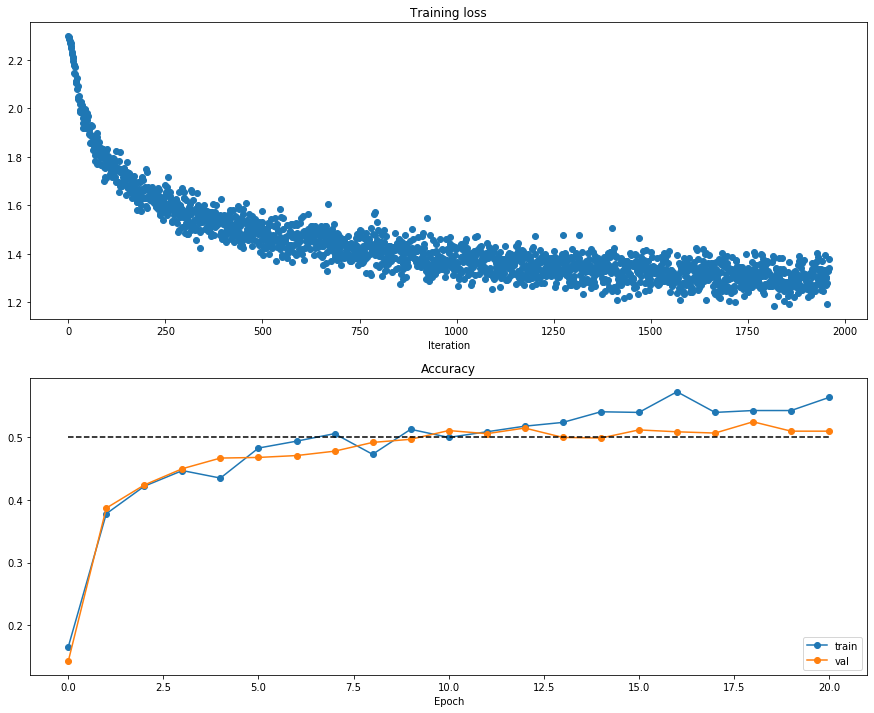

In [16]:
# Run this cell to visualize training loss and train / val accuracy

plt.subplot(2, 1, 1)
plt.title('Training loss')
plt.plot(solver.loss_history, 'o')
plt.xlabel('Iteration')

plt.subplot(2, 1, 2)
plt.title('Accuracy')
plt.plot(solver.train_acc_history, '-o', label='train')
plt.plot(solver.val_acc_history, '-o', label='val')
plt.plot([0.5] * len(solver.val_acc_history), 'k--')
plt.xlabel('Epoch')
plt.legend(loc='lower right')
plt.gcf().set_size_inches(15, 12)
plt.show()

# Réseau de neurones multi-couches
Maintenant vous devez implanter un réseau ayant un nombre arbitraire de couches.

Pour ce faire, prenez connaissance de la classe `FullyConnectedNeuralNet` du fichier `ift725/classifiers/fc_net.py`.

Vous devez implanter **l'initialization, la propagation avant et la rétro-propagation**. Pour le moment, ne vous souciez pas de dropout ni de batch norm.

##  Fonction de perte et vérification du gradient

La prochaine cellule effectue une vérification dilligente.  Exécutez la cellule afin de vous assurez que la loss avec et sans régularisation fonctionne. 

In [17]:
from ift725.classifiers.fc_net import *
N, D, H1, H2, C = 2, 15, 20, 30, 10
X = np.random.randn(N, D)
y = np.random.randint(C, size=(N,)) 

for reg in [0, 3.14]:
  print('Running check with reg = ', reg)
  model = FullyConnectedNeuralNet([H1, H2], input_dim=D, num_classes=C,
                            reg=reg, weight_scale=5e-2, dtype=np.float64)

  loss, grads = model.loss(X, y)
  print('Initial loss: ', loss)
    
  # Relative error should be below 1e-5
  for name in sorted(grads):
    f = lambda _: model.loss(X, y)[0]
    grad_num = eval_numerical_gradient(f, model.params[name], verbose=False, h=1e-5)
    print('%s relative error: %.2e' % (name, rel_error(grad_num, grads[name])))

Running check with reg =  0
Initial loss:  2.2953654864824418
W1 relative error: 2.90e-06
W2 relative error: 6.29e-07
W3 relative error: 9.31e-08
b1 relative error: 7.31e-08
b2 relative error: 1.69e-09
b3 relative error: 1.66e-10
Running check with reg =  3.14
Initial loss:  7.340298979985988
W1 relative error: 3.18e-08
W2 relative error: 2.37e-07
W3 relative error: 6.60e-09
b1 relative error: 5.95e-08
b2 relative error: 2.53e-09
b3 relative error: 1.48e-10


## Question 1:

Pourquoi croyez-vous que les résultats de la cellule précédentes font foi d'une bonne fonction de perte?
     
**Votre réponse:** ...

Autre vérification diligente, assurez-vous que votre code peut "overfitter" sur un petit ensemble de 50 images. Pour ce faire, essayons un réseau à 3 couches cachées ayant chacune 100 neurones. Une recherche d'hyper-paramètres sera effectué pour trouver le bon taux d'apprentissage (learning rate) ainsi que le `weight_scale`.  Vous devriez être capable d'atteindre une justesse en entraînement de 100% avec 20 epochs.

In [18]:
num_train = 50
small_data = {
  'X_train': data['X_train'][:num_train],
  'y_train': data['y_train'][:num_train],
  'X_val': data['X_val'],
  'y_val': data['y_val'],
}

best_weight_scale = 0.
best_learning_rate = 0.
best_training_acc = 0.

##############################################################################
# TODO: Utilisez une instance de Solver pour entrainer un réseau à 3 couches #
#  et 100 neurones par couche à overfitter 50 images de CIFAR10.  Il est     #
#  suggéré d'effectuer une recherche d'hyperparamètres pour trouver le bon   #
#  `learning_rate` et le bon `weight_scale`.                                 #
##############################################################################

input_d  = 32 * 32 * 3
hidden_n = [100, 100, 100]
output_c = 10

#weight_scales = [1e-3, 2e-3, 4e-3, 6e-3, 8e-3, 1e-2]
weight_scales = [4e-2]
#learning_rates = [1e-3, 2e-3, 4e-3, 6e-3, 8e-3, 1e-2]
learning_rates = [7e-3]

results = {}

for w in weight_scales:
    for l in learning_rates:
        model = FullyConnectedNeuralNet(hidden_n,
                                        input_dim = input_d,
                                        num_classes = output_c,
                                        weight_scale=w,
                                        dtype=np.float64)
    
        solver = Solver(model,
                        small_data,
                        update_rule = 'sgd',
                        optim_config = {'learning_rate': 1e-3},
                        lr_decay = 0.90,
                        num_epochs = 20, 
                        batch_size = 500,
                        print_every=500)
        solver.train()
    
        train_acc = solver.train_acc_history[-1]
    
        if train_acc > best_training_acc:
            best_weight_scale  = w
            best_learning_rate = l
            best_training_acc  = train_acc
            
        results[(w, l)] = train_acc

##############################################################################
#                             FIN DE VOTRE CODE                              #
##############################################################################

print('The best learning_rate, weight_scale and training accuracy are',best_weight_scale, best_learning_rate, best_training_acc)

(Iteration 1 / 20) loss: 5.430091
(Epoch 1 / 20) train acc: 0.080000; val_acc: 0.081000
(Epoch 2 / 20) train acc: 0.060000; val_acc: 0.082000
(Epoch 3 / 20) train acc: 0.120000; val_acc: 0.090000
(Epoch 4 / 20) train acc: 0.180000; val_acc: 0.091000
(Epoch 5 / 20) train acc: 0.200000; val_acc: 0.094000
(Epoch 6 / 20) train acc: 0.280000; val_acc: 0.099000
(Epoch 7 / 20) train acc: 0.280000; val_acc: 0.100000
(Epoch 8 / 20) train acc: 0.300000; val_acc: 0.100000
(Epoch 9 / 20) train acc: 0.300000; val_acc: 0.105000
(Epoch 10 / 20) train acc: 0.380000; val_acc: 0.105000
(Epoch 11 / 20) train acc: 0.400000; val_acc: 0.105000
(Epoch 12 / 20) train acc: 0.440000; val_acc: 0.110000
(Epoch 13 / 20) train acc: 0.460000; val_acc: 0.109000
(Epoch 14 / 20) train acc: 0.460000; val_acc: 0.108000
(Epoch 15 / 20) train acc: 0.480000; val_acc: 0.109000
(Epoch 16 / 20) train acc: 0.480000; val_acc: 0.109000
(Epoch 17 / 20) train acc: 0.480000; val_acc: 0.108000
(Epoch 18 / 20) train acc: 0.480000; val

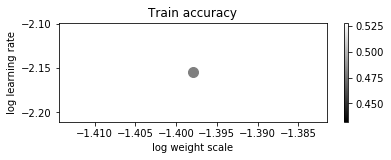

In [19]:
# Visualize the cross-validation results
# import math
marker_size = 100
x_scatter, x_label = [np.log10(x[0]) for x in results], 'log weight scale'
y_scatter, y_label = [np.log10(x[1]) for x in results], 'log learning rate'

# plot validation accuracy
colors = [results[x] for x in results] # default size of markers is 20
plt.subplot(2, 1, 2)
plt.scatter(x_scatter, y_scatter, marker_size, c=colors)
plt.colorbar()
plt.xlabel(x_label)
plt.ylabel(y_label)
plt.title('Train accuracy')
plt.show()

Maintenant, faites la même chose pour un réseau à 5 couches.

In [20]:
num_train = 50
small_data = {
  'X_train': data['X_train'][:num_train],
  'y_train': data['y_train'][:num_train],
  'X_val': data['X_val'],
  'y_val': data['y_val'],
}

##############################################################################
# TODO: Utilisez une instance de Solver pour entrainer un réseau à 5 couches #
#  à 100 neurones à overfitter 50 images de CIFAR10.  Il est suggérer de     #
#  d'effectuer une recherche d'hyperparamètres pour trouver le bon           #
#  `learning_rate` et le bon `weight_scale`.                                 #
##############################################################################

input_d  = 32 * 32 * 3
hidden_n = [100, 100, 100, 100, 100]
output_c = 10

#weight_scales = [1e-3, 2e-3, 4e-3, 6e-3, 8e-3, 1e-2]
weight_scales = [6e-2]
#learning_rates = [1e-3, 2e-3, 4e-3, 6e-3, 8e-3, 1e-2]
learning_rates = [6e-3]

results = {}

for w in weight_scales:
    for l in learning_rates:   
        model = FullyConnectedNeuralNet(hidden_n,
                                        input_dim = input_d,
                                        num_classes = output_c,
                                        weight_scale=w,
                                        dtype=np.float64)
    
        solver = Solver(model,
                        small_data,
                        update_rule = 'sgd',
                        optim_config = {'learning_rate': 1e-3},
                        lr_decay = 0.90,
                        num_epochs = 20, 
                        batch_size = 500,
                        print_every=500)
        solver.train()

        train_acc = solver.train_acc_history[-1]
    
        if train_acc > best_training_acc:
            best_weight_scale  = w
            best_learning_rate = l
            best_training_acc  = train_acc
            
        results[(w, l)] = train_acc

##############################################################################
#                             FIN DE VOTRE CODE                              #
##############################################################################
best_weight_scale = 0.
best_learning_rate = 0.
best_training_acc = 0.
print('The best learning_rate, weight_scale and training accuracy are',best_weight_scale, best_learning_rate, best_training_acc)

(Iteration 1 / 20) loss: 4.422733
(Epoch 1 / 20) train acc: 0.140000; val_acc: 0.122000
(Epoch 2 / 20) train acc: 0.140000; val_acc: 0.131000
(Epoch 3 / 20) train acc: 0.180000; val_acc: 0.128000
(Epoch 4 / 20) train acc: 0.200000; val_acc: 0.128000
(Epoch 5 / 20) train acc: 0.280000; val_acc: 0.128000
(Epoch 6 / 20) train acc: 0.280000; val_acc: 0.127000
(Epoch 7 / 20) train acc: 0.300000; val_acc: 0.123000
(Epoch 8 / 20) train acc: 0.300000; val_acc: 0.122000
(Epoch 9 / 20) train acc: 0.300000; val_acc: 0.127000
(Epoch 10 / 20) train acc: 0.340000; val_acc: 0.125000
(Epoch 11 / 20) train acc: 0.360000; val_acc: 0.130000
(Epoch 12 / 20) train acc: 0.360000; val_acc: 0.130000
(Epoch 13 / 20) train acc: 0.380000; val_acc: 0.131000
(Epoch 14 / 20) train acc: 0.380000; val_acc: 0.129000
(Epoch 15 / 20) train acc: 0.400000; val_acc: 0.129000
(Epoch 16 / 20) train acc: 0.380000; val_acc: 0.130000
(Epoch 17 / 20) train acc: 0.380000; val_acc: 0.129000
(Epoch 18 / 20) train acc: 0.380000; val

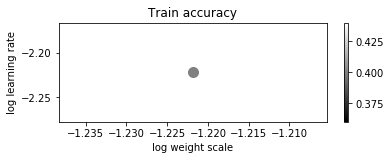

In [21]:
# Visualize the cross-validation results
# import math
marker_size = 100
x_scatter, x_label = [np.log10(x[0]) for x in results], 'log weight scale'
y_scatter, y_label = [np.log10(x[1]) for x in results], 'log learning rate'

# plot validation accuracy
colors = [results[x] for x in results] # default size of markers is 20
plt.subplot(2, 1, 2)
plt.scatter(x_scatter, y_scatter, marker_size, c=colors)
plt.colorbar()
plt.xlabel(x_label)
plt.ylabel(y_label)
plt.title('Train accuracy')
plt.show()

# Descente de gradient ++
Jusqu'à présent nous avons utilisé l'algorithmes de base de la descente de gradient (SGD-stochastic gradient descent). Ici nous testerons d'autres algorithmes plus sophistiqués.

# SGD+Momentum
SGD+momentum est très largement utilisé.  Ouvrez  `ift725/optim.py` et prenez connaissance du code et implémentez la fonction `sgd_momentum` et exécutez la cellule que voici. Votre erreur devrait être inféreieure à 1e-6.

In [22]:
from ift725.optim import sgd_momentum

N, D = 4, 5
w = np.linspace(-0.4, 0.6, num=N*D).reshape(N, D)
dw = np.linspace(-0.6, 0.4, num=N*D).reshape(N, D)
v = np.linspace(0.6, 0.9, num=N*D).reshape(N, D)

config = {'learning_rate': 1e-3, 'velocity': v}
next_w, _ = sgd_momentum(w, dw, config=config)

expected_next_w = np.asarray([
    [-0.39994,    -0.34737526, -0.29481053, -0.24224579, -0.18968105],
    [-0.13711632, -0.08455158, -0.03198684,  0.02057789,  0.07314263],
    [ 0.12570737,  0.17827211,  0.23083684,  0.28340158,  0.33596632],
    [ 0.38853105,  0.44109579,  0.49366053,  0.54622526,  0.59879   ]])
expected_velocity = np.asarray([
    [-0.06 ,       0.00684211,  0.07368421,  0.14052632,  0.20736842],
    [ 0.27421053,  0.34105263,  0.40789474,  0.47473684,  0.54157895],
    [ 0.60842105,  0.67526316,  0.74210526,  0.80894737,  0.87578947],
    [ 0.94263158,  1.00947368,  1.07631579,  1.14315789,  1.21      ]])

# Error should be below 1e-06
print('next_w error: ', rel_error(next_w, expected_next_w))
print('velocity error: ', rel_error(expected_velocity, config['velocity']))

v : [[0.5406     0.55475789 0.56891579 0.58307368 0.59723158]
 [0.61138947 0.62554737 0.63970526 0.65386316 0.66802105]
 [0.68217895 0.69633684 0.71049474 0.72465263 0.73881053]
 [0.75296842 0.76712632 0.78128421 0.79544211 0.8096    ]]
next_w : [[-0.4        -0.34736842 -0.29473684 -0.24210526 -0.18947368]
 [-0.13684211 -0.08421053 -0.03157895  0.02105263  0.07368421]
 [ 0.12631579  0.17894737  0.23157895  0.28421053  0.33684211]
 [ 0.38947368  0.44210526  0.49473684  0.54736842  0.6       ]]
next_w error:  1.0
velocity error:  1.0


Maintenant, excécutez cette cellule.  Normalement, le réseau à 6 couches devrait s'entraîner plus rapidement avec SGD+momentum qu'avec SGD.

running with  sgd
(Iteration 1 / 400) loss: 2.476493
(Epoch 0 / 10) train acc: 0.107000; val_acc: 0.106000
(Iteration 11 / 400) loss: 2.183550
(Iteration 21 / 400) loss: 2.180277
(Iteration 31 / 400) loss: 2.155833
(Epoch 1 / 10) train acc: 0.253000; val_acc: 0.241000
(Iteration 41 / 400) loss: 2.038379
(Iteration 51 / 400) loss: 2.017262
(Iteration 61 / 400) loss: 2.013000
(Iteration 71 / 400) loss: 2.096640
(Epoch 2 / 10) train acc: 0.319000; val_acc: 0.292000
(Iteration 81 / 400) loss: 1.883564
(Iteration 91 / 400) loss: 1.789869
(Iteration 101 / 400) loss: 1.956208
(Iteration 111 / 400) loss: 1.891631
(Epoch 3 / 10) train acc: 0.350000; val_acc: 0.310000
(Iteration 121 / 400) loss: 1.788793
(Iteration 131 / 400) loss: 1.874362
(Iteration 141 / 400) loss: 1.736350
(Iteration 151 / 400) loss: 1.711660
(Epoch 4 / 10) train acc: 0.399000; val_acc: 0.336000
(Iteration 161 / 400) loss: 1.830267
(Iteration 171 / 400) loss: 1.791578
(Iteration 181 / 400) loss: 1.665706
(Iteration 191 / 400

(Epoch 0 / 10) train acc: 0.102000; val_acc: 0.096000
v : [[-1.3674679e-04 -4.4595934e-05 -9.0023670e-05 ... -8.7253218e-05
  -8.1987542e-05  4.6205278e-06]
 [-1.2767622e-04 -5.6732366e-05 -1.2386021e-04 ... -7.5872711e-05
  -8.8305125e-05 -1.4560228e-06]
 [-1.2815659e-04 -5.7390120e-05 -1.5329635e-04 ... -5.6613870e-05
  -8.2094455e-05 -3.2309075e-05]
 ...
 [-5.3379132e-05 -6.1166917e-05 -2.0804897e-05 ... -9.7218421e-05
  -3.3714859e-05 -1.7383372e-05]
 [-6.0826878e-05 -4.9409628e-05 -2.2029828e-05 ... -1.2065186e-04
  -2.6648038e-05 -3.7265119e-05]
 [-5.6315279e-05 -4.0744220e-05 -2.4228222e-05 ... -1.4491193e-04
  -3.8147158e-05 -3.8424190e-05]]
next_w : [[-0.02684234  0.00440466 -0.0117178  ... -0.08278705 -0.03881606
   0.03353747]
 [ 0.00857653  0.09953983  0.05707384 ...  0.0099508  -0.04300528
   0.03785514]
 [ 0.06249847 -0.01273849 -0.05719026 ...  0.09874071 -0.12258988
   0.02521245]
 ...
 [ 0.13026541 -0.09087461 -0.06700382 ...  0.01805482  0.06108244
   0.05413485]
 [ 0

v : [[ 1.12027228e-05 -2.11850187e-04 -1.33108580e-04 -7.56139809e-04
  -2.82234338e-04  1.87342317e-04  1.57018920e-04  1.07310468e-03
   1.40768307e-05 -5.94126104e-05]
 [-1.68591141e-04 -4.64890218e-05  1.61814343e-04  1.03578146e-04
   1.44766687e-04 -4.79782291e-04  2.47072567e-05  4.91832965e-04
  -9.87210078e-05 -1.33116002e-04]
 [ 2.36843716e-05 -1.30563101e-04  7.02494508e-05 -1.42089935e-04
  -1.03526589e-04 -1.09452245e-04  1.55024798e-04  3.11809068e-04
   1.39303302e-05 -8.90661613e-05]
 [-4.45720116e-06 -2.33068931e-06 -9.90590161e-06 -1.14892737e-06
  -5.85184762e-06 -9.28051941e-06 -6.39666860e-06 -7.23043559e-06
   5.66387316e-05 -1.00365451e-05]
 [ 3.16848833e-04 -5.33700164e-04 -2.25609430e-04 -9.95884649e-03
  -2.45867902e-03  1.26107724e-03  1.64902501e-03  4.78762900e-03
   1.78385957e-03  3.37839406e-03]
 [-1.17471400e-05 -8.88116847e-06 -5.75697595e-06  2.55096074e-05
  -9.92760033e-06 -5.87529394e-06 -2.61746186e-06  2.67511768e-05
  -3.87080945e-06 -3.58432999

v : [[-1.24059543e-05 -2.13536885e-04 -1.05310544e-04 -5.76979888e-04
  -2.68145464e-04  1.33767782e-04  1.85592944e-04  9.45876702e-04
   4.25959115e-06 -9.31182440e-05]
 [-2.19467154e-04  2.10668353e-04  1.66581449e-04  2.51293008e-04
   1.87351092e-04 -6.40038750e-04  6.11550757e-04 -4.30986984e-05
   7.20964745e-05 -5.96936559e-04]
 [-9.61637670e-06 -2.14655476e-04  8.76782360e-06 -6.02749205e-05
  -2.05032018e-04  7.70920815e-05  2.93857418e-04  2.72421137e-04
  -3.56896198e-05 -1.26870029e-04]
 [ 8.65532274e-05 -4.96581488e-05  1.29844528e-04  1.31326102e-04
  -4.79542359e-05  6.60642181e-05 -5.35252329e-05 -7.06829451e-05
   1.25020561e-05 -2.04469601e-04]
 [ 7.35893962e-04 -7.86169199e-04  4.32837696e-04 -8.26207083e-03
  -2.43158033e-03  1.35125476e-03  1.27550028e-03  4.08476405e-03
   1.51128706e-03  2.08828133e-03]
 [-1.05724257e-05 -7.99305144e-06 -5.18127808e-06  2.29586458e-05
  -8.93484048e-06 -5.28776445e-06 -2.35571565e-06  2.40760583e-05
  -3.48372851e-06 -3.22589699

v : [[-3.14861609e-05 -1.91684434e-04 -1.08310036e-04 -5.22133603e-04
  -2.54743441e-04  1.02472251e-04  2.10278842e-04  9.13813943e-04
  -8.13139559e-06 -1.10075969e-04]
 [-5.98213810e-04  1.69413033e-04  2.63444119e-04  5.18753659e-04
   2.55878083e-04 -1.77089503e-04  4.46921709e-04 -7.86531309e-04
   1.85861922e-04 -2.78437772e-04]
 [ 3.86832380e-06 -2.48632336e-04 -8.27337863e-05 -4.48536230e-06
  -1.31004897e-04  2.36359978e-04  1.98926951e-04  2.86054157e-04
  -7.51971238e-05 -1.83155847e-04]
 [ 6.06900721e-05  1.01754777e-04 -4.11968213e-05  3.23653367e-04
   2.80570603e-05  1.94847205e-04 -9.85717124e-05 -4.46075755e-05
  -1.13521775e-04 -4.11104644e-04]
 [ 5.90481795e-04 -6.63097249e-04  5.63699636e-04 -7.29490351e-03
  -2.08983920e-03  1.60216901e-03  9.68902197e-04  3.48519511e-03
   1.21242832e-03  1.62496325e-03]
 [-9.51518268e-06 -7.19374611e-06 -4.66315032e-06  2.06627810e-05
  -8.04135652e-06 -4.75898787e-06 -2.12014402e-06  2.16684512e-05
  -3.13535566e-06 -2.90330718

v : [[ 0.00000000e+00  3.18337698e-06  1.04198143e-05 ...  5.94073936e-06
  -1.12674847e-04  6.92637423e-06]
 [ 1.46132370e-04 -4.65450401e-04  8.06953583e-04 ... -6.46836997e-04
  -1.29870966e-03  8.02219496e-04]
 [-1.29141927e-05 -1.10009700e-04  1.34608912e-04 ... -1.48505205e-05
  -1.27521285e-04  2.24150237e-04]
 ...
 [-5.53309883e-06 -1.95138819e-05  1.26306535e-04 ... -7.97764296e-05
  -2.92538927e-04  1.47589381e-05]
 [ 2.34797608e-06 -1.53960409e-05  1.83040192e-05 ...  1.51653030e-05
  -1.11737672e-05 -4.69697227e-07]
 [ 6.88163564e-05 -2.66093586e-04  6.70000794e-04 ... -5.85275237e-04
  -1.18441205e-03  7.00778677e-04]]
next_w : [[ 0.03161499 -0.01839253  0.02637012 ...  0.10025724  0.06740697
  -0.00473253]
 [ 0.01620045 -0.02173289  0.03621898 ... -0.03375991 -0.07833493
   0.0564034 ]
 [-0.10043941 -0.00258357 -0.05559603 ... -0.01041979 -0.02608857
  -0.0408688 ]
 ...
 [ 0.03319418  0.02076702  0.04290906 ...  0.02295022  0.05014377
  -0.08370708]
 [ 0.06105573  0.00728

next_w : [[ 0.00052225  0.08140771 -0.01788256 ... -0.01621339  0.03462218
  -0.02028937]
 [-0.0211095  -0.02140801  0.05217718 ... -0.0680123  -0.04973815
  -0.06346168]
 [-0.01419011  0.01738459 -0.05317017 ...  0.06594875  0.04605292
   0.06220074]
 ...
 [-0.03295631 -0.09719644  0.00111937 ... -0.00986691  0.06534955
  -0.05822713]
 [-0.00938117  0.00141245 -0.05059024 ...  0.01118961  0.00732291
  -0.00936257]
 [-0.05206977 -0.05678187  0.08857502 ... -0.03342087  0.00492336
   0.11700232]]
v : [ 1.0700436e-06 -1.2678129e-06 -1.0535569e-05 -3.4869018e-07
  3.2346845e-06 -5.5315754e-06 -1.9665385e-06 -3.6970996e-06
  2.8168060e-06 -9.1569736e-06 -1.7253857e-06 -3.8846856e-06
 -3.6051249e-06  2.5938311e-06  5.6124100e-06 -1.9689489e-06
 -1.4524176e-06 -4.7949684e-06 -8.8714742e-06  5.1036504e-06
  2.6977311e-06  6.0049647e-06 -3.6501294e-06 -1.5517369e-05
 -9.3959216e-06  2.5872737e-06 -1.8908111e-06 -1.1712303e-05
 -2.4612876e-07 -1.5835144e-06 -6.8864847e-07  3.0217902e-07
 -5.831

v : [[-1.5532759e-04  8.3948929e-05 -1.1631780e-04 ... -1.0524859e-04
  -9.6409585e-06  1.2885436e-05]
 [-1.4753963e-04  8.1153288e-05 -1.2773857e-04 ... -1.0723843e-04
  -6.7335886e-06  6.7551955e-06]
 [-1.5129855e-04  8.6764790e-05 -1.3353668e-04 ... -9.7110220e-05
  -8.5948323e-06 -3.1426684e-05]
 ...
 [-1.1765102e-04  4.9883347e-05 -1.8449305e-06 ... -1.4436312e-04
   8.1367492e-05  8.9877663e-05]
 [-1.0983971e-04  5.1106155e-05 -3.4612513e-06 ... -1.6498935e-04
   1.0149424e-04  8.4570027e-05]
 [-9.5429248e-05  6.2305895e-05 -1.5105483e-05 ... -1.7871596e-04
   9.6887139e-05  7.7503137e-05]]
next_w : [[-0.02775759  0.00471546 -0.01215495 ... -0.08319401 -0.03910516
   0.03351865]
 [ 0.00772643  0.09980873  0.0565159  ...  0.00955093 -0.04330772
   0.03779227]
 [ 0.06165649 -0.01248649 -0.05784877 ...  0.09842663 -0.12288705
   0.02501688]
 ...
 [ 0.12971084 -0.09073956 -0.06698038 ...  0.0175112   0.06125115
   0.05429596]
 [ 0.03520246  0.11940335 -0.0496688  ...  0.03267379 -0.0

next_w : [[ 6.17665946e-02  1.31487492e-02  5.24447821e-02  7.15852752e-02
   1.05480989e-03 -2.64917277e-02 -1.05201555e-02 -4.53806259e-02
   1.52849089e-02  5.39551601e-02]
 [-1.08112350e-01 -8.60766321e-03  4.91039194e-02  5.63019402e-02
  -1.03770047e-02 -1.05793374e-02  3.89257707e-02  5.67870121e-03
  -6.64043352e-02 -5.78691773e-02]
 [-1.36767456e-03 -3.40420566e-02 -2.82129962e-02 -2.88379844e-02
  -4.81743962e-02 -1.94842387e-02  1.46829575e-01  5.05814375e-03
  -4.85730767e-02  1.36184273e-02]
 [-7.52483681e-03  2.49468554e-02 -1.72570907e-02 -2.63689943e-02
   5.38930744e-02  6.45164624e-02  2.84183882e-02  1.87944360e-02
  -5.63086644e-02 -1.54295117e-02]
 [-5.43972887e-02 -5.85763752e-02 -1.07034162e-01 -1.42215490e-02
   3.92799862e-02 -8.25854205e-03  9.31037739e-02 -8.50035846e-02
  -3.90847884e-02 -6.03269003e-02]
 [-6.56569703e-03  5.26101142e-02 -8.70756339e-03 -4.62815724e-03
   2.29226835e-02  5.76228239e-02 -2.44524814e-02  4.53387909e-02
   1.75914355e-02 -5.021

next_w : [[ 6.16726987e-02  1.30193755e-02  5.23086451e-02  7.13303611e-02
   8.89477902e-04 -2.64036283e-02 -1.03765279e-02 -4.46343645e-02
   1.52259907e-02  5.38157374e-02]
 [-1.08001783e-01 -8.21314473e-03  4.89236824e-02  5.68167679e-02
  -1.03760222e-02 -1.09145399e-02  3.97818275e-02  4.34160046e-03
  -6.66122809e-02 -5.76856397e-02]
 [-1.19004794e-03 -3.46344188e-02 -2.77476311e-02 -2.89502945e-02
  -4.84627336e-02 -1.92761365e-02  1.47144690e-01  4.99080308e-03
  -4.88737933e-02  1.38132898e-02]
 [-7.35265203e-03  2.44430732e-02 -1.70877483e-02 -2.60969922e-02
   5.38339242e-02  6.48482367e-02  2.82172058e-02  1.86862238e-02
  -5.61375767e-02 -1.56735796e-02]
 [-5.41010760e-02 -5.90318032e-02 -1.06531985e-01 -1.92968771e-02
   3.79076116e-02 -7.10917264e-03  9.37520042e-02 -8.24531466e-02
  -3.83221135e-02 -5.93328737e-02]
 [-6.57263352e-03  5.26048690e-02 -8.71096272e-03 -4.61309403e-03
   2.29168218e-02  5.76193556e-02 -2.44540274e-02  4.53545861e-02
   1.75891500e-02 -5.021

next_w : [[ 6.15281500e-02  1.28983073e-02  5.23476303e-02  7.10422769e-02
   7.73292850e-04 -2.63774153e-02 -1.02982959e-02 -4.39679809e-02
   1.52169196e-02  5.36848791e-02]
 [-1.08365282e-01 -7.77850533e-03  4.84528169e-02  5.73912188e-02
  -1.04907658e-02 -1.08731175e-02  4.05131541e-02  3.21102701e-03
  -6.70411289e-02 -5.69589436e-02]
 [-1.37750199e-03 -3.48976366e-02 -2.72957627e-02 -2.89533455e-02
  -4.85926457e-02 -1.87370032e-02  1.47492096e-01  4.54115309e-03
  -4.91039753e-02  1.37383584e-02]
 [-7.23964674e-03  2.37922072e-02 -1.65636651e-02 -2.56996360e-02
   5.35031669e-02  6.52650595e-02  2.78834421e-02  1.86989084e-02
  -5.60952313e-02 -1.58644952e-02]
 [-5.38062267e-02 -5.94780557e-02 -1.06078796e-01 -2.37412937e-02
   3.67508456e-02 -6.11489918e-03  9.42694470e-02 -8.02044123e-02
  -3.76621410e-02 -5.84538952e-02]
 [-6.57887664e-03  5.26001491e-02 -8.71402211e-03 -4.59953723e-03
   2.29115468e-02  5.76162338e-02 -2.44554188e-02  4.53688018e-02
   1.75870936e-02 -5.021

next_w : [[ 6.14229850e-02  1.27348341e-02  5.23356348e-02  7.07614794e-02
   7.19233649e-04 -2.63382234e-02 -1.02431998e-02 -4.32248786e-02
   1.51506271e-02  5.35292737e-02]
 [-1.08723797e-01 -7.17590796e-03  4.73179780e-02  5.79104014e-02
  -1.03251915e-02 -1.09080374e-02  4.01367582e-02  3.15674278e-03
  -6.74063787e-02 -5.59220985e-02]
 [-1.60410570e-03 -3.52426544e-02 -2.73165610e-02 -2.86671575e-02
  -4.80930507e-02 -1.83357112e-02  1.47265717e-01  4.46743192e-03
  -4.94834818e-02  1.38233164e-02]
 [-6.50057103e-03  2.30095573e-02 -1.62361879e-02 -2.54651774e-02
   5.29820435e-02  6.55662417e-02  2.72755623e-02  1.87789537e-02
  -5.58689311e-02 -1.58613771e-02]
 [-5.35193384e-02 -5.98405190e-02 -1.05695531e-01 -2.77291238e-02
   3.56813595e-02 -5.18668443e-03  9.46735516e-02 -7.81635344e-02
  -3.70775387e-02 -5.76620698e-02]
 [-6.58449531e-03  5.25959022e-02 -8.71677604e-03 -4.58733598e-03
   2.29067989e-02  5.76134250e-02 -2.44566705e-02  4.53815982e-02
   1.75852422e-02 -5.021

v : [[-2.24682735e-04 -7.93556974e-05  1.30510771e-05 -8.39408094e-05
  -2.08329511e-05  3.20437684e-05  9.04233166e-05  5.64685732e-04
  -2.34959065e-04 -5.64326219e-05]
 [-1.53114949e-03 -3.88375542e-04 -1.30344427e-03  2.67951400e-04
  -3.51541064e-04  1.18102464e-04 -6.29429647e-04  1.57230464e-03
  -4.71903739e-04  2.71748542e-03]
 [-9.90456669e-04 -4.15778457e-04  4.77672467e-04  2.74116552e-04
   5.17255743e-04  2.31296930e-04 -5.11747494e-04  3.87889944e-04
  -4.07412765e-04  4.37163573e-04]
 [ 3.78316035e-04 -1.32131064e-03  3.05569236e-04 -1.45855287e-04
  -4.95337415e-04  7.42778706e-04 -6.98448857e-04  5.25142299e-04
   3.67848057e-04  3.41297389e-04]
 [ 2.01345669e-04 -3.28052032e-04  3.02305503e-04 -3.09282611e-03
  -8.40373803e-04  8.00898473e-04  2.63065565e-04  1.59940845e-03
   4.42721590e-04  6.51506707e-04]
 [-4.55108102e-06 -3.44074533e-06 -2.23037023e-06  9.88294141e-06
  -3.84615578e-06 -2.27620899e-06 -1.01405817e-06  1.03639513e-05
  -1.49963068e-06 -1.38864266

v : [[-2.97693477e-04 -6.91114183e-05  2.00871902e-04 -1.42681500e-04
  -6.44742686e-05  1.19488388e-04  1.29720167e-04  4.19730903e-04
  -1.62119788e-04 -1.33730893e-04]
 [-2.21630232e-03 -3.43070336e-04 -1.23592315e-03  1.42275749e-04
  -2.12503655e-04  2.64261093e-04 -6.04812289e-04  1.19999028e-03
   7.98608526e-05  2.92622414e-03]
 [-1.58647029e-03 -4.08897235e-04  6.44047046e-04  4.27943771e-04
   2.68498668e-04  5.81537897e-04 -6.31112605e-04  3.42415617e-04
  -1.51172251e-04  5.13209146e-04]
 [-1.95954053e-05 -1.70769263e-03  5.51879755e-04 -4.39671159e-04
  -4.12390102e-04  1.07063330e-03 -1.94362132e-04  2.65242241e-04
   6.59057987e-04  2.26897624e-04]
 [ 1.78366376e-04 -2.76184699e-04  2.69184704e-04 -2.79099797e-03
  -7.60062190e-04  7.16241775e-04  2.29696336e-04  1.45464658e-03
   3.96431686e-04  5.82677545e-04]
 [-4.09597260e-06 -3.09667075e-06 -2.00733325e-06  8.89464718e-06
  -3.46154002e-06 -2.04858793e-06 -9.12652354e-07  9.32755574e-06
  -1.34966763e-06 -1.24977839

v : [[-2.19022724e-04 -3.53179639e-04  2.99356645e-04  1.32387766e-04
  -1.85358993e-04  3.75764561e-04  3.60114063e-04  1.83267475e-04
  -3.13189754e-04 -2.80139444e-04]
 [-2.41224747e-03 -2.02217896e-04 -6.11662399e-05 -6.78876822e-05
  -6.30970928e-04 -2.91504955e-04  2.18129950e-04  1.33238616e-03
  -4.32713889e-04  2.54819333e-03]
 [-1.72838604e-03 -4.47966624e-04  1.34272606e-03  1.95589499e-04
   2.20533955e-04  3.36368626e-04  1.18160096e-04  1.85088051e-04
  -2.70415389e-04  4.83014737e-05]
 [-4.76185742e-05 -1.61770475e-03  8.72136443e-04 -2.65945884e-04
  -4.55996807e-04  7.21819873e-04 -2.88779091e-04  3.77125107e-04
   4.89189464e-04  2.15773747e-04]
 [ 1.58194976e-04 -2.03153264e-04  2.39791698e-04 -2.52271444e-03
  -6.89672597e-04  6.37166144e-04  2.00256807e-04  1.30404870e-03
   3.54505493e-04  5.21576672e-04]
 [-3.68637529e-06 -2.78700350e-06 -1.80659993e-06  8.00518228e-06
  -3.11538588e-06 -1.84372914e-06 -8.21387118e-07  8.39479981e-06
  -1.21470089e-06 -1.12480052

next_w : [-2.69445954e-05 -8.23234732e-05  3.51581839e-05 -4.72449290e-04
 -5.66251751e-04  1.90529536e-05 -5.15400861e-05 -9.77537638e-05
 -7.94586449e-05 -2.23433017e-04  1.90790219e-04  5.80300293e-05
 -3.75476491e-04 -6.36186132e-06 -1.69084451e-04  1.30105560e-04
  1.04678460e-04  7.13702912e-06 -2.23624782e-04 -1.56592389e-04
  1.15004514e-05 -2.02432770e-04 -8.97352147e-05  1.97718589e-04
 -9.44424100e-05  8.25760071e-05 -4.43698154e-05 -2.86864197e-05
 -4.87334983e-05  4.14402275e-05  5.22635601e-05  5.68902760e-05
  1.10167075e-05 -1.62941469e-05 -3.05829308e-05 -3.06282018e-05
 -1.82672840e-04 -3.66929045e-04 -1.59200717e-04  1.64648700e-05
  2.46574782e-04  2.55569171e-06 -1.35924041e-04  3.04381501e-06
 -2.49788318e-05 -7.70163460e-05 -9.48876550e-06 -3.15967081e-05
  4.75741836e-05 -1.99566439e-05  3.84387022e-06 -1.14109635e-05
  5.18176566e-05  2.27785790e-06  1.49670050e-05 -8.95594712e-05
 -8.39030054e-06 -3.11070908e-05  3.22994310e-05 -3.78941550e-05
  1.93318756e-05

next_w : [[ 6.04690760e-02  1.20862462e-02  5.28327674e-02  7.06071481e-02
   4.46715101e-04 -2.58120690e-02 -9.54422075e-03 -4.14886437e-02
   1.42659722e-02  5.29847890e-02]
 [-1.16020858e-01 -7.30254734e-03  4.31696586e-02  5.87354563e-02
  -1.11955795e-02 -1.05666444e-02  3.86360697e-02  7.37713557e-03
  -6.87900484e-02 -4.59821634e-02]
 [-6.69566169e-03 -3.64117771e-02 -2.48780772e-02 -2.76571717e-02
  -4.59583849e-02 -1.67016983e-02  1.45833224e-01  5.02912467e-03
  -5.04285358e-02  1.46827018e-02]
 [-5.65885706e-03  1.74930412e-02 -1.41512016e-02 -2.62853783e-02
   5.12554571e-02  6.87149465e-02  2.54054740e-02  1.99472345e-02
  -5.40309101e-02 -1.50096966e-02]
 [-5.27441166e-02 -6.09642603e-02 -1.04555659e-01 -3.96612063e-02
   3.24410610e-02 -2.17361143e-03  9.56964567e-02 -7.19976351e-02
  -3.53639759e-02 -5.51965050e-02]
 [-6.60188496e-03  5.25827557e-02 -8.72529857e-03 -4.54957224e-03
   2.28921026e-02  5.76047264e-02 -2.44605448e-02  4.54211980e-02
   1.75795108e-02 -5.022

v : [[-2.96478538e-04 -5.55834034e-04  8.50429758e-04  1.06940570e-04
   4.02819685e-04 -7.39649404e-04  3.27930553e-04  7.49776664e-04
  -4.00153018e-04 -4.45782440e-04]
 [-8.57969921e-04 -6.87348656e-04  7.03508849e-04 -8.20498448e-04
   2.92565906e-04 -1.89078879e-03  1.44643662e-03  2.32135062e-03
  -1.16152421e-03  6.54268719e-04]
 [-4.79607494e-04 -6.71574497e-04  1.49201090e-03 -4.26400453e-04
   4.48660285e-04 -7.40535150e-04  9.17101279e-04  1.12955098e-03
  -8.10394122e-04 -8.58811662e-04]
 [ 8.49409204e-04 -1.79337699e-03  1.26539392e-03 -8.32508260e-04
  -1.62047043e-04 -1.99811184e-04 -2.82371038e-05  9.10625269e-04
  -5.45840521e-05  4.51361266e-05]
 [ 1.04504870e-04 -2.04974174e-04  1.70795713e-04 -1.89140846e-03
  -5.69235242e-04  4.69897495e-04  1.11831192e-04  1.10920798e-03
   2.38170527e-04  4.61210147e-04]
 [-2.98596387e-06 -2.25747272e-06 -1.46334594e-06  6.48419700e-06
  -2.52346240e-06 -1.49342054e-06 -6.65323512e-07  6.79978757e-06
  -9.83907739e-07 -9.11088421

next_w : [-3.23011809e-05 -1.08483728e-04  4.02619989e-05 -5.02813258e-04
 -6.02238404e-04  1.90935352e-05 -7.68525933e-05 -9.52829432e-05
 -8.25805182e-05 -2.48796860e-04  2.06260564e-04  7.53370405e-05
 -3.97717638e-04  3.37230040e-06 -1.76183559e-04  1.26741696e-04
  1.17724063e-04  9.94552374e-06 -2.66889692e-04 -1.67159553e-04
  1.29530645e-05 -1.90025225e-04 -1.01463913e-04  1.95646571e-04
 -1.20757904e-04  8.99627485e-05 -6.57619239e-05 -3.70838607e-05
 -5.62926580e-05  3.64876578e-05  8.41556466e-05  6.95001654e-05
  2.81571629e-05 -1.30713142e-05 -2.67990345e-05 -3.50169357e-05
 -1.86193720e-04 -3.83916777e-04 -1.67241771e-04  2.21687442e-05
  2.45476724e-04 -1.37577183e-06 -1.40131393e-04 -5.67671486e-06
 -1.29333657e-05 -7.84468721e-05 -3.58499128e-05 -4.01938996e-05
  4.39110918e-05 -2.60217021e-05 -1.77590373e-05 -1.82467375e-05
  5.26004587e-05  1.15556577e-05  1.62225133e-05 -1.02041027e-04
 -2.27271266e-06 -2.68288495e-05  9.97949792e-06 -6.26722685e-05
  2.48939232e-05

v : [ 2.0531254e-05 -1.3405737e-03  1.6900215e-03 -7.9207658e-04
  3.5523041e-04 -1.5986722e-03  1.1676706e-03  9.0593798e-04
  2.6760355e-04 -6.7567232e-04]
next_w : [-0.00162393 -0.01055198 -0.00070691  0.00227843  0.00467399 -0.0013754
  0.00477394  0.00776679  0.00275574 -0.00799069]
v : [[-1.22135185e-04 -3.37300517e-05 -1.75447894e-06 ... -8.78262581e-05
  -1.58102430e-05  3.40948063e-05]
 [-1.20159326e-04 -3.85721651e-05 -2.80437325e-06 ... -8.28670309e-05
  -2.24591677e-05  4.25472645e-05]
 [-1.09672321e-04 -4.49161234e-05 -1.78504324e-05 ... -7.37888040e-05
  -1.46374605e-05  2.57442371e-05]
 ...
 [-2.77148538e-05  1.03523656e-04  4.53870161e-05 ... -1.51703935e-04
   1.06556945e-04  1.07080486e-05]
 [-3.53471114e-05  1.06408625e-04  4.24192476e-05 ... -1.67685415e-04
   9.88278116e-05  1.97249337e-05]
 [-2.70955370e-05  9.82802158e-05  3.55254524e-05 ... -1.78736926e-04
   1.20477926e-04  1.60637483e-05]]
next_w : [[-0.02880082  0.00506873 -0.01265776 ... -0.08423883 -0.03911

v : [[-1.59205170e-04 -7.07376457e-04  1.28993962e-03 -7.43970042e-04
   1.05659710e-03 -1.06877810e-03  2.23211362e-04  9.56471718e-04
  -2.17138964e-04 -6.29751012e-04]
 [ 4.72334796e-04 -1.97951886e-04  2.56387517e-03 -2.42341799e-03
   1.20366737e-03 -2.36284267e-03  9.70586669e-04  1.20074465e-03
  -1.08493352e-03 -3.42061976e-04]
 [ 1.52213406e-03 -4.13717324e-04  2.84558604e-03 -1.18939264e-03
   4.37424460e-04 -8.68549629e-04  3.02948116e-04  2.04186043e-04
  -1.09389983e-03 -1.74671959e-03]
 [ 1.65660889e-03 -1.50126929e-03  1.60473166e-03 -1.39487046e-03
   1.44824851e-04 -5.91085001e-04 -3.46904562e-05  6.76014577e-04
  -2.37135973e-04 -3.23128625e-04]
 [ 7.35079957e-05 -1.80635107e-04  1.30368586e-04 -1.48941670e-03
  -4.67093661e-04  3.74449650e-04  6.45325126e-05  8.83013010e-04
   2.58611690e-04  3.52661940e-04]
 [-2.41863063e-06 -1.82855285e-06 -1.18531011e-06  5.25219957e-06
  -2.04400430e-06 -1.20967059e-06 -5.38911991e-07  5.50782761e-06
  -7.96965253e-07 -7.37981566

next_w : [-2.20302827e-04  7.81266135e-06  5.09323494e-04  3.86315485e-04
 -4.69753839e-04  1.19126322e-04 -5.02500261e-05 -7.52169057e-04
 -1.11638830e-04  1.79166105e-04  1.49244981e-04  6.67951826e-05
  3.22811014e-04 -3.04800924e-04 -9.23129555e-05 -5.38256863e-05
  3.30387993e-04 -1.02422113e-04 -4.11528541e-04 -9.23960994e-04
 -2.52058991e-04 -3.71825008e-04 -5.49034121e-05  2.47747259e-04
 -8.42885987e-04  1.92454943e-04  4.77362482e-05  3.17171274e-04
  2.78968015e-04 -1.07297972e-04 -1.69480627e-04  1.14308277e-05
 -4.06999243e-05 -3.38627025e-04 -1.97597838e-04  1.08441411e-04
  4.02166857e-04 -5.37031192e-05 -4.58307506e-04 -6.39049162e-04
 -4.37654729e-04 -4.50743915e-04 -1.37917697e-03  1.80770396e-04
 -8.47085903e-04  1.11820904e-04 -2.06525263e-04  6.76005729e-05
  2.96849903e-04 -4.53944376e-05  2.15062639e-04  3.76662720e-05
  6.02730215e-05 -1.22600632e-05 -6.70719310e-05  1.96083492e-05
 -4.13278933e-04 -4.93182510e-04  8.39323795e-04 -3.15391866e-04
 -8.43519461e-04

v : [[-1.08199893e-04 -1.88558333e-05 -4.96845896e-05 ... -6.92114554e-05
  -7.35388312e-07  2.82937672e-05]
 [-1.06031694e-04 -2.38045759e-05 -5.53204845e-05 ... -7.37382870e-05
  -2.57394640e-06  3.59578662e-05]
 [-9.15375858e-05 -2.97141614e-05 -6.83387771e-05 ... -7.41495023e-05
  -8.93762262e-07  2.17037450e-05]
 ...
 [-1.82578824e-05  5.84082954e-05 -2.05233446e-05 ... -1.10517918e-04
   8.40436696e-05  3.50146365e-05]
 [-2.18748228e-05  6.89315057e-05 -2.30580299e-05 ... -1.15640025e-04
   7.67948513e-05  4.00317986e-05]
 [-2.30431451e-05  7.32547851e-05 -2.25736821e-05 ... -1.11781170e-04
   9.30622627e-05  3.33778444e-05]]
next_w : [[-0.02906092  0.00501762 -0.01269487 ... -0.08437341 -0.03911007
   0.03368764]
 [ 0.00645258  0.10002427  0.05600323 ...  0.00839696 -0.04335109
   0.03791752]
 [ 0.06048899 -0.01231288 -0.05845881 ...  0.09740475 -0.12279108
   0.0247408 ]
 ...
 [ 0.12882796 -0.08985933 -0.06683301 ...  0.01578115  0.0619831
   0.05491262]
 [ 0.03432213  0.120348

next_w : [[ 5.97201027e-02  8.97464622e-03  5.79264499e-02  6.89701587e-02
   4.00353782e-03 -2.97812372e-02 -7.83270784e-03 -3.81880216e-02
   1.27851861e-02  5.02696671e-02]
 [-1.17654115e-01 -9.24083218e-03  5.21802306e-02  5.05909063e-02
  -7.41575425e-03 -2.13516243e-02  4.44598980e-02  1.49379438e-02
  -7.41388425e-02 -4.43073288e-02]
 [-5.48218517e-03 -3.86834331e-02 -1.32489847e-02 -3.19692641e-02
  -4.36607786e-02 -2.07090303e-02  1.49193943e-01  7.87574425e-03
  -5.53604774e-02  8.85821320e-03]
 [-2.74619553e-04  9.27841011e-03 -6.74572727e-03 -3.14874463e-02
   5.12784459e-02  6.71637729e-02  2.55090948e-02  2.32401155e-02
  -5.47034815e-02 -1.55784516e-02]
 [-5.22671379e-02 -6.18867055e-02 -1.03771426e-01 -4.83666733e-02
   2.98628137e-02 -2.53517646e-06  9.61971581e-02 -6.69916719e-02
  -3.41044031e-02 -5.31888790e-02]
 [-6.61547156e-03  5.25724851e-02 -8.73195659e-03 -4.52006841e-03
   2.28806213e-02  5.75979315e-02 -2.44635697e-02  4.54521365e-02
   1.75750349e-02 -5.022

v : [[-1.14761002e-04 -4.64411452e-04  9.87280859e-04 -8.28518532e-04
   9.33007337e-04 -6.10422401e-04  2.03453368e-04  8.17201217e-04
  -3.17592843e-04 -6.05235982e-04]
 [-3.87629116e-04  7.43008102e-04  2.15569464e-03 -1.84392533e-03
   3.39002954e-03 -1.97858480e-03 -9.00253188e-04  9.52505972e-04
  -1.66302209e-03 -4.67823353e-04]
 [ 1.11126836e-04  8.68268136e-04  2.53094174e-03 -1.34345284e-03
   1.85834395e-03 -4.95169195e-04 -4.33852780e-04 -3.54540476e-04
  -9.07673733e-04 -1.83399231e-03]
 [-9.77543823e-06 -1.20164757e-03  1.68059033e-03 -7.14824069e-04
   9.39147314e-04 -5.83293149e-04 -3.42575513e-05  8.21517722e-04
  -4.69826802e-04 -4.27630730e-04]
 [ 4.88540027e-05 -1.33892754e-04  1.25060920e-04 -1.08908047e-03
  -3.43237101e-04  2.70511548e-04  4.07100561e-05  6.38853991e-04
   1.86537145e-04  2.55682651e-04]
 [-1.76318156e-06 -1.33301501e-06 -8.64091021e-07  3.82885310e-06
  -1.49007894e-06 -8.81849758e-07 -3.92866809e-07  4.01520629e-06
  -5.80987660e-07 -5.37988512

next_w : [[ 0.03225189 -0.01802979  0.02610903 ...  0.10119842  0.066489
  -0.00516979]
 [ 0.0137461  -0.02132342  0.04067317 ... -0.03918395 -0.08806676
   0.06399212]
 [-0.09762485 -0.00024996 -0.05334251 ... -0.01134637 -0.02686036
  -0.03970624]
 ...
 [ 0.03332692  0.02022069  0.044805   ...  0.02259851  0.04776045
  -0.08365361]
 [ 0.06132551  0.00764673  0.01761875 ...  0.00466669 -0.01927783
  -0.02966052]
 [ 0.07816771  0.01049662 -0.01509893 ... -0.06024116 -0.00567088
   0.00992482]]
v : [-1.26794848e-05  2.19988124e-07  7.02319221e-06  2.11137849e-05
  5.40936071e-06  1.40643415e-05 -9.76347292e-06 -2.09915615e-05
 -1.24212293e-05  2.59027402e-05 -1.34350321e-05 -1.82896508e-06
 -2.74535269e-05  1.25259112e-05 -5.12610768e-06  2.81298321e-06
  5.65603405e-05 -5.81650147e-06 -1.95261237e-05 -1.49859643e-05
 -1.42029676e-05 -4.32784836e-05 -3.39965277e-06 -3.97181211e-05
 -1.95455741e-05  3.18119637e-05  2.31719423e-06  3.77837641e-05
  2.69955690e-05 -6.22526113e-06  2.044160

next_w : [[ 5.95382042e-02  8.02105851e-03  6.01992868e-02  6.75359964e-02
   5.84004214e-03 -3.13015245e-02 -7.25564873e-03 -3.68687063e-02
   1.21817179e-02  4.89573553e-02]
 [-1.17865473e-01 -8.18473194e-03  5.70943691e-02  4.76888008e-02
  -1.92489056e-03 -2.59574745e-02  4.36111279e-02  1.65618155e-02
  -7.72495121e-02 -4.57135476e-02]
 [-5.32166334e-03 -3.72467525e-02 -7.96011090e-03 -3.42654176e-02
  -4.06544022e-02 -2.19778139e-02  1.49017870e-01  7.38429418e-03
  -5.73498420e-02  5.18758874e-03]
 [-1.62660072e-04  6.98104501e-03 -2.96999793e-03 -3.25822234e-02
   5.26317395e-02  6.60515875e-02  2.54936442e-02  2.43870355e-02
  -5.53927943e-02 -1.67572573e-02]
 [-5.21587431e-02 -6.21669143e-02 -1.03540771e-01 -5.06621823e-02
   2.91412305e-02  5.71280601e-04  9.62901413e-02 -6.56375736e-02
  -3.37083898e-02 -5.26475422e-02]
 [-6.61919359e-03  5.25696687e-02 -8.73378105e-03 -4.51198546e-03
   2.28774752e-02  5.75960688e-02 -2.44643986e-02  4.54606153e-02
   1.75738074e-02 -5.023

v : [-1.30997714e-05  8.78494393e-06 -1.47182391e-05  2.64624341e-05
  1.17852078e-05  1.62022843e-05 -1.97310419e-06 -1.55781163e-05
 -2.00343893e-05  2.50258072e-05 -2.57715183e-05 -1.32252353e-06
 -2.78294319e-05  1.68236074e-05 -4.61349691e-06  2.53168491e-06
  6.87517822e-05 -8.05752188e-06 -1.75735113e-05 -1.17621757e-05
 -1.03334914e-05 -4.75779161e-05 -3.05968751e-06 -4.23901620e-05
 -1.61941771e-05  2.90261523e-05 -1.12302951e-05  3.51666604e-05
  2.82073270e-05 -4.97140218e-06  1.14712802e-05  1.45355352e-05
 -2.06748700e-06  8.04059619e-06  1.83905686e-05  1.50393498e-05
 -1.46107668e-05 -1.98717589e-06 -6.24748509e-06 -1.52993271e-05
 -9.79068318e-06 -6.16281386e-06 -2.41004673e-05 -6.11590940e-06
 -1.35842047e-05  1.29532555e-05 -8.34714228e-07 -2.30191449e-06
  1.56685746e-05 -8.21303092e-06 -1.49496827e-06 -6.99032080e-06
 -1.91713434e-06  1.48018580e-05 -2.55674331e-06  2.02861156e-05
 -7.50991467e-06  1.88463855e-06 -1.38277901e-05  3.62138671e-05
 -1.16751144e-05 -1.0

v : [[-4.27887862e-05 -4.19598582e-05  5.59228356e-05 ... -8.04477240e-05
  -4.84537450e-05  4.32345114e-05]
 [-3.06234215e-05 -3.01769905e-05  3.69997870e-05 ... -1.10674104e-04
  -4.69452825e-05  5.67650713e-05]
 [-2.14885258e-05 -3.55281663e-05  3.41489067e-05 ... -1.17019030e-04
  -5.64383154e-05  5.48176467e-05]
 ...
 [ 3.05930589e-05  5.99242958e-05  6.89346853e-05 ... -8.58565836e-05
  -1.10836118e-06 -4.29541251e-05]
 [ 4.75754568e-05  6.84362676e-05  6.21584186e-05 ... -8.68048519e-05
  -6.16373018e-06 -4.04981365e-05]
 [ 6.70799782e-05  7.95901287e-05  6.12535077e-05 ... -9.64548017e-05
   1.48817171e-05 -5.15547654e-05]]
next_w : [[-0.0293359   0.00500882 -0.01281599 ... -0.08476499 -0.03915492
   0.03386324]
 [ 0.00618473  0.10001291  0.05585643 ...  0.00797604 -0.04338056
   0.03812951]
 [ 0.06027269 -0.0123391  -0.05862167 ...  0.0969778  -0.12283415
   0.02488972]
 ...
 [ 0.12887938 -0.08963251 -0.06667183 ...  0.0153586   0.06219478
   0.05489823]
 [ 0.03437085  0.12062

   1.26253394e-03 -2.19603273e-04]]
next_w : [[ 5.91811463e-02  7.49178650e-03  6.17474392e-02  6.65218681e-02
   7.17079034e-03 -3.23221311e-02 -6.84704818e-03 -3.62216905e-02
   1.21383350e-02  4.79872897e-02]
 [-1.18918195e-01 -6.81435876e-03  5.95426448e-02  4.60019186e-02
   4.46019322e-03 -2.86215842e-02  4.04137634e-02  1.52338240e-02
  -8.01618472e-02 -4.30758670e-02]
 [-6.51247986e-03 -3.48520838e-02 -3.33469897e-03 -3.58140953e-02
  -3.73629741e-02 -2.26126201e-02  1.47061020e-01  6.00096211e-03
  -5.89776263e-02  3.21834348e-03]
 [-4.95398999e-04  4.74751880e-03 -4.82116651e-04 -3.35763507e-02
   5.47351018e-02  6.52320459e-02  2.43523959e-02  2.53235046e-02
  -5.60936667e-02 -1.60629135e-02]
 [-5.20757064e-02 -6.23962544e-02 -1.03324227e-01 -5.25246635e-02
   2.85542030e-02  1.03369914e-03  9.63595882e-02 -6.45454600e-02
  -3.33897099e-02 -5.22109158e-02]
 [-6.62220875e-03  5.25673889e-02 -8.73525906e-03 -4.50543826e-03
   2.28749271e-02  5.75945601e-02 -2.44650710e-02  4.5

v : [[-1.92973646e-04 -1.35492082e-04  7.27304316e-04 -7.31278851e-04
   3.96256131e-04 -9.96900053e-05  7.63258897e-04 -1.89677696e-04
  -5.48100070e-05 -4.82896430e-04]
 [ 2.82921334e-04 -1.31048757e-04  1.53742661e-03 -1.07638643e-03
   3.08483210e-03  4.69110149e-04 -7.69338687e-04 -1.76232657e-03
  -1.60376739e-03 -3.14216813e-05]
 [ 3.94050847e-04  6.76722673e-04  1.53159327e-03 -5.57412161e-04
   1.12131750e-03 -9.54940406e-05 -1.29306456e-03 -5.90023468e-04
  -4.42772289e-04 -7.44917779e-04]
 [ 6.43222011e-04 -1.14570395e-03  7.13603513e-04 -6.76317839e-04
   1.19337393e-03  3.95034731e-04 -4.53961315e-04  4.86757373e-04
  -3.00407031e-04 -8.55601218e-04]
 [ 3.09801289e-05 -9.07085268e-05  8.27930198e-05 -7.15826405e-04
  -2.27284545e-04  1.76436020e-04  2.46952841e-05  4.17288247e-04
   1.35604147e-04  1.66022626e-04]
 [-1.15682337e-06 -8.74591080e-07 -5.66930112e-07  2.51211009e-06
  -9.77640639e-07 -5.78581592e-07 -2.57759865e-07  2.63437664e-06
  -3.81185941e-07 -3.52974212

next_w : [ 8.07446049e-05 -9.20001639e-06 -8.21564317e-05 -5.98061933e-06
  6.21456711e-05 -7.46644801e-05 -1.32280857e-05 -8.57583218e-05
  2.07479516e-05 -2.99404637e-05 -3.09120733e-05 -1.47083656e-05
 -8.80071602e-05  7.79155962e-05  1.28386499e-04  2.08582969e-06
 -4.72840475e-05 -8.57680425e-05 -7.55618676e-05  2.07868707e-05
 -2.24709074e-05  3.63352483e-05 -5.96971913e-05 -2.14469663e-04
 -1.33115173e-04  3.07180162e-05 -3.62357132e-05 -1.07167354e-04
  1.05868603e-05 -3.99543387e-05  3.73124266e-07 -5.99325449e-06
 -7.97634639e-05 -2.28822391e-05 -7.08740263e-05 -1.43611134e-04
 -1.10234505e-04  2.00595787e-06 -2.82744622e-05 -2.33942555e-05
 -2.78090793e-05 -3.28333372e-05 -4.17582341e-05  2.46369527e-05
 -6.56550910e-05  4.54772089e-05  8.43159651e-05 -4.08298110e-05
 -8.16672400e-05 -1.37451178e-04  4.48940445e-05  2.49094755e-05
 -1.70946732e-05  1.24063422e-06 -2.90066509e-05 -1.21092235e-05
 -1.43678786e-04  6.46681510e-05 -6.96170446e-07  1.19065226e-05
 -2.74639406e-05

next_w : [[ 5.88734113e-02  6.97823847e-03  6.30392954e-02  6.52294233e-02
   7.94610102e-03 -3.25569659e-02 -5.37907425e-03 -3.64349522e-02
   1.21681029e-02  4.69841994e-02]
 [-1.18753158e-01 -6.91942032e-03  6.23810291e-02  4.41520624e-02
   1.11173419e-02 -2.77719200e-02  3.85039970e-02  1.18867327e-02
  -8.32591206e-02 -4.32770513e-02]
 [-6.30886294e-03 -3.32381129e-02  1.59295509e-04 -3.68245244e-02
  -3.48555893e-02 -2.28994563e-02  1.44553885e-01  4.83584916e-03
  -6.01212680e-02  1.51253457e-03]
 [-5.93405566e-05  2.56076339e-03  1.07841764e-03 -3.48072760e-02
   5.71049117e-02  6.61193877e-02  2.32659355e-02  2.65121683e-02
  -5.63644506e-02 -1.77303925e-02]
 [-5.20095676e-02 -6.25849217e-02 -1.03147849e-01 -5.40345646e-02
   2.80766170e-02  1.40719744e-03  9.64138061e-02 -6.36627451e-02
  -3.31183895e-02 -5.18590361e-02]
 [-6.62465068e-03  5.25655411e-02 -8.73645581e-03 -4.50013485e-03
   2.28728633e-02  5.75933382e-02 -2.44656149e-02  4.54730429e-02
   1.75720081e-02 -5.023

v : [[ 1.2234481e-04  1.6162175e-04 -4.3324166e-04 ...  2.5176691e-06
  -2.6096672e-05  4.5042476e-04]
 [-3.1916472e-05  1.7593439e-04 -1.6252404e-04 ...  6.8340019e-06
  -8.8527559e-05 -7.7429067e-05]
 [-1.2747219e-04 -4.2088868e-04 -3.2406344e-04 ... -4.3087308e-05
   1.5231704e-05  3.0275650e-04]
 ...
 [-6.8991199e-07 -8.1263024e-05 -3.7626018e-05 ... -1.7036332e-06
  -5.0344897e-06  1.8838407e-05]
 [-1.0825818e-04 -1.4142012e-05  8.9732257e-06 ... -5.9512586e-06
  -6.1593414e-06 -7.1359078e-05]
 [-1.2355694e-04  3.3684273e-04 -5.3057639e-04 ...  6.7927522e-06
  -7.3842930e-05  3.1773880e-04]]
next_w : [[-5.4015167e-02 -1.2764489e-02 -4.9006034e-02 ... -4.3367269e-03
   4.8721120e-02 -5.2560493e-02]
 [ 1.6172966e-02  1.8479701e-02  6.9558797e-03 ... -3.9947452e-03
   5.4704364e-02  7.4452490e-02]
 [-7.1830608e-02 -4.9207982e-02  4.5808204e-02 ...  2.2855893e-05
   7.7221068e-03  4.0194206e-02]
 ...
 [-4.6648361e-02  5.4950817e-03  2.2383947e-03 ...  8.1458084e-02
  -5.7222269e-02 -1

next_w : [ 9.10440649e-05 -1.82890653e-05 -8.81242740e-05 -6.03934905e-06
  5.61452071e-05 -8.20170608e-05 -1.57836912e-05 -8.80973021e-05
  1.80286770e-05 -2.59684566e-05 -2.87187650e-05 -7.52441792e-06
 -8.95322519e-05  6.85131963e-05  1.37890922e-04  8.87389251e-06
 -5.22189439e-05 -9.27058281e-05 -7.43548517e-05  1.86407106e-05
 -1.95417215e-05  3.84163250e-05 -6.19246275e-05 -2.17649416e-04
 -1.38649993e-04  2.89654490e-05 -3.41406885e-05 -1.10604029e-04
  1.21224903e-05 -4.27422128e-05  2.81020857e-06 -6.80620951e-06
 -9.10152667e-05 -2.20759430e-05 -6.97084033e-05 -1.44028541e-04
 -1.13857284e-04  5.54152575e-06 -3.04665518e-05 -1.44793294e-05
 -2.94809943e-05 -3.18775637e-05 -4.52366512e-05  3.03948746e-05
 -6.78562865e-05  5.21581460e-05  8.49374483e-05 -4.06366307e-05
 -8.10381898e-05 -1.37335388e-04  4.77616341e-05  3.55182347e-05
 -1.57932263e-05  2.37470749e-06 -3.23363238e-05 -1.65913552e-05
 -1.46751088e-04  7.18259835e-05 -1.90814944e-06  1.03171806e-05
 -2.85407987e-05

next_w : [[ 0.0584028   0.00632237  0.06347296  0.0656762   0.00753847 -0.03280421
  -0.00385448 -0.03565187  0.01181397  0.04593156]
 [-0.11837476 -0.0071768   0.0636491   0.04295531  0.01521418 -0.02678791
   0.03946413  0.0103829  -0.08689434 -0.0443713 ]
 [-0.00570259 -0.03219691  0.00255054 -0.03793915 -0.03259183 -0.02327176
   0.14290486  0.00375971 -0.06102233  0.0003232 ]
 [ 0.0005767   0.00109479  0.00146558 -0.03473103  0.0572734   0.06589623
   0.02484259  0.03026161 -0.05803464 -0.0209651 ]
 [-0.05195659 -0.06274003 -0.10300627 -0.05525863  0.02768796  0.0017089
   0.09645604 -0.06294918 -0.03288651 -0.05157514]
 [-0.00662663  0.05256405 -0.00873743 -0.00449584  0.02287119  0.05759235
  -0.02446606  0.04547755  0.01757136 -0.05023266]
 [-0.07565922  0.08652432  0.03019861  0.00036118 -0.01180015  0.05764444
  -0.0874425  -0.04998761  0.06331795 -0.04922749]
 [-0.00560096  0.09437153 -0.12482333 -0.0294311   0.03745281 -0.02156786
   0.01139277 -0.03151798  0.04839227  0.05

v : [[-1.1217788e-05  4.4552435e-05 -3.4099919e-04 ... -1.6136204e-05
  -2.0162675e-05  3.2266285e-04]
 [-4.0049301e-05  4.5802881e-05 -1.5351114e-04 ...  2.4114804e-06
  -1.1436808e-04 -1.7574549e-04]
 [-5.9560803e-05 -1.8531905e-04 -3.4429607e-04 ... -1.5079498e-04
  -3.1695399e-05  4.7260241e-05]
 ...
 [-5.5882867e-07 -8.1497943e-05 -3.0477075e-05 ... -1.3799428e-06
  -4.0779364e-06 -2.7727863e-06]
 [-8.7689121e-05 -1.1455029e-05  7.2683124e-06 ... -4.8205193e-06
  -4.9890664e-06 -5.7800851e-05]
 [-2.3579906e-04  2.0954656e-04 -5.4262398e-04 ... -2.2440525e-05
  -8.5991509e-05  2.3507600e-05]]
next_w : [[-0.05382069 -0.01229819 -0.04982013 ... -0.00434681  0.04868093
  -0.05157002]
 [ 0.01611196  0.01879533  0.00664708 ... -0.00398176  0.05448575
   0.07428366]
 [-0.07201958 -0.04983425  0.04514167 ... -0.00010235  0.00772957
   0.04070349]
 ...
 [-0.04664967  0.00532694  0.00216691 ...  0.08145484 -0.05723183
  -0.01851607]
 [ 0.04417169  0.03246649 -0.08312202 ...  0.04220011  0.0

v : [[-1.16130104e-04 -1.85052795e-05  6.52382150e-05 ...  3.91511367e-06
   5.28715900e-05  4.97328874e-05]
 [-1.40268414e-04 -2.13462044e-05  6.95931376e-05 ... -2.19864123e-05
   4.41887460e-05  6.14550663e-05]
 [-1.43806610e-04 -1.93736196e-05  7.07916770e-05 ... -2.34889121e-05
   4.51230881e-05  5.40370165e-05]
 ...
 [-3.27317503e-05  3.21808839e-05  5.71858909e-05 ... -4.34381654e-05
   4.75772031e-05 -2.11866100e-05]
 [-1.97705049e-07  6.38675192e-05  4.78924703e-05 ... -5.35854015e-05
   6.62764432e-05 -1.87900205e-05]
 [ 2.04787593e-05  8.34926323e-05  6.10636271e-05 ... -5.45113980e-05
   7.95187807e-05 -1.44722753e-05]]
next_w : [[-0.02993337  0.00477076 -0.01234574 ... -0.08502025 -0.03915694
   0.03398281]
 [ 0.00558782  0.09983233  0.05622075 ...  0.00757129 -0.04338602
   0.03835438]
 [ 0.05969292 -0.01254553 -0.05824983 ...  0.09654533 -0.12289437
   0.02512502]
 ...
 [ 0.12897748 -0.08933128 -0.06619961 ...  0.0150539   0.0624045
   0.05468075]
 [ 0.03461687  0.121043

v : [[-2.71043013e-04 -6.35656033e-05 -2.14690735e-05  3.39903956e-04
  -1.09762198e-03 -5.16999164e-04  1.60071265e-03  3.53907817e-04
  -2.44051334e-05 -2.99420353e-04]
 [-1.56336813e-04  1.85114593e-04  2.76139443e-04  2.49858364e-04
  -6.68158173e-04 -5.01098926e-04  2.48429435e-03 -1.92505628e-04
  -1.22497161e-03 -4.52334702e-04]
 [ 1.46615828e-04  2.41163536e-04  7.27125211e-04 -2.96331011e-04
   8.56103783e-04 -1.52020832e-04 -4.38896590e-04 -4.40364529e-04
  -3.28731898e-04 -3.14663630e-04]
 [ 7.82242860e-04 -1.14656705e-03  4.33240959e-04  1.22660585e-03
  -2.05621216e-03 -1.43711001e-03  2.29578535e-03  1.15600810e-03
  -5.09782054e-04 -7.44211022e-04]
 [ 1.82934546e-05 -5.35624677e-05  4.88884434e-05 -4.22688259e-04
  -1.34209229e-04  1.04183702e-04  1.45823160e-05  2.46404496e-04
   8.00728740e-05  9.80346886e-05]
 [-6.83092537e-07 -5.16437183e-07 -3.34766526e-07  1.48337574e-06
  -5.77286926e-07 -3.41646569e-07 -1.52204592e-07  1.55557302e-06
  -2.25086453e-07 -2.08427721

v : [[ 3.9677092e-05 -3.1672989e-04 -3.1897333e-04 ... -2.4905006e-05
  -5.3353928e-05 -3.5214078e-04]
 [-2.4467146e-05  8.9031055e-05 -1.3697636e-04 ... -3.8686167e-06
  -1.3940282e-04 -2.3111839e-04]
 [ 6.0018458e-05 -8.7435663e-05 -2.1712310e-04 ... -1.1157635e-04
  -4.2318483e-05 -2.4986542e-05]
 ...
 [-4.5265119e-07 -6.9137233e-05 -2.4686429e-05 ... -1.1177535e-06
   3.8886528e-06 -7.7769637e-06]
 [-7.1028189e-05 -9.2785731e-06  5.8873329e-06 ... -3.9046204e-06
  -4.0411433e-06 -4.6818688e-05]
 [-6.4485415e-05  3.3760804e-04 -3.3358656e-04 ... -1.8820156e-06
  -1.0650962e-04 -1.3170173e-04]]
next_w : [[-0.05377057 -0.01228662 -0.05051783 ... -0.00437747  0.04858841
  -0.05121199]
 [ 0.0160496   0.01896075  0.00634296 ... -0.00397718  0.05422663
   0.0739175 ]
 [-0.07199506 -0.05009799  0.04459753 ... -0.00037482  0.00765914
   0.04075869]
 ...
 [-0.04665073  0.00517121  0.002109   ...  0.08145222 -0.05723958
  -0.01852133]
 [ 0.04400508  0.03244473 -0.08310821 ...  0.04219095  0.0

v : [[-1.51152490e-05 -5.98032726e-04  9.84014594e-04 ... -1.66025478e-04
  -2.16252556e-06  2.28429533e-04]
 [ 2.38455919e-04 -1.25261940e-04  1.22167083e-04 ... -1.28687694e-04
   1.15452582e-04  1.53174289e-04]
 [ 7.34244386e-05  9.58983146e-05  2.52744998e-04 ... -4.93451662e-05
  -1.28393995e-05  1.39387528e-04]
 ...
 [ 2.27346623e-04 -6.46379893e-04  3.90052592e-04 ... -2.60525179e-04
   2.36985186e-04  4.90279126e-05]
 [ 9.05692650e-05 -5.23784183e-06  5.16384665e-04 ... -1.24528917e-04
  -5.19371461e-05 -2.05251796e-04]
 [ 1.33550493e-04 -2.96481187e-04  2.21131078e-04 ... -8.78839346e-05
  -3.53484866e-05 -8.31031575e-05]]
next_w : [[-0.02417284  0.0010452   0.03032008 ... -0.02294599 -0.0393524
   0.00590632]
 [ 0.06709599 -0.01951717  0.07476211 ...  0.00870625  0.07261372
  -0.0376267 ]
 [-0.11519597  0.01442949 -0.11189205 ...  0.00027513  0.04641333
  -0.05108839]
 ...
 [-0.07213128  0.04875773  0.02418354 ...  0.05788201 -0.02064876
  -0.04491235]
 [ 0.03032028  0.026316

v : [ 7.47442357e-08 -1.75530658e-07  6.05109676e-07  2.71223576e-06
 -6.82421955e-07  6.36575010e-07  1.66065104e-06 -2.61458581e-06
 -9.19836168e-07  9.21193191e-07  5.29044257e-07  6.67021823e-07
 -1.87292301e-07 -1.11392296e-06 -1.19866263e-06  5.12899248e-07
 -1.79985221e-07  1.67273086e-07 -1.17395348e-06  6.40271423e-07
 -3.28436670e-07  2.26188604e-06  2.95484767e-07  8.35751734e-08
 -5.75671720e-07  1.03598506e-06 -1.32184027e-06 -7.75130047e-07
 -6.20911237e-07  7.09597771e-07 -2.26212251e-07  6.50701850e-07
  5.61072341e-07  7.19889385e-07 -2.65753238e-06  1.52229404e-07
 -1.02705883e-06  3.32663649e-06 -4.73784411e-07  7.69977930e-07
  1.56725577e-07 -2.30833803e-06  2.21679807e-06  2.18609671e-06
 -5.33178309e-07 -5.36972379e-07 -9.60991883e-07 -1.58162266e-07
  8.16936563e-09 -2.25246922e-07  9.10669428e-07 -4.10923491e-08
 -1.04964215e-07 -5.86917963e-07  3.56622763e-07  1.08904032e-07
  3.91558478e-06 -1.50195319e-06 -1.53844201e-06 -2.45868773e-06
 -7.15531883e-07 -7.1

next_w : [[ 0.05676536  0.00555853  0.06364357  0.06739639  0.00285482 -0.03408273
   0.00276231 -0.03396586  0.01175546  0.04415992]
 [-0.11917269 -0.00857667  0.0653063   0.04272441  0.01651798 -0.02719753
   0.04607734  0.01128489 -0.09316571 -0.0457378 ]
 [-0.00515122 -0.03109371  0.00608958 -0.03939883 -0.02839048 -0.0242415
   0.14035147  0.00202304 -0.06264833 -0.00072628]
 [ 0.00434688 -0.00466543  0.00394158 -0.03018979  0.05068166  0.06106813
   0.03227436  0.03658886 -0.06096052 -0.0254056 ]
 [-0.0518641  -0.06301082 -0.1027591  -0.05739561  0.02700944  0.00223562
   0.09652975 -0.06170344 -0.03248169 -0.0510795 ]
 [-0.00663008  0.05256144 -0.00873912 -0.00448834  0.02286827  0.05759062
  -0.02446683  0.04548541  0.01757022 -0.05023371]
 [-0.07419781  0.09052821  0.02876749  0.00245376 -0.01318672  0.05768354
  -0.08774209 -0.04990339  0.06059455 -0.05106803]
 [-0.00451188  0.09551306 -0.12421534 -0.02708795  0.04155526 -0.02314499
   0.0081267  -0.0303045   0.05190844  0.04

v : [[-4.71309671e-04 -2.37035012e-04  4.93788903e-05 -3.98049859e-04
  -7.22225814e-04  5.31285768e-04  7.85532116e-04  5.37127606e-04
   3.00206757e-05 -1.04724502e-04]
 [-1.56675396e-03 -1.03939185e-03  1.31320732e-04 -2.47880490e-03
   1.62282935e-03  2.97334488e-03 -1.30482588e-03  1.74823147e-03
  -6.36630051e-04  5.50679688e-04]
 [-4.14207170e-04  2.03074698e-04  3.94706061e-04 -2.15166219e-04
   6.66955661e-04 -1.98396272e-04 -3.04855843e-04 -2.90862867e-04
  -2.88447976e-04  4.47199796e-04]
 [ 7.89723126e-05 -1.22070755e-03  8.55676539e-04 -1.14935078e-03
  -1.56405207e-04  4.77427559e-04 -6.44892571e-05  1.59266288e-03
  -1.66166283e-04 -2.47619959e-04]
 [ 1.20023342e-05 -3.51423332e-05  3.20757026e-05 -2.77325744e-04
  -8.80546650e-05  6.83549224e-05  9.56745589e-06  1.61665987e-04
   5.25358082e-05  6.43205494e-05]
 [-4.48176991e-07 -3.38834411e-07 -2.19640285e-07  9.73242777e-07
  -3.78757932e-07 -2.24154306e-07 -9.98614240e-08  1.02061142e-06
  -1.47679216e-07 -1.36749406

   0.02003713]]
v : [-7.54303110e-05  2.03382751e-05  3.51272174e-05  1.24152677e-04
 -1.50175229e-05  2.13866986e-08 -1.29965687e-04 -8.87501374e-05
  1.91507897e-05  4.29916872e-05  2.52165410e-05 -5.72286590e-05
  8.36768377e-05 -1.44471378e-05  5.46668161e-05 -2.82371147e-05
  2.38736247e-05 -8.09506582e-06  3.63294021e-05  4.15190516e-05
 -4.62103199e-05 -8.49020944e-06 -3.58677062e-05  5.59253858e-05
 -8.82335444e-05 -1.20529539e-05 -1.77212005e-05  1.09939632e-04
  5.17304434e-05  1.68569350e-05 -3.53352880e-05 -1.90562023e-05
  3.91231952e-05 -3.28193491e-05 -1.28326210e-05  7.06630381e-05
 -4.63011093e-05 -5.65199589e-05 -9.50566118e-06 -6.75249294e-06
  3.52607349e-05 -1.81324140e-05 -4.64887780e-05  2.37777149e-05
  1.80250790e-04  1.70260537e-05  6.42456434e-05 -9.06488858e-05
  1.04741695e-04  3.41516061e-05 -8.60467699e-05  6.94557093e-05
 -7.59352361e-06 -2.93805570e-05  9.93274170e-06  2.49941659e-04
 -6.93621405e-05 -9.92260993e-06 -6.60427904e-05 -2.77454710e-05
  8.0

next_w : [[-0.03018985  0.00453305 -0.01241188 ... -0.08511385 -0.03909179
   0.03437886]
 [ 0.00516949  0.09956286  0.05623396 ...  0.00737487 -0.04344351
   0.03880632]
 [ 0.05930203 -0.0127517  -0.05820951 ...  0.0963067  -0.122955
   0.02557741]
 ...
 [ 0.12874863 -0.08900732 -0.06586394 ...  0.01482794  0.06261659
   0.05473606]
 [ 0.03456317  0.12148115 -0.0486315  ...  0.02960468 -0.01621792
  -0.03218565]
 [-0.04610598  0.00560371 -0.03118747 ...  0.04646068 -0.01860336
   0.03831555]]
v : [-1.23865084e-06  5.55761233e-07  1.36741073e-06 -1.63990308e-06
 -1.73349963e-06  3.43634213e-07  1.57067768e-06 -2.99603880e-06
 -1.03007483e-06  1.41635041e-06 -2.15133866e-07  7.49044148e-07
  3.75242109e-07  7.61228307e-08 -2.59699533e-07  7.65684433e-07
 -7.41273652e-07  1.55233920e-06 -1.17606396e-06  4.33422247e-06
  1.51897609e-07  1.07515575e-07  5.63225740e-07  1.27601083e-06
 -3.46236106e-06 -1.48854610e-06 -1.60618504e-06 -1.34785364e-06
  8.67663630e-07 -3.66754733e-08 -1.446612

v : [-1.2467057e-04 -2.1145691e-03  4.9477717e-04  6.4237829e-05
  1.2843999e-03  1.3614201e-04 -2.2664355e-04  2.8146620e-04
  5.6231557e-04 -3.5745554e-04]
next_w : [-0.00188581 -0.03055089  0.0160904   0.00090163  0.02744529 -0.01219145
  0.00421697  0.01747618 -0.00041642 -0.02108591]
v : [[-4.41436932e-05 -3.39504913e-05 -2.61551359e-05 ... -1.02877393e-05
  -4.66904967e-05  6.05141722e-05]
 [-7.35176509e-05 -4.80189701e-05 -2.58895052e-05 ... -2.14041629e-05
  -8.43587623e-05  7.28760206e-05]
 [-6.70945519e-05 -3.85806197e-05 -1.66264344e-05 ... -2.38212706e-05
  -9.36165889e-05  7.89485857e-05]
 ...
 [-1.04396364e-04  3.95355419e-05  5.28657038e-05 ...  7.06164574e-05
   1.04663141e-05  4.88747792e-05]
 [-7.50464096e-05  4.29567335e-05  4.30737564e-05 ...  3.94262097e-05
   1.21457851e-05  6.15141762e-05]
 [-6.80457524e-05  6.07583788e-05  5.87363320e-05 ...  3.75174204e-05
   3.31460033e-05  6.83229082e-05]]
next_w : [[-0.03021812  0.00448939 -0.01241828 ... -0.08512893 -0.0391

next_w : [[ 5.49317747e-02  4.63825092e-03  6.38873354e-02  6.67679831e-02
   2.04171636e-04 -3.28078680e-02  5.94334537e-03 -3.22254449e-02
   1.18416799e-02  4.36665565e-02]
 [-1.24641500e-01 -1.53790060e-02  6.68740869e-02  3.51458117e-02
   2.67901625e-02 -1.97227914e-02  4.31483686e-02  1.60248559e-02
  -9.49378982e-02 -4.52415608e-02]
 [-6.23463746e-03 -3.02090030e-02  7.19072716e-03 -3.97720896e-02
  -2.55052298e-02 -2.51388103e-02  1.39748767e-01  7.51696294e-04
  -6.36574104e-02 -3.60270671e-04]
 [ 5.41431876e-03 -1.05011091e-02  7.61530176e-03 -3.44415642e-02
   5.11953086e-02  6.17753230e-02  3.24154533e-02  4.19304445e-02
  -6.15400411e-02 -2.61833072e-02]
 [-5.18182367e-02 -6.31451085e-02 -1.02636538e-01 -5.84553033e-02
   2.66729742e-02  2.49681412e-03  9.65663120e-02 -6.10857010e-02
  -3.22809443e-02 -5.08337319e-02]
 [-6.63179439e-03  5.25601394e-02 -8.73995665e-03 -4.48462088e-03
   2.28668265e-02  5.75897619e-02 -2.44672094e-02  4.54893149e-02
   1.75696556e-02 -5.023

v : [[-4.32651286e-04 -2.07552439e-04  6.37133140e-04 -1.39715499e-04
  -4.13286994e-04 -8.23380396e-05  6.82448619e-04  8.05559248e-05
  -1.43513407e-05 -1.10241817e-04]
 [-2.95438746e-04 -5.05605887e-04  3.99433542e-03 -1.51715311e-03
  -2.13085907e-04 -5.24785952e-04  2.51376070e-03 -3.17305583e-03
   4.87942627e-04 -7.66914571e-04]
 [ 5.22081566e-04  4.36063245e-04  1.66090991e-04  1.35811351e-04
  -6.18605991e-05 -2.11030710e-04  1.19174692e-05 -5.30044781e-04
   2.20525661e-04 -6.89554436e-04]
 [ 3.57953773e-04 -7.13915913e-04  2.61763111e-03 -1.95950898e-03
   4.87220241e-05 -5.57945867e-04  1.42625463e-03 -1.07306696e-03
  -2.03902237e-04  5.77789615e-05]
 [ 7.87473073e-06 -2.30568821e-05  2.10448652e-05 -1.81953408e-04
  -5.77726605e-05  4.48476603e-05  6.27720692e-06  1.06069056e-04
   3.44687396e-05  4.22007106e-05]
 [-2.94048874e-07 -2.22309225e-07 -1.44105982e-07  6.38544577e-07
  -2.48503056e-07 -1.47067638e-07 -6.55190746e-08  6.69623091e-07
  -9.68923288e-08 -8.97212757

v : [[-3.66209337e-04 -2.01662813e-04  4.90864681e-04 -1.47628802e-04
  -4.30464803e-04 -1.32465793e-04  5.51932259e-04  1.70748142e-04
   1.82696196e-04 -1.17809454e-04]
 [-2.94767582e-04  1.09555153e-03  4.41981666e-03 -1.06347981e-03
  -8.26029573e-04  4.05188795e-04 -1.34888128e-03 -2.86881928e-03
   5.21728478e-04 -4.03078157e-05]
 [ 3.75958771e-04  4.00455028e-04  1.41923621e-04  1.61434218e-04
   6.38487400e-05 -1.76728834e-04 -9.63859857e-05 -4.59402741e-04
   3.51561932e-04 -7.62664946e-04]
 [ 2.36551510e-04 -2.38991663e-04  3.06461309e-03 -1.75856019e-03
   1.76495505e-05  1.96109759e-04 -7.03625381e-04 -1.04131876e-03
  -3.34490440e-04  5.62062603e-04]
 [ 7.08725747e-06 -2.07511930e-05  1.89403781e-05 -1.63758057e-04
  -5.19953937e-05  4.03628947e-05  5.64948596e-06  9.54621501e-05
   3.10218638e-05  3.79806370e-05]
 [-2.64643973e-07 -2.00078304e-07 -1.29695380e-07  5.74690091e-07
  -2.23652748e-07 -1.32360867e-07 -5.89671671e-08  6.02660748e-07
  -8.72030910e-08 -8.07491460

next_w : [[-2.5406569e-02  1.8141400e-03  3.8091373e-02 ... -2.3897715e-02
  -4.0756952e-02  6.0136947e-03]
 [ 6.9484688e-02 -1.8271849e-02  7.7462487e-02 ...  8.1987036e-03
   7.1843900e-02 -3.7478082e-02]
 [-1.1448753e-01  1.5078451e-02 -1.1007601e-01 ... -5.6063618e-06
   4.6443801e-02 -5.1052678e-02]
 ...
 [-7.1236335e-02  4.8165552e-02  2.7152149e-02 ...  5.6496330e-02
  -2.0396216e-02 -4.4459850e-02]
 [ 3.0049931e-02  2.8131332e-02  7.3619120e-02 ... -3.8893640e-02
   1.1818962e-02 -6.6515580e-02]
 [ 5.2266214e-02 -6.6125579e-02  2.3481771e-02 ...  3.2205045e-02
  -2.2624841e-02 -1.7325284e-02]]
v : [ 4.6995719e-06  8.1814105e-06  6.7993446e-06 -1.1134380e-06
 -1.3597230e-06 -5.5265969e-07  1.5747128e-06 -3.1706384e-06
  2.3650148e-07 -8.1626803e-07 -1.5868785e-05 -8.9957848e-07
  1.5741399e-06 -3.9616447e-07 -3.4080103e-06 -8.2434544e-06
  4.8049505e-06 -3.8150051e-07  1.3185522e-07 -2.3444068e-07
 -2.5993445e-06  2.9488731e-06 -1.1311404e-05  7.1205218e-06
 -1.1882522e-06  1.72

v : [[-2.24369705e-05  1.61610515e-05  1.72561377e-05 ...  1.01129081e-05
  -6.45171895e-05  4.13606831e-05]
 [-1.47429992e-05  5.07477625e-06  1.12897396e-07 ... -9.03923592e-06
  -9.48940433e-05  4.05353821e-05]
 [-1.73830340e-05  1.89652637e-05  1.04160354e-05 ... -1.15544572e-05
  -1.09185952e-04  5.34193605e-05]
 ...
 [-9.11141251e-05  7.69741600e-05  2.67031119e-05 ...  2.23953957e-05
  -1.84217170e-05  2.07117446e-05]
 [-7.39284587e-05  8.33224622e-05  2.73306177e-05 ...  1.83642805e-06
  -1.58555740e-05  4.16536641e-05]
 [-5.48303069e-05  8.81152300e-05  3.89316665e-05 ...  2.84823454e-06
   6.30980503e-06  4.38113821e-05]]
next_w : [[-0.03024929  0.0044814  -0.01256519 ... -0.0850955  -0.03925702
   0.03467338]
 [ 0.00500408  0.09944088  0.05605094 ...  0.00732366 -0.04380466
   0.03915185]
 [ 0.05912529 -0.01282755 -0.0583404  ...  0.09624466 -0.12337837
   0.02597381]
 ...
 [ 0.12834582 -0.08879491 -0.06549293 ...  0.01508573  0.06266724
   0.05495956]
 [ 0.03428093  0.12170

next_w : [[ 5.33781014e-02  3.81713151e-03  6.58953860e-02  6.62193298e-02
  -1.44213205e-03 -3.33232209e-02  8.62662587e-03 -3.16629298e-02
   1.20739024e-02  4.32655998e-02]
 [-1.26942158e-01 -1.45221911e-02  8.11313838e-02  3.07509936e-02
   2.71192100e-02 -1.89830232e-02  4.22918163e-02  7.76356366e-03
  -9.36258212e-02 -4.69232611e-02]
 [-4.53170110e-03 -2.86076125e-02  7.71320844e-03 -3.90735865e-02
  -2.52432767e-02 -2.57985890e-02  1.39407441e-01 -9.76840733e-04
  -6.29583076e-02 -3.11698322e-03]
 [ 6.16932800e-03 -1.26469564e-02  1.76939219e-02 -4.10540923e-02
   5.23057617e-02  6.14925697e-02  3.21154185e-02  3.91382650e-02
  -6.27015680e-02 -2.48325188e-02]
 [-5.17881475e-02 -6.32332116e-02 -1.02556124e-01 -5.91505691e-02
   2.64522191e-02  2.66818190e-03  9.65902954e-02 -6.06804006e-02
  -3.21492329e-02 -5.06724790e-02]
 [-6.63291756e-03  5.25592901e-02 -8.74050707e-03 -4.48218081e-03
   2.28658784e-02  5.75891994e-02 -2.44674589e-02  4.54918779e-02
   1.75692849e-02 -5.023

next_w : [[ 5.30254059e-02  3.60959116e-03  6.66494444e-02  6.60757720e-02
  -1.81641174e-03 -3.36997956e-02  9.24954657e-03 -3.16105224e-02
   1.21978149e-02  4.31669429e-02]
 [-1.27959222e-01 -1.37981996e-02  8.52470547e-02  3.20707411e-02
   2.62633506e-02 -1.91983711e-02  3.82878892e-02  5.78423217e-03
  -9.35409665e-02 -4.50960025e-02]
 [-4.39812290e-03 -2.82577407e-02  7.81359710e-03 -3.87330502e-02
  -2.52923742e-02 -2.60224268e-02  1.39059126e-01 -1.39859039e-03
  -6.27889484e-02 -3.16772074e-03]
 [ 6.03791419e-03 -1.31120877e-02  2.02511288e-02 -4.19718474e-02
   5.27914800e-02  6.15448765e-02  3.02021392e-02  3.84088196e-02
  -6.32466301e-02 -2.32256688e-02]
 [-5.17824069e-02 -6.32500201e-02 -1.02540784e-01 -5.92832118e-02
   2.64101028e-02  2.70087575e-03  9.65948701e-02 -6.06030747e-02
  -3.21241058e-02 -5.06417155e-02]
 [-6.63313176e-03  5.25591262e-02 -8.74061231e-03 -4.48171515e-03
   2.28656977e-02  5.75890914e-02 -2.44675074e-02  4.54923660e-02
   1.75692141e-02 -5.023

 -2.83672603e-06 -1.27013855e-05 -2.85904321e-07  1.01855076e-05]
next_w : [-8.89771472e-05  1.58680719e-04  7.00327219e-04  7.25381542e-04
 -6.96315081e-04  5.45022885e-05 -4.18993790e-04 -8.80694774e-04
 -2.57060834e-04  5.83492918e-04 -2.45104020e-04 -7.88662437e-05
 -2.82099209e-05 -5.70035772e-04 -1.26828323e-04 -3.07926098e-06
  1.20859535e-03 -4.54541587e-05 -6.63245039e-04 -1.06581626e-03
 -3.34196229e-04 -1.15902966e-03 -1.41111901e-04  3.67916509e-05
 -1.08592713e-03  1.77232912e-04  2.56829808e-04  8.52622092e-04
  3.27322981e-04 -1.18727476e-04  3.45959241e-04 -4.27265968e-06
 -1.20272307e-05 -3.51551251e-04 -4.75451452e-05  3.12361954e-04
  2.95663223e-04  5.11609018e-04 -5.66544244e-04 -6.67778833e-04
 -6.40301849e-04 -4.39113966e-04 -1.70839403e-03  2.96880346e-04
 -1.05233490e-03 -9.55824871e-05 -5.71503770e-04 -3.42610176e-04
  1.01901102e-03 -3.60178470e-04 -1.55751055e-04 -1.34557165e-04
  5.55106317e-06 -1.90991614e-05  7.31183354e-06  6.44161482e-04
 -5.24778967e-0

v : [[ 2.1656608e-05  1.3716527e-05  6.7009605e-06 ... -2.8880302e-05
  -3.1922504e-05  2.2349077e-05]
 [ 1.6741136e-05  7.1610548e-06  7.6299184e-06 ... -4.7055786e-05
  -5.8602101e-05  2.8534712e-05]
 [-5.3255317e-06  1.5537709e-05  2.1475746e-05 ... -4.1693173e-05
  -7.5878663e-05  4.2916774e-05]
 ...
 [-3.1593234e-05  3.8687896e-05 -8.7518085e-05 ...  3.6290685e-06
  -3.9437091e-05  7.4733434e-05]
 [-1.6668768e-05  4.9271061e-05 -7.7301942e-05 ... -1.5245130e-05
  -2.9310211e-05  7.9109166e-05]
 [ 2.0942553e-06  6.1279788e-05 -5.9657839e-05 ... -1.5999109e-05
  -1.9390527e-06  7.0134920e-05]]
next_w : [[-0.03031441  0.00454159 -0.01269629 ... -0.0851424  -0.03942461
   0.03476403]
 [ 0.00495127  0.09947219  0.05589249 ...  0.0072286  -0.04405725
   0.03924002]
 [ 0.05903345 -0.01276002 -0.05845031 ...  0.09616873 -0.12367132
   0.02609327]
 ...
 [ 0.12815271 -0.08857633 -0.06556854 ...  0.01514418  0.06259255
   0.05504277]
 [ 0.03414298  0.12194612 -0.04833524 ...  0.02975789 -0.0

next_w : [[ 5.22876494e-02  3.12827574e-03  6.71732649e-02  6.59688711e-02
  -2.55243597e-03 -3.44653279e-02  1.13231726e-02 -3.14309113e-02
   1.23940222e-02  4.30212095e-02]
 [-1.29568532e-01 -1.37773128e-02  9.02111232e-02  3.47670540e-02
   2.67442167e-02 -1.66218653e-02  3.07831876e-02  2.90486729e-04
  -9.25780460e-02 -4.21897992e-02]
 [-3.94039135e-03 -2.79840790e-02  8.19971971e-03 -3.81862968e-02
  -2.48455536e-02 -2.58433390e-02  1.37823403e-01 -2.23667989e-03
  -6.21560067e-02 -4.01702896e-03]
 [ 5.70923835e-03 -1.37956897e-02  2.28992775e-02 -4.31689620e-02
   5.45321628e-02  6.39542118e-02  2.62240805e-02  3.59671302e-02
  -6.40773252e-02 -2.05640011e-02]
 [-5.17725907e-02 -6.32787570e-02 -1.02514550e-01 -5.95100336e-02
   2.63380837e-02  2.75678234e-03  9.66026932e-02 -6.04708493e-02
  -3.20811346e-02 -5.05891107e-02]
 [-6.63349824e-03  5.25588505e-02 -8.74079205e-03 -4.48091887e-03
   2.28653867e-02  5.75889088e-02 -2.44675893e-02  4.54932004e-02
   1.75690930e-02 -5.023

next_w : [[ 5.19508719e-02  2.88254232e-03  6.73200935e-02  6.56991005e-02
  -2.92761531e-03 -3.46006304e-02  1.22444937e-02 -3.11777797e-02
   1.24638947e-02  4.29928154e-02]
 [-1.30676761e-01 -1.45789767e-02  9.22421366e-02  3.36163864e-02
   2.81223711e-02 -1.46405660e-02  2.91293208e-02 -8.54676706e-04
  -9.26018134e-02 -4.16969024e-02]
 [-3.80835286e-03 -2.79876124e-02  8.43149051e-03 -3.79634798e-02
  -2.46319454e-02 -2.56430991e-02  1.37405843e-01 -2.49022385e-03
  -6.19318783e-02 -4.56700195e-03]
 [ 5.33986185e-03 -1.42000364e-02  2.39394326e-02 -4.45786119e-02
   5.57113290e-02  6.54565692e-02  2.47301999e-02  3.54417376e-02
  -6.45193085e-02 -1.96410473e-02]
 [-5.17684072e-02 -6.32910132e-02 -1.02503367e-01 -5.96067309e-02
   2.63073817e-02  2.78061628e-03  9.66060311e-02 -6.04144782e-02
  -3.20628174e-02 -5.05666845e-02]
 [-6.63365470e-03  5.25587313e-02 -8.74086842e-03 -4.48057940e-03
   2.28652544e-02  5.75888306e-02 -2.44676247e-02  4.54935580e-02
   1.75690409e-02 -5.023

v : [ 1.54599638e-05  2.23186016e-05  3.44109503e-05  3.99206292e-05
 -2.55175983e-05 -5.75831018e-06 -7.72009844e-06  1.34787833e-05
 -1.44228363e-06 -5.61236448e-05  1.37173529e-05 -2.52264476e-06
 -1.74652632e-06 -7.00191549e-06  2.42970191e-06 -1.20491004e-05
 -1.94532295e-05 -1.01075216e-06 -3.13481542e-06  4.79470691e-06
  3.01758882e-05 -9.34708896e-06  3.20587606e-06 -1.58898074e-05
 -1.52677990e-06 -1.29794807e-05 -6.86065414e-06  1.71065167e-05
  7.36122502e-06  7.99826012e-06 -2.20475831e-05  9.75842067e-06
  1.09432285e-05  3.41680861e-05  2.53695325e-05  1.97056806e-06
 -2.29670623e-05  1.68154729e-05  6.72622919e-05  1.51962206e-06
 -8.49071148e-06  2.75738021e-05 -1.47891603e-06  2.49456934e-06
 -1.27599160e-05 -8.27583699e-06 -4.70746636e-06  1.04730152e-05
 -6.67357153e-06  6.69665860e-06 -2.28074823e-05  8.28819611e-06
  2.57219313e-07  3.67031171e-05  3.02279514e-05  1.94264449e-05
 -1.08872719e-05 -4.54052679e-06 -3.33615026e-05 -5.90795644e-05
 -1.03475770e-06  1.9

next_w : [[ 1.41569842e-02  8.01472291e-02 -2.77922563e-02 ... -2.00240351e-02
   3.34522724e-02 -1.85275897e-02]
 [-1.43598048e-02 -2.39096005e-02  5.38779423e-02 ... -7.92850703e-02
  -5.55844977e-02 -6.64013624e-02]
 [ 3.53281357e-05  1.24813886e-02 -5.60511053e-02 ...  5.51344343e-02
   4.68353406e-02  6.28791898e-02]
 ...
 [-2.67011840e-02 -9.99244750e-02 -7.31318444e-03 ... -1.11252116e-02
   5.80113232e-02 -6.10448644e-02]
 [ 3.20029166e-03 -4.47923667e-04 -5.35612032e-02 ...  2.88874656e-03
  -8.05239193e-03 -1.55194495e-02]
 [-4.47476842e-02 -5.78135662e-02  7.97065049e-02 ... -3.82754765e-02
   1.33269820e-02  1.30661920e-01]]
v : [ 2.76771038e-06  9.60478474e-07 -5.01056377e-07  4.96952850e-07
  2.92963864e-06 -2.02662613e-06  9.25494874e-07  2.66505481e-06
  3.59415935e-06  6.09707513e-07  1.65789982e-06 -6.58155841e-09
  1.85856686e-06 -2.99880185e-06  5.50468894e-06 -6.05186870e-06
 -3.18324680e-07 -4.52505537e-06 -3.57266231e-06  8.15884334e-07
  1.50102153e-07  1.027766

next_w : [[ 5.18878736e-02  2.59212474e-03  6.67914823e-02  6.50630593e-02
  -3.57089913e-03 -3.47876474e-02  1.39424605e-02 -3.10884677e-02
   1.25528956e-02  4.34649065e-02]
 [-1.31992996e-01 -1.74186025e-02  9.17385146e-02  3.23224291e-02
   3.22547927e-02 -1.15554482e-02  2.70910170e-02  2.43620249e-04
  -9.33839753e-02 -4.12388407e-02]
 [-3.04086413e-03 -2.81814523e-02  8.26166663e-03 -3.75719219e-02
  -2.44451035e-02 -2.50169504e-02  1.36579335e-01 -2.53288122e-03
  -6.16623797e-02 -5.57569694e-03]
 [ 5.02262218e-03 -1.55371260e-02  2.40530204e-02 -4.67552394e-02
   5.88788129e-02  6.74104169e-02  2.26151831e-02  3.53878550e-02
  -6.55778348e-02 -1.78175811e-02]
 [-5.17717041e-02 -6.33254275e-02 -1.02410503e-01 -5.97829595e-02
   2.62493603e-02  2.81287450e-03  9.66063440e-02 -6.03221357e-02
  -3.20373997e-02 -5.05379066e-02]
 [-6.63392199e-03  5.25585264e-02 -8.74099974e-03 -4.47999919e-03
   2.28650291e-02  5.75886965e-02 -2.44676843e-02  4.54941653e-02
   1.75689533e-02 -5.023

next_w : [-2.7868615e-03  3.2564523e-03  7.9272542e-04  7.4258191e-04
 -2.5203840e-03  6.8661971e-06 -1.6034064e-03 -2.2031746e-03
 -5.7199056e-04  1.2534538e-04 -3.0536018e-03 -2.7296534e-03
 -1.0642527e-04 -4.2402293e-03  6.1662419e-04 -1.5161908e-03
  5.5436525e-05 -8.9342718e-04 -1.6264182e-03 -1.9755083e-04
 -2.5085818e-03 -2.2943735e-03  2.2592025e-03  7.4739382e-04
 -1.2400517e-03 -1.4423623e-03  3.6508185e-04  3.9836322e-03
 -2.5839638e-03 -1.5922812e-03 -1.3217329e-03  3.7965731e-04
  5.1083643e-04 -2.1660128e-03 -3.3044470e-03  1.1124706e-03
 -3.0358834e-03  9.4789115e-04 -2.1809468e-03 -7.1293494e-04
  1.4665009e-03 -3.9943313e-04  2.5030777e-03 -9.3567837e-04
  2.8469078e-03 -3.0110744e-04  1.0640088e-03 -2.6287450e-03
  3.2915389e-03 -2.5003508e-03 -1.2439379e-03  7.9511534e-05
 -1.8504894e-03 -2.0569814e-03 -4.8087619e-05  4.5837429e-03
 -1.2891454e-03 -4.1236789e-03 -2.0697038e-03 -3.8989948e-04
  1.1334156e-03 -4.2792765e-04 -5.8895140e-03 -2.2766751e-04
 -1.3452977e-03

next_w : [-4.83461081e-05 -2.11885745e-05 -4.29387728e-06  3.98911870e-05
 -7.81718627e-05 -1.47194341e-05  6.80775611e-06 -4.71439926e-05
 -5.18610213e-05  1.63295808e-05 -1.34730844e-05  4.53165267e-05
 -2.05611541e-05  5.44306886e-06 -4.39365249e-05 -2.50312933e-05
 -4.99350717e-05 -2.60375032e-06 -9.23442531e-06  6.52057224e-06
 -5.02628427e-05 -1.79867657e-05 -1.31357601e-05 -1.36440849e-05
 -6.42777377e-05 -5.20431058e-05 -1.61426542e-05 -3.68925139e-05
 -2.43555642e-05 -2.41194402e-06 -1.75131936e-05  2.15449090e-05
  7.36847187e-06 -3.95679344e-05 -7.18155497e-05 -5.19006207e-05
 -1.37320978e-06  1.17026721e-04  1.21133689e-05 -3.76383614e-05
 -1.56545921e-05 -5.97456565e-05  3.90909772e-05  7.59206114e-06
 -1.02647145e-05 -3.01153250e-05 -3.35453005e-05  5.44725935e-06
 -9.64654919e-06 -2.95031659e-05  4.59674156e-05  1.41668113e-06
 -2.03731470e-05 -6.97752512e-06 -2.66213883e-05 -6.81453344e-07
  3.67772227e-05 -6.66271353e-06 -5.30583638e-05 -5.00689457e-05
 -2.31011145e-05

 -1.06419168e-06 -3.95499541e-07 -2.13385692e-06 -5.79053790e-07]
next_w : [-4.9248723e-05 -2.1624377e-05 -1.4889326e-06  4.1283169e-05
 -7.8187280e-05 -1.5417369e-05  6.0711159e-06 -4.7948011e-05
 -5.2337124e-05  1.8613029e-05 -1.4091633e-05  4.7084464e-05
 -1.9536325e-05  6.4419200e-06 -4.3813459e-05 -2.4451076e-05
 -5.1932409e-05 -4.8973152e-07 -7.5000607e-06  7.3585143e-06
 -5.1637195e-05 -1.7293891e-05 -1.3453867e-05 -1.2942286e-05
 -6.5917935e-05 -5.3054184e-05 -1.4059966e-05 -3.7299338e-05
 -2.3271599e-05 -2.2869149e-06 -1.7156988e-05  2.2948690e-05
  7.6671477e-06 -3.9846771e-05 -7.3689072e-05 -5.3349402e-05
 -1.4853707e-06  1.2129309e-04  1.3029908e-05 -3.7793532e-05
 -1.7562776e-05 -6.0465747e-05  3.8484071e-05  7.1794066e-06
 -1.0321178e-05 -3.0836069e-05 -3.3697735e-05  4.9771061e-06
 -8.0570298e-06 -2.8846733e-05  4.5790326e-05  3.5889730e-06
 -2.0146827e-05 -5.5082110e-06 -2.7935375e-05 -2.5717515e-07
  3.7380240e-05 -7.0839724e-06 -5.3067615e-05 -5.0817918e-05
 -2.181311

v : [[ 9.55411961e-05 -8.70624572e-05 -4.00112447e-04 -1.60349940e-04
  -4.65899444e-04  5.37725224e-04  5.87132759e-04 -2.80806678e-04
  -1.19443866e-04  2.93275923e-04]
 [-1.08961901e-03 -2.54320749e-03 -1.33141247e-03  3.24395951e-05
   2.31033238e-03 -5.69452764e-04  4.58256202e-03  6.84218248e-05
  -1.18486141e-03 -2.75204104e-04]
 [ 7.71364372e-04 -4.58250986e-04 -2.08562211e-04  1.04662613e-04
  -2.42843686e-04  1.61319287e-04  3.01644148e-04  3.09281226e-04
  -2.33108178e-04 -5.05506585e-04]
 [-5.17240551e-05 -4.80696966e-04 -4.02152800e-04 -6.81288599e-04
   1.77227240e-03 -2.85975810e-04  1.19814137e-03 -1.85098295e-04
  -7.58978596e-04 -1.24498838e-04]
 [-1.04141645e-06 -1.07506266e-05  2.86049053e-05 -5.49359356e-05
  -1.81686682e-05  9.85408496e-06  1.05318497e-06  2.86019367e-05
   7.87997396e-06  8.90256342e-06]
 [-8.30480644e-08 -6.27866754e-08 -4.06997742e-08  1.80343775e-07
  -7.01845835e-08 -4.15362322e-08 -1.85045153e-08  1.89121309e-07
  -2.73652461e-08 -2.53399310

  1.30052567e-05 -4.55765985e-06  8.92045250e-07 -9.51259335e-06]
next_w : [-2.04684220e-05  2.72569130e-04  9.58581979e-04  1.00354489e-03
 -7.54418492e-04 -1.35898690e-05 -5.39417495e-04 -6.46497530e-04
 -3.02263419e-04  3.02907021e-04 -5.18023880e-05 -1.21113531e-04
 -1.03091937e-04 -6.07752881e-04 -8.77018028e-05 -7.72575731e-05
  1.15185941e-03  3.69595873e-05 -6.94693590e-04 -1.08103082e-03
 -2.39733112e-04 -1.22777745e-03 -1.17911040e-04 -7.28445011e-05
 -1.09785504e-03  1.29927590e-04  1.45250757e-04  9.19133832e-04
  3.89527791e-04 -4.06393556e-05  2.38067922e-04  6.63877145e-05
  4.61779164e-05 -2.37926200e-04  1.02522135e-04  3.43674823e-04
  2.14677624e-04  6.32027921e-04 -1.07949731e-04 -6.24182634e-04
 -7.28288025e-04 -2.67570140e-04 -1.72084616e-03  2.96798215e-04
 -1.12700975e-03 -1.82732794e-04 -6.15177851e-04 -2.86394526e-04
  1.07719481e-03 -3.04032670e-04 -3.79034143e-04 -6.39503851e-05
  1.40621232e-05  1.66169149e-04  1.14235278e-04  9.12809570e-04
 -6.11474621e-0

v : [[ 3.15154211e-05 -1.17477703e-05  1.02829064e-04 ...  1.30846660e-04
  -5.39878238e-06  3.48832546e-05]
 [ 2.28596709e-05 -3.89736670e-08  1.07847081e-04 ...  1.08310021e-04
  -2.89717573e-05  4.27841624e-05]
 [ 8.92575190e-06 -4.92832987e-06  9.25170898e-05 ...  9.95650043e-05
  -4.52559252e-05  6.05959431e-05]
 ...
 [ 7.52203196e-05 -5.78410982e-05 -2.61269506e-05 ...  8.79201762e-05
  -6.73878549e-06 -1.32803643e-05]
 [ 6.63319661e-05 -4.05088576e-05  4.40645090e-06 ...  8.59126885e-05
   4.69055158e-06 -1.43115403e-05]
 [ 7.85670127e-05 -2.95225582e-05  2.40773388e-05 ...  8.91899617e-05
   3.07219889e-05 -3.03414090e-05]]
next_w : [[-0.03010144  0.00463891 -0.01208649 ... -0.08473593 -0.03985139
   0.03503245]
 [ 0.00513823  0.09961561  0.05643215 ...  0.00741484 -0.04469417
   0.03962778]
 [ 0.05907808 -0.01258113 -0.05793012 ...  0.09629504 -0.12446424
   0.02666592]
 ...
 [ 0.1282125  -0.08843101 -0.06573079 ...  0.01538067  0.06246595
   0.05528062]
 [ 0.03426232  0.12223

next_w : [[ 5.24022467e-02  1.95256295e-03  6.49096966e-02  6.40954152e-02
  -5.78489620e-03 -3.22764069e-02  1.70400161e-02 -3.23258452e-02
   1.20602092e-02  4.47747819e-02]
 [-1.36490077e-01 -2.98202746e-02  8.60393718e-02  3.23915519e-02
   4.03934270e-02 -9.24350694e-03  4.64814268e-02 -9.01084510e-04
  -9.85767692e-02 -4.22135405e-02]
 [ 5.49469725e-04 -3.01730130e-02  7.27936300e-03 -3.70775163e-02
  -2.48199087e-02 -2.38616839e-02  1.37515038e-01 -2.06414610e-03
  -6.23746738e-02 -8.15918483e-03]
 [ 4.88830591e-03 -1.91540439e-02  2.26118118e-02 -4.98897582e-02
   6.64243326e-02  6.77491575e-02  2.73328610e-02  3.37371156e-02
  -6.90338388e-02 -1.69858150e-02]
 [-5.17776720e-02 -6.33859858e-02 -1.02255858e-01 -6.00572117e-02
   2.61378437e-02  2.86182598e-03  9.66027007e-02 -6.01636320e-02
  -3.19932736e-02 -5.04881926e-02]
 [-6.63438858e-03  5.25581725e-02 -8.74122884e-03 -4.47898638e-03
   2.28646323e-02  5.75884655e-02 -2.44677886e-02  4.54952307e-02
   1.75688006e-02 -5.023

v : [[ 2.13596177e-05 -1.17558935e-04 -3.09583120e-04  1.72359141e-04
  -3.85490974e-04  4.26189654e-04  4.87862650e-04 -3.41998733e-04
  -1.38924675e-04  1.85785568e-04]
 [-1.25379732e-03 -1.29610649e-03  7.85172451e-05  2.45190412e-03
  -2.02129246e-03 -1.51903427e-04  1.42927305e-03  7.45131256e-05
  -1.21301552e-03  1.90190703e-03]
 [ 2.59867898e-04  5.07683435e-05  2.00264680e-04  7.92344508e-06
  -1.13888222e-04  1.85285811e-04 -3.27367859e-04  5.27713099e-04
  -5.41253830e-04 -2.49313249e-04]
 [-2.04089491e-04 -3.05155962e-04 -5.78568899e-04  5.79315063e-04
  -2.76146457e-05 -1.89616781e-04  1.00541138e-03 -3.15132784e-05
  -5.98291343e-04  3.50123883e-04]
 [-6.27543386e-06 -1.96915480e-05 -7.63361368e-06 -2.69538668e-05
   2.07708617e-05 -1.34310503e-05 -2.59963290e-05  5.32198464e-06
   3.47064124e-05  3.91825888e-05]
 [-6.05420354e-08 -4.57714862e-08 -2.96701348e-08  1.31470600e-07
  -5.11645588e-08 -3.02799137e-08 -1.34897897e-08  1.37869421e-07
  -1.99492618e-08 -1.84728091

v : [[ 7.60248950e-05 -1.52204448e-04 -1.98433685e-04  4.53961256e-04
  -4.75689420e-04  2.09408594e-04  3.58616875e-04 -3.37523234e-04
  -1.56850016e-04  2.22689356e-04]
 [-4.10975015e-04 -4.93574713e-04  1.87752570e-03  3.72736901e-03
  -4.73102927e-03 -1.64334173e-03 -3.46214394e-04  2.09658127e-03
  -1.42207521e-03  1.34573411e-03]
 [ 3.75358795e-04  3.14236939e-04 -6.44604879e-05  1.95963454e-04
  -4.30657470e-04 -3.94104864e-05 -5.87940915e-04  1.04253355e-03
  -6.15824072e-04 -1.89799204e-04]
 [-1.46997510e-04 -3.66900989e-04  2.64964474e-04  1.17549067e-03
  -7.52331573e-04 -5.05563396e-04  4.14008857e-04  4.82421921e-04
  -5.97242266e-04  3.21498082e-05]
 [-9.25464155e-06 -2.46903364e-05  3.75850068e-05  8.62762681e-05
  -7.04111153e-05 -5.77601968e-05 -1.32734902e-04  1.19730095e-04
   2.49399709e-05  2.63198581e-05]
 [-5.44878311e-08 -4.11943368e-08 -2.67031215e-08  1.18323534e-07
  -4.60481004e-08 -2.72519216e-08 -1.21408101e-08  1.24082476e-07
  -1.79543349e-08 -1.66255276

v : [[ 3.98232914e-05 -1.22423400e-04 -2.35367654e-04  6.94838702e-04
  -4.64378623e-04  1.09940200e-04  2.92161945e-04 -3.47520312e-04
  -1.33397232e-04  1.66323269e-04]
 [ 6.55689510e-05 -3.30313924e-04  5.63973212e-04  2.84320675e-03
  -1.60864531e-03 -3.40920407e-04 -3.13678337e-03  3.36747291e-03
  -1.38098106e-03 -4.25780891e-05]
 [ 5.17027802e-04  3.92501126e-04 -4.30101645e-04 -2.41036047e-04
   2.78321211e-04  3.64898180e-04 -8.84348527e-04  1.58874551e-03
  -8.07514763e-04 -7.78492598e-04]
 [ 1.88800754e-04 -3.11918819e-04  2.70598510e-04  9.81145422e-04
  -7.45485304e-05 -4.50629508e-04 -6.19502855e-04  7.09149172e-04
  -5.10210288e-04 -1.82883610e-04]
 [-1.42229637e-05 -3.60820850e-05 -2.41074194e-05  1.78280534e-05
  -1.38514122e-04 -1.20617464e-04 -1.49762651e-04  4.10984125e-04
   4.42040327e-05  1.02904869e-05]
 [-4.90390484e-08 -3.70749014e-08 -2.40328095e-08  1.06491179e-07
  -4.14432897e-08 -2.45267291e-08 -1.09267289e-08  1.11674225e-07
  -1.61589018e-08 -1.49629749

next_w : [ 1.02839913e-04 -2.48512049e-04  1.47300030e-04 -6.26991387e-04
 -7.53135479e-04  4.79590162e-05 -1.29145323e-04  5.93567529e-06
 -1.20894445e-04 -3.10083851e-04 -1.94088963e-04  6.50049769e-05
 -3.72938230e-04  5.21133479e-05 -2.35540647e-04  1.32059940e-04
  9.71988193e-05 -1.29505352e-04 -4.77159250e-04 -2.22984832e-04
 -9.67598098e-05 -9.48527450e-05 -3.21406580e-04  3.59615369e-04
 -3.06532835e-04  6.09009257e-05 -1.17454998e-04 -4.91448154e-05
  2.04000156e-04  5.19335663e-05  4.55853238e-04  3.70718444e-05
 -4.75851521e-05 -8.76267295e-05  3.25783738e-04 -1.33550406e-04
 -1.54335183e-04 -3.75672884e-04 -2.73648417e-04 -4.65365483e-05
 -1.21246841e-04 -6.65822663e-05 -4.03270315e-05 -4.40623735e-05
  5.97682701e-05  3.09701099e-05  1.88978258e-04  9.54375864e-05
  3.02805216e-04 -5.90743002e-05 -2.17416877e-04 -1.12300273e-04
 -2.78232066e-04 -4.04432512e-06 -2.64458304e-05 -1.37033858e-04
  4.76142886e-05 -2.68625918e-05 -1.44804962e-05 -6.36605910e-05
 -4.65215853e-05

v : [[-2.1866897e-05 -2.0266019e-05  1.3029505e-04 ...  1.5840397e-04
   6.9216025e-05 -7.8218531e-05]
 [-2.2845070e-05 -2.4642464e-05  1.1789696e-04 ...  1.4904398e-04
   5.8832688e-05 -9.1105554e-05]
 [-5.3113490e-05 -3.0462477e-05  1.2321034e-04 ...  1.5408047e-04
   4.7504684e-05 -7.5671924e-05]
 ...
 [ 3.2774045e-05 -7.0877984e-05 -4.2871528e-05 ...  1.9766543e-05
   1.2938728e-04 -1.5602101e-05]
 [ 2.1331602e-05 -4.1676845e-05 -2.0516818e-05 ...  1.2008864e-05
   1.4036929e-04 -7.3930933e-06]
 [ 3.8671107e-05 -2.4270685e-05  5.3046633e-06 ...  1.6588647e-05
   1.5022635e-04 -1.8040340e-05]]
next_w : [[-0.030072    0.00452099 -0.01161338 ... -0.08409738 -0.03972097
   0.03507413]
 [ 0.0051295   0.09956834  0.05688775 ...  0.00796159 -0.0446365
   0.03968029]
 [ 0.05898605 -0.01265194 -0.05750762 ...  0.09685757 -0.1244733
   0.0268047 ]
 ...
 [ 0.12870064 -0.08866833 -0.06580929 ...  0.01574731  0.06261696
   0.05539688]
 [ 0.03468579  0.12208929 -0.04829217 ...  0.03020731 -0.016

next_w : [[ 5.26181422e-02  1.31954369e-03  6.35190606e-02  6.65381327e-02
  -7.96080567e-03 -3.10616139e-02  1.88700482e-02 -3.40515301e-02
   1.13605438e-02  4.56962585e-02]
 [-1.38981342e-01 -3.48715410e-02  8.49084258e-02  4.48735356e-02
   3.05829514e-02 -1.03790201e-02  4.84400950e-02  6.77732378e-03
  -1.04849450e-01 -3.84404585e-02]
 [ 2.29401235e-03 -2.94152237e-02  5.37774619e-03 -3.74141745e-02
  -2.46351827e-02 -2.20810194e-02  1.36335954e-01  2.87231617e-03
  -6.56991601e-02 -1.08215269e-02]
 [ 4.57810890e-03 -2.09420864e-02  2.19229180e-02 -4.65630665e-02
   6.64182901e-02  6.68540448e-02  2.92370040e-02  3.46501172e-02
  -7.17838928e-02 -1.66913085e-02]
 [-5.18460311e-02 -6.35292307e-02 -1.02192901e-01 -6.00111373e-02
   2.58440934e-02  2.54774792e-03  9.61148590e-02 -5.92659041e-02
  -3.18072252e-02 -5.03737330e-02]
 [-6.63466379e-03  5.25579639e-02 -8.74136388e-03 -4.47838800e-03
   2.28643995e-02  5.75883277e-02 -2.44678501e-02  4.54958566e-02
   1.75687075e-02 -5.023

v : [[ 1.39068216e-04 -1.61414151e-04 -1.96399982e-04  9.85445571e-04
  -3.69385700e-04 -5.89818956e-05  1.42767982e-04 -3.40605766e-04
  -1.65515434e-04  2.50212906e-05]
 [ 2.73542991e-03 -6.12465490e-04  2.41819280e-03  2.83620739e-03
  -1.05004094e-03 -2.11460399e-04 -3.81536549e-03 -3.84664163e-05
  -1.15989347e-03 -1.10213994e-03]
 [ 9.03700828e-04  3.11675365e-04 -7.02749414e-04  1.38933794e-03
  -2.15166801e-04  4.99839778e-04 -3.78902885e-04  2.85848830e-04
  -8.17357213e-04 -1.27622625e-03]
 [-2.51327263e-04 -3.53355077e-04  6.91842404e-04  4.35654132e-04
   3.46959539e-04  2.72675068e-04 -8.95730220e-04  6.24615233e-04
  -6.18751510e-04 -2.52582133e-04]
 [-6.04601191e-05 -6.97957366e-05 -4.14708848e-06 -4.28733983e-05
  -1.18006166e-04  3.81227437e-06 -2.87875664e-05  2.94117548e-04
   2.32255716e-05  2.91471406e-06]
 [-3.57494621e-08 -2.70276015e-08 -1.75199180e-08  7.76320661e-08
  -3.02121563e-08 -1.78799855e-08 -7.96558464e-09  8.14105050e-08
  -1.17798384e-08 -1.09080078

v : [ 9.42071783e-05  1.94582477e-04  4.14974784e-05  1.29586639e-04
  6.53991219e-06  1.70593972e-09  4.27616433e-05 -5.54067556e-05
 -7.63789358e-05 -4.68506332e-05 -1.03935017e-04  7.02249963e-05
  7.00747842e-05  2.41117705e-05 -2.14044576e-05 -6.05031855e-05
  4.45175319e-05 -6.84624865e-06  1.52245397e-04  1.11088921e-04
  1.89216485e-06 -9.01079329e-05  3.09996598e-04  6.56389602e-05
 -4.24469836e-05 -9.91874822e-06  1.43138441e-05  1.31651046e-04
 -1.14175993e-04  4.95851309e-05 -6.78153447e-05 -2.01583734e-05
 -2.75319853e-05  8.15252497e-05  2.39737528e-05  4.24568680e-05
 -6.31104376e-06 -2.15782620e-05 -2.68768827e-06 -8.01600436e-07
  7.84609947e-05 -3.26278059e-05  4.49845757e-05 -1.27595064e-04
  1.18730772e-04  9.72036360e-05  9.70522669e-05 -9.13734766e-06
  2.36886277e-04 -1.00699326e-04 -3.17498270e-05  3.13481578e-05
 -6.05708010e-07  1.65624915e-05 -1.71652773e-05  1.36041359e-04
 -5.31067690e-06 -2.58608634e-06 -1.48679843e-04  1.48606905e-05
  9.92971327e-05 -2.3

next_w : [ 1.35561728e-04 -5.77943065e-05 -1.38357747e-04  5.39626672e-06
  6.56355987e-05 -1.29558321e-04 -3.18201928e-05 -5.53208265e-05
  4.93551343e-05 -4.28046042e-05  4.35619813e-06  3.78528093e-05
 -6.35232645e-05 -3.56641685e-05  2.69725802e-04 -3.31433184e-05
 -7.44005811e-05 -1.59739458e-04 -9.56229633e-05  5.61763700e-05
 -3.23196218e-05  7.29168169e-05 -1.01534766e-04 -2.34583436e-04
 -1.64063691e-04  2.81910488e-05 -1.07883443e-06 -1.30821398e-04
 -3.74615665e-05 -3.37237543e-05  1.22624078e-05 -2.61047808e-05
 -1.02060629e-04  1.19941233e-05 -8.27748881e-05 -1.28669504e-04
 -1.19192475e-04 -1.71077481e-05 -6.59387297e-05 -1.42510389e-05
 -2.39096535e-05 -1.96715446e-05 -7.85051307e-05  1.19667442e-04
 -6.86872736e-05  5.18291090e-05  8.11424616e-05  2.38450939e-05
 -9.33537449e-05 -1.99083152e-04  7.30105530e-05  2.00804890e-04
 -3.44750811e-06  3.71587485e-05 -5.10609570e-05 -5.13168743e-05
 -1.12170201e-04  2.37567401e-05 -3.94090821e-05 -5.23457970e-07
  6.73322802e-07

v : [[ 3.41234554e-05 -3.05415233e-05 -3.73823714e-05 ... -7.01724639e-06
   2.47813368e-05 -1.00038022e-04]
 [ 3.93054470e-05 -2.15738510e-05 -5.80399428e-05 ... -2.02510255e-05
   3.53202195e-05 -9.32626499e-05]
 [ 8.62069010e-06 -2.91543311e-05 -4.07701664e-05 ... -1.19886190e-05
   2.39324254e-05 -7.37817245e-05]
 ...
 [ 9.04929766e-05 -3.68869805e-05  3.17368977e-05 ...  3.92237271e-05
  -2.43277827e-05  4.47026287e-06]
 [ 8.43783564e-05 -1.96170149e-05  5.81660788e-05 ...  3.22554006e-05
  -2.86167597e-05  2.93466637e-05]
 [ 1.02402955e-04 -2.31140475e-05  7.63158750e-05 ...  2.82653164e-05
   5.90557465e-06  1.76509475e-05]]
next_w : [[-0.03014774  0.00447493 -0.01130114 ... -0.08364702 -0.03944626
   0.03464875]
 [ 0.00505124  0.09950802  0.05714308 ...  0.00835989 -0.04437974
   0.0392411 ]
 [ 0.05879089 -0.01271599 -0.05722049 ...  0.09725714 -0.12427706
   0.02643038]
 ...
 [ 0.12883252 -0.08875071 -0.06596603 ...  0.01585742  0.06290391
   0.05532874]
 [ 0.03479584  0.12211

next_w : [[ 5.30920848e-02  7.36582791e-04  6.28851578e-02  7.08902851e-02
  -9.53660812e-03 -3.19187529e-02  1.93242840e-02 -3.53464745e-02
   1.09400470e-02  4.57811765e-02]
 [-1.31464556e-01 -3.75093482e-02  9.24952105e-02  5.40603586e-02
   2.85165273e-02 -1.32000567e-02  3.60191390e-02  1.15035018e-02
  -1.09552868e-01 -4.28073704e-02]
 [ 4.68119001e-03 -2.87463609e-02  2.68524885e-03 -3.35889086e-02
  -2.48598382e-02 -1.97326094e-02  1.36077076e-01  4.41054907e-03
  -6.84804097e-02 -1.56321954e-02]
 [ 3.47812008e-03 -2.21799817e-02  2.46587209e-02 -4.47266586e-02
   6.79920763e-02  6.72226921e-02  2.49084346e-02  3.82897332e-02
  -7.42078498e-02 -1.77551582e-02]
 [-5.21725491e-02 -6.37584552e-02 -1.02217473e-01 -6.01609834e-02
   2.52986141e-02  2.38295528e-03  9.59156826e-02 -5.81984781e-02
  -3.15962732e-02 -5.00125103e-02]
 [-6.63480023e-03  5.25578596e-02 -8.74143094e-03 -4.47809137e-03
   2.28642840e-02  5.75882606e-02 -2.44678799e-02  4.54961695e-02
   1.75686628e-02 -5.023

next_w : [[ 5.31835668e-02  6.48785324e-04  6.25694692e-02  7.26314932e-02
  -9.95226298e-03 -3.27549316e-02  1.93100162e-02 -3.55225503e-02
   1.07845515e-02  4.59496453e-02]
 [-1.29272372e-01 -3.72460224e-02  9.19200480e-02  5.16607612e-02
   3.05888746e-02 -1.30260773e-02  3.32191996e-02  1.43430587e-02
  -1.10605046e-01 -4.35218774e-02]
 [ 5.81456488e-03 -2.85695195e-02  1.75951794e-03 -3.46689560e-02
  -2.43638325e-02 -1.88157838e-02  1.36115432e-01  4.68987552e-03
  -6.86650723e-02 -1.64824892e-02]
 [ 2.96772365e-03 -2.22025868e-02  2.52644103e-02 -4.45850082e-02
   6.84299394e-02  6.71321675e-02  2.36970037e-02  3.96492928e-02
  -7.47471601e-02 -1.79256480e-02]
 [-5.22703007e-02 -6.37908205e-02 -1.02317356e-01 -6.01583123e-02
   2.51540244e-02  2.36893748e-03  9.58038196e-02 -5.79994246e-02
  -3.14253606e-02 -4.98846769e-02]
 [-6.63482631e-03  5.25578409e-02 -8.74144398e-03 -4.47803456e-03
   2.28642616e-02  5.75882494e-02 -2.44678855e-02  4.54962291e-02
   1.75686534e-02 -5.023

v : [[ 2.03898744e-04 -2.39238841e-04 -4.78438596e-04  1.91721169e-03
  -2.25471755e-04 -9.48176254e-04  1.51805871e-04 -3.25298519e-04
  -1.69385821e-04  1.13093593e-04]
 [ 3.58006055e-03 -3.48159025e-04 -1.53377710e-03 -5.46917832e-03
   2.53174128e-03  4.03742888e-04  1.26246002e-03  2.18514097e-03
  -4.69934603e-04 -2.14209687e-03]
 [ 1.86295481e-03 -8.58971907e-06 -1.89220253e-03 -1.92528684e-03
   7.23516336e-04  1.11186435e-03  1.02329568e-03  3.19879531e-04
  -1.09859393e-04 -1.10557233e-03]
 [-6.30916446e-04 -3.19150509e-04  9.52839560e-04 -4.00952646e-04
   4.82483942e-04 -2.97808205e-04 -2.79676518e-04  1.07752252e-03
  -4.15885617e-04 -1.68455910e-04]
 [-1.62820899e-04 -3.40340412e-05 -4.71418134e-05 -8.88276263e-05
  -9.43060440e-05 -2.80641143e-05 -2.54173865e-05  9.96614835e-05
   3.17604368e-04  6.33461095e-05]
 [-2.11096971e-08 -1.59595270e-08 -1.03453344e-08  4.58409559e-08
  -1.78399731e-08 -1.05579510e-08 -4.70359796e-09  4.80720850e-08
  -6.95587588e-09 -6.44106857

next_w : [ 9.27369401e-05 -3.55322874e-04  1.03316270e-04 -6.35356701e-04
 -7.54570472e-04  3.81345162e-05 -6.43453241e-05 -6.59768648e-06
 -1.56763592e-04 -3.25264613e-04 -2.71548430e-04 -3.65667729e-05
 -3.50664894e-04  5.25576215e-05 -2.35423257e-04  1.82985328e-04
  1.50492615e-05 -1.25415012e-04 -4.71921667e-04 -1.90376712e-04
 -8.71870943e-05 -3.13892160e-05 -3.75389995e-04  3.84954619e-04
 -3.18582344e-04  8.34481398e-05 -1.35282578e-04 -3.50153132e-05
  2.74660648e-04 -7.46840233e-05  5.35787432e-04  5.83890505e-05
 -1.18017975e-04 -1.06326966e-04  3.33337695e-04 -7.49295068e-05
 -1.34744783e-04 -3.97278869e-04 -2.71725236e-04 -5.83764268e-05
 -1.83199227e-04 -6.79458462e-05  3.26970803e-06 -6.90004381e-05
  6.15369281e-05  6.46693798e-06  1.97126967e-04  1.07398024e-04
  3.41859501e-04 -5.56942032e-05 -1.87286365e-04 -1.64723882e-04
 -2.47687654e-04  8.93192100e-06 -3.69143672e-05 -1.46224731e-04
  8.06450844e-05  2.55317536e-05  8.08636105e-06 -6.51720038e-05
  2.45032425e-07

v : [[ 4.3160413e-05 -3.8080070e-05  4.6047877e-05 ... -6.1377665e-05
   3.5847403e-05 -6.7208253e-05]
 [ 3.4586883e-05 -2.4357370e-05  3.1587646e-05 ... -6.8532376e-05
   1.3111763e-05 -5.3223957e-05]
 [ 5.6000863e-06 -1.0829252e-05  5.4398115e-05 ... -4.6524321e-05
   8.1019789e-07 -5.3191343e-05]
 ...
 [ 7.9652404e-05  2.6351045e-06  2.6141715e-06 ...  8.8530542e-06
  -9.3920840e-05  3.3664226e-05]
 [ 8.4450454e-05  9.2665923e-06  1.9178433e-05 ...  8.8469878e-06
  -9.3275659e-05  4.2249776e-05]
 [ 1.0296150e-04  3.1329146e-06  2.0991189e-05 ...  1.7974544e-05
  -6.3678068e-05  1.8519762e-05]]
next_w : [[-0.03003057  0.0044054  -0.01128863 ... -0.08386069 -0.03935901
   0.03421683]
 [ 0.00515507  0.09948955  0.05709379 ...  0.00812011 -0.04431765
   0.03884592]
 [ 0.05879059 -0.01269578 -0.0571991  ...  0.09708989 -0.12426226
   0.02609191]
 ...
 [ 0.12915826 -0.08885283 -0.06591705 ...  0.01592333  0.06262688
   0.05536435]
 [ 0.03510259  0.12206047 -0.04825361 ...  0.03033385 -0.0

v : [[ 1.71886713e-04 -1.72639498e-04 -5.73399593e-04  1.98720233e-03
  -2.91414704e-04 -1.04010513e-04 -2.19870359e-04 -5.59843378e-04
  -2.94790487e-04  5.68794858e-05]
 [ 1.92201952e-03 -6.33021875e-04 -1.24734163e-03 -3.38575942e-03
   1.02903973e-03  3.63295549e-04  3.61435022e-03  6.75940129e-04
  -7.18775904e-04 -1.61974574e-03]
 [-1.71260093e-04 -4.54426336e-04 -2.26175017e-03 -3.45654669e-04
   2.64145492e-04  1.09833106e-03  2.61035049e-03  1.81236013e-04
  -2.22219373e-04 -6.98752177e-04]
 [-9.12496005e-04 -6.94133691e-04  1.52372278e-03  7.82456482e-04
  -4.26342071e-04 -3.05451511e-04  3.41384351e-04  4.76786576e-04
  -5.69500320e-04 -2.16426619e-04]
 [-2.17015171e-04  8.20559653e-05 -2.73719361e-05 -1.18021082e-04
  -1.54867128e-04 -1.06049702e-04  1.71822860e-04 -7.25216523e-07
   2.05612087e-04  1.64559358e-04]
 [-1.70988539e-08 -1.29272166e-08 -8.37972092e-09  3.71311693e-08
  -1.44503778e-08 -8.55193960e-09 -3.80991416e-09  3.89383885e-08
  -5.63425928e-09 -5.21726529

v : [[ 3.79232137e-04 -1.51846354e-04 -5.89060946e-04  2.01004068e-03
  -4.45119687e-04 -4.41076118e-04  7.51325279e-05 -4.75073553e-04
  -3.56612145e-04 -5.61651905e-06]
 [ 1.39340293e-03 -1.54901383e-04 -1.13739283e-03 -2.27881619e-03
  -2.81532586e-04  9.00229381e-04  3.39002162e-03  6.26422348e-04
  -8.14086758e-04 -1.64334616e-03]
 [-1.11504563e-03  5.96443657e-04 -2.62562791e-03 -2.66865303e-04
  -3.75887466e-04  1.72978698e-03  2.19403626e-03  6.74041279e-04
  -1.53608475e-04 -6.57273049e-04]
 [-8.28167715e-04 -4.08622989e-04  1.58849102e-03  1.10365055e-03
  -7.73782842e-04 -3.11970682e-04  2.08146332e-04  1.66769576e-04
  -5.28306293e-04 -2.16207060e-04]
 [-2.02810959e-04  5.89399460e-05 -9.95292430e-05 -1.64211044e-04
  -1.76700574e-04 -7.41099284e-05  3.48845089e-04 -5.05199678e-05
   2.01846371e-04  1.58250317e-04]
 [-1.53889683e-08 -1.16344943e-08 -7.54174856e-09  3.34180505e-08
  -1.30053399e-08 -7.69674546e-09 -3.42892270e-09  3.50445504e-08
  -5.07083309e-09 -4.69553862

v : [[ 5.34931722e-04  3.32239433e-04 -4.53351211e-04  1.51341979e-03
  -3.64195090e-04 -6.73875620e-04  2.08758720e-05 -3.95808835e-04
  -4.44747449e-04 -6.94887349e-05]
 [ 7.01949350e-04 -1.85205514e-04 -2.45191623e-04 -1.29051949e-03
  -7.82249263e-04  3.45548062e-04  2.41080369e-03  1.72786613e-03
  -7.68162194e-04 -1.91483903e-03]
 [-1.44686049e-03  4.86355682e-04 -1.67825003e-03  7.51768705e-04
  -7.21388438e-04  1.01438654e-03  1.36738585e-03  1.33790146e-03
  -1.52404682e-04 -9.58894030e-04]
 [-8.22869129e-04 -2.62800051e-04  1.07735489e-03  1.11817231e-03
  -1.16221514e-03 -5.50033466e-04  7.02438920e-05  1.05846731e-03
  -2.88916694e-04 -2.37403860e-04]
 [-6.96110437e-05  2.79600517e-05  1.63739460e-05 -1.63204561e-04
  -2.03150223e-04 -1.43633486e-04  2.64606846e-04 -8.84863402e-05
   9.02775791e-05  2.68867239e-04]
 [-7.25223401e-07 -5.89976253e-07  7.61167757e-06 -1.65305607e-06
  -7.09039909e-07 -1.20057280e-06 -7.87561930e-07 -8.56431598e-07
  -5.12643965e-07 -5.77171704

next_w : [[-0.05759285 -0.01556835 -0.05182579 ... -0.00510304  0.05069695
  -0.05755042]
 [ 0.01792011  0.01362536  0.00542512 ... -0.00474659  0.05339154
   0.07084628]
 [-0.07085058 -0.05039988  0.04845249 ... -0.00362343  0.00685715
   0.04281356]
 ...
 [-0.04678059 -0.00032139  0.00121616 ...  0.08140249 -0.05620115
  -0.01824619]
 [ 0.0433092   0.03224635 -0.08305709 ...  0.0421527   0.00247963
  -0.00948305]
 [ 0.04616879 -0.01868259  0.02283725 ... -0.09122333  0.00704018
   0.02201264]]
v : [ 4.92669933e-05  2.46988609e-04 -5.32360027e-05  7.56863083e-05
 -3.61833117e-05 -1.82628605e-06 -1.63471515e-04 -8.92962271e-06
 -9.44813655e-06 -3.62914434e-05  9.65495929e-06 -6.91511086e-05
  4.55063418e-05 -4.55644076e-05 -1.44961969e-05  4.24504969e-06
  3.04311798e-05  4.21949371e-05  6.47455745e-05  3.82454527e-06
  3.15754296e-05 -1.38896248e-05  4.81427851e-05  1.44407502e-04
 -3.79906487e-05  2.21802220e-05  3.52389616e-05  1.20981058e-04
 -2.59379594e-05 -4.64087643e-05 -1.3014

next_w : [[ 0.0188099   0.07702201 -0.02780728 ... -0.03106182  0.02297233
  -0.0202013 ]
 [-0.00539671 -0.01990451  0.05785709 ... -0.07962502 -0.05807899
  -0.06404454]
 [-0.00131615  0.00913637 -0.05347781 ...  0.0431343   0.05655675
   0.06648853]
 ...
 [-0.02255183 -0.0993968  -0.00523783 ... -0.01202298  0.05895729
  -0.05929876]
 [ 0.00904907 -0.00483202 -0.05363167 ... -0.00194801  0.00235786
  -0.00287232]
 [-0.03675662 -0.06114104  0.08761569 ... -0.03739757  0.005272
   0.13447225]]
v : [-3.3925598e-06  1.9758545e-06  4.8861170e-06  8.9520415e-07
  2.0310795e-06 -1.8897132e-06 -1.2751683e-06 -4.8420463e-07
  2.6629692e-07 -2.3661391e-07 -1.5487785e-07  8.0934551e-06
  2.1347123e-06  2.9926684e-07  7.7037585e-06  2.5645596e-07
 -4.0626646e-06 -8.5292220e-07 -5.9890453e-07 -1.3452561e-06
  3.2275871e-06 -2.4646806e-06  3.0388566e-07  3.1903107e-07
 -9.1500135e-07 -1.3288663e-06 -3.9927022e-06 -6.2946077e-07
 -1.7904970e-06  1.0730530e-06  1.9256536e-06  3.7437123e-06
 -5.37477

next_w : [[ 5.54555766e-02  4.16092429e-04  5.90439551e-02  8.40890557e-02
  -1.21684121e-02 -3.58853824e-02  1.96320266e-02 -3.85426208e-02
   8.55693407e-03  4.62505519e-02]
 [-1.14036009e-01 -3.92315760e-02  8.73458758e-02  2.77620070e-02
   4.07419242e-02 -8.54719151e-03  4.25919481e-02  2.42503360e-02
  -1.15867756e-01 -5.69489971e-02]
 [ 6.99689100e-03 -2.74120886e-02 -8.95383023e-03 -3.87302265e-02
  -2.22938769e-02 -1.12242531e-02  1.43023059e-01  8.62693042e-03
  -7.02003911e-02 -2.30184738e-02]
 [-2.23529921e-03 -2.47297194e-02  3.38042788e-02 -4.19446193e-02
   6.70742691e-02  6.55554235e-02  2.25080196e-02  4.54550162e-02
  -7.79431164e-02 -1.98641252e-02]
 [-5.32469749e-02 -6.36183023e-02 -1.02367312e-01 -6.09666035e-02
   2.40176134e-02  2.00047577e-03  9.67062116e-02 -5.79841062e-02
  -3.01138218e-02 -4.89466451e-02]
 [-6.63630012e-03  5.25566489e-02 -8.72702803e-03 -4.48096683e-03
   2.28628293e-02  5.75859211e-02 -2.44694054e-02  4.54948172e-02
   1.75676476e-02 -5.023

v : [ 1.68398710e-05 -3.00112952e-05  1.21402300e-05  6.21889922e-05
 -2.85715105e-05  5.09325537e-06  4.63147171e-06 -1.20392178e-05
 -1.30137305e-05 -9.48238153e-07 -4.30797008e-05 -4.07719563e-06
 -1.28790107e-05 -2.56221210e-05 -7.09672236e-07 -7.79001039e-06
  5.55522056e-05 -1.24094277e-05  4.87247053e-06 -2.15549499e-05
  3.49007569e-05 -5.34213723e-06  2.03173076e-05  3.34129545e-05
  1.57392060e-06 -2.88991851e-06  6.09484414e-06  3.06403053e-05
 -1.59753472e-05  1.89192597e-05  2.80799031e-05 -3.82864237e-05
  9.89533783e-06  3.08054223e-06  3.00255379e-05  2.05336055e-05
  2.70072142e-05  6.25478560e-06  4.46610684e-05  1.55837170e-05
 -2.61725359e-06 -5.22289120e-05 -1.94996983e-06 -2.08650999e-05
 -6.64702520e-06  2.97743554e-07 -4.19886601e-06 -1.13715578e-06
  2.91038159e-05  8.42506870e-06  2.64469018e-05  1.59180217e-05
 -1.94610275e-05 -1.88476970e-05  5.79864445e-06  7.02735861e-06
 -1.13907038e-06  1.38463674e-05 -7.06557285e-06  2.54672486e-05
  1.33776905e-06 -2.3

v : [[ 6.50603761e-06 -1.06704060e-03  3.38156620e-04 ...  4.85897581e-05
  -1.10522145e-04 -9.42783954e-05]
 [-2.73579280e-05  1.77209586e-05 -2.19735826e-04 ...  1.66392900e-04
  -6.74983094e-05 -1.55084053e-04]
 [-1.09546439e-04  1.06275242e-04 -1.86161458e-04 ...  1.63091099e-05
   5.42928092e-06 -2.41153029e-04]
 ...
 [ 1.73752676e-04 -3.80402955e-04  3.29224102e-04 ... -3.94143244e-05
  -4.10699904e-05  1.56367329e-04]
 [-3.50800285e-04 -1.69693303e-05 -2.81894230e-04 ...  5.60209010e-05
  -4.80841809e-05 -5.97224513e-04]
 [-3.17039463e-04  1.26540501e-04 -2.40692258e-04 ...  2.89499294e-04
  -1.17687396e-05 -8.76113190e-04]]
next_w : [[-0.02222229 -0.01432533  0.04445214 ... -0.02682559 -0.04655478
   0.00273042]
 [ 0.06983626 -0.01794499  0.06747521 ...  0.01141909  0.06697828
  -0.03813865]
 [-0.11461983  0.01810729 -0.10914543 ... -0.00271276  0.04705257
  -0.05180691]
 ...
 [-0.06742792  0.04927089  0.03133267 ...  0.0544094  -0.02383158
  -0.04607228]
 [ 0.02478523  0.02985

next_w : [[ 5.59302047e-02  1.32321380e-03  5.84913380e-02  8.52283761e-02
  -1.26307672e-02 -3.55335400e-02  2.06414443e-02 -4.00822386e-02
   7.37994816e-03  4.60997932e-02]
 [-1.13994755e-01 -3.80831510e-02  9.30487812e-02  2.46912595e-02
   4.29806821e-02 -7.85703678e-03  3.98609415e-02  2.61724070e-02
  -1.17697388e-01 -6.10611662e-02]
 [ 3.94757790e-03 -2.57918760e-02 -5.96011244e-03 -3.77074592e-02
  -2.13255174e-02 -1.06164245e-02  1.39627293e-01  1.09345997e-02
  -7.09434450e-02 -2.53508836e-02]
 [-3.96657223e-03 -2.37128083e-02  3.57905701e-02 -4.07815427e-02
   6.64174184e-02  6.52830005e-02  2.03843601e-02  4.73178625e-02
  -7.81257302e-02 -2.09264290e-02]
 [-5.28125986e-02 -6.35512471e-02 -1.02171093e-01 -6.10303767e-02
   2.33430322e-02  1.90881221e-03  9.73141566e-02 -5.80700226e-02
  -3.04276999e-02 -4.90224212e-02]
 [-6.63741585e-03  5.25557436e-02 -8.71531386e-03 -4.48351074e-03
   2.28617378e-02  5.75840734e-02 -2.44706161e-02  4.54934984e-02
   1.75668579e-02 -5.023

next_w : [[ 5.60095124e-02  1.53740484e-03  5.78776859e-02  8.50282088e-02
  -1.29283220e-02 -3.42534259e-02  2.13344432e-02 -4.05187868e-02
   6.86355494e-03  4.58974987e-02]
 [-1.13922156e-01 -3.72729450e-02  9.49768722e-02  2.36279108e-02
   4.38036881e-02 -7.82353524e-03  3.82964909e-02  2.80033369e-02
  -1.18610725e-01 -6.30183592e-02]
 [ 2.70719407e-03 -2.44468525e-02 -5.13186539e-03 -3.66294160e-02
  -2.07247883e-02 -1.08792307e-02  1.37823373e-01  1.17715653e-02
  -7.12266862e-02 -2.64495332e-02]
 [-4.87579545e-03 -2.31102649e-02  3.67368124e-02 -4.07860801e-02
   6.59022853e-02  6.54342249e-02  1.91952139e-02  4.86986563e-02
  -7.81936944e-02 -2.13212334e-02]
 [-5.24560176e-02 -6.35244995e-02 -1.02121197e-01 -6.12303838e-02
   2.30147522e-02  1.71260862e-03  9.75832790e-02 -5.81316426e-02
  -3.03704347e-02 -4.89959270e-02]
 [-6.63789175e-03  5.25553562e-02 -8.71032011e-03 -4.48459527e-03
   2.28612721e-02  5.75832874e-02 -2.44711321e-02  4.54929359e-02
   1.75665207e-02 -5.023

v : [-1.15662788e-05  2.48029712e-04  1.95728608e-05  6.90549059e-05
 -3.72526774e-05 -1.07840344e-06 -8.77927159e-05  1.74496410e-04
 -2.47353928e-05  3.71221104e-05  2.62599096e-05 -1.23775935e-05
 -4.65228077e-05 -2.87693274e-05  4.99325906e-05 -2.03955897e-05
  1.49163980e-05  3.95185089e-05  4.94393535e-05 -9.11156985e-06
 -1.39331378e-05  1.34858608e-04  2.16382414e-05 -1.18671232e-05
  3.60162012e-05  1.85309182e-05  1.05134888e-04  1.33083537e-04
  3.61099192e-05  5.95070469e-06 -5.43608949e-05 -2.13940839e-05
 -1.10195951e-05 -7.27941951e-05 -2.82095789e-05  8.27599251e-08
 -1.43038387e-05  3.13055134e-05 -1.16443448e-06 -1.56490678e-05
 -4.48322244e-05  2.56308176e-05 -1.05493564e-05 -9.67378310e-06
 -1.44727092e-05  1.74618663e-06  8.20488931e-05 -3.17416198e-06
  5.58955944e-05  5.40412002e-05  1.04676685e-04  1.54296213e-05
 -6.94724849e-06  4.43157405e-05 -4.69287670e-06  1.53410401e-05
  1.19663979e-04  5.33044658e-05  1.66156518e-04 -4.74732587e-07
 -8.69142968e-05 -2.8

next_w : [-6.88246510e-05 -4.16404473e-05  9.09482515e-06  4.97271831e-05
 -8.25744573e-05 -5.09349920e-05  1.01060195e-05 -5.73150101e-05
 -4.33224268e-05  4.80169474e-05 -2.68886924e-05  4.34755893e-05
 -2.61512887e-05  1.35813962e-05 -5.91090429e-05 -3.81376640e-06
 -5.53480531e-05  3.34373653e-05  5.38610175e-06  3.27117268e-05
 -7.94242223e-05 -3.35311379e-05 -4.86576537e-05  3.50329719e-06
 -9.05474662e-05 -5.92051583e-05 -2.37052905e-06 -1.70065960e-05
 -1.23160908e-05 -2.75587736e-05  1.94076642e-06  2.12149753e-05
  2.39999536e-05 -4.00130448e-05 -9.01757157e-05 -8.23940791e-05
 -1.38425603e-05  1.92875217e-04  3.25288456e-05 -8.84526598e-05
 -4.85479723e-05 -6.93861366e-05  4.29320289e-06 -1.85024364e-05
 -1.51191316e-05 -2.41140424e-05 -4.56532507e-05  1.32189152e-05
  1.59784140e-05 -3.53821961e-05  6.81933452e-05 -3.11631106e-06
 -5.14410385e-06 -1.53417641e-05 -4.56745838e-05 -1.39162157e-05
  3.28162569e-05  4.98502732e-06 -7.35085705e-05 -4.50085463e-05
  7.77319292e-06

v : [[-2.71206896e-04 -1.57609364e-04 -4.36834525e-05 -1.70241517e-03
  -4.75494628e-04  2.25919858e-03  1.43762794e-03 -2.62167538e-04
  -6.32311509e-04 -1.51937900e-04]
 [-2.58043176e-04  3.43424646e-04  1.70514581e-03 -1.56712905e-03
   1.78545451e-04 -5.85993868e-04  1.35368900e-03  9.87213338e-04
  -1.01490493e-03 -1.14194653e-03]
 [-1.17750745e-03  9.02127475e-04  2.53503938e-04  6.77789154e-04
   1.24359838e-04 -7.29528139e-04  4.50258085e-04  7.93353654e-04
  -3.57672194e-04 -9.36683791e-04]
 [-1.37562153e-03  6.22679654e-04  1.75393163e-03 -7.67599908e-04
  -6.86508138e-04 -6.68837107e-04  5.61935594e-05  8.69067910e-04
   4.88904334e-06  1.91805244e-04]
 [ 2.75636732e-04  1.05971258e-05  1.02772246e-05 -1.59303279e-04
  -1.98464913e-04 -9.32792536e-05  2.40614841e-04 -7.15727729e-05
  -4.22880794e-06 -1.02768645e-05]
 [-3.46872014e-07 -2.82183777e-07  3.64064158e-06 -7.90651484e-07
  -3.39131503e-07 -5.74230171e-07 -3.76688405e-07 -4.09628512e-07
  -2.45195992e-07 -2.76059410

next_w : [[-0.05714089 -0.01133441 -0.05490878 ... -0.005153    0.05191068
  -0.05689422]
 [ 0.0177976   0.01332312  0.00424081 ... -0.00569665  0.04991369
   0.06588394]
 [-0.07132342 -0.05230219  0.05052023 ... -0.00502523  0.0067295
   0.04128081]
 ...
 [-0.04678942 -0.0006632   0.00108972 ...  0.08141    -0.05631438
  -0.01841287]
 [ 0.04330168  0.0322273  -0.0830604  ...  0.04215229  0.0024572
  -0.00949143]
 [ 0.04604182 -0.02256677  0.02373895 ... -0.0904966   0.00406017
   0.01976293]]
v : [-3.97160693e-05  2.52487778e-04  8.03875373e-05  9.49473979e-05
 -3.68236260e-06 -8.73506735e-07 -8.06461030e-05  7.76565648e-05
 -1.71142419e-05  3.51156195e-05 -8.65808215e-06 -5.58002903e-05
 -1.09027555e-04 -2.33031533e-05  6.81990205e-05  1.46956518e-06
  2.49735403e-05 -9.78983735e-07  9.84554936e-05  2.72193756e-06
  4.14862043e-05  1.22949510e-04  2.71519275e-06 -1.40217599e-04
  1.24029430e-05 -4.91377250e-06  1.65475692e-04  1.62664175e-04
  2.74657614e-05  6.73002796e-05  4.177058

next_w : [-7.0329370e-05 -4.1138359e-05  7.1468271e-06  5.3677555e-05
 -8.3022140e-05 -5.1901199e-05  1.2773749e-05 -5.9351911e-05
 -4.1781699e-05  5.3721957e-05 -2.6156693e-05  4.2717849e-05
 -2.5261241e-05  1.3429515e-05 -5.7204328e-05  1.0185495e-06
 -5.8656849e-05  3.5720477e-05  5.8207393e-06  3.7625006e-05
 -8.1838560e-05 -2.9819166e-05 -5.1863637e-05  2.8209231e-06
 -9.2820701e-05 -5.4767366e-05 -1.2917360e-06 -1.6836162e-05
 -1.6776014e-05 -2.4734798e-05  4.4890012e-06  2.1250666e-05
  2.7670934e-05 -3.7532853e-05 -9.4388910e-05 -8.3491534e-05
 -1.7658096e-05  2.0017049e-04  2.8908191e-05 -9.0272995e-05
 -4.6194044e-05 -6.9816568e-05  2.5525312e-06 -1.9809206e-05
 -1.5949816e-05 -2.3439341e-05 -4.8954058e-05  1.3889568e-05
  1.6236378e-05 -3.7140715e-05  6.9580914e-05 -5.0714279e-06
 -5.7882262e-06 -1.3596540e-05 -4.6798348e-05 -1.6019041e-05
  3.9738035e-05  5.3349604e-06 -7.2958421e-05 -4.5240726e-05
  1.2033438e-05  5.0935218e-05 -2.1479165e-05 -3.3473891e-05
  1.4170359e-05

v : [[ 2.4622812e-05 -4.6786499e-05 -6.6810593e-05 ...  4.2951822e-05
   1.4027943e-05 -3.9809562e-05]
 [ 1.9480518e-05 -1.1483262e-05 -7.4337288e-05 ...  5.0613959e-05
   1.1835395e-05 -3.6699170e-05]
 [-1.5861115e-06  5.3340846e-06 -6.5613873e-05 ...  8.6662862e-05
   9.4059133e-06 -5.4318811e-05]
 ...
 [ 2.0042688e-05  2.8639326e-05 -4.0627005e-05 ...  1.8016662e-04
  -1.4334899e-05  9.4210300e-06]
 [ 2.4870342e-05  1.8253955e-05 -1.7004557e-05 ...  2.0245583e-04
   1.0688940e-06  6.8849631e-06]
 [ 4.5979370e-05  2.0787757e-06 -1.7593624e-05 ...  2.2141880e-04
   9.2838291e-06 -7.8349403e-06]]
next_w : [[-0.02926185  0.00330187 -0.01128319 ... -0.08438097 -0.03951884
   0.0336482 ]
 [ 0.00584123  0.09874126  0.05697319 ...  0.00750408 -0.04449827
   0.03848247]
 [ 0.05929807 -0.01316068 -0.05717033 ...  0.09686672 -0.12446261
   0.02560224]
 ...
 [ 0.12959513 -0.08891672 -0.0658732  ...  0.01681606  0.06196139
   0.05563382]
 [ 0.03556665  0.12212034 -0.04794643 ...  0.03130703 -0.0

next_w : [[ 5.47878966e-02  1.28534331e-03  5.69523200e-02  7.81065375e-02
  -1.40949031e-02 -2.41751559e-02  2.70359218e-02 -4.23276797e-02
   4.19681054e-03  4.50806767e-02]
 [-1.15601175e-01 -3.59002203e-02  1.01080008e-01  1.99831892e-02
   4.81096394e-02 -1.03522530e-02  4.02172655e-02  3.32148932e-02
  -1.22957610e-01 -6.97331354e-02]
 [-3.68207111e-03 -2.15399805e-02 -3.94280627e-03 -3.11113559e-02
  -1.90200508e-02 -1.24855302e-02  1.36735603e-01  1.61503199e-02
  -7.30464011e-02 -3.12439781e-02]
 [-1.12287430e-02 -2.07329113e-02  4.32230309e-02 -4.26908322e-02
   6.48322403e-02  6.32174090e-02  1.66196711e-02  5.39131090e-02
  -7.74355605e-02 -2.20372956e-02]
 [-5.10642566e-02 -6.34702295e-02 -1.01977952e-01 -6.20130785e-02
   2.20430065e-02  1.24406011e-03  9.86166224e-02 -5.84871992e-02
  -3.04195210e-02 -4.89909202e-02]
 [-6.63964543e-03  5.25539294e-02 -8.69191531e-03 -4.48859250e-03
   2.28595585e-02  5.75803854e-02 -2.44730376e-02  4.54908647e-02
   1.75652802e-02 -5.023

v : [[-3.20225692e-04 -2.59996625e-04  1.74518529e-04 -3.94169532e-04
  -2.54333369e-04  1.49496505e-03  6.05723821e-04 -3.68688401e-04
  -4.25678300e-04 -2.52115598e-04]
 [-1.12866866e-03 -9.11194598e-04  6.24853303e-04  3.10290698e-03
   3.25398520e-04  1.40434131e-05 -1.37052312e-03  2.57782696e-04
  -9.08125658e-04 -6.47117849e-06]
 [-1.77184388e-03 -8.24008428e-04  1.90922263e-04  3.25882225e-03
  -9.93246096e-04  1.04524055e-03 -8.63709778e-04  7.53262371e-04
  -6.39085192e-04 -1.56354479e-04]
 [-1.57726638e-03 -4.15026036e-04  8.29415512e-04  8.60460685e-04
   3.55615688e-04 -3.69912945e-04 -1.19916443e-03  5.92897995e-04
  -1.54053152e-04  1.07703358e-03]
 [ 1.68863888e-04  1.97968948e-05  5.67859497e-05 -1.17019707e-04
  -1.27350562e-04 -7.79178590e-05  1.52593027e-04 -6.58419231e-05
  -1.09716520e-05  1.06195830e-06]
 [-2.27582689e-07 -1.85140749e-07  2.38862481e-06 -5.18746390e-07
  -2.22504141e-07 -3.76752354e-07 -2.47145238e-07 -2.68757248e-07
  -1.60873071e-07 -1.81122559

next_w : [ 5.95802674e-04 -1.02824139e-04  1.65705348e-03  2.09890422e-03
 -1.03071285e-03 -1.69679843e-04 -5.44056355e-04 -4.61532705e-04
 -5.12285216e-04  3.00278247e-04  2.09273057e-04 -3.91998969e-04
 -8.11670616e-05 -1.23844831e-03 -4.34497961e-05 -3.17429221e-04
  2.23499350e-03 -4.84007818e-04 -7.76995788e-04 -1.59031665e-03
 -4.31714143e-04 -1.41562126e-03  1.20556535e-04  5.76796301e-04
 -1.12860324e-03  9.31527829e-05 -8.02991708e-05  1.52893190e-03
  5.04982709e-05  3.73830873e-04  8.93958728e-04 -2.89910822e-04
  2.40831912e-04 -8.76915990e-04  6.45553053e-04  7.70933751e-04
  4.04846331e-04  1.09291333e-03  1.06847275e-03 -3.23543849e-04
 -8.76635779e-04 -3.43710184e-04 -1.73386454e-03  3.80840473e-04
 -8.92669312e-04 -3.40751430e-04 -7.72228406e-04 -5.16307482e-05
  2.05216580e-03 -3.61820072e-04 -7.61035073e-04  3.43744439e-04
 -2.49985053e-04 -4.16368421e-04  1.47913233e-04  2.22429400e-03
 -6.78559823e-04 -1.72435131e-04 -1.48961961e-04 -3.86171567e-04
 -9.56093019e-04

 -5.02612384e-05  9.52087157e-06 -9.20929815e-05 -4.21743716e-05]
v : [[ 2.25728523e-04  1.20460114e-04 -7.71865074e-04 ...  6.89097273e-04
  -5.13860956e-04 -5.09240665e-04]
 [-5.90181560e-04  6.44467887e-04 -6.93322334e-04 ...  1.97007466e-04
  -1.43665020e-04 -8.56017650e-05]
 [-9.35635355e-04  4.34891612e-04 -5.52054611e-04 ... -2.42842769e-04
  -3.77292978e-04  2.24624891e-04]
 ...
 [-3.04451445e-04  3.00928805e-05 -7.26655358e-04 ...  4.49913729e-04
  -2.47535703e-04  5.82083521e-05]
 [-4.37122944e-04  4.90715844e-04 -1.12828647e-03 ...  2.49822449e-04
  -2.30965408e-04  3.83299775e-04]
 [-4.94599342e-04  8.29801313e-04 -1.29494537e-03 ... -8.63808149e-04
  -1.16142590e-04 -6.19707105e-04]]
next_w : [[ 0.01804904  0.07793623 -0.03142017 ... -0.02893542  0.01360917
  -0.02661251]
 [-0.01018532 -0.01555694  0.05536086 ... -0.07566376 -0.06190712
  -0.05932067]
 [-0.00505687  0.01181488 -0.05655803 ...  0.04728869  0.05914968
   0.07475162]
 ...
 [-0.02748509 -0.09749495 -0.00776398

next_w : [[ 5.39259389e-02  7.35499547e-04  5.69459572e-02  7.67160356e-02
  -1.48339029e-02 -1.98209323e-02  2.89893840e-02 -4.33791764e-02
   3.25332000e-03  4.43156362e-02]
 [-1.18568569e-01 -3.67029086e-02  1.02247670e-01  2.81127468e-02
   4.99354042e-02 -1.14278886e-02  3.65287028e-02  3.33717205e-02
  -1.25538155e-01 -6.98981211e-02]
 [-8.81737471e-03 -2.35374477e-02 -3.06925969e-03 -2.18686294e-02
  -2.14060619e-02 -1.06846355e-02  1.34075463e-01  1.85335483e-02
  -7.49586821e-02 -3.14531922e-02]
 [-1.57424416e-02 -2.06691772e-02  4.54613455e-02 -4.03682701e-02
   6.64624199e-02  6.15302175e-02  1.30672334e-02  5.49155958e-02
  -7.77295902e-02 -1.92472078e-02]
 [-5.05572073e-02 -6.34422079e-02 -1.01829305e-01 -6.23847954e-02
   2.16233600e-02  1.16232526e-03  9.90534648e-02 -5.87086976e-02
  -3.04537416e-02 -4.89826463e-02]
 [-6.64033089e-03  5.25533706e-02 -8.68472271e-03 -4.49015480e-03
   2.28588879e-02  5.75792529e-02 -2.44737808e-02  4.54900563e-02
   1.75647959e-02 -5.023

next_w : [-1.7442128e-03  8.5816383e-03  2.3973652e-03  3.8628925e-03
 -3.1870536e-03 -8.7366770e-06 -3.1723392e-03 -1.6667817e-03
 -1.4303281e-03 -1.2748870e-04 -3.2141132e-03 -3.0746090e-03
  4.5461904e-05 -4.3813661e-03  6.2890659e-04 -2.0961245e-03
  8.4365817e-04  4.1831972e-05  8.4811712e-05  4.3505957e-04
 -1.6310069e-03 -2.4963238e-03  6.0540736e-03  1.6322890e-03
 -2.2656745e-03 -1.6440720e-03  1.8534196e-03  7.7824006e-03
 -3.5843672e-03 -7.3879975e-04 -2.3378662e-03  2.3707384e-04
 -1.7652634e-04 -2.5631702e-03 -3.4170479e-03  1.0431902e-03
 -3.1972090e-03  9.4732479e-04 -2.2944906e-03 -1.3040679e-03
  1.7968310e-03 -7.7287713e-04  3.5527060e-03 -2.3947309e-03
  3.6786865e-03  1.1201426e-03  2.5366929e-03 -3.3588023e-03
  7.1159173e-03 -2.5001760e-03  6.3017313e-04  7.2843645e-04
 -1.8485371e-03 -1.6779581e-03 -3.5339282e-04  6.5108575e-03
  4.1265870e-04 -3.8175809e-03 -2.1531396e-03 -2.8364343e-04
  3.5385743e-03 -9.5048855e-04 -7.0949350e-03 -2.1528431e-05
 -1.0776451e-03

(Epoch 2 / 10) train acc: 0.395000; val_acc: 0.314000
v : [[ 6.1349587e-05  8.1769496e-05 -4.1923493e-05 ... -5.3732518e-05
   4.4869928e-05 -3.1195130e-05]
 [ 4.7043090e-05  9.7885786e-05 -1.8071514e-05 ... -3.6063098e-05
   5.2407806e-05  8.6160253e-07]
 [ 1.1894639e-05  1.2859222e-04  2.3589586e-05 ...  1.7823900e-06
   5.2343967e-05  2.3654211e-05]
 ...
 [-6.7461206e-06 -1.2690316e-05 -8.1896993e-05 ...  5.1567426e-05
  -6.2068008e-05  4.7827369e-05]
 [ 5.9688955e-06  3.6829106e-06 -6.0753384e-05 ...  6.3571031e-05
  -6.0815008e-05  5.1742543e-05]
 [ 5.5409302e-05  3.3421129e-05 -6.2527368e-05 ...  4.0012230e-05
  -6.9599941e-05  3.4482746e-05]]
next_w : [[-0.02907586  0.00325427 -0.01155783 ... -0.0842499  -0.03927014
   0.03340315]
 [ 0.00600304  0.09882082  0.05677354 ...  0.00767303 -0.04421721
   0.03833135]
 [ 0.05930774 -0.0129829  -0.05729054 ...  0.09715944 -0.12417243
   0.02548059]
 ...
 [ 0.1295574  -0.08881518 -0.06629392 ...  0.01731753  0.06178318
   0.0557445 ]
 [ 0

v : [[-3.80638870e-04  6.49676076e-05 -7.51702813e-04  5.19489404e-04
  -2.36393069e-04  2.47542514e-04  2.74743390e-04 -3.84639716e-04
   8.74686448e-05  5.59162989e-04]
 [ 5.64025104e-05  6.00549509e-04 -9.22986364e-04  6.81934878e-03
  -3.33926990e-04 -1.29170227e-03 -3.02468287e-03 -2.11605593e-03
  -8.52886471e-04  1.06594234e-03]
 [-6.60986465e-04 -1.16596777e-04  5.77527098e-05  4.15390683e-03
  -1.18628202e-03 -4.56356269e-04 -3.09914770e-03  8.92734737e-04
  -6.23879139e-04  1.03885331e-03]
 [-1.12488866e-03  5.40214824e-04  5.17674547e-04  2.08534463e-03
   1.34416157e-04 -1.34390721e-04 -1.78057968e-03 -5.37977321e-04
  -4.77181224e-04  7.77368376e-04]
 [ 1.08335778e-04  1.73964236e-05  1.81266751e-05 -9.05910783e-05
  -1.12987138e-04  5.80002925e-05  8.09135963e-05 -6.35027609e-05
  -9.03855562e-06 -6.65321249e-06]
 [-1.49316989e-07 -1.21470833e-07  1.56717647e-06 -3.40349487e-07
  -1.45984941e-07 -2.47187160e-07 -1.62151977e-07 -1.76331611e-07
  -1.05548814e-07 -1.18834500

v : [ 3.99709234e-06  5.00644273e-06  5.12445604e-06  1.52292046e-08
 -1.46513566e-08  1.91656200e-05  6.04308980e-06 -5.15713555e-06
 -1.81327187e-06 -1.91162758e-06 -2.15034925e-05  8.95190897e-06
  3.18138575e-07  4.38330562e-06  6.10562711e-06  5.20598223e-06
 -4.37223025e-06 -3.86336296e-07 -2.33514868e-07  3.51268977e-06
 -4.29133820e-07 -1.74931520e-05  1.37677225e-05  1.49878115e-05
 -1.06024777e-06  6.12384656e-06  6.52715198e-06  4.59735065e-06
 -6.01351530e-06  1.18949647e-05  2.15055479e-05  8.61097033e-06
 -5.35438812e-06  1.47233959e-06  1.51930144e-05 -6.27913039e-07
 -1.45358013e-06 -6.67903919e-07  7.40503879e-07 -6.59034356e-07
  3.85147132e-07 -1.55617874e-06 -2.57021998e-06  4.01865054e-06
 -6.92005324e-06 -3.42623889e-06 -5.31330033e-06  2.24724317e-07
 -1.43134757e-05  2.49803520e-06  9.12656105e-06  3.26636768e-06
 -2.49360141e-06  4.22204175e-06 -3.05170420e-06  5.26164013e-06
  8.95720677e-06  2.95008249e-06 -1.01132173e-05  1.32657635e-06
 -5.31010301e-06  4.1

v : [[ 1.11863024e-04  4.73761102e-05 -2.34910112e-05 ... -1.18476397e-04
   4.53115208e-05 -3.13130295e-05]
 [ 1.01887010e-04  6.65395928e-05 -1.66556492e-06 ... -1.01491954e-04
   5.16956497e-05  3.73960029e-06]
 [ 6.52198505e-05  9.30563110e-05  4.16753246e-05 ... -5.92308024e-05
   5.66177041e-05  1.22056917e-05]
 ...
 [ 4.45036021e-05 -7.85274460e-05  2.05895994e-05 ... -1.31351590e-06
  -3.01958244e-05  6.43250241e-05]
 [ 6.48457062e-05 -5.48077951e-05  2.56611129e-05 ... -1.03999264e-06
  -3.18723905e-05  7.12013789e-05]
 [ 1.16260155e-04 -1.57274862e-05  1.55800772e-05 ... -2.56877811e-05
  -4.16638068e-05  6.40014187e-05]]
next_w : [[-0.02893694  0.00342109 -0.01166794 ... -0.08439513 -0.03917987
   0.03330659]
 [ 0.00611763  0.09901851  0.05671626 ...  0.00755624 -0.04411148
   0.03830232]
 [ 0.05935247 -0.01273092 -0.0572403  ...  0.09711361 -0.12406619
   0.02548897]
 ...
 [ 0.12953828 -0.08885978 -0.06638162 ...  0.01739513  0.06167898
   0.05579131]
 [ 0.0355415   0.12223

next_w : [[ 5.24737462e-02  9.37394158e-04  5.41727543e-02  8.00568834e-02
  -1.53190745e-02 -2.03945599e-02  3.02005094e-02 -4.46728617e-02
   3.21747502e-03  4.61754985e-02]
 [-1.18184760e-01 -3.30831222e-02  9.91384685e-02  5.59774861e-02
   4.96638119e-02 -1.88042484e-02  2.03166679e-02  2.79291365e-02
  -1.29192427e-01 -6.57004043e-02]
 [-1.14571825e-02 -2.39342786e-02 -1.54772156e-03 -4.58991807e-03
  -2.57559884e-02 -1.24418400e-02  1.18310861e-01  2.26510949e-02
  -7.75245279e-02 -2.68967673e-02]
 [-2.04634499e-02 -1.80798266e-02  4.75803167e-02 -3.16322185e-02
   6.80542067e-02  5.91450855e-02  4.32350021e-03  5.37677482e-02
  -7.91870803e-02 -1.58281457e-02]
 [-5.00973463e-02 -6.33687451e-02 -1.01752572e-01 -6.27707243e-02
   2.11433899e-02  1.40819012e-03  9.94003639e-02 -5.89787029e-02
  -3.04922070e-02 -4.90110926e-02]
 [-6.64096512e-03  5.25528565e-02 -8.67806934e-03 -4.49159974e-03
   2.28582677e-02  5.75782023e-02 -2.44744681e-02  4.54893075e-02
   1.75643470e-02 -5.023

next_w : [[ 5.20981923e-02  7.15673086e-04  5.42627349e-02  7.95077011e-02
  -1.54564837e-02 -2.15480309e-02  3.17874663e-02 -4.52713072e-02
   3.62363202e-03  4.71281931e-02]
 [-1.18469112e-01 -3.29080336e-02  1.01727627e-01  5.73520362e-02
   5.05031757e-02 -2.20078807e-02  2.16363501e-02  2.59655099e-02
  -1.30155474e-01 -6.55835867e-02]
 [-1.20748896e-02 -2.41026543e-02 -1.28981692e-03 -2.05270131e-03
  -2.63906680e-02 -1.32461116e-02  1.17110468e-01  2.31812038e-02
  -7.81162009e-02 -2.62048915e-02]
 [-2.16026101e-02 -1.78802200e-02  4.96243276e-02 -3.14302295e-02
   6.92281201e-02  5.77408113e-02  3.71221476e-03  5.33623137e-02
  -7.96204135e-02 -1.54541824e-02]
 [-5.00096828e-02 -6.33550063e-02 -1.01738095e-01 -6.28452823e-02
   2.10516322e-02  1.45482318e-03  9.94689390e-02 -5.90304956e-02
  -3.04996092e-02 -4.90166619e-02]
 [-6.64108619e-03  5.25527596e-02 -8.67679995e-03 -4.49187541e-03
   2.28581503e-02  5.75780012e-02 -2.44746003e-02  4.54891659e-02
   1.75642613e-02 -5.024

v : [[-4.41615790e-04 -4.12174471e-04 -7.36931979e-05 -1.29725004e-03
   4.24324564e-04 -1.25239778e-03  2.58602365e-03 -8.52883561e-04
   1.98685419e-04  1.12098129e-03]
 [ 5.75913036e-05  4.37826311e-05  4.93102474e-04 -1.33892940e-03
   2.94951769e-03 -2.91774119e-03  6.47685491e-03 -4.20341874e-03
  -1.01785816e-03 -5.42899768e-04]
 [-6.06056070e-04 -2.35348081e-04  9.45743523e-06  1.79095450e-03
  -1.97527261e-04 -7.31056149e-04  4.40250093e-04 -4.08140535e-04
  -5.11187711e-04  4.48653358e-04]
 [-3.36698402e-04 -5.85335074e-05  8.60914821e-04 -9.09369322e-04
   2.30783178e-03 -1.20054744e-03  1.13996130e-03 -1.39973941e-03
  -4.69561230e-04  6.57416240e-05]
 [ 9.16681747e-05  1.02761478e-05  7.96188851e-06 -6.36569021e-05
  -7.70663974e-05  3.55672419e-05  5.35799409e-05 -4.47293205e-05
  -8.29164674e-06 -5.30911529e-06]
 [-9.79668613e-08 -7.96970099e-08  1.02822435e-06 -2.23303246e-07
  -9.57807131e-08 -1.62179475e-07 -1.06387908e-07 -1.15691158e-07
  -6.92505679e-08 -7.79673073

next_w : [-1.26354699e-03  1.01178195e-02  2.55805114e-03  3.88404937e-03
 -3.18145705e-03 -1.09118073e-05 -3.36594041e-03 -1.42213178e-03
 -1.44794618e-03  3.82567232e-04 -3.11132520e-03 -2.76575610e-03
 -7.79204594e-04 -4.43842448e-03  9.04476328e-04 -2.03758152e-03
  8.89827556e-04 -3.35694582e-04  5.55918996e-05  7.60597584e-04
 -1.32885971e-03 -2.40434613e-03  6.25374308e-03  8.94093828e-04
 -1.78043591e-03 -1.82266079e-03  1.85823720e-03  8.43785610e-03
 -4.15686332e-03 -2.89096148e-04 -2.10944610e-03  2.57619249e-04
  1.08222550e-04 -2.91240402e-03 -3.59099288e-03  1.24302495e-03
 -3.23919673e-03  9.77295684e-04 -2.41918815e-03 -1.29338272e-03
  1.31045678e-03 -6.07520051e-04  3.66474944e-03 -2.38393829e-03
  3.49301496e-03  1.37551397e-03  1.96323008e-03 -3.00145382e-03
  8.24521668e-03 -1.64519029e-03  1.37351500e-03  2.67169293e-04
 -1.91651413e-03 -1.60622655e-03 -3.55765922e-04  6.43860130e-03
  4.92496823e-04 -3.70025495e-03 -1.99727109e-03  9.29505550e-05
  3.56065365e-03

v : [-5.11214284e-06 -3.04944933e-07  1.43354764e-05 -1.65544259e-06
 -8.65147864e-09 -2.63454604e-06  1.27528449e-06  1.00603120e-05
 -3.94029848e-06 -1.01709884e-06 -9.27820111e-06  1.00917478e-05
  3.74768342e-06 -2.18059495e-06  1.51032987e-06  1.14617787e-05
 -1.02357553e-05 -2.02082970e-06  3.17509716e-07  7.70187580e-06
 -2.62898470e-06  8.04700903e-06  8.26574433e-06 -1.29106975e-05
 -1.87506237e-06  9.21660285e-06  2.51445385e-06  2.89865397e-06
 -3.78870664e-06  6.57996043e-06  2.14948413e-05  6.84082170e-06
  8.28157908e-07 -1.40413649e-05  4.71870544e-06  5.16147384e-06
  6.17417481e-06 -2.25795247e-07 -1.37742404e-07  2.01309740e-06
 -6.60460091e-06 -1.69131340e-06 -1.32324376e-05 -1.29663670e-06
  2.80338872e-06  7.86013516e-06 -1.43995403e-05  1.95818757e-05
 -4.05925084e-06  2.68843542e-06 -6.74654302e-06 -3.36805897e-07
  2.82861379e-06 -1.10847918e-06 -5.94218136e-07 -5.16115506e-09
  7.16217846e-06 -7.97332996e-06 -2.19400772e-05  2.30379555e-06
 -1.78723476e-05 -1.0

v : [[-4.07871630e-05 -1.24908940e-04 -4.39452706e-05 ... -2.12025188e-05
   7.05655184e-05 -7.27834558e-05]
 [-3.93617374e-05 -7.47344748e-05 -2.05210144e-05 ... -3.87291875e-05
   9.13436525e-05 -5.61284978e-05]
 [-7.38870585e-05 -4.06756226e-05 -1.22692290e-06 ... -3.00276661e-05
   1.14988317e-04 -6.86679996e-05]
 ...
 [-9.46323053e-05 -1.77991737e-04  9.21412866e-05 ...  1.28783227e-04
   5.92214856e-05  2.21955470e-05]
 [-6.76387208e-05 -1.30630506e-04  8.40756693e-05 ...  1.19405107e-04
   4.64223485e-05  1.49759344e-05]
 [-3.69845184e-05 -1.10217705e-04  6.70292575e-05 ...  9.13739423e-05
   1.49060388e-05  1.83146949e-05]]
next_w : [[-0.02888095  0.00319732 -0.01171459 ... -0.0846761  -0.03888041
   0.03317377]
 [ 0.00616976  0.09895741  0.05680501 ...  0.00724881 -0.04371184
   0.03833811]
 [ 0.05920837 -0.01262484 -0.05693905 ...  0.09692867 -0.12355455
   0.02552574]
 ...
 [ 0.12932754 -0.08949926 -0.06611148 ...  0.0177172   0.06170097
   0.05587636]
 [ 0.03548535  0.12180

next_w : [[ 5.05087934e-02 -1.25503796e-03  5.39608262e-02  7.47204944e-02
  -1.41616929e-02 -2.72105020e-02  4.28104997e-02 -4.85146381e-02
   4.99031553e-03  5.09987213e-02]
 [-1.17684953e-01 -3.45065184e-02  1.01122685e-01  5.01751900e-02
   6.12984374e-02 -3.26921716e-02  4.99078333e-02  1.02885524e-02
  -1.32362038e-01 -6.74863979e-02]
 [-1.42387897e-02 -2.59028710e-02 -1.91228464e-03  1.98100461e-03
  -2.70691775e-02 -1.52145224e-02  1.20174870e-01  2.16962732e-02
  -7.90192336e-02 -2.36815345e-02]
 [-2.26609446e-02 -1.83606148e-02  5.28469421e-02 -3.43222767e-02
   7.66663551e-02  5.34138195e-02  8.62657093e-03  4.82360981e-02
  -8.13080519e-02 -1.54577633e-02]
 [-4.96823639e-02 -6.33148029e-02 -1.01703487e-01 -6.30848929e-02
   2.07601991e-02  1.59318000e-03  9.96758491e-02 -5.91983274e-02
  -3.05287428e-02 -4.90360633e-02]
 [-6.64146012e-03  5.25524579e-02 -8.67287070e-03 -4.49272897e-03
   2.28577852e-02  5.75773828e-02 -2.44750045e-02  4.54887226e-02
   1.75639987e-02 -5.024

v : [[-3.49618524e-04 -7.82674411e-04 -1.48921099e-05  6.76791533e-05
   4.47064667e-06 -5.45562827e-04  1.48034981e-03 -6.06336107e-04
   1.40974123e-04  6.05610432e-04]
 [-3.11085576e-04 -6.05617533e-04  2.75711005e-04 -2.55623600e-03
   1.69041636e-03 -8.22978211e-04  6.17256388e-03 -1.79753359e-03
  -6.59361656e-04 -1.38587772e-03]
 [-7.42685341e-04 -8.68053408e-04  8.11109843e-04 -7.18319672e-04
  -7.13676272e-05  2.67454016e-04  8.77983286e-04 -6.50263391e-05
  -1.22226847e-04  6.31132105e-04]
 [-3.89159366e-04 -2.71356956e-04  8.78660183e-04 -9.09738650e-04
   1.10992708e-03 -2.97309831e-04  1.37754378e-03 -8.12445185e-04
  -4.44838137e-04 -2.41282250e-04]
 [ 4.65910853e-05 -8.13123461e-06  3.53858741e-05 -6.78949364e-05
   1.41944020e-06  9.67293163e-05  1.23955833e-05 -4.34726389e-05
  -4.60912997e-05 -2.69311859e-05]
 [-6.42760511e-08 -5.22892059e-08  6.74617922e-07 -1.46509251e-07
  -6.28417141e-08 -1.06405942e-07 -6.98011036e-08 -7.59049570e-08
  -4.54352929e-08 -5.11543448

v : [[-3.66031454e-04 -7.84796313e-04 -2.08977901e-04  5.08248108e-04
  -1.51411630e-04  4.91522718e-04  7.01772864e-04 -6.42310944e-04
   1.94082531e-05  4.32576344e-04]
 [-1.06773945e-03 -5.05989650e-04  1.78337842e-03 -1.14690221e-03
   1.00757461e-06  9.94643429e-04  2.02282425e-03 -3.37173697e-06
  -8.35609040e-04 -1.24223949e-03]
 [-1.17654842e-03  1.57001545e-04  1.73348561e-03 -3.77539109e-04
  -9.80365672e-04  9.35511547e-04 -1.75496086e-03  1.07192562e-03
  -1.89034574e-04  5.80524269e-04]
 [-5.33522514e-04 -4.14516806e-04  9.41885810e-04 -6.33652438e-04
   6.48734043e-04 -4.35612310e-05  8.47058080e-04 -3.97163676e-05
  -4.31623717e-04 -3.41084204e-04]
 [ 4.08503147e-05 -7.72311614e-06  2.38531175e-05 -6.33584132e-05
  -5.14717476e-06  8.58913627e-05  8.94364439e-06 -1.52301163e-05
  -4.23817874e-05 -2.56978274e-05]
 [-5.78484460e-08 -4.70602828e-08  6.07156096e-07 -1.31858329e-07
  -5.65575426e-08 -9.57653441e-08 -6.28209946e-08 -6.83144563e-08
  -4.08917629e-08 -4.60389096

v : [[ 4.5931713e-05  3.3144862e-04  9.1808281e-05 ...  1.0499844e-05
  -4.7613412e-06 -7.7717319e-05]
 [-1.8112754e-04 -2.4929098e-04 -2.7120029e-04 ... -3.1196169e-04
   2.1496334e-04 -1.5735590e-04]
 [-4.3430389e-04 -8.9163805e-04  1.8539860e-04 ... -2.7008375e-04
   6.4174339e-05 -3.5198644e-04]
 ...
 [-3.7085683e-06 -1.9493193e-06 -1.0793325e-05 ...  7.9200890e-06
  -6.9851153e-06 -2.7147976e-06]
 [ 1.7186685e-06  1.2345496e-05  5.4277359e-07 ... -6.3149685e-09
  -3.4293782e-07  7.3458502e-08]
 [-8.9830247e-04 -6.6501199e-04 -1.4078434e-04 ... -2.1443744e-04
   1.4087638e-04 -1.2011500e-04]]
next_w : [[-0.05540833 -0.00612577 -0.05762983 ... -0.00417501  0.05276226
  -0.05716452]
 [ 0.01545992  0.01285924  0.00296814 ... -0.00733933  0.04861345
   0.06241104]
 [-0.07145113 -0.05091001  0.05510301 ... -0.00382877  0.00744164
   0.04180709]
 ...
 [-0.04679616 -0.0009115   0.00092059 ...  0.08147772 -0.05641354
  -0.01852851]
 [ 0.04331211  0.03230602 -0.08305772 ...  0.04215198  0.0

v : [[-4.2224085e-05  2.0155021e-05  1.9013774e-05 ... -3.9803344e-06
   1.1273289e-05 -1.8412202e-05]
 [-3.1113374e-05  3.6861649e-05  2.8964812e-05 ... -7.4182608e-06
   3.5305111e-05 -1.0540195e-05]
 [-8.5956795e-05  2.8708266e-05  3.8152328e-05 ...  9.4093775e-07
   4.8872869e-05 -2.6506736e-05]
 ...
 [-1.2219519e-05 -5.0816012e-05  1.3759505e-05 ...  6.5959575e-05
   3.3631495e-06  1.9777993e-04]
 [ 1.2712411e-05 -8.2152292e-06 -1.8867140e-06 ...  6.6796085e-05
  -3.4785689e-06  1.8737072e-04]
 [ 3.5577992e-05  1.5789956e-05 -3.2649041e-06 ...  7.6508426e-05
  -3.6701367e-05  2.0205585e-04]]
next_w : [[-0.02903142  0.0029361  -0.01175249 ... -0.08487192 -0.03875002
   0.03302636]
 [ 0.00603589  0.09884597  0.05683791 ...  0.00699645 -0.04349923
   0.03824478]
 [ 0.05890129 -0.01270032 -0.05685395 ...  0.09671061 -0.12327276
   0.02536898]
 ...
 [ 0.12921703 -0.08991528 -0.06581236 ...  0.0179402   0.06178142
   0.05632399]
 [ 0.03548566  0.12157941 -0.04776192 ...  0.03246196 -0.0

next_w : [[ 4.89786007e-02 -4.27026721e-03  5.35315499e-02  7.53036365e-02
  -1.44767892e-02 -2.73543503e-02  4.71876562e-02 -5.08402325e-02
   5.67346159e-03  5.31145185e-02]
 [-1.20194376e-01 -3.56329419e-02  1.03117362e-01  4.28439118e-02
   6.46948665e-02 -3.20750661e-02  6.58092871e-02  7.17549073e-03
  -1.34351417e-01 -7.33265057e-02]
 [-1.74442995e-02 -2.62937099e-02  1.89346424e-03 -5.25890850e-04
  -2.98174862e-02 -1.20783262e-02  1.17854938e-01  2.48668641e-02
  -7.91051015e-02 -2.25367192e-02]
 [-2.46052667e-02 -1.97442025e-02  5.60264774e-02 -3.72436382e-02
   8.02938715e-02  5.27799837e-02  1.29924286e-02  4.64719646e-02
  -8.26378688e-02 -1.66536123e-02]
 [-4.94977236e-02 -6.33343905e-02 -1.01622663e-01 -6.33266717e-02
   2.07614210e-02  1.87133695e-03  9.97388884e-02 -5.93095571e-02
  -3.06798536e-02 -4.91202399e-02]
 [-6.64213300e-03  5.25515415e-02 -8.67265742e-03 -4.48036846e-03
   2.28533503e-02  5.75774908e-02 -2.44795587e-02  4.54877168e-02
   1.75636150e-02 -5.024

v : [[-4.64878773e-04 -4.41926881e-04  2.60356173e-04  7.84607488e-04
   4.04637831e-04  3.32262716e-04 -5.27465192e-04 -4.95317392e-04
  -6.12207659e-05  2.08945028e-04]
 [ 2.58032145e-04 -3.25471337e-04  1.51648861e-03 -4.52079577e-04
   1.42976613e-04  7.98189430e-04 -2.61775451e-03  2.33155442e-03
  -1.45039885e-04 -1.50689529e-03]
 [ 2.20882357e-04  1.22584344e-04  6.31081348e-04  6.97792129e-05
  -1.08216447e-03  9.60946199e-04 -3.56178125e-03  2.61468207e-03
   2.94299040e-04 -2.70308403e-04]
 [-3.10930307e-04 -2.30007106e-04  5.23603812e-04 -4.72813845e-04
   3.76568787e-04 -9.66428779e-05 -1.35575974e-04  6.40722690e-04
   1.60010008e-04 -4.54934547e-04]
 [ 2.92289915e-05 -6.71644557e-06  1.58295261e-05 -3.34302240e-05
  -5.84593818e-06  6.09393828e-05  3.72092177e-06 -1.24937742e-05
  -3.14660792e-05 -1.97663630e-05]
 [-4.60397246e-07 -7.02562602e-07 -1.66080974e-06  1.01960077e-05
  -1.71600959e-06  3.81928089e-09 -4.05463652e-06 -7.04821161e-07
  -3.82032283e-07 -5.18556874

next_w : [ 1.34441594e-04  1.99219521e-05 -1.20006451e-04  1.70508101e-05
  1.99223650e-04 -1.67197126e-04 -1.07474305e-04 -7.10864842e-05
  8.71127668e-07 -5.77398532e-05 -1.07084734e-05  1.29385793e-04
 -1.56004262e-06 -8.22374423e-05  5.21306705e-04 -2.27915043e-05
 -1.24676269e-04 -1.82827804e-04 -6.39037680e-05  3.75404561e-05
  3.24651483e-05  1.08966116e-04 -8.41386718e-05 -2.15811669e-04
 -1.46007325e-04  6.77599528e-05  6.32855290e-07 -1.18855954e-04
 -8.61672597e-05 -2.29937195e-05 -4.05237624e-05 -1.21334255e-04
 -1.87148209e-04  3.08947601e-05 -1.69144972e-04 -3.97615622e-05
 -1.15435592e-04 -1.10530280e-04 -9.11594034e-05 -5.00272872e-05
 -1.61817879e-05 -5.72418903e-05 -1.23722552e-04  2.41241651e-04
 -5.30015313e-05  4.23768615e-05  1.00350975e-04  6.48708956e-05
 -1.20523073e-04 -1.88358201e-04  1.86640638e-04  2.60961562e-04
 -6.11958512e-06 -5.49495780e-06 -4.72050560e-05 -5.43498172e-05
 -9.11319585e-05  1.92686566e-05 -3.73047369e-05 -3.84086961e-05
 -6.70310328e-07

v : [[-4.6288184e-05  3.7080237e-05  1.2305416e-05 ... -1.0055577e-04
   8.3391460e-06 -6.2370927e-05]
 [-3.7145925e-05  6.1545048e-05  2.9162478e-05 ... -1.1800720e-04
   1.9111339e-05 -6.8542162e-05]
 [-9.2922361e-05  6.3370782e-05  3.4640758e-05 ... -9.0903857e-05
   5.1378920e-05 -9.0981659e-05]
 ...
 [-2.9316732e-05  7.3854690e-06  4.3415283e-05 ...  1.0312760e-06
  -4.3405635e-06  2.2795086e-04]
 [-1.5642270e-05  5.7995025e-05  2.2724307e-05 ...  4.4437152e-06
   5.0086182e-06  2.4483723e-04]
 [-1.7115770e-05  6.8010922e-05  1.6716087e-05 ...  4.0613277e-06
  -4.8417241e-06  2.5832705e-04]]
next_w : [[-0.02923822  0.00293202 -0.0115764  ... -0.08496661 -0.03868349
   0.03289422]
 [ 0.00586094  0.09890062  0.05703762 ...  0.00686872 -0.04339166
   0.03812579]
 [ 0.05858057 -0.01266384 -0.05663083 ...  0.09661501 -0.12312583
   0.02519713]
 ...
 [ 0.12920384 -0.09002636 -0.06580481 ...  0.01801013  0.0616905
   0.05690952]
 [ 0.03553334  0.1215995  -0.0477987  ...  0.0325456  -0.01

v : [[-4.18145646e-04 -1.93480082e-05  8.20864589e-05  1.08010927e-03
   3.53690237e-04 -4.13255824e-04 -4.93522501e-04 -1.77654118e-04
  -1.90904117e-04  1.96944369e-04]
 [ 8.23947019e-04 -2.77529180e-04  6.84378378e-04  2.30573729e-04
   1.50324486e-03  8.71707802e-04 -2.79578287e-03  9.88206128e-04
  -6.49607624e-04 -1.37913739e-03]
 [ 1.04997912e-03  3.42891784e-04 -7.43709796e-04  5.37271088e-04
  -6.89392327e-04  1.21430471e-03 -2.86092283e-03  1.66329683e-03
  -8.75598780e-05 -4.26158309e-04]
 [-6.48811576e-04 -2.19178110e-05  3.17104219e-04 -3.06841626e-04
   9.79002332e-04  2.90478165e-05 -4.90415725e-04  3.72529554e-04
   5.36628795e-06 -2.35062806e-04]
 [ 2.19489084e-05 -7.42157181e-06  6.92137883e-06 -3.49585134e-05
  -9.66274365e-06  4.49013896e-05 -3.13216060e-06 -1.35775199e-05
  -2.74772847e-05  2.24581108e-05]
 [-5.44357704e-07 -8.68253153e-07 -2.51104211e-06  7.52502501e-06
  -3.64242942e-06  6.99517750e-06 -4.05502760e-06 -1.87097839e-06
  -4.41760221e-07 -5.86353792

v : [-1.8428462e-05 -5.3538679e-07  1.2128851e-05  1.6313206e-06
 -1.1944767e-06  4.2911024e-06  3.7443500e-05 -3.3404405e-05
 -4.6588293e-06  2.0698264e-05  3.8576240e-05 -8.0831637e-07
 -7.4889234e-05  6.7459068e-06 -2.8367142e-06  5.3830587e-07
 -3.1685304e-06 -4.0817351e-05  3.1408899e-07 -1.7158016e-05
  3.3801016e-06 -2.9710509e-07 -1.8053353e-06  1.2045257e-06
  7.2717976e-06  3.1222819e-05  4.0884599e-05  4.0610968e-05
  7.1793875e-07  4.3030272e-05  1.1207989e-05 -1.6085859e-06
 -6.0056036e-06 -1.4854224e-05  1.7149945e-05  1.2260315e-05
 -2.0005142e-05  1.4415580e-05  6.2397157e-06 -2.8941737e-05
  2.6113714e-06  4.7756486e-05 -1.0713566e-06 -5.1601692e-06
 -1.3729366e-06  7.3760930e-06 -1.3632248e-07 -2.0683798e-05
  2.1014974e-05  9.1166421e-06 -4.6733498e-05 -4.2672782e-06
  7.4293653e-06 -2.1759181e-05 -1.6525388e-05  3.3247197e-05
 -1.3111058e-06 -3.2814161e-05  4.6067842e-05  3.3328197e-05
  2.5210838e-06 -4.4347562e-05 -4.2964930e-06 -3.9850776e-05
 -5.4452562e-06  3.0

v : [[ 2.0947351e-05 -7.7029908e-06 -1.7668328e-05 ... -7.6525539e-05
  -9.8740966e-06 -1.3940837e-04]
 [ 3.0232186e-05  1.7979401e-05 -6.2661929e-06 ... -8.2450453e-05
   8.2601027e-06 -1.5073121e-04]
 [-1.2253851e-05  1.9655708e-06  8.7424996e-07 ... -4.9844639e-05
   1.6926404e-05 -1.7840468e-04]
 ...
 [-4.6651257e-05  3.8888033e-05  6.5176951e-05 ...  7.3547835e-06
   2.8234026e-05  9.6970150e-05]
 [-3.5033154e-05  7.7469507e-05  5.1744133e-05 ...  1.2683321e-05
   3.1569751e-05  1.2218674e-04]
 [-3.5823970e-05  8.2750237e-05  3.9168670e-05 ...  2.1580936e-05
   1.5370715e-05  1.3284814e-04]]
next_w : [[-0.02930591  0.00300614 -0.01155218 ... -0.08516549 -0.03868276
   0.03276317]
 [ 0.00581006  0.09902656  0.05709235 ...  0.00663797 -0.04336257
   0.03798023]
 [ 0.05842822 -0.01255491 -0.0565666  ...  0.0964442  -0.12304731
   0.02500475]
 ...
 [ 0.12914082 -0.09002063 -0.06576014 ...  0.01800248  0.06171184
   0.05730025]
 [ 0.03549833  0.1217038  -0.04778861 ...  0.03254296 -0.0

next_w : [[ 4.68103439e-02 -5.71826007e-03  5.42903282e-02  7.96679556e-02
  -1.26634054e-02 -2.70613041e-02  4.47120145e-02 -5.26513904e-02
   5.17238444e-03  5.42891212e-02]
 [-1.18008934e-01 -3.74413095e-02  1.09396182e-01  4.22600619e-02
   6.71980828e-02 -2.72576455e-02  5.43625429e-02  1.52799068e-02
  -1.36754945e-01 -8.09733272e-02]
 [-1.52919423e-02 -2.51378212e-02  2.49305181e-03  8.28851189e-04
  -3.43903676e-02 -6.50447188e-03  1.02523640e-01  3.54627967e-02
  -7.87145719e-02 -2.44554244e-02]
 [-2.73222215e-02 -2.03728769e-02  5.91502450e-02 -3.94491106e-02
   8.27945024e-02  5.28218485e-02  1.22934710e-02  4.84640002e-02
  -8.28163549e-02 -1.78833753e-02]
 [-4.93844785e-02 -6.33754581e-02 -1.01429455e-01 -6.35392219e-02
   2.07218658e-02  2.12561595e-03  9.97281149e-02 -5.93919009e-02
  -3.08321808e-02 -4.91423644e-02]
 [-6.64455397e-03  5.25477715e-02 -8.68242886e-03 -4.43536928e-03
   2.28412617e-02  5.75907938e-02 -2.44994722e-02  4.54820432e-02
   1.75616257e-02 -5.024

v : [ 5.45955736e-05  2.51139543e-04  4.42078017e-05  1.68253071e-04
 -1.06855114e-05  9.25740460e-06  2.13057538e-05  5.18434354e-05
 -1.02019221e-05 -5.23999261e-05 -3.35671648e-05 -2.31646663e-05
  8.48893251e-07 -1.82774909e-06 -6.70511145e-05  2.81581670e-05
  1.81866671e-05 -6.49570575e-06  4.62496173e-05  4.34056055e-05
  2.49279583e-05 -1.69807492e-04  1.39647644e-04  7.74715882e-05
  9.88262582e-06 -1.62483739e-05  6.99584634e-05  9.26826178e-05
 -2.17273991e-05 -2.39171441e-05  8.58910935e-05  1.05134968e-05
 -5.53042664e-05  2.60757861e-06 -2.94554175e-05 -1.14752856e-05
 -4.13634189e-06  2.59305361e-05  2.10535727e-05 -2.63807960e-05
 -4.02285605e-06 -2.78235821e-05 -6.00354997e-06  2.46822747e-05
 -1.64638550e-07 -1.57615686e-05 -5.97216858e-05 -5.95802157e-05
  9.95018490e-05 -1.35534327e-04 -4.25808539e-05 -4.62291791e-05
  1.04117873e-06  1.12579855e-05  2.45526780e-06  1.28425427e-05
  8.96723577e-06  6.56180964e-06 -8.25864336e-05 -7.04646372e-05
  5.25316318e-05  1.1

next_w : [-8.82387467e-05 -5.40941764e-05  2.82038782e-05  1.01747282e-05
 -1.05144427e-04 -6.96407515e-05  4.21613095e-06 -7.67648744e-05
 -8.26265205e-06  5.93688565e-05 -1.44514916e-05  4.57518909e-05
 -3.87228465e-05  2.43203431e-05 -1.47950486e-05 -4.22823769e-06
 -1.09851593e-04  5.20382964e-05 -6.39991958e-06  4.83559088e-05
 -1.04747043e-04 -2.14178126e-05 -1.22505764e-04 -9.00526084e-06
 -1.09394081e-04 -3.32210839e-05  1.17070922e-05 -5.37649903e-05
 -4.17256160e-05 -3.49394541e-05  2.51835263e-05  1.22493502e-05
  5.61251327e-05  1.47740593e-08 -1.32025190e-04 -9.52055125e-05
 -1.07446867e-05  2.87844829e-04  4.85512646e-05 -1.22965110e-04
 -7.51044136e-05 -9.95924929e-05  1.88292597e-05 -6.46830886e-05
 -4.72301417e-06 -2.70181608e-05 -6.50332950e-05  1.47458086e-05
 -4.05977516e-06 -5.60627595e-05  1.13277805e-04  1.32878840e-05
 -1.21140920e-05 -4.74177286e-05 -7.82665084e-05 -2.86222166e-05
  7.57138987e-05 -4.04601178e-06 -9.72966809e-05 -5.34937462e-05
  2.60373727e-05

next_w : [[ 4.59858403e-02 -5.81809320e-03  5.51480278e-02  8.01162273e-02
  -1.18527366e-02 -2.79062279e-02  4.41967286e-02 -5.29528856e-02
   4.82281391e-03  5.51080965e-02]
 [-1.18399940e-01 -3.77697498e-02  1.15397520e-01  4.27390337e-02
   6.78585023e-02 -2.54713949e-02  5.11301532e-02  1.47879878e-02
  -1.38503551e-01 -8.37079510e-02]
 [-1.55502371e-02 -2.41880696e-02  3.13667650e-03  2.41232431e-03
  -3.62895466e-02 -4.86781262e-03  9.96490493e-02  3.69189046e-02
  -7.90002719e-02 -2.54072808e-02]
 [-3.01632900e-02 -1.97971109e-02  6.27282634e-02 -3.95509154e-02
   8.25078934e-02  5.32679781e-02  1.23581849e-02  4.70589213e-02
  -8.35432783e-02 -1.71865225e-02]
 [-4.93826047e-02 -6.34036437e-02 -1.01143382e-01 -6.36515245e-02
   2.06799563e-02  2.17342400e-03  9.96812880e-02 -5.94599284e-02
  -3.08904536e-02 -4.91225906e-02]
 [-6.64619962e-03  5.25450744e-02 -8.69275536e-03 -4.42642812e-03
   2.28228699e-02  5.76382168e-02 -2.45090146e-02  4.54711504e-02
   1.75604746e-02 -5.024

next_w : [[ 4.55971584e-02 -5.82761411e-03  5.55306822e-02  8.03721994e-02
  -1.17303682e-02 -2.81202234e-02  4.40895371e-02 -5.30129708e-02
   4.55482863e-03  5.53945638e-02]
 [-1.18496738e-01 -3.82276960e-02  1.18709289e-01  4.30682264e-02
   6.64055869e-02 -2.48754267e-02  5.19229025e-02  1.40814325e-02
  -1.39455929e-01 -8.50710273e-02]
 [-1.56852566e-02 -2.42389198e-02  3.66636086e-03  3.29714548e-03
  -3.75367664e-02 -4.68825968e-03  1.00028262e-01  3.72266024e-02
  -7.92227015e-02 -2.60327291e-02]
 [-3.11921928e-02 -1.99100245e-02  6.46227747e-02 -3.96283902e-02
   8.15859139e-02  5.36193773e-02  1.39065916e-02  4.55248095e-02
  -8.35261419e-02 -1.73225887e-02]
 [-4.93846200e-02 -6.34225234e-02 -1.01031356e-01 -6.37198463e-02
   2.06490606e-02  2.18878896e-03  9.97392833e-02 -5.95004223e-02
  -3.09194475e-02 -4.91183735e-02]
 [-6.64690137e-03  5.25439233e-02 -8.69715773e-03 -4.42261621e-03
   2.28150282e-02  5.76584339e-02 -2.45130826e-02  4.54665050e-02
   1.75599847e-02 -5.024

v : [[-3.41295818e-05  1.97983900e-05  7.91211962e-04  1.84033823e-04
  -2.41520815e-04 -2.29872385e-04 -1.35857874e-04 -2.40802357e-04
  -3.50759365e-04  2.37897941e-04]
 [ 8.01267161e-04 -8.14654224e-04  3.29164974e-03 -3.64039326e-04
  -2.66621821e-03  5.10496844e-04  2.02888856e-03 -1.63963891e-03
  -2.73316720e-04 -8.74435413e-04]
 [ 2.39637826e-04 -6.65448606e-04  2.74642895e-04  3.42856220e-04
  -1.45531527e-03  3.60117760e-04  1.48708688e-03 -4.30130109e-04
  -1.29048567e-04 -2.43985560e-05]
 [-7.26156752e-04 -2.29242287e-05  1.29461358e-03 -4.87644313e-04
  -4.34411631e-04  6.98211021e-04  1.78268692e-03 -1.60930236e-03
   3.11564945e-05 -5.26228396e-04]
 [-3.25763131e-06 -1.71709689e-05  7.92777719e-05 -2.77210711e-05
  -3.40388870e-05  5.74746764e-06  4.10214998e-05 -2.00700815e-05
  -2.51460042e-05  1.35790015e-06]
 [-5.68284918e-07 -9.32097066e-07 -3.56587316e-06  3.08748668e-06
  -6.35129709e-06  1.63763725e-05 -3.29493719e-06 -3.76236972e-06
  -3.97230536e-07 -5.91767559

next_w : [[ 0.04024477 -0.01849598  0.0254498  ...  0.08751947  0.0665006
  -0.0115347 ]
 [ 0.00918102  0.00149078  0.03950418 ... -0.0496559  -0.09055918
   0.06867184]
 [-0.09762508  0.00511192 -0.04809226 ... -0.01528691 -0.02694114
  -0.03055697]
 ...
 [ 0.03012389  0.02295928  0.04486202 ...  0.02178172  0.04697077
  -0.08238656]
 [ 0.06305141  0.00724401  0.01656809 ...  0.00670208 -0.01936958
  -0.03133296]
 [ 0.07708241  0.02835801 -0.02306248 ... -0.06751219 -0.00740093
   0.00399289]]
v : [ 3.8578390e-05  3.5920038e-06 -2.2179920e-06  7.6998120e-05
  2.0958300e-06 -1.4324978e-05  5.7401408e-06 -2.3043698e-05
 -2.6739690e-06  6.1051105e-06  5.6089299e-05 -2.1593428e-06
 -2.7220787e-05 -7.1871509e-06  1.3088602e-05  1.1471016e-07
  2.2375327e-06 -6.0212387e-06 -5.5375908e-06  1.1126459e-05
  2.9740837e-05 -3.5396720e-06 -1.5379686e-05  3.3755648e-05
 -7.4934233e-06 -2.4989567e-05 -1.4997760e-05  2.0133237e-05
 -1.5834694e-05  4.1303538e-05  3.7955746e-05 -1.1930274e-07
  1.8221

v : [[-5.1979187e-05  6.2617175e-05  5.5464250e-05 ...  7.8400881e-05
   1.6316371e-05 -7.2512310e-05]
 [-5.1323106e-05  5.8824473e-05  3.6090278e-05 ...  6.7382825e-05
   1.3095645e-05 -6.5045082e-05]
 [-7.6691402e-05  6.1203064e-05  2.1392798e-05 ...  8.6516637e-05
   1.0681610e-05 -6.8510344e-05]
 ...
 [-1.9011059e-05 -2.9052608e-06  3.1899155e-05 ...  1.2457652e-04
   2.2481232e-05  9.0207584e-05]
 [-1.6610045e-05  1.3185594e-05  5.3060212e-06 ...  1.2399672e-04
   2.6134974e-05  1.1353730e-04]
 [-1.2474115e-05  2.6926136e-06 -4.3066066e-06 ...  1.2453976e-04
   2.8810886e-05  1.1143101e-04]]
next_w : [[-0.02963839  0.00306315 -0.01169545 ... -0.08531733 -0.03840396
   0.03194054]
 [ 0.00550227  0.0992057   0.0569777  ...  0.00642139 -0.0429939
   0.0371667 ]
 [ 0.05794738 -0.01241992 -0.05670558 ...  0.0963407  -0.12261721
   0.02409904]
 ...
 [ 0.12902641 -0.089901   -0.06591411 ...  0.01827085  0.06180421
   0.05785926]
 [ 0.03541002  0.12196679 -0.04806497 ...  0.03282434 -0.01

next_w : [[ 4.55924496e-02 -5.74339321e-03  5.72326407e-02  8.06397945e-02
  -1.24439085e-02 -2.80592982e-02  4.38045971e-02 -5.36397137e-02
   3.50969890e-03  5.59549257e-02]
 [-1.15859941e-01 -4.04739529e-02  1.26317427e-01  4.25833389e-02
   5.82704693e-02 -2.23139301e-02  5.61080724e-02  1.07432324e-02
  -1.39690727e-01 -8.76233727e-02]
 [-1.45808272e-02 -2.53725629e-02  4.44617588e-03  4.81960084e-03
  -4.19384576e-02 -3.70858703e-03  1.02732345e-01  3.65396328e-02
  -8.00139904e-02 -2.61096004e-02]
 [-3.32994983e-02 -1.98886637e-02  6.76724687e-02 -4.09497023e-02
   7.90872723e-02  5.61864376e-02  1.89420376e-02  4.16702926e-02
  -8.28351676e-02 -1.89053435e-02]
 [-4.93929274e-02 -6.34726807e-02 -1.00783154e-01 -6.38384148e-02
   2.05541141e-02  2.21050717e-03  9.98675376e-02 -5.95579259e-02
  -3.09938472e-02 -4.91126813e-02]
 [-6.64861221e-03  5.25411181e-02 -8.70789494e-03 -4.41331975e-03
   2.27959026e-02  5.77077419e-02 -2.45230049e-02  4.54551764e-02
   1.75587889e-02 -5.024

next_w : [-1.0645039e-03  1.3514397e-02  3.6976207e-03  6.0887476e-03
 -3.1607663e-03  7.4818447e-05 -3.0213164e-03 -1.0571643e-03
 -1.6596247e-03  1.9825171e-04 -2.7931009e-03 -3.8030413e-03
 -1.0079546e-03 -4.4934256e-03 -1.6636682e-04 -1.6627326e-03
  8.3513680e-04  7.1789269e-05  8.3910750e-04  5.2948832e-04
 -1.3432189e-04 -5.3321924e-03  8.0740815e-03  1.3370418e-03
 -2.1535323e-03 -2.2053190e-03  2.8589810e-03  1.0394830e-02
 -4.5882966e-03 -5.2435836e-04 -1.5998556e-03  4.0590559e-04
 -1.4298628e-04 -3.1503919e-03 -4.2282189e-03  2.0622298e-05
 -3.0018345e-03  1.6338325e-03 -2.3306038e-03 -1.5272264e-03
  1.6737144e-03 -4.9240643e-04  3.8164228e-03 -1.9893255e-03
  3.9830329e-03  2.2226465e-03  1.3928961e-03 -4.1037863e-03
  1.0873988e-02 -3.7795685e-03  1.7634395e-03 -6.1510195e-04
 -1.9131162e-03 -1.2336232e-03 -3.6184385e-04  8.4405448e-03
 -5.3390255e-04 -3.2259738e-03 -3.0194060e-03  8.2053608e-05
  4.0121935e-03 -9.3742355e-04 -6.8255896e-03  8.2294829e-04
 -3.8894519e-04

v : [ 7.70372026e-06  6.75138153e-07  8.39729910e-06 -3.69843497e-06
 -1.29853983e-09  7.00574947e-06  5.97426151e-07 -4.35836364e-06
 -3.55120710e-06  4.56017278e-06  1.01646647e-05  2.30732780e-06
  4.56748967e-06 -2.37377253e-06  4.23006122e-06  1.06694661e-05
 -7.80844402e-06 -8.41546466e-07 -5.52408028e-06 -2.31013564e-06
 -1.64034236e-06  1.76009926e-05 -1.64718858e-05  1.52836092e-05
 -9.39406505e-07  1.96810538e-06  3.94990366e-07  1.06837315e-05
 -2.09703262e-06  1.98625639e-05  3.07566152e-05  2.22765971e-06
  2.01842195e-05  1.19293618e-05  4.98418831e-06 -3.48561321e-06
  5.03851516e-06 -5.04963782e-06 -2.77708909e-06 -1.53703354e-06
 -4.80172275e-07  8.96121605e-07  1.12661264e-05  4.96278153e-06
 -1.20133891e-05  1.42135696e-06  8.30120098e-06 -1.21457069e-05
  4.88636624e-06 -4.59114517e-07 -5.18690194e-06  8.59754073e-06
 -6.51110258e-06  6.51842038e-06  1.77409856e-06 -3.42567682e-06
 -6.62978073e-06  5.89485580e-06 -1.04841019e-05  1.15555110e-06
 -2.17520892e-06 -8.4

next_w : [[ 4.66822200e-02 -5.61620295e-03  5.76155744e-02  8.03749487e-02
  -1.33898156e-02 -2.76312046e-02  4.34724651e-02 -5.38485162e-02
   2.59291544e-03  5.65954074e-02]
 [-1.14464432e-01 -4.18117680e-02  1.28296331e-01  4.14693281e-02
   5.26331179e-02 -1.81659479e-02  6.22173920e-02  8.66939127e-03
  -1.40436694e-01 -9.03460979e-02]
 [-1.41723566e-02 -2.63707675e-02  3.62400059e-03  6.83807954e-03
  -4.38585803e-02 -3.48580070e-03  1.07986107e-01  3.56187485e-02
  -8.11512619e-02 -2.82144453e-02]
 [-3.46487090e-02 -1.99812185e-02  6.71027154e-02 -4.22403812e-02
   7.86670223e-02  5.88243306e-02  2.27543972e-02  3.98449227e-02
  -8.32672417e-02 -1.93757042e-02]
 [-4.94121760e-02 -6.35034889e-02 -1.00669116e-01 -6.38929158e-02
   2.04887092e-02  2.26243585e-03  9.99889225e-02 -5.96078746e-02
  -3.10595799e-02 -4.91143875e-02]
 [-6.64948719e-03  5.25396839e-02 -8.71338230e-03 -4.40856768e-03
   2.27861274e-02  5.77329472e-02 -2.45280769e-02  4.54493873e-02
   1.75581779e-02 -5.024

v : [[ 3.58997408e-04 -1.92436084e-04 -4.49837171e-05  2.54515209e-04
  -2.64164584e-04  7.45247962e-06  2.58132059e-04 -2.68643402e-04
  -4.75551817e-04  3.66682187e-04]
 [-9.30940441e-05 -6.61628204e-04 -6.37076038e-04 -9.86449886e-04
   4.45258687e-04  5.51777834e-04  4.71329130e-03 -1.42640178e-03
  -5.96084283e-04 -1.30959414e-03]
 [-8.63225374e-04 -8.89709394e-04 -2.40102643e-04 -1.01805344e-04
   8.86811118e-04 -1.26940256e-03  4.61541256e-03 -9.27162066e-04
  -2.57097767e-04 -9.53717798e-04]
 [-1.32351753e-03 -1.88366714e-04 -1.79729238e-03 -1.25453377e-03
   2.36621615e-03 -2.46781070e-04  3.05955485e-03 -3.61968239e-04
  -2.65644747e-04  1.23325517e-05]
 [-8.19075831e-06 -1.31083425e-05  4.38885036e-05 -2.52759892e-05
  -2.74733047e-05  3.53309078e-05  4.36803602e-05 -2.10547951e-05
  -2.62991598e-05 -1.49742925e-06]
 [-3.35566483e-07 -5.50393906e-07 -2.10561211e-06  1.82312976e-06
  -3.75037689e-06  9.67008236e-06 -1.94562722e-06 -2.22164135e-06
  -2.34560630e-07 -3.49432753

next_w : [ 1.48870831e-03 -6.40790095e-04  2.56552128e-03  2.37220363e-03
 -1.20663014e-03 -4.89197439e-04  1.71498235e-04 -6.48520421e-04
 -6.15834142e-04  6.60917780e-04  1.06963632e-03 -4.37466806e-04
 -7.99866335e-04 -1.21258933e-03 -1.15876697e-04 -3.43607273e-04
  2.70710979e-03 -7.11466477e-04 -7.43223878e-04 -1.63251057e-03
 -3.86988657e-04 -1.47407083e-03 -5.70644843e-05  9.45015927e-04
 -1.15087954e-03 -1.23580670e-04 -9.04940680e-05  2.29445030e-03
 -2.42417227e-04  1.01726863e-03  1.46906090e-03 -2.06117824e-04
  1.84668534e-04 -1.32552686e-03  1.20655552e-03  1.69182185e-03
  3.98984354e-04  2.62984168e-03  1.70269725e-03 -7.24301673e-04
 -7.31649983e-04  3.53034062e-04 -1.77344214e-03  4.55063710e-04
 -8.40804481e-04 -2.09621372e-04 -7.81568873e-04 -4.01073194e-04
  3.26712616e-03 -1.88578008e-04 -2.26793508e-03  4.71139996e-04
 -3.04317306e-04 -7.97153334e-04 -2.35625397e-04  3.37599544e-03
 -6.78853481e-04 -5.66709146e-04  1.09390036e-04  6.87299034e-05
 -8.79926549e-04

v : [[ 6.34766984e-05  6.65097250e-05  6.35034376e-05 ... -2.83385343e-05
  -1.13064438e-04 -9.15130804e-05]
 [ 5.29588433e-05  5.03064293e-05  5.27271950e-05 ... -1.72364162e-05
  -1.13030954e-04 -6.53114985e-05]
 [ 4.26189399e-05  6.64288818e-05  4.49026629e-05 ...  1.12650723e-05
  -9.42993211e-05 -9.34082782e-05]
 ...
 [ 1.80108018e-05  1.64120138e-05  4.27263803e-05 ...  9.92528730e-05
  -1.81792348e-06  1.14724826e-04]
 [ 3.01336331e-05  1.43831239e-05  2.11316728e-06 ...  1.22004312e-04
   2.94965812e-05  1.20376135e-04]
 [ 3.92064903e-05 -7.93641811e-06  3.96269934e-06 ...  1.19389835e-04
   3.34961442e-05  1.19917117e-04]]
next_w : [[-0.02945624  0.0034914  -0.01155458 ... -0.08518907 -0.03840116
   0.03168472]
 [ 0.00569705  0.09959301  0.0570293  ...  0.00652355 -0.04299693
   0.03696617]
 [ 0.0580524  -0.01199935 -0.05670939 ...  0.09659793 -0.12263355
   0.0238235 ]
 ...
 [ 0.1291625  -0.08963381 -0.06570335 ...  0.01894502  0.06187173
   0.05835341]
 [ 0.03557276  0.12230

v : [[ 5.48173193e-05  1.05171937e-04  5.49027245e-05 ...  2.66244424e-05
  -1.18037875e-04 -9.52224436e-05]
 [ 5.24785137e-05  1.00691766e-04  4.00922145e-05 ...  3.85680542e-05
  -1.20853234e-04 -7.61317206e-05]
 [ 4.26922634e-05  1.18971126e-04  2.75856582e-05 ...  6.96605202e-05
  -9.51879192e-05 -9.56191434e-05]
 ...
 [ 3.41952400e-05  2.63754191e-05  1.09583358e-04 ...  9.79311444e-05
  -9.16674344e-06  1.28737898e-04]
 [ 4.71265594e-05  1.71363699e-05  6.34844691e-05 ...  9.06456262e-05
   3.29801333e-05  1.31730834e-04]
 [ 5.56434861e-05 -1.63063632e-05  6.13797165e-05 ...  1.02784383e-04
   3.64971238e-05  1.21997800e-04]]
next_w : [[-0.02939276  0.00355791 -0.01149108 ... -0.08521742 -0.03851423
   0.03159321]
 [ 0.00575001  0.09964332  0.05708203 ...  0.00650632 -0.04310996
   0.03690086]
 [ 0.05809502 -0.01193292 -0.05666449 ...  0.0966092  -0.12272785
   0.02373009]
 ...
 [ 0.12918052 -0.0896174  -0.06566062 ...  0.01904427  0.06186991
   0.05846813]
 [ 0.0356029   0.12232

next_w : [[ 4.79832701e-02 -6.35896157e-03  5.75918257e-02  8.12380537e-02
  -1.45504763e-02 -2.75614429e-02  4.42753471e-02 -5.45236953e-02
   9.58757184e-04  5.77951074e-02]
 [-1.14744142e-01 -4.47060466e-02  1.27473786e-01  3.83354165e-02
   5.34636118e-02 -1.56909171e-02  7.54359886e-02  4.81250137e-03
  -1.42120495e-01 -9.41991135e-02]
 [-1.75282396e-02 -3.05565894e-02  3.82545730e-03  5.89054590e-03
  -4.04119529e-02 -6.90890197e-03  1.20672993e-01  3.41313444e-02
  -8.15884918e-02 -3.07124313e-02]
 [-3.98228727e-02 -2.00220533e-02  6.05487861e-02 -4.61855642e-02
   8.70687217e-02  5.76594584e-02  3.01451664e-02  4.11725827e-02
  -8.32807049e-02 -1.96033940e-02]
 [-4.94434759e-02 -6.35535717e-02 -1.00501411e-01 -6.39894903e-02
   2.03837305e-02  2.39743944e-03  1.00155830e-01 -5.96883297e-02
  -3.11600715e-02 -4.91201133e-02]
 [-6.65077008e-03  5.25375791e-02 -8.72142799e-03 -4.40160139e-03
   2.27717981e-02  5.77698983e-02 -2.45355126e-02  4.54408973e-02
   1.75572820e-02 -5.025

v : [[ 1.29986714e-04 -3.32504191e-04  3.81972823e-05  1.64528901e-05
   3.63025552e-04 -1.84177479e-04 -4.64041659e-05 -2.86289462e-04
  -9.45371139e-05  3.96249758e-04]
 [-2.62901827e-04 -1.04708725e-03  6.07769936e-04 -6.49117166e-04
   2.14233994e-03 -1.13015785e-03 -7.55080255e-05 -3.31952411e-04
   7.48952443e-05  6.71718735e-04]
 [-6.81505830e-04 -1.53361168e-03 -3.97022450e-05 -6.75149553e-04
   1.42083573e-03 -1.14714506e-03  1.79347087e-04  9.49763926e-04
   1.36116432e-04  1.39105204e-03]
 [-1.68913812e-03 -4.71721687e-05 -1.16579828e-03 -4.82416450e-04
   3.43235582e-03 -1.24433194e-03 -4.62894473e-04  8.14592466e-04
   2.70527031e-04  5.74275269e-04]
 [-6.26836072e-06 -8.64302729e-06  2.87813455e-05 -1.65867968e-05
  -1.80414027e-05  2.31745162e-05  2.86580162e-05 -1.38287014e-05
  -1.62201941e-05 -1.02539605e-06]
 [-3.60337054e-07 -7.00970588e-07 -1.96513838e-06  4.58348488e-08
  -2.94257802e-06  5.54179132e-06  2.88225237e-06 -1.76263904e-06
  -2.38437281e-07 -4.99777400

v : [[ 4.3063297e-05  4.6031998e-04 -2.2672486e-04 ...  1.0440123e-04
   9.3732124e-05  9.0874288e-05]
 [ 3.8690650e-04 -2.7802883e-04 -5.0655589e-04 ... -1.1184975e-04
   1.0124357e-05 -3.2780077e-05]
 [ 3.4010824e-04  1.4693971e-04 -2.5476021e-04 ... -2.4526214e-04
  -2.0057482e-06  3.8610608e-04]
 ...
 [-4.2005944e-08 -2.7865381e-05 -4.1378107e-06 ... -4.1373091e-06
  -2.4957139e-05 -1.4151402e-05]
 [ 1.2058225e-06 -8.7836979e-06 -7.8542189e-06 ... -7.6775253e-10
  -4.3647810e-06 -1.9897577e-06]
 [ 2.9235432e-04 -3.4836505e-04 -4.3955439e-04 ... -6.2554565e-05
  -1.0198839e-04  3.0792819e-04]]
next_w : [[-0.05485789 -0.01030937 -0.06024438 ... -0.00345274  0.05644182
  -0.05817471]
 [ 0.01808073  0.00451    -0.00068487 ... -0.00984613  0.05095308
   0.0598403 ]
 [-0.07383318 -0.06131871  0.053365   ... -0.00789302  0.00697982
   0.03909869]
 ...
 [-0.04681757 -0.00186562  0.00040571 ...  0.08143099 -0.05671558
  -0.01878246]
 [ 0.04338933  0.03238334 -0.08310397 ...  0.04215192  0.0

v : [ 1.0077008e-06  2.9402941e-07 -2.3381417e-06  2.3175943e-07
  2.8663749e-08 -1.2869243e-06  2.7396045e-06  3.7614182e-06
  4.2674383e-06 -8.5220336e-08  3.8924222e-06 -3.1621305e-06
  1.7976647e-06 -2.2819129e-06  3.7570335e-06 -3.6159654e-06
 -1.4287934e-08 -3.1079571e-07  6.1071669e-06  6.3564794e-06
  1.7772554e-06  6.4245774e-07 -3.2583753e-07 -3.5257807e-07
 -2.9389764e-06 -6.6714429e-06  2.1588298e-06  1.7001416e-06
  1.4095008e-08  3.7530272e-06  9.5486257e-08 -1.1672796e-06
 -3.7842187e-06  1.1792099e-07  3.3743697e-07 -3.0122258e-06
  9.7321924e-07  2.2944907e-06 -2.0071539e-06  1.4332843e-06
 -1.0417234e-06  5.0575130e-07 -4.1831831e-06  4.3452892e-06
 -1.9827678e-07  1.5651889e-06 -2.1896319e-06  3.0643982e-06
 -1.3428438e-06  1.2311508e-06  7.2752018e-06  8.1524886e-06
  6.1907781e-07  1.1119936e-06 -1.7154994e-06 -1.5326450e-06
 -1.3816807e-06  7.2019866e-06 -2.8579570e-06 -3.7337225e-06
  5.6169056e-06  9.2342580e-06 -8.7260764e-07 -9.1232878e-06
  5.6416758e-07 -3.1

next_w : [[ 4.83582132e-02 -7.35895196e-03  5.77588901e-02  8.21857080e-02
  -1.42344609e-02 -2.84905154e-02  4.43712361e-02 -5.52771091e-02
   7.90633552e-04  5.87441362e-02]
 [-1.15656003e-01 -4.78067473e-02  1.29547641e-01  3.75801809e-02
   5.90414815e-02 -1.87740494e-02  7.60076642e-02  2.98428861e-03
  -1.42005637e-01 -9.28582326e-02]
 [-1.96245331e-02 -3.51506025e-02  4.93500475e-03  4.05607140e-03
  -3.60293053e-02 -1.02431541e-02  1.21157840e-01  3.60777788e-02
  -8.13114122e-02 -2.70539466e-02]
 [-4.47062366e-02 -2.02657580e-02  5.80173954e-02 -4.73022163e-02
   9.67454463e-02  5.36957607e-02  2.96905935e-02  4.28232402e-02
  -8.27929080e-02 -1.82251986e-02]
 [-4.94641587e-02 -6.35797530e-02 -1.00415811e-01 -6.40395880e-02
   2.03230027e-02  2.46604835e-03  1.00241914e-01 -5.97077981e-02
  -3.12200841e-02 -4.91232350e-02]
 [-6.65185507e-03  5.25354706e-02 -8.72734562e-03 -4.40146355e-03
   2.27629375e-02  5.77865876e-02 -2.45268345e-02  4.54355888e-02
   1.75565649e-02 -5.025

v : [[ 1.11813395e-04 -3.21889267e-04 -2.17393521e-04  5.23042690e-04
   3.37883801e-04 -4.38032468e-04  2.76525505e-04 -3.56134959e-04
  -2.29117995e-05  1.07096203e-04]
 [-3.26787267e-04 -9.77827469e-04  1.58341182e-03  7.68175931e-04
   3.28716007e-04 -1.74038636e-03  3.41450825e-04 -2.69565498e-05
  -2.92008568e-04  3.42211104e-04]
 [-1.08399458e-04 -1.26968906e-03  3.27638991e-04  3.97840631e-05
  -1.22096215e-04 -1.41354289e-03  9.67461208e-04  1.41423265e-03
  -4.49115410e-04  6.13727025e-04]
 [-1.01191667e-03  3.51290510e-04  2.10602098e-04  1.70607259e-03
  -2.56542000e-04 -3.17890372e-04  4.47242055e-05 -1.99821778e-04
  -1.10241864e-03  5.75900194e-04]
 [-6.83743929e-06 -6.46575108e-06  2.01093007e-05 -1.22222964e-05
  -1.83538323e-05  1.59393094e-05  2.07265766e-05  7.86223973e-06
  -1.99430215e-05 -8.15088470e-07]
 [-2.62685688e-07 -5.11007499e-07 -1.43258580e-06  3.34135990e-08
  -2.14513921e-06  4.03996546e-06  2.10116195e-06 -1.28496379e-06
  -1.73820766e-07 -3.64337694

v : [[ 7.09227024e-05 -3.74061405e-04 -1.17408541e-04  2.89387011e-04
   2.54325889e-04  1.52683933e-05  1.91959844e-04 -3.43055406e-04
  -5.89907577e-05  7.16519789e-05]
 [-1.45910861e-04 -1.00389367e-03  1.21343718e-03  7.14845082e-04
   8.85620539e-04 -1.30372099e-03  4.31779481e-04 -5.03070187e-04
  -3.52692878e-04  6.36060722e-05]
 [ 2.41000991e-04 -1.25099439e-03 -3.51199735e-04  3.27884700e-05
   5.16930158e-05 -8.39296961e-04  9.28166206e-04  1.32926553e-03
  -5.10903948e-04  3.69481742e-04]
 [-7.04818463e-04  1.42670629e-04  7.91842584e-04  1.58346433e-03
   4.98985755e-05  1.78972754e-04  1.35617465e-05 -1.43617857e-03
  -1.00999058e-03  3.90577246e-04]
 [-6.15369527e-06 -5.81917584e-06  1.80983698e-05 -1.10000665e-05
  -1.65184483e-05  1.43453781e-05  1.86539182e-05  7.07601566e-06
  -1.79487197e-05 -7.33579611e-07]
 [-2.36417108e-07 -4.59906744e-07 -1.28932720e-06  3.00722398e-08
  -1.93062533e-06  3.63596882e-06  1.89104571e-06 -1.15646742e-06
  -1.56438688e-07 -3.27903905

v : [[ 6.79855439e-05  3.26761277e-04 -2.23256080e-04 ...  1.32798057e-04
  -2.36974563e-04 -3.37011224e-05]
 [ 2.09564168e-04  6.84954284e-05  1.65723439e-04 ... -1.99652277e-07
   1.98386289e-04 -1.27893931e-04]
 [ 1.41849625e-04 -1.62052806e-04  8.48113676e-04 ... -1.49145460e-04
  -1.13037524e-04 -7.41639378e-05]
 ...
 [-2.75600982e-08 -1.89988477e-05 -7.01910358e-06 ... -2.71448835e-06
  -2.35748466e-05 -2.83077388e-05]
 [ 7.47727699e-06 -3.12955558e-06 -1.15005487e-05 ... -5.03722397e-10
  -3.30339435e-06  4.21445975e-07]
 [-1.31198540e-05  9.46482643e-04  9.72893846e-04 ...  2.03814066e-04
   1.41810349e-04  2.90648808e-04]]
next_w : [[-0.05476815 -0.00904097 -0.06087814 ... -0.00297955  0.05594912
  -0.05816766]
 [ 0.01904012  0.00349362 -0.00233182 ... -0.01025138  0.05111358
   0.05939354]
 [-0.07236934 -0.06133511  0.05369153 ... -0.00856178  0.00710584
   0.03975868]
 ...
 [-0.04681771 -0.00196473  0.0003867  ...  0.08141676 -0.05680984
  -0.01886426]
 [ 0.04339347  0.03235

v : [[-3.27154448e-05  1.36513016e-04 -1.00228135e-04 ... -1.41282362e-06
   4.32026281e-05  1.39820077e-05]
 [-2.50493140e-05  1.45449216e-04 -6.17058613e-05 ...  7.86887540e-06
   4.55856061e-05 -7.42073826e-06]
 [-8.92438311e-06  1.47861065e-04 -3.10140495e-05 ...  4.58810428e-05
   5.49439101e-05 -6.51803857e-05]
 ...
 [-7.72810563e-06 -9.19332379e-05  7.87832396e-05 ...  2.95369973e-05
  -5.51214689e-05  2.98321684e-05]
 [ 1.97711743e-05 -1.10157765e-04  5.50721888e-05 ...  5.27707198e-05
  -4.00532372e-05 -5.14851490e-06]
 [ 1.81497926e-05 -1.12944079e-04 -1.85391400e-07 ...  3.93457449e-05
   3.25683550e-06 -2.52224709e-06]]
next_w : [[-0.0293128   0.00445393 -0.01114462 ... -0.08536351 -0.03868043
   0.03119749]
 [ 0.00583379  0.10050822  0.05755489 ...  0.00650034 -0.04325549
   0.03646091]
 [ 0.05821812 -0.01099116 -0.05612642 ...  0.09689034 -0.12272158
   0.02299615]
 ...
 [ 0.12917656 -0.08970868 -0.06483874 ...  0.0196179   0.06169866
   0.05903887]
 [ 0.0357622   0.12211

v : [[-6.64568142e-05  8.16331449e-05  2.41610760e-05 ... -1.61608978e-06
   5.55016704e-05  3.41008854e-05]
 [-6.76920972e-05  9.19572776e-05  4.06614490e-05 ...  1.77641550e-06
   4.82363757e-05  1.25860433e-05]
 [-5.57278727e-05  8.86251873e-05  8.45236063e-05 ...  3.11970834e-05
   4.78419024e-05 -3.52415300e-05]
 ...
 [ 1.80822244e-05 -8.83306930e-05  3.22271844e-05 ... -4.71918283e-05
   5.05639764e-05 -9.94996481e-06]
 [ 4.62477110e-05 -1.03421655e-04  1.19901961e-05 ... -3.08491435e-05
   5.79758671e-05 -4.08983396e-05]
 [ 4.20823380e-05 -1.10247405e-04 -2.49146378e-05 ... -3.72645227e-05
   7.78577160e-05 -3.49996808e-05]]
next_w : [[-0.02934552  0.00459044 -0.01124485 ... -0.08536493 -0.03863722
   0.03121147]
 [ 0.00580874  0.10065367  0.05749318 ...  0.00650821 -0.04320991
   0.03645349]
 [ 0.05820919 -0.0108433  -0.05615743 ...  0.09693622 -0.12266663
   0.02293097]
 ...
 [ 0.12916882 -0.08980061 -0.06475996 ...  0.01964744  0.06164353
   0.0590687 ]
 [ 0.03578197  0.12200

v : [[-1.66920181e-05  1.93916552e-04  2.50770419e-04  3.40976374e-04
  -1.57265618e-04 -1.02415157e-03 -1.68016151e-04 -3.36115700e-05
   2.69292126e-04  3.44781030e-04]
 [-2.83684640e-04 -7.25480495e-04  1.95059797e-03  1.33465510e-04
   1.59403495e-03 -1.74452178e-03  6.17009006e-04 -5.17606852e-04
  -1.56741007e-05 -1.00813969e-03]
 [ 6.14327495e-04 -6.30961498e-04  1.58815831e-03 -3.08599393e-03
   2.97496212e-04 -1.71174109e-03  1.63786311e-03  1.15067710e-03
  -2.79085187e-04  4.19259595e-04]
 [-4.77972149e-04 -4.68873768e-05  1.13316556e-03  1.09385327e-03
   1.34003931e-04 -1.19778430e-04 -4.03842394e-04 -1.05432165e-03
   6.09204872e-05 -3.19141778e-04]
 [-4.48604351e-06 -4.24217887e-06  1.31937104e-05 -8.01904844e-06
  -1.20419472e-05  1.04577803e-05  1.35987057e-05  5.15841521e-06
  -1.30846147e-05 -5.34779531e-07]
 [-1.72348052e-07 -3.35272006e-07 -9.39919516e-07  2.19226610e-08
  -1.40742577e-06  2.65062113e-06  1.37857216e-06 -8.43064697e-07
  -1.14043786e-07 -2.39041896

next_w : [ 1.87820185e-03 -9.31504357e-04  2.97898590e-03  2.65838695e-03
 -1.09584245e-03 -4.85317520e-04  3.45565670e-04 -6.99357537e-04
 -5.28988778e-04  6.35698554e-04  1.34265842e-03 -4.52759617e-04
 -7.30375061e-04 -1.63942855e-03  6.14233286e-05 -3.22744832e-04
  3.37778009e-03 -6.04295928e-04 -8.55101505e-04 -1.31772854e-03
 -1.76848640e-04 -1.50552951e-03 -3.33311094e-04  1.23614364e-03
 -1.15106103e-03 -1.83560187e-04 -3.79698904e-04  2.80003832e-03
 -1.03952247e-04  1.09450123e-03  1.84248271e-03  6.22782500e-06
  1.74865752e-04 -1.21524988e-03  1.40516507e-03  1.72729336e-03
  2.06557204e-04  2.95432238e-03  1.78297760e-03 -8.43223475e-04
 -7.15602015e-04  7.59655493e-04 -1.74631632e-03  5.62070170e-04
 -9.23267682e-04 -3.38795537e-04 -7.79241906e-04 -4.11377725e-04
  3.70295905e-03  1.71208827e-04 -2.29737721e-03  7.18097552e-04
 -3.49795358e-04 -9.86040803e-04 -2.89726828e-04  3.77606694e-03
 -6.28287962e-04 -6.67616958e-04 -3.74444004e-04  3.92428832e-04
 -9.12424293e-04

v : [[-9.2788527e-05 -2.5262114e-05 -1.8045892e-05 ... -7.6490709e-05
   3.7847250e-05 -2.5171363e-05]
 [-9.8417069e-05 -4.2144329e-06  3.0554797e-06 ... -7.1965682e-05
   5.5172044e-05 -4.1269239e-05]
 [-8.7026303e-05 -7.7305212e-06  4.5061777e-05 ... -3.9946328e-05
   4.7036403e-05 -9.2539580e-05]
 ...
 [-4.2433294e-05 -1.1567604e-04 -5.7977835e-05 ... -1.5371969e-04
   3.5812147e-05  4.7761754e-05]
 [-2.0546406e-05 -1.4758814e-04 -9.2407514e-05 ... -1.2094808e-04
   5.5849821e-05  1.0407941e-05]
 [-3.8436730e-05 -1.5720142e-04 -1.5008310e-04 ... -1.3215450e-04
   8.3699051e-05  2.2460559e-05]]
next_w : [[-0.02948612  0.00465812 -0.01123265 ... -0.08543635 -0.03854218
   0.03121641]
 [ 0.00566503  0.10075441  0.05754086 ...  0.00644629 -0.04311957
   0.03641422]
 [ 0.05808723 -0.01075031 -0.05601145 ...  0.09692728 -0.12258412
   0.02279606]
 ...
 [ 0.12917463 -0.0900144  -0.06477904 ...  0.01947935  0.06173377
   0.05911056]
 [ 0.03584043  0.12174559 -0.04751534 ...  0.03409386 -0.0

next_w : [[ 4.87828739e-02 -8.71781353e-03  5.86662851e-02  8.32716152e-02
  -1.37312533e-02 -3.17508839e-02  4.49982919e-02 -5.64187020e-02
   1.70460623e-03  6.00427650e-02]
 [-1.17839418e-01 -5.40833510e-02  1.41835734e-01  4.07773294e-02
   6.36629164e-02 -2.97204610e-02  8.15491453e-02  8.24045623e-04
  -1.43349066e-01 -9.55962911e-02]
 [-1.81593187e-02 -4.31170873e-02  1.08662732e-02 -4.10422217e-03
  -3.63870747e-02 -1.96648911e-02  1.31574765e-01  4.42839898e-02
  -8.41453895e-02 -2.43333038e-02]
 [-5.01317792e-02 -1.94484107e-02  6.42148256e-02 -3.88346240e-02
   9.79787111e-02  5.21286167e-02  2.91855261e-02  3.68088670e-02
  -8.68213326e-02 -1.74002647e-02]
 [-4.95037921e-02 -6.36172295e-02 -1.00299239e-01 -6.41104355e-02
   2.02166140e-02  2.55844370e-03  1.00362062e-01 -5.96622191e-02
  -3.13356854e-02 -4.91279624e-02]
 [-6.65337779e-03  5.25325127e-02 -8.73564836e-03 -4.40126983e-03
   2.27505006e-02  5.78100048e-02 -2.45146565e-02  4.54281457e-02
   1.75555572e-02 -5.025

next_w : [[ 4.89221811e-02 -8.42900295e-03  5.98570295e-02  8.20664167e-02
  -1.39414798e-02 -3.19528207e-02  4.48928252e-02 -5.65000921e-02
   1.85929867e-03  6.00734279e-02]
 [-1.18437588e-01 -5.48805036e-02  1.44089669e-01  3.99121307e-02
   6.70168772e-02 -3.03134676e-02  8.01023245e-02  1.14399544e-03
  -1.43656254e-01 -9.69166011e-02]
 [-1.79781672e-02 -4.35993299e-02  1.33964336e-02 -6.99855108e-03
  -3.42799127e-02 -2.01887954e-02  1.30626827e-01  4.55595441e-02
  -8.47202688e-02 -2.50040460e-02]
 [-5.06036356e-02 -1.95410009e-02  6.55498281e-02 -3.89653780e-02
   9.87090990e-02  5.17903380e-02  2.89529637e-02  3.62159833e-02
  -8.68536830e-02 -1.75743755e-02]
 [-4.95074242e-02 -6.36206642e-02 -1.00288555e-01 -6.41169325e-02
   2.02068593e-02  2.56691454e-03  1.00373074e-01 -5.96580394e-02
  -3.13462839e-02 -4.91283946e-02]
 [-6.65351748e-03  5.25322407e-02 -8.73640925e-03 -4.40125214e-03
   2.27493607e-02  5.78121506e-02 -2.45135408e-02  4.54274639e-02
   1.75554641e-02 -5.025

(Epoch 3 / 10) train acc: 0.398000; val_acc: 0.320000
v : [[-2.1470780e-04 -2.9618912e-05  6.0071208e-05 ...  4.3466553e-05
  -9.0275935e-06 -3.2222466e-05]
 [-2.2353155e-04 -4.2897527e-06  5.2916308e-05 ...  2.3332314e-05
   9.8460223e-06 -5.1319446e-05]
 [-2.1345675e-04 -2.4834114e-06  7.0168076e-05 ...  4.4179513e-05
   6.0032107e-06 -1.0194684e-04]
 ...
 [-5.0486262e-05 -9.9047415e-05 -2.8407678e-05 ... -2.9687366e-05
   1.6696435e-05 -2.6680762e-05]
 [-3.4016590e-05 -1.3520710e-04 -4.0138140e-05 ...  3.8466351e-06
   1.5022088e-05 -4.1629766e-05]
 [-5.8791506e-05 -1.4963791e-04 -4.5756646e-05 ... -8.0397422e-06
   3.2189590e-05 -2.4399913e-05]]
next_w : [[-0.02970825  0.00460319 -0.01120628 ... -0.08546124 -0.0384368
   0.03112597]
 [ 0.00543245  0.10073607  0.05759459 ...  0.00640213 -0.04297999
   0.03629142]
 [ 0.0578761  -0.01076345 -0.05590361 ...  0.09693374 -0.12245075
   0.02257012]
 ...
 [ 0.12907216 -0.09026154 -0.06488787 ...  0.01930768  0.06180626
   0.0591801 ]
 [ 0.

v : [[-3.14755416e-05  2.12748462e-04  5.63764886e-04 -1.37500500e-03
  -4.16405441e-04  4.88321239e-04  1.65982477e-04 -3.35651821e-05
   1.23686463e-04  3.01947410e-04]
 [-9.57651413e-04 -2.36384192e-04 -1.68597768e-03 -1.15667412e-03
   2.51419097e-03  1.48953090e-03  8.59137508e-04  1.85437239e-05
  -3.83055798e-04 -4.61660908e-04]
 [-1.80739895e-04 -6.04941335e-04  1.29691081e-03 -2.55335239e-03
   1.94565486e-03 -6.00296305e-04  1.90782070e-04  8.35332088e-04
  -6.87336142e-04  3.57986573e-04]
 [-7.99473433e-04  3.59616824e-04 -4.22292505e-04 -1.80654402e-04
   7.41000578e-04  3.27253481e-04  4.55522561e-04 -6.95248891e-04
  -3.57744029e-05  2.50049954e-04]
 [-2.95603968e-06 -2.79677556e-06 -2.50222511e-05 -5.51356152e-06
   3.33590033e-05  6.71349562e-06  1.90642822e-06  3.27042949e-06
  -8.58756175e-06 -3.73170479e-07]
 [-1.13077547e-07 -2.19971952e-07 -6.16681120e-07  1.43834571e-08
  -9.23411903e-07  1.73907233e-06  9.04481112e-07 -5.53134669e-07
  -7.48241220e-08 -1.56835370

  1.15346185e-04 -1.91750252e-04 -1.11726687e-04 -1.81394025e-05]
v : [[ 6.3756428e-04 -8.1256172e-04  4.5730761e-04 ...  1.7820363e-05
   3.0130477e-06 -4.4046741e-04]
 [ 7.7844685e-05 -8.2534592e-05  1.6139765e-04 ...  4.1316507e-06
   6.4654168e-06 -5.3274882e-04]
 [-4.4954981e-04 -9.2143819e-05  4.8088649e-04 ... -5.4934986e-07
   7.0661782e-10  2.5989488e-04]
 ...
 [ 1.0080441e-05  5.4610300e-05 -1.7426511e-05 ... -3.8069662e-05
  -5.2801097e-06 -2.7743165e-05]
 [-3.0071784e-05  1.3294575e-05  1.0087020e-05 ...  3.1409334e-06
   9.8724604e-06  1.5520862e-05]
 [ 8.1163031e-05  5.0352937e-05  3.6809087e-04 ...  3.3158676e-06
  -1.1270019e-09  5.3602485e-05]]
next_w : [[ 0.0443682  -0.01725431  0.02476335 ...  0.08524086  0.06618289
  -0.01424585]
 [ 0.01805655  0.00109756  0.03247513 ... -0.05013363 -0.09035307
   0.06340121]
 [-0.1006581   0.01089032 -0.04067739 ... -0.01512473 -0.02694109
  -0.02523823]
 ...
 [ 0.0299937   0.02609854  0.04429423 ...  0.02146879  0.04680488
  -0.08

v : [[-2.1273810e-04 -8.1526181e-05  8.8628629e-05 ...  1.7374883e-04
   1.1309995e-05  4.9548970e-07]
 [-2.2153284e-04 -5.2528041e-05  8.0681450e-05 ...  1.4225856e-04
   3.3286033e-05 -3.5844576e-05]
 [-2.0969151e-04 -3.8071968e-05  9.8812190e-05 ...  1.0780113e-04
   1.8972736e-05 -8.4791740e-05]
 ...
 [-8.9386624e-05 -1.0715532e-04  3.8498340e-05 ...  1.4007511e-04
  -2.4840039e-05  2.5128142e-05]
 [-7.1032322e-05 -1.4126691e-04  2.7744780e-05 ...  1.7075997e-04
  -2.9113395e-05  3.0828625e-05]
 [-8.0416561e-05 -1.4958647e-04  2.8369439e-05 ...  1.4335311e-04
  -4.1288299e-06  5.6044293e-05]]
next_w : [[-0.03015961  0.00449678 -0.0110557  ... -0.08530365 -0.03841928
   0.0310952 ]
 [ 0.00496126  0.10068244  0.05772911 ...  0.00650775 -0.04292817
   0.03621083]
 [ 0.05741912 -0.01080842 -0.05572715 ...  0.0970624  -0.1224234
   0.02239679]
 ...
 [ 0.1290023  -0.09044462 -0.06491389 ...  0.019264    0.0617798
   0.05912969]
 [ 0.03574383  0.12118014 -0.04773275 ...  0.03402644 -0.016

v : [[ 1.56351976e-04  1.40612407e-04  2.79401720e-04 -6.32127631e-05
  -6.51439070e-04 -1.70625150e-04  1.65717764e-04 -1.35645139e-04
   6.95060735e-05  2.09331920e-04]
 [ 1.54476089e-04 -1.89528888e-04 -4.07498190e-03  3.32990108e-04
   1.63389021e-03  2.15443084e-03  7.03916303e-04 -2.05775723e-04
  -5.79011510e-04  6.95938070e-05]
 [-2.94714526e-04 -5.97025501e-04  1.19529921e-03 -1.79642113e-03
   1.00831350e-03 -2.68689037e-04  6.72828348e-04  7.76784495e-04
  -8.10726255e-04  1.14350929e-04]
 [-7.69903359e-04  6.05245121e-04 -2.24475050e-03  7.37446011e-04
   1.29064894e-03 -1.64859521e-05  7.68459286e-05 -9.21493222e-04
   3.14033299e-04  9.28413472e-04]
 [-2.39439214e-06 -2.26538805e-06 -2.02680221e-05 -4.46598460e-06
   2.70207911e-05  5.43793112e-06  1.54420684e-06  2.64904793e-06
  -6.95592416e-06 -3.02268091e-07]
 [-9.15928098e-08 -1.78177274e-07 -4.99511714e-07  1.16505996e-08
  -7.47963611e-07  1.40864847e-06  7.32629701e-07 -4.48039060e-07
  -6.06075332e-08 -1.27036643

next_w : [ 2.3066977e-03 -1.2998381e-03  3.2806918e-03  2.5644689e-03
 -1.2230335e-03 -6.0751504e-04  4.1935410e-04 -6.5850350e-04
 -4.3863681e-04  6.4666907e-04  1.5068876e-03 -4.4182010e-04
 -5.0869404e-04 -1.8046598e-03  7.8689125e-05 -2.9740552e-04
  3.6871345e-03 -7.5247849e-04 -9.0472260e-04 -1.1649171e-03
 -2.0604480e-04 -1.5098534e-03 -4.3597032e-04  1.5743148e-03
 -1.1247648e-03 -2.9039045e-04 -3.8304806e-04  2.9030326e-03
 -2.0234223e-04  1.0645397e-03  1.9945411e-03  1.4160654e-05
  1.7151194e-04 -1.2211982e-03  1.5319221e-03  1.8766979e-03
  1.7304842e-04  2.9948249e-03  1.9909868e-03 -8.1118272e-04
 -7.4796588e-04  7.4196397e-04 -1.7239329e-03  6.8851787e-04
 -8.6072419e-04 -4.5259396e-04 -7.7589351e-04 -3.6068412e-04
  3.9752852e-03  3.3296907e-04 -2.5520520e-03  5.0794490e-04
 -3.6609499e-04 -1.1013955e-03 -3.6635896e-04  3.9967564e-03
 -5.9059565e-04 -6.6151307e-04 -6.6947722e-04  6.1806414e-04
 -9.3403982e-04  3.4759470e-04 -2.3480549e-03  1.4629976e-03
 -1.6405437e-03

v : [ 1.0030589e-05 -1.9707138e-06  4.8028105e-06  1.8118246e-07
  4.4130161e-06  1.6074706e-06  2.8060654e-06 -2.0814168e-06
 -5.7142279e-06 -6.1625713e-08 -2.1842768e-06  4.8306802e-06
  5.3650172e-07 -3.0347271e-06  2.5277918e-06  1.6477320e-06
 -1.3295650e-06  4.6284395e-06 -1.3680423e-06 -7.5750240e-06
  4.0473715e-06  5.6224753e-06  4.9142795e-07  1.7524191e-06
  6.1671699e-07  1.2309138e-06 -2.5569141e-06  3.5525909e-07
 -2.7066449e-06 -1.1609416e-06  3.5210644e-07  2.3264597e-06
  2.8624556e-06  1.4471016e-07  1.3861450e-07 -5.7500574e-07
 -1.9494444e-06 -5.4352663e-06  5.7890901e-07  5.8553715e-06
 -2.0236305e-06  5.4188519e-07 -1.4090301e-06  2.4528292e-06
 -6.5590109e-07 -1.2159931e-06 -1.3530225e-06 -3.3750180e-06
 -3.3207471e-07  2.0358334e-06 -5.1997135e-06  3.6575491e-06
  6.0467136e-07  2.0092014e-06 -1.8292726e-06 -4.1707040e-07
 -9.6777558e-07  5.3682425e-06 -6.1700534e-06 -1.3483448e-06
 -5.7497168e-06  2.3592079e-06 -6.3454297e-07 -7.0262013e-07
 -1.5777269e-06 -4.1

next_w : [[ 4.97223698e-02 -7.45802792e-03  6.21930286e-02  7.80580565e-02
  -1.65441073e-02 -3.20021026e-02  4.57779653e-02 -5.69150001e-02
   2.44800560e-03  6.15676008e-02]
 [-1.19373769e-01 -5.58989868e-02  1.29395977e-01  3.83343697e-02
   7.63868093e-02 -2.39922758e-02  8.55675042e-02  1.19044411e-03
  -1.45924091e-01 -9.76254120e-02]
 [-1.88686829e-02 -4.58863676e-02  2.02761814e-02 -1.75010432e-02
  -2.67951768e-02 -2.30561141e-02  1.32500276e-01  4.94746305e-02
  -8.85382146e-02 -2.47917660e-02]
 [-5.38670011e-02 -1.71915367e-02  5.86751103e-02 -3.84684354e-02
   1.02804974e-01  5.23862392e-02  3.06582730e-02  3.29843797e-02
  -8.55929554e-02 -1.47089111e-02]
 [-4.95208949e-02 -6.36334345e-02 -1.00373574e-01 -6.41423166e-02
   2.03116983e-02  2.59722862e-03  1.00400470e-01 -5.96431382e-02
  -3.13853808e-02 -4.91301045e-02]
 [-6.65403251e-03  5.25312386e-02 -8.73921532e-03 -4.40118648e-03
   2.27451585e-02  5.78200631e-02 -2.45094243e-02  4.54249494e-02
   1.75551232e-02 -5.025

next_w : [[-0.05327904 -0.01172281 -0.06247766 ... -0.00391909  0.05628417
  -0.06081616]
 [ 0.01991428  0.00747697 -0.00253016 ... -0.00938591  0.05376724
   0.05992871]
 [-0.07548403 -0.0634731   0.06025365 ... -0.01007583  0.00687832
   0.0377406 ]
 ...
 [-0.0468179  -0.00210894  0.00033854 ...  0.08139813 -0.05683514
  -0.01908091]
 [ 0.04347406  0.03231043 -0.08326409 ...  0.04215192  0.00243669
  -0.0094469 ]
 [ 0.03625001 -0.01142087  0.04411358 ... -0.08913912  0.00583165
   0.0273451 ]]
v : [ 3.63187792e-06  5.44254690e-05 -8.75968180e-05  8.05428499e-06
  1.01712594e-05 -2.80319501e-08 -2.53176895e-05 -1.23003774e-04
 -5.33914772e-07  2.22154122e-05  2.90159314e-05 -2.23839925e-05
  4.60889314e-05  1.25892666e-06 -9.52498594e-05 -5.21395668e-06
  1.63925961e-05 -4.24882419e-05 -9.30113220e-06 -5.64050570e-05
  9.40907485e-05 -6.54943415e-06  8.58017374e-05  9.32606272e-05
  1.66358550e-05 -1.49599418e-05 -2.93273479e-05  1.08562359e-04
 -1.39032345e-04  6.49244466e-05 -4.8532

next_w : [[-0.01936923 -0.02019547  0.03988547 ... -0.03455794 -0.04918834
   0.00473279]
 [ 0.06862185 -0.0183081   0.06500593 ...  0.00654267  0.06536411
  -0.04041071]
 [-0.1107925   0.02689874 -0.11387221 ...  0.00111626  0.04679353
  -0.05715115]
 ...
 [-0.06765064  0.03859808  0.04178542 ...  0.05138147 -0.02492732
  -0.04706558]
 [ 0.02344323  0.03976161  0.06286894 ... -0.04135817  0.00914185
  -0.07313146]
 [ 0.04908633 -0.06865349  0.01979651 ...  0.02782929 -0.02356848
  -0.00704631]]
v : [ 1.53254700e-06 -1.30277631e-05 -9.97559710e-07 -9.19581339e-07
 -1.27876348e-10  1.09469420e-06 -1.99444412e-06  1.46315379e-05
 -7.41136944e-07 -1.14106770e-05  5.87514296e-06  2.50729590e-06
  2.23407551e-05  4.96405573e-06  2.30151358e-07  1.50092383e-05
 -6.43555995e-06  1.67538803e-06 -1.89138109e-06 -4.31653734e-06
  9.87781914e-06 -1.31798315e-05  1.38996529e-05  2.86139675e-06
 -1.68644635e-06 -1.27299927e-05  4.25598500e-06 -1.21037992e-05
 -3.66508903e-06 -9.25807035e-06  5.7517

next_w : [[ 5.07762134e-02 -7.30166445e-03  6.23699389e-02  7.88777396e-02
  -1.76242255e-02 -3.23038250e-02  4.44481820e-02 -5.73031977e-02
   2.56706541e-03  6.23415671e-02]
 [-1.17300153e-01 -5.68183288e-02  1.23367094e-01  4.17081118e-02
   7.51042664e-02 -1.78187229e-02  8.16514790e-02  1.93921116e-03
  -1.47415921e-01 -9.63564515e-02]
 [-1.78618133e-02 -4.55003865e-02  2.39218865e-02 -1.83392130e-02
  -2.66941320e-02 -2.24903505e-02  1.29500419e-01  5.02392352e-02
  -9.02871713e-02 -2.56747492e-02]
 [-5.34802154e-02 -1.66216064e-02  5.39583489e-02 -3.67028229e-02
   1.03661142e-01  5.42188138e-02  2.94234622e-02  3.21573950e-02
  -8.52601975e-02 -1.36741763e-02]
 [-4.95249629e-02 -6.35906681e-02 -1.00420684e-01 -6.41517043e-02
   2.03527492e-02  2.60970555e-03  1.00416765e-01 -5.96407279e-02
  -3.13966721e-02 -4.91732471e-02]
 [-6.65417314e-03  5.25309630e-02 -8.73998366e-03 -4.40116879e-03
   2.27440074e-02  5.78222312e-02 -2.45082956e-02  4.54242602e-02
   1.75550301e-02 -5.025

v : [[ 3.29727016e-04  5.77467908e-05  5.08183148e-04  1.45671843e-03
  -3.53363575e-04 -1.33717514e-03 -1.04047358e-03 -3.22995242e-04
   2.91297503e-04  4.10334935e-04]
 [ 5.65824565e-04 -2.71080906e-04 -4.42072080e-04  1.68154819e-03
   1.37378508e-03  8.35639425e-04 -4.77866782e-03  4.88475664e-04
  -7.55056608e-05  6.22055028e-04]
 [ 3.84918007e-04  6.74024632e-05  1.93321018e-03  6.99785771e-04
   5.55905688e-04  3.07848910e-04 -3.26119550e-03  1.49403364e-04
  -6.91685011e-04 -1.45594182e-04]
 [ 2.43567571e-04  4.15915973e-04 -1.65729446e-03  2.60329398e-04
   9.56099364e-04  3.59350306e-05 -8.74452991e-04  8.99080260e-05
   1.42237346e-04  3.87754641e-04]
 [-4.50803418e-06  9.97022289e-06 -2.78232728e-05 -9.74796330e-06
   5.50168079e-06  2.68839290e-06  3.91901121e-05 -1.50505127e-06
   4.22585072e-06 -1.79919371e-05]
 [-5.40846266e-08 -1.05211896e-07 -2.94956635e-07  6.87956225e-09
  -4.41664952e-07  8.31792761e-07  4.32610506e-07 -2.64562544e-07
  -3.57881369e-08 -7.50138582

v : [[ 2.9861060e-04  2.4086563e-04  3.8984168e-04 ...  2.2886941e-04
   2.4496852e-05 -2.9766807e-04]
 [ 1.5742728e-04 -7.1866956e-04 -1.4149479e-03 ...  3.5631914e-05
   1.9420215e-05 -6.6361553e-04]
 [-2.0393181e-04 -2.4623645e-04 -2.4340683e-04 ... -2.6275231e-07
   3.3797307e-10  1.0038997e-04]
 ...
 [-1.0932505e-04  3.2635242e-05  1.8664681e-06 ...  6.1858464e-06
  -2.5254594e-06 -1.8224044e-05]
 [-9.4767584e-06  5.3874642e-06  3.8808717e-05 ...  1.5022985e-06
   4.7219664e-06  5.4500788e-06]
 [ 1.5023680e-04 -1.8104329e-04 -8.5781701e-04 ...  4.1720186e-06
   7.7822997e-06  9.2258386e-05]]
next_w : [[ 0.04813526 -0.02040683  0.02897526 ...  0.08589427  0.06624848
  -0.01681351]
 [ 0.02205819 -0.0032509   0.02635235 ... -0.05005785 -0.09026482
   0.05541926]
 [-0.10268465  0.00983901 -0.03998737 ... -0.01512759 -0.02694109
  -0.02403754]
 ...
 [ 0.02998223  0.0265103   0.04417253 ...  0.02127022  0.04677733
  -0.08280626]
 [ 0.06312971  0.00687372  0.01671059 ...  0.00692878 -0.0

v : [[ 5.93182303e-05  2.06333825e-05  8.73982790e-05 ...  1.61367643e-05
   6.28248017e-05 -6.07029542e-05]
 [ 2.18347341e-05  2.56200474e-05  7.35428621e-05 ... -1.15381235e-05
   5.52314668e-05 -1.06291693e-04]
 [ 3.85502099e-05  6.43914973e-05  8.08017576e-05 ... -6.93944021e-05
   3.13046767e-05 -1.24361715e-04]
 ...
 [-1.15234114e-04  6.57822966e-05 -2.17768684e-05 ...  5.84044974e-05
   8.00349735e-05 -2.52325553e-05]
 [-6.85271807e-05  7.40637624e-05 -2.66462193e-05 ...  5.95523234e-05
   8.20996574e-05 -7.08835651e-05]
 [-5.23891431e-05  6.75841802e-05 -3.05170179e-05 ...  5.04740747e-05
   8.83281755e-05 -8.07317047e-05]]
next_w : [[-0.03097498  0.00412949 -0.01009017 ... -0.08448727 -0.03833399
   0.03094064]
 [ 0.0040031   0.10043236  0.05862362 ...  0.00715043 -0.04282253
   0.03578123]
 [ 0.05649962 -0.01084582 -0.05470937 ...  0.09740067 -0.12246114
   0.021769  ]
 ...
 [ 0.12834072 -0.09051707 -0.06455306 ...  0.02011644  0.06173079
   0.05900163]
 [ 0.03523758  0.12093

next_w : [[ 5.17581552e-02 -7.01608602e-03  6.42078072e-02  8.32255185e-02
  -1.86203774e-02 -3.62112224e-02  4.10854034e-02 -5.81807457e-02
   3.30318324e-03  6.32961467e-02]
 [-1.15627579e-01 -5.76492622e-02  1.21410683e-01  4.75419685e-02
   7.87743479e-02 -1.52094606e-02  6.76209703e-02  3.80193209e-03
  -1.47599563e-01 -9.50034410e-02]
 [-1.66396573e-02 -4.52754274e-02  2.91755144e-02 -1.64838880e-02
  -2.48584412e-02 -2.15254035e-02  1.20566569e-01  5.10597713e-02
  -9.23923552e-02 -2.68129427e-02]
 [-5.27164377e-02 -1.52366236e-02  4.92241643e-02 -3.58612016e-02
   1.06354408e-01  5.43282293e-02  2.68395282e-02  3.23028713e-02
  -8.48923251e-02 -1.26624741e-02]
 [-4.95388657e-02 -6.35312200e-02 -1.00505583e-01 -6.41833693e-02
   2.03678198e-02  2.61554937e-03  1.00533634e-01 -5.96473813e-02
  -3.13986987e-02 -4.92313243e-02]
 [-6.65433612e-03  5.25306500e-02 -8.74087214e-03 -4.40114830e-03
   2.27426793e-02  5.78247346e-02 -2.45069936e-02  4.54234630e-02
   1.75549239e-02 -5.025

next_w : [[ 5.18425032e-02 -6.99611148e-03  6.48629889e-02  8.50488991e-02
  -1.90386828e-02 -3.74920107e-02  4.02629375e-02 -5.86020239e-02
   3.37108807e-03  6.35881945e-02]
 [-1.15470357e-01 -5.78191690e-02  1.21712729e-01  4.90987003e-02
   7.90481046e-02 -1.45029845e-02  6.49240911e-02  3.78642650e-03
  -1.47818074e-01 -9.48988721e-02]
 [-1.61390193e-02 -4.54195626e-02  3.05885430e-02 -1.62518341e-02
  -2.46959291e-02 -2.13996265e-02  1.18967697e-01  5.13780750e-02
  -9.30396393e-02 -2.71749664e-02]
 [-5.26431873e-02 -1.47230029e-02  4.84689735e-02 -3.60924266e-02
   1.06901772e-01  5.51114343e-02  2.63718199e-02  3.15880962e-02
  -8.47893432e-02 -1.25139998e-02]
 [-4.95454483e-02 -6.34845644e-02 -1.00528784e-01 -6.41976818e-02
   2.03705076e-02  2.62420834e-03  1.00557804e-01 -5.96464537e-02
  -3.13999727e-02 -4.92690466e-02]
 [-6.65437989e-03  5.25305644e-02 -8.74111149e-03 -4.40114271e-03
   2.27423217e-02  5.78254089e-02 -2.45066434e-02  4.54232469e-02
   1.75548941e-02 -5.025

next_w : [-6.05310837e-04  1.99999586e-02  5.36587369e-03  8.58615525e-03
 -2.82095396e-03  9.20699094e-05 -2.91252905e-03 -2.42566806e-03
 -1.71796791e-03  7.18830910e-04 -3.56024294e-03 -4.84965323e-03
 -4.43087454e-04 -4.47440427e-03  2.06057122e-03 -2.30724784e-03
  8.43034359e-04 -2.87692924e-03  2.10458227e-03  1.92388729e-03
  7.75653578e-04 -5.23769483e-03  1.36402249e-02  2.43309606e-03
 -1.79404055e-03 -2.32084189e-03  3.18367663e-03  1.35442866e-02
 -5.35185030e-03 -1.44604739e-04 -2.59459455e-04  9.87579348e-04
 -9.21503175e-04 -3.26274429e-03 -3.99649469e-03 -3.29535978e-05
 -2.33773445e-03  1.45618408e-03 -2.09004129e-03 -1.70465012e-03
  2.32861075e-03 -6.47778506e-04  3.97252850e-03 -1.16258557e-03
  5.46134124e-03  2.47669546e-03  1.72853365e-03 -3.10932985e-03
  1.47215305e-02 -5.96708944e-03  3.03143519e-03  1.12993352e-04
 -1.95048400e-03 -9.08274378e-04 -4.70839557e-04  9.22686607e-03
 -1.12250040e-03 -3.59319826e-03 -3.73788155e-03  4.77978203e-04
  5.62610198e-03

v : [[ 2.18509595e-05 -2.83159316e-05 -2.08719648e-04 ... -3.31253017e-04
   3.34468496e-04 -6.13167300e-04]
 [ 5.93723729e-04  3.00108339e-04  7.66216326e-05 ... -6.02509594e-04
   1.07797314e-05 -2.53603852e-04]
 [ 5.97169215e-04 -4.51501255e-04 -3.02257016e-04 ...  1.37698953e-06
   3.01421940e-04 -6.94346149e-04]
 ...
 [ 8.41100235e-04  8.57635969e-05 -7.75995577e-05 ...  8.38386477e-05
  -1.95893401e-04  5.94552002e-05]
 [ 7.06052291e-04  1.18808115e-04  2.43894421e-04 ...  2.32622522e-04
   1.89197046e-04 -2.75408587e-04]
 [ 1.01492798e-04 -2.99510313e-04  1.40213087e-04 ... -4.99084199e-05
   2.93258985e-04 -1.24279154e-03]]
next_w : [[ 1.6536111e-02  8.0379002e-02 -3.4713779e-02 ... -1.6406151e-02
   1.7966717e-03 -5.0744023e-02]
 [ 7.2049634e-03 -1.3584488e-02  5.0109711e-02 ... -7.5762838e-02
  -7.3696122e-02 -4.5514755e-02]
 [-2.8647836e-02  2.3043952e-03 -5.2115750e-02 ...  3.1298101e-02
   7.3715061e-02  6.3697986e-02]
 ...
 [-2.4901927e-02 -9.9792592e-02  3.1875024e-05 ..

next_w : [[ 5.16815446e-02 -7.06224656e-03  6.60305619e-02  8.90962929e-02
  -1.98831931e-02 -3.94736230e-02  3.93282361e-02 -5.98168299e-02
   3.25207226e-03  6.36949688e-02]
 [-1.15361199e-01 -5.79138994e-02  1.24633186e-01  5.10793552e-02
   7.83662200e-02 -1.55116078e-02  6.42520711e-02  2.44724005e-03
  -1.48463026e-01 -9.54677388e-02]
 [-1.51126850e-02 -4.61920314e-02  3.34669501e-02 -1.63449645e-02
  -2.40569506e-02 -2.13801693e-02  1.17694706e-01  5.13539687e-02
  -9.42534134e-02 -2.83616725e-02]
 [-5.28026633e-02 -1.41529189e-02  4.82962243e-02 -3.76084484e-02
   1.08549193e-01  5.57012297e-02  2.76566409e-02  2.93922946e-02
  -8.47961083e-02 -1.25553105e-02]
 [-4.95857336e-02 -6.34423941e-02 -1.00631595e-01 -6.42580539e-02
   2.03094240e-02  2.88797962e-03  1.00643933e-01 -5.97152971e-02
  -3.13092917e-02 -4.94184010e-02]
 [-6.65706350e-03  5.25290072e-02 -8.74756649e-03 -4.36619576e-03
   2.27386523e-02  5.78172393e-02 -2.45133862e-02  4.54206467e-02
   1.75530426e-02 -5.025

next_w : [[ 5.14493436e-02 -6.94412459e-03  6.55756965e-02  9.05233324e-02
  -2.01867819e-02 -3.97631265e-02  3.90759185e-02 -6.04343712e-02
   3.38691217e-03  6.41649812e-02]
 [-1.15202546e-01 -5.67028075e-02  1.21949211e-01  5.22952415e-02
   7.80955106e-02 -1.56161468e-02  6.53063431e-02  2.11070362e-03
  -1.48437589e-01 -9.57373232e-02]
 [-1.44636910e-02 -4.62549180e-02  3.40185016e-02 -1.60919167e-02
  -2.41756011e-02 -2.15014443e-02  1.17502786e-01  5.15286438e-02
  -9.48128253e-02 -2.89357994e-02]
 [-5.29901832e-02 -1.35569163e-02  4.73474413e-02 -3.86275202e-02
   1.09723173e-01  5.56382611e-02  2.90384442e-02  2.85613406e-02
  -8.48691091e-02 -1.25848008e-02]
 [-4.96862568e-02 -6.35514781e-02 -1.00842461e-01 -6.42725974e-02
   2.02014651e-02  3.04813799e-03  1.01125270e-01 -5.97228222e-02
  -3.12760957e-02 -4.95425947e-02]
 [-6.65822811e-03  5.25283292e-02 -8.75159446e-03 -4.35143895e-03
   2.27360073e-02  5.78136779e-02 -2.45135706e-02  4.54194881e-02
   1.75522473e-02 -5.025

v : [[ 3.98952980e-05 -1.77817128e-05 -1.18284472e-04 -2.72983452e-04
  -3.25276167e-04  2.36799213e-04  4.51632368e-05 -1.53390632e-04
   1.43114026e-04  4.22744750e-04]
 [ 6.33626914e-05  1.36013108e-03 -3.26195592e-03  1.08336355e-03
  -3.79911764e-03  2.42657232e-04  1.18661858e-03  2.90583447e-03
   4.69535589e-05  1.72153028e-04]
 [ 6.67128770e-04 -2.68233183e-04 -3.65120533e-04  3.38438898e-04
  -7.13478425e-04 -1.70636107e-04  4.98257927e-04  3.81138816e-04
  -5.21332957e-04  1.53836416e-04]
 [-2.96098413e-04  7.56952330e-04 -1.12186500e-03 -1.21888402e-03
  -8.70607037e-04  5.08179539e-04  1.17009762e-03  1.46253221e-03
  -9.58437522e-05 -2.94463622e-04]
 [-1.22975529e-04 -5.22854389e-05 -2.47121061e-05 -5.10675563e-05
  -2.57935812e-04  1.02841441e-05  4.06660984e-04 -8.63942842e-05
  -3.53835931e-05  2.13809166e-04]
 [-9.84844064e-07 -6.14389023e-07 -4.25468988e-06  1.15578559e-05
   1.25391580e-07 -3.04648302e-06 -5.78897925e-07 -1.04844639e-06
  -6.58503723e-07 -4.96993778

   0.02662411]]
v : [ 1.32909045e-05  6.58097197e-05  1.06499800e-04  9.26141947e-05
  5.84309164e-05 -2.32422894e-06  3.51629933e-05 -1.30253349e-04
 -5.57726798e-06  2.41284179e-05  3.73893272e-07 -1.30632579e-05
  9.77564632e-05  9.78316166e-07  2.21426508e-05  1.21792164e-06
  3.68400492e-06 -1.61766184e-06  4.42257515e-05  7.33391571e-05
  5.96309401e-05  2.16947337e-05  1.71229680e-04  9.26215871e-05
 -2.76996288e-05 -2.87117000e-05  1.71949105e-05  5.81960157e-05
  8.67411436e-05 -2.40472327e-05  9.51293259e-05  4.34100184e-05
 -1.53247056e-05 -5.05559037e-05  9.40192149e-06  1.70544808e-05
  2.43799732e-05 -9.89773980e-07 -7.58010447e-06 -3.13528326e-05
 -5.77532091e-06  2.66592042e-06  6.17456390e-05  1.39077863e-04
 -2.97831284e-05  3.58631551e-05  1.01243313e-04  5.20429749e-05
  1.38758027e-04  1.99548303e-05  4.93881307e-05  7.72442872e-05
  1.43217534e-07  1.15320574e-04 -1.23028103e-05  9.30711394e-06
  5.81663589e-05  1.92420321e-05 -2.33122701e-05  3.81020582e-05
  1.8

v : [-4.3119398e-06  6.6281818e-06 -2.0230859e-06  1.2104041e-06
  8.0316913e-06 -3.6637998e-06 -1.0398232e-05  8.7221122e-07
 -3.4179309e-06  1.2456521e-06  8.6100943e-07  4.6885511e-06
  4.1404742e-06  1.0434119e-06 -4.2769698e-06 -3.0903730e-06
 -4.5754405e-06 -2.6627595e-06 -1.4680429e-06 -2.0341949e-06
  5.1994775e-06  5.8482110e-06 -1.6635240e-06  1.6055205e-06
  2.4097494e-06  1.2371017e-06  3.8713442e-06  8.5709473e-07
 -3.8976468e-06  4.3424034e-06  1.5455038e-06  1.2332304e-06
 -2.5749512e-06  2.6423841e-06 -9.5496807e-06  1.1924917e-06
 -3.8864951e-06 -2.8898171e-08  1.3903225e-06 -2.3102432e-06
 -1.3745394e-06  2.8422969e-06  2.0440302e-06  2.5171730e-06
 -1.6459097e-07  4.4998460e-06 -5.6846775e-06 -2.5682739e-06
  2.7819167e-06  1.7431466e-07  4.1867202e-06  9.9958243e-08
  3.1214388e-06  5.2665318e-06 -2.6181167e-06 -1.3392005e-07
  1.3138040e-06 -2.4531244e-06 -2.4289784e-06  4.2063079e-06
 -1.1461165e-05 -4.4463468e-07 -2.3911284e-06 -5.0046428e-06
  3.7607285e-07 -5.0

v : [[ 4.1285552e-05  4.0333553e-06  4.8667320e-05 ... -1.2737636e-05
   4.9498500e-05  6.0330516e-05]
 [ 4.0595660e-05  3.1087780e-05  4.0403185e-05 ... -4.1134615e-05
   6.9080197e-05  1.9014067e-05]
 [ 7.6596698e-06  6.0111764e-05  4.9324914e-05 ... -6.5359149e-05
   7.6493496e-05 -9.0458234e-06]
 ...
 [-1.4661474e-04  4.2963322e-05  8.1187340e-05 ...  1.7660290e-05
   1.0089915e-04  4.8795475e-05]
 [-9.0952060e-05  8.1058075e-05  6.1921797e-05 ...  1.4836311e-05
   9.8096563e-05  3.2386306e-05]
 [-9.0884161e-05  9.3012612e-05  6.0996572e-05 ... -7.9115853e-07
   5.5300348e-05  1.1082689e-05]]
next_w : [[-0.03128918  0.00385433 -0.00951021 ... -0.08450249 -0.03789212
   0.03116983]
 [ 0.00365163  0.10036539  0.05913594 ...  0.00685167 -0.04236919
   0.03570555]
 [ 0.05619292 -0.01059975 -0.05415202 ...  0.0967688  -0.12212633
   0.02156469]
 ...
 [ 0.12732859 -0.09037947 -0.06460343 ...  0.02056356  0.06241754
   0.05927507]
 [ 0.03453524  0.12115715 -0.04740291 ...  0.03548068 -0.0

v : [[ 3.76957876e-04 -2.62167887e-04 -5.47660224e-04 -2.11970415e-04
   8.91579839e-05  1.46716996e-03  1.09168526e-04 -7.53830071e-04
  -1.31594614e-04 -1.35230890e-04]
 [ 2.15468142e-04  3.10074247e-04 -5.50894765e-04  9.35602002e-05
  -2.75874836e-03  1.03762292e-03 -3.63076833e-04  1.85019569e-03
   9.30299633e-04 -7.64500059e-04]
 [ 6.73195405e-04 -1.34445494e-04 -3.43042251e-04  2.13138424e-04
  -1.16405392e-03 -8.69906216e-06  1.10189687e-03 -6.50220609e-05
  -7.18891533e-06 -2.65779498e-04]
 [-1.11057321e-04  2.96617014e-04 -2.88624986e-04 -1.41718762e-03
  -1.96426059e-04  1.24208955e-03 -6.90369197e-05  9.24669264e-04
   3.81784223e-04 -7.62827287e-04]
 [-1.67962935e-05 -2.99197272e-04  2.89220625e-04 -7.97457324e-05
  -3.81807418e-04  6.96212053e-04  4.53227403e-06 -2.47966091e-04
  -1.50452470e-05  5.05931166e-05]
 [-1.05294521e-06 -9.09136361e-07  6.60651040e-06  5.41106101e-06
  -7.38333767e-07 -3.01320688e-06 -3.71433089e-06 -1.15110572e-06
  -5.82156588e-07 -8.56356849

next_w : [-1.7507511e-04  2.0988174e-02  5.8162468e-03  9.3018739e-03
 -2.3496621e-03  7.2459945e-05 -2.7522107e-03 -3.2425879e-03
 -1.7523447e-03  9.0916391e-04 -3.6595275e-03 -4.8785950e-03
 -1.9418006e-04 -4.4386084e-03  2.3133194e-03 -2.2731491e-03
  9.1745215e-04 -3.1256515e-03  2.5773556e-03  2.2586084e-03
  1.0356631e-03 -5.0212601e-03  1.4897050e-02  3.0250854e-03
 -1.9593555e-03 -2.5593543e-03  3.0198917e-03  1.4298660e-02
 -5.0246208e-03 -4.0764053e-04  1.0488658e-04  1.2089061e-03
 -9.6364378e-04 -3.5669978e-03 -3.9293338e-03  2.2470686e-04
 -2.1755048e-03  1.5025203e-03 -2.0633189e-03 -1.9335840e-03
  2.3774228e-03 -6.2612322e-04  4.2859619e-03 -4.3375342e-04
  5.2444329e-03  2.8106344e-03  2.0780081e-03 -2.6208954e-03
  1.5829198e-02 -6.0959803e-03  3.2439237e-03  4.8207052e-04
 -1.9517712e-03 -3.1889888e-04 -5.5290206e-04  9.1084121e-03
 -9.6413266e-04 -3.5176750e-03 -4.2238156e-03  8.7662553e-04
  6.1742868e-03 -1.0046167e-03 -7.6065422e-03  6.1051856e-04
 -8.3016965e-04

v : [[ 6.22049905e-04  2.41711779e-04 -3.47986934e-04 ...  3.99480719e-04
   1.90575083e-05 -2.92848155e-04]
 [ 5.61768757e-05  3.46809888e-04 -1.34555541e-03 ...  7.38873350e-05
   1.92313419e-05 -2.82905850e-04]
 [ 1.30974804e-05 -1.48765976e-05  4.32496716e-04 ...  1.06867999e-04
   1.06059495e-10  4.33426409e-04]
 ...
 [-5.39128450e-06 -1.68728991e-04 -1.21116354e-05 ...  7.68917889e-05
   2.59127637e-06 -1.44243468e-05]
 [-2.37219047e-06  2.57553693e-05 -6.14242435e-06 ...  1.58768512e-06
   5.84344161e-06 -3.17848317e-05]
 [ 1.65891513e-04  1.24051250e-04 -9.49721900e-04 ...  8.60961591e-05
   2.35831740e-05  7.87143654e-05]]
next_w : [[ 0.05887246 -0.02429065  0.03037539 ...  0.08998042  0.06637537
  -0.02011423]
 [ 0.02076876 -0.00426139  0.01355252 ... -0.04979211 -0.0900627
   0.05365441]
 [-0.10480817  0.01090224 -0.04037787 ... -0.01473543 -0.02694109
  -0.01931426]
 ...
 [ 0.03031104  0.02548616  0.0439675  ...  0.02207705  0.04669794
  -0.08279415]
 [ 0.06308851  0.007578

next_w : [[-0.03095348  0.00391396 -0.00941361 ... -0.08485427 -0.03792179
   0.03118566]
 [ 0.00397611  0.10049442  0.05920523 ...  0.00641555 -0.04237472
   0.03564295]
 [ 0.05640044 -0.01038748 -0.05406108 ...  0.09625373 -0.12213368
   0.02144165]
 ...
 [ 0.12700091 -0.09028272 -0.06428395 ...  0.02029973  0.062733
   0.05933315]
 [ 0.03436597  0.12138119 -0.04717734 ...  0.03520706 -0.01546411
  -0.02771188]
 [-0.04492739  0.00581306 -0.02981443 ...  0.05160004 -0.0169847
   0.04212049]]
v : [-1.7259897e-06 -1.9156673e-08 -2.0138175e-06  2.2846237e-08
  1.1673416e-06  8.2707106e-07  9.0275876e-07 -6.5595225e-07
  1.0353195e-06  1.1203912e-06 -2.2031818e-06  1.4818520e-06
  6.5999376e-07  1.9527815e-06  1.0294647e-06  1.2591784e-08
 -2.1763044e-06  1.4907537e-06 -9.2806880e-07 -1.0122832e-06
 -1.7506183e-06 -3.6970710e-06 -4.6356016e-07 -2.0300809e-06
 -1.3257406e-06  5.1593480e-07 -9.9779083e-07  9.6128156e-07
  3.5480642e-07 -1.0010834e-06 -5.3541731e-07 -3.5909773e-07
 -4.800902

next_w : [[ 5.20140976e-02 -7.63034355e-03  6.35364577e-02  8.92177373e-02
  -2.08412446e-02 -3.33145149e-02  3.99167351e-02 -6.45808801e-02
   3.15572950e-03  6.53740242e-02]
 [-1.13955572e-01 -5.05247526e-02  1.13481000e-01  5.45450412e-02
   6.24399446e-02 -1.16070239e-02  6.52130842e-02  1.35549726e-02
  -1.45408928e-01 -9.96771455e-02]
 [-8.51222128e-03 -4.66782078e-02  3.22532021e-02 -1.28973508e-02
  -3.09009999e-02 -2.32127160e-02  1.24416061e-01  4.91604097e-02
  -9.64833796e-02 -3.03310454e-02]
 [-5.36491163e-02 -9.50619206e-03  4.51156124e-02 -4.72044386e-02
   1.09083496e-01  6.08683042e-02  3.11903711e-02  3.27735096e-02
  -8.38742703e-02 -1.71171483e-02]
 [-4.99595292e-02 -6.50226474e-02 -9.95277166e-02 -6.50119185e-02
   1.80155076e-02  6.35716645e-03  1.01971798e-01 -6.10848330e-02
  -3.15188430e-02 -4.87384386e-02]
 [-6.66479999e-03  5.25235869e-02 -8.74900818e-03 -4.29220358e-03
   2.27318313e-02  5.77940419e-02 -2.45250203e-02  4.54124808e-02
   1.75481699e-02 -5.026

v : [[ 2.16520028e-04 -2.57498468e-04  3.98467528e-04 -6.78962795e-04
   7.03408965e-04  9.58819990e-04  3.50083748e-04 -1.06942351e-03
  -4.21431556e-04 -1.99983871e-04]
 [-1.52959241e-04  7.97999382e-05  1.90943410e-03 -8.60011147e-04
   8.86888767e-04 -1.23573467e-03  5.90956421e-04 -2.63360329e-04
   5.62058354e-04 -1.51707104e-03]
 [ 1.08810246e-03  7.26534869e-04 -1.49824948e-04  7.95046159e-04
  -1.36293913e-03 -1.22568000e-03  2.51145894e-03 -1.40790921e-03
  -1.26371437e-04 -8.48417985e-04]
 [ 3.92723421e-04  2.26111049e-04  8.96935584e-04 -2.03799596e-03
   1.41635304e-03 -5.59804204e-04 -8.26166361e-05  3.36017227e-04
   2.51671911e-04 -8.39395972e-04]
 [ 2.68432632e-05 -2.04821379e-04  4.44386067e-04 -2.55678984e-04
  -3.26742884e-04  6.11795054e-04 -8.34776874e-05 -2.70476507e-04
   9.86487939e-05 -4.04756429e-05]
 [-4.07233028e-06 -4.46016293e-06 -6.63088758e-06 -1.34183501e-05
   2.91620090e-05 -9.28986992e-06  1.88501308e-05 -4.65808444e-06
  -1.20666289e-06 -4.27578743

v : [-8.74969464e-06 -1.42302761e-05  2.94791062e-05  2.27740671e-07
 -2.36957346e-11  2.10513208e-05  4.19760727e-06 -1.69241446e-06
  1.52933553e-05  1.09045350e-05  1.38262249e-05  3.40014594e-05
  6.26481324e-06  3.07209302e-06 -1.18834469e-05  2.35870612e-05
  4.20238666e-06 -1.41522401e-06 -9.73309966e-07  8.08784171e-06
 -6.11253427e-07 -2.85328747e-06 -1.95797802e-05  2.95820200e-06
 -2.01459443e-06 -8.81767028e-06 -1.48917889e-05 -1.04643759e-05
  1.12937660e-05  3.90119169e-07  2.10437847e-05 -3.96290125e-06
 -2.33269584e-05  1.28285009e-07  1.48756044e-05  3.50406890e-06
  5.92847209e-06 -8.40122198e-07  9.31802049e-07  5.97436269e-07
 -1.86767447e-05 -2.52982363e-06 -1.03592774e-05  1.22351885e-05
  1.35004620e-05  6.40765563e-07 -8.03296825e-06 -8.35629817e-06
  3.44450882e-07  4.15458453e-06  1.29927503e-06 -1.60925520e-05
 -8.12573580e-06  1.76439289e-06  3.45911121e-06 -3.04618925e-06
  5.32028750e-08  2.40309146e-06  9.38361154e-07  5.94370567e-06
 -6.37752373e-06 -7.3

v : [[ 1.74675573e-04 -7.92358696e-06 -6.14309974e-05 ... -1.95497356e-04
  -2.49547229e-05  5.32529230e-05]
 [ 1.86829508e-04  2.43974209e-05 -5.98752158e-05 ... -2.13689258e-04
  -5.54313556e-05  5.32009944e-05]
 [ 1.45721977e-04  4.52742352e-05 -6.48188216e-05 ... -2.47627788e-04
  -7.50529289e-05  4.82914111e-05]
 ...
 [-6.10409043e-05  3.19169485e-05  1.60683514e-04 ... -1.04838684e-04
   1.01778474e-04 -6.60464939e-05]
 [-4.06155013e-05  7.17615039e-05  1.48127816e-04 ... -8.50617653e-05
   1.03949984e-04 -3.71023343e-05]
 [-5.00454589e-05  9.57110678e-05  1.89856743e-04 ... -7.40633113e-05
   9.20233870e-05 -3.93074661e-05]]
next_w : [[-0.03043431  0.00397982 -0.00960845 ... -0.08569198 -0.03810157
   0.03127552]
 [ 0.00444869  0.1006377   0.058961   ...  0.00554001 -0.04253455
   0.03566096]
 [ 0.05676529 -0.01017797 -0.05431318 ...  0.0952814  -0.12232605
   0.02139638]
 ...
 [ 0.12690029 -0.09010963 -0.06382266 ...  0.01996359  0.06298313
   0.05918019]
 [ 0.03435575  0.12172

next_w : [[ 5.27090169e-02 -8.26080050e-03  6.41800240e-02  8.71458799e-02
  -1.88513678e-02 -3.11793908e-02  4.17502970e-02 -6.76742196e-02
   1.70452357e-03  6.53238297e-02]
 [-1.14491276e-01 -4.98158149e-02  1.17945731e-01  5.10787517e-02
   6.51361793e-02 -1.50330495e-02  6.82366118e-02  1.26477368e-02
  -1.43800870e-01 -1.03843383e-01]
 [-5.58399735e-03 -4.40830216e-02  3.01093739e-02 -1.10510383e-02
  -3.49511318e-02 -2.62892507e-02  1.33220434e-01  4.51644659e-02
  -9.69010442e-02 -3.28210369e-02]
 [-5.27811870e-02 -8.86300579e-03  4.71352525e-02 -5.32637276e-02
   1.13866493e-01  6.02026135e-02  3.04172710e-02  3.32036875e-02
  -8.28410387e-02 -1.93962287e-02]
 [-4.98449877e-02 -6.55243397e-02 -9.84114558e-02 -6.58629686e-02
   1.71361119e-02  8.28485191e-03  1.01714760e-01 -6.17929809e-02
  -3.13792005e-02 -4.88392524e-02]
 [-6.68028416e-03  5.25627993e-02 -8.79358780e-03 -4.34962474e-03
   2.27868222e-02  5.77544831e-02 -2.44201273e-02  4.53919061e-02
   1.75426416e-02 -5.027

v : [[-2.74212332e-04 -4.11069836e-04  4.34409420e-04 -6.57522702e-04
   7.44913239e-04  8.23242124e-04  6.67212938e-04 -1.03642221e-03
  -5.36648033e-04  2.46097537e-04]
 [-6.47840323e-04 -2.19002366e-04  1.46863365e-03 -2.53848615e-04
   1.25400291e-03 -1.84636598e-03  1.81503547e-03 -8.89947987e-04
   1.29447086e-04 -8.10113561e-04]
 [ 3.69522313e-05  7.89342681e-04 -2.13058246e-03  1.38863426e-04
  -6.19456056e-04 -2.03574338e-04  3.64750507e-03 -7.20355310e-04
  -3.00560292e-04 -6.38135651e-04]
 [-2.08259444e-05  7.64903161e-05  7.78144225e-04 -7.05535524e-04
   1.06822595e-03 -5.76328603e-04 -3.28263268e-04 -7.30238608e-05
   4.55690868e-04 -6.74574869e-04]
 [-7.26070539e-06 -1.06322608e-04  3.79166799e-04 -2.92015495e-04
  -2.00941329e-04  4.44801757e-04 -1.73684122e-04  8.93043762e-06
   7.84959502e-06 -6.05242276e-05]
 [-1.04422315e-05  3.50181472e-05 -1.27450967e-05 -3.97724143e-05
   2.93482972e-05 -2.46214768e-05  4.74835142e-05 -1.24564522e-05
  -3.61075422e-06 -8.20154492

v : [ 7.66678113e-06  5.82534994e-06 -1.12660719e-05 -1.97701447e-05
  3.36173034e-05 -1.73018052e-05  5.10572027e-05  1.79880408e-05
  2.91136075e-07  4.14518145e-05  1.37472489e-05  3.74800993e-06
 -2.18479927e-05 -2.17050638e-06 -1.77550719e-05 -2.48339256e-06
  3.43972861e-05 -9.79922515e-06 -6.66392725e-06 -1.52942157e-05
 -8.48229138e-06  3.33985099e-06  1.36103463e-05 -2.40872560e-05
 -4.42459668e-06 -1.20504155e-05 -3.66154345e-05 -4.60270167e-06
  4.88368642e-06  2.05876995e-06  3.47682690e-05 -1.67139169e-05
  2.33347828e-06  1.84498331e-05 -5.96204736e-05 -1.40012235e-05
  1.30496792e-05 -1.34662987e-05 -1.01917685e-05 -7.31113914e-07
 -1.53738142e-06  4.45540063e-05  3.73570015e-06 -2.62212288e-05
 -7.26809685e-06 -9.38295852e-06  2.99642602e-06 -3.13863256e-06
  4.74760891e-05  1.39942185e-05  1.28704160e-05 -8.36557228e-06
 -3.69553982e-06 -1.39504073e-05 -1.58593284e-05  4.89516678e-05
 -5.57140720e-06 -1.05032777e-05  3.14841382e-05  2.49391633e-07
 -7.42823147e-07  3.5

v : [[ 8.05413511e-05  3.67180292e-05  1.03268045e-04 ... -1.73370019e-04
   1.26660801e-04 -1.19961653e-04]
 [ 9.51591355e-05  5.94792582e-05  7.95830128e-05 ... -1.43610509e-04
   6.88790678e-05 -1.42574863e-04]
 [ 5.29811841e-05  7.73589272e-05  6.95706767e-05 ... -1.62282347e-04
   5.52126221e-05 -1.65828489e-04]
 ...
 [ 9.61356563e-05  1.35167196e-04  1.39392636e-04 ... -1.27407926e-04
   1.44966456e-04  1.10948538e-04]
 [ 1.07411332e-04  1.27890889e-04  1.33287627e-04 ... -7.42958218e-05
   1.57904971e-04  1.25735096e-04]
 [ 1.14201292e-04  1.32136542e-04  1.74213186e-04 ... -5.80370324e-05
   1.29038148e-04  1.22957310e-04]]
next_w : [[-0.03007661  0.00405354 -0.0095993  ... -0.0862226  -0.03789396
   0.03144241]
 [ 0.00485354  0.10083181  0.05893692 ...  0.00493376 -0.04243976
   0.0357657 ]
 [ 0.05705314 -0.00990938 -0.05434835 ...  0.09457278 -0.12226932
   0.02146598]
 ...
 [ 0.12693365 -0.08990287 -0.06344202 ...  0.01951012  0.06335554
   0.05907556]
 [ 0.03443453  0.12201

next_w : [[ 5.19529246e-02 -9.28485021e-03  6.60164431e-02  8.50712582e-02
  -1.75117254e-02 -2.84855124e-02  4.40842845e-02 -7.08957836e-02
  -3.99998389e-05  6.59407526e-02]
 [-1.16638444e-01 -4.95221689e-02  1.23835839e-01  5.00300080e-02
   6.56720400e-02 -1.93946641e-02  7.21440464e-02  1.12388954e-02
  -1.43217117e-01 -1.06087819e-01]
 [-4.83824126e-03 -4.18779328e-02  2.40864493e-02 -1.08342795e-02
  -3.67094688e-02 -2.73718052e-02  1.42739490e-01  4.36988026e-02
  -9.77569371e-02 -3.43223289e-02]
 [-5.29468879e-02 -8.22931249e-03  4.96676825e-02 -5.51016442e-02
   1.14674032e-01  5.96525595e-02  2.92686485e-02  3.35708000e-02
  -8.17334801e-02 -2.11422704e-02]
 [-4.98485938e-02 -6.58432245e-02 -9.74358842e-02 -6.67319894e-02
   1.64604727e-02  9.71811265e-03  1.01225227e-01 -6.16934113e-02
  -3.13478000e-02 -4.90223654e-02]
 [-6.71086973e-03  5.26666604e-02 -8.71752389e-03 -4.48153727e-03
   2.28084177e-02  5.76758049e-02 -2.43230294e-02  4.53709625e-02
   1.75315924e-02 -5.030

v : [[-8.86498368e-04 -5.22631803e-04  5.23719355e-05  5.12668281e-04
   3.76469950e-04  1.42444402e-03  5.09381643e-04 -9.87119158e-04
  -8.65115377e-04  3.86029307e-04]
 [-1.18296372e-03 -5.95804187e-04 -1.65280362e-03  7.74382788e-04
  -6.02091081e-04  2.19072099e-04  1.05910513e-04  2.66818120e-03
   1.11209971e-04  1.54905705e-04]
 [-2.12217376e-04  1.49530533e-05 -3.18142516e-03  2.44619499e-04
   4.13495261e-04  1.11694087e-03  9.86947212e-04  4.35159134e-04
  -3.65678017e-04  5.47205040e-04]
 [-7.40420015e-04 -1.00435325e-04  1.08246750e-04 -3.60361882e-04
  -2.39178934e-03 -3.25044821e-04  1.23055477e-04  2.91854003e-03
   5.38752647e-04  2.29455880e-04]
 [-3.97899857e-05 -1.38085976e-04  2.13439402e-04 -2.62516725e-04
  -2.29670870e-04  5.29867655e-04 -1.90458202e-04  1.95555229e-04
  -1.16913243e-05 -6.66492124e-05]
 [-1.13656433e-05  2.00275499e-05  5.91024509e-05 -7.18532538e-05
   4.25503595e-06  3.81991704e-05 -2.75304337e-05  1.04749108e-06
  -3.44099567e-06 -8.44141687

v : [[-7.24482816e-04 -3.38563492e-04 -1.58109484e-04  2.52632075e-04
  -6.40258077e-05  1.42160663e-03  5.64876536e-04 -6.32561452e-04
  -6.49403781e-04  3.28031951e-04]
 [-9.46615939e-04 -8.77453072e-04 -4.82063624e-04  5.34392952e-04
  -1.63277332e-03  8.04647498e-05 -5.55611405e-05  2.87567801e-03
   1.99464121e-04  3.04466870e-04]
 [ 3.81297315e-04 -1.29784254e-04 -2.80770264e-03  1.57808623e-04
   1.55601112e-04  1.32993655e-03  1.72739557e-04  4.65256919e-04
  -3.65079060e-04  6.39925478e-04]
 [-3.05686059e-04 -2.33925908e-04  7.40692369e-04 -3.79789795e-04
  -3.06487386e-03 -6.02480723e-04  3.40985483e-04  3.36289452e-03
  -7.00981473e-05  2.12281826e-04]
 [-4.43738681e-05 -1.29513181e-04  1.92972788e-04 -2.46141921e-04
  -1.96166147e-04  5.27068682e-04 -1.90642764e-04  1.70771571e-04
  -1.67875332e-05 -6.71876478e-05]
 [-1.16149840e-05  1.61799071e-05  5.86564711e-05 -7.11136163e-05
   6.59509806e-06  3.09863135e-05 -1.51537943e-05 -2.34459503e-06
  -3.50267146e-06 -8.68816733

v : [[-5.24395204e-04 -4.71766689e-04  3.99059558e-04  1.04589132e-03
   8.15650128e-06  1.44513324e-05  1.15332601e-04 -5.14296989e-04
  -4.96418914e-04  4.23986814e-04]
 [-9.50106361e-04 -3.94132629e-04 -1.01197686e-03  1.26025721e-03
   9.54082701e-04 -8.20695888e-04 -1.36530015e-03  1.48193992e-03
   4.20254364e-04  4.25677106e-04]
 [ 5.56177052e-04 -1.11301735e-04 -3.01731518e-03 -4.97338537e-04
   5.11893537e-04  1.34714483e-03 -3.52082774e-04  3.37529433e-04
   9.83646023e-05  1.12692837e-03]
 [ 3.42355925e-05 -2.28990393e-04  3.44693661e-04  6.49046444e-04
  -1.06021599e-03 -1.93779101e-03 -5.87284216e-04  2.02472322e-03
   3.95905692e-04  3.65676562e-04]
 [-4.04815291e-05 -1.24709783e-04  1.68468046e-04 -2.70452874e-04
  -1.77638067e-04  4.71979904e-04 -1.71993204e-04  1.51898857e-04
  -1.56760416e-05  8.60466389e-06]
 [-1.12421303e-05  1.34888260e-05  4.17127158e-05 -6.92428730e-05
  -1.15654893e-06  2.52029677e-05  1.66843383e-05 -3.54931080e-06
  -3.30427270e-06 -8.59374450

next_w : [[ 0.0629274  -0.0226024   0.03037395 ...  0.09011953  0.06640378
  -0.02182758]
 [ 0.02126168 -0.00034862  0.00568551 ... -0.04909914 -0.08984455
   0.05190544]
 [-0.10602907  0.01066838 -0.03786357 ... -0.01336411 -0.02692317
  -0.01598185]
 ...
 [ 0.03095112  0.02375744  0.04388204 ...  0.02258445  0.04626399
  -0.08305568]
 [ 0.0627257   0.00805868  0.01732925 ...  0.00657008 -0.01913399
  -0.03135986]
 [ 0.07991444  0.03661525 -0.02978657 ... -0.06749538 -0.0059747
   0.0088534 ]]
v : [ 6.09912386e-05 -2.50083594e-05  9.39984966e-06  2.22926246e-05
 -8.57685882e-06 -1.93397068e-06  9.98239921e-06  6.87552983e-07
 -4.79310529e-08 -1.71721222e-05 -1.06413818e-05 -1.40644556e-06
  3.78244404e-05 -5.15051670e-06 -4.39358200e-06 -1.12384635e-06
  6.57301134e-05 -1.04546998e-05  1.34566408e-05 -3.04615969e-06
  4.38289790e-05  2.82907604e-06  1.49571079e-05 -7.67163801e-05
  3.46935985e-06  5.11758935e-06 -9.85119550e-06 -3.19007522e-05
 -3.23078575e-06 -4.15424438e-05 -1.03114

v : [-5.9206777e-06  1.4691786e-06 -2.9408980e-06 -4.5182014e-07
  1.1814069e-05 -2.0235818e-06  1.9290565e-06  1.7563020e-06
 -1.7281064e-06  4.1878689e-06 -9.7317491e-07 -6.8629124e-06
 -7.5120738e-06 -1.9466199e-07 -7.5804110e-08 -4.3071705e-06
 -9.7526822e-07 -6.6172051e-06  1.7172394e-07  5.4848661e-06
  5.7245734e-07  5.0921994e-07  4.7065254e-07  2.0971748e-07
  2.1708452e-06  3.5532514e-07 -4.3209538e-06  2.2754193e-06
 -1.7735716e-06 -6.9704047e-06  3.8014741e-06 -2.2102263e-06
 -4.5108545e-06 -1.5826388e-06 -7.1044833e-06  1.4691216e-06
 -1.5234281e-06  4.2230295e-07 -3.8025564e-07 -3.5235630e-06
  7.5792241e-07 -1.0327860e-06 -5.1705720e-06 -1.2172836e-06
 -3.0395381e-07  5.3192862e-06  1.0776613e-06 -9.0069761e-07
 -2.5410191e-06  2.3623272e-06  7.4938680e-06 -2.3938680e-06
 -4.0627383e-06 -3.5035732e-06 -2.1269684e-06 -1.2045736e-06
  2.2604600e-06 -1.3705494e-06 -2.4894885e-06 -7.3188147e-07
  6.2607359e-07  3.9229135e-06 -7.1318536e-06 -8.6955642e-06
 -2.7113919e-07 -1.7

next_w : [[ 4.85403836e-02 -1.13759451e-02  6.79393038e-02  8.62646475e-02
  -1.71784908e-02 -2.44024582e-02  4.64401357e-02 -7.40394518e-02
  -3.09489039e-03  6.77545443e-02]
 [-1.21602654e-01 -5.25943376e-02  1.22550264e-01  5.20076007e-02
   6.21233210e-02 -2.08242182e-02  7.04192445e-02  2.24499106e-02
  -1.41526505e-01 -1.04942009e-01]
 [-3.53231654e-03 -4.18680832e-02  1.00651942e-02 -1.17978249e-02
  -3.59202549e-02 -2.20955964e-02  1.45552576e-01  4.60329987e-02
  -9.86531526e-02 -3.09698060e-02]
 [-5.43976389e-02 -9.20020044e-03  5.32756858e-02 -5.60753010e-02
   1.04766935e-01  5.39061166e-02  2.92190276e-02  4.53343466e-02
  -7.90825784e-02 -2.00662781e-02]
 [-5.00439964e-02 -6.64557666e-02 -9.64684859e-02 -6.80376589e-02
   1.54744312e-02  1.20695122e-02  1.00339949e-01 -6.07975014e-02
  -3.13943364e-02 -4.92056236e-02]
 [-6.76699448e-03  5.27518801e-02 -8.44103191e-03 -4.82080318e-03
   2.28200667e-02  5.78430854e-02 -2.44025122e-02  4.53644134e-02
   1.75147876e-02 -5.034

next_w : [[-0.05355781 -0.02094237 -0.06677963 ... -0.00829239  0.0464921
  -0.06431636]
 [ 0.02022295  0.00125579 -0.00710526 ... -0.0119891   0.04902883
   0.05938302]
 [-0.07080124 -0.06597985  0.05190702 ... -0.00982362  0.0031313
   0.03557956]
 ...
 [-0.04696226 -0.00313514  0.00019968 ...  0.08166933 -0.05676589
  -0.01942224]
 [ 0.04368762  0.03193553 -0.08349576 ...  0.04215192  0.00282269
  -0.00943119]
 [ 0.04568398 -0.00750524  0.03782253 ... -0.0878091   0.00675095
   0.02697015]]
v : [-1.73017525e-05  7.74139626e-05 -6.25995599e-05  1.59563206e-05
  2.43726736e-05  2.91687593e-06 -4.22201156e-05 -6.43703679e-05
 -2.88350702e-06  3.62978244e-05  2.01810253e-05  3.21914995e-05
 -9.28430018e-05  4.43393674e-07  8.38942215e-05  6.10767756e-08
  1.79347990e-05 -1.56708353e-04  3.52719217e-05 -2.80151853e-05
 -3.23362692e-05 -1.36064191e-04  1.34530666e-04 -6.04867600e-05
 -8.59495340e-05 -6.17983969e-05  4.03734011e-05  1.76840214e-04
 -5.33806524e-05 -1.42176053e-04 -3.840741

v : [[-1.64176221e-04 -4.10728971e-04  1.88274469e-04 ... -3.34062206e-04
  -5.50239893e-05 -5.12941551e-05]
 [ 3.37807229e-04  4.18695199e-05 -3.53878830e-04 ...  1.53799156e-05
  -1.81989265e-06  2.62077199e-04]
 [ 1.02673133e-04 -9.43735213e-05  3.64552470e-05 ...  5.56135528e-05
   6.68359826e-06  1.55541784e-04]
 ...
 [-8.89608054e-05 -2.44120150e-04 -1.88028353e-05 ...  9.63597849e-05
  -7.28662635e-05 -1.69842562e-04]
 [-6.40419166e-05  1.07046595e-04 -7.96121240e-05 ... -4.37372946e-05
   7.22912046e-06 -4.05908977e-05]
 [ 6.67571207e-04 -2.78430991e-04 -1.76952744e-05 ... -5.95392557e-05
   5.94986850e-05 -1.34691814e-04]]
next_w : [[ 0.06425314 -0.02374537  0.03085442 ...  0.09008916  0.0662155
  -0.02222072]
 [ 0.02206498  0.00032121  0.0042805  ... -0.04903276 -0.08981828
   0.05229257]
 [-0.10579633  0.01101747 -0.03748374 ... -0.01317909 -0.02692951
  -0.01691494]
 ...
 [ 0.03133691  0.02303086  0.04386532 ...  0.02285668  0.04598682
  -0.08377947]
 [ 0.06257354  0.008367

v : [[ 8.30902864e-05  2.09241116e-05  6.65299303e-05 ... -7.50182153e-05
   3.03315646e-05 -1.79664039e-05]
 [ 1.05323896e-04  5.20299473e-05  5.81871536e-05 ... -1.17743490e-04
   3.10974756e-05 -7.28488376e-05]
 [ 1.12515205e-04  6.97088471e-05  5.84518057e-05 ... -1.51133994e-04
   3.02070839e-06 -6.11012802e-05]
 ...
 [-9.57518496e-05 -2.61958303e-05  1.18257900e-04 ... -2.03897907e-05
   1.64052908e-04 -4.21612604e-05]
 [-9.21928295e-05 -1.47832316e-05  1.14179042e-04 ... -1.10840847e-05
   1.63793971e-04 -2.95454429e-05]
 [-1.02215359e-04 -3.16829437e-06  1.40950826e-04 ...  2.00342402e-05
   1.65611084e-04  2.19121466e-06]]
next_w : [[-0.02964691  0.00453978 -0.00856778 ... -0.0865787  -0.03793968
   0.03096356]
 [ 0.00538025  0.10150865  0.05995058 ...  0.004483   -0.04271984
   0.03476746]
 [ 0.05740051 -0.00916427 -0.05332782 ...  0.09387109 -0.12279101
   0.02053827]
 ...
 [ 0.12696558 -0.08937255 -0.06247771 ...  0.01904704  0.0640553
   0.05928998]
 [ 0.03448114  0.122550

v : [[-3.33409873e-04 -6.15150144e-04  1.43199170e-03  1.17860676e-03
   5.93320525e-04 -2.48360261e-03  1.45574391e-03 -8.06059106e-05
  -5.92875935e-04 -5.54018305e-04]
 [-7.16178038e-04 -7.21996999e-04  1.38642499e-04 -1.28675113e-03
   1.95932179e-03 -1.09467399e-03  9.49617010e-04  7.63261458e-04
   1.80353367e-04 -1.71595879e-04]
 [ 3.28517519e-04 -1.19367556e-04 -2.14174530e-03 -1.02977187e-03
   9.51463648e-04  9.02755535e-04  5.04883530e-04  2.10593076e-04
   2.85021451e-06  3.89820809e-04]
 [-3.57341138e-04 -2.88452022e-04  1.16002257e-03 -9.67492408e-04
   1.12434430e-03 -2.39887601e-03  4.15346934e-04  4.05297149e-04
   1.11668603e-03 -2.09535254e-04]
 [-6.04960514e-05 -9.79187607e-05  6.23578308e-05 -2.42697599e-04
  -1.13760478e-04  5.50850993e-04 -3.92641305e-05  4.74098815e-05
  -9.27397778e-05 -1.37419302e-05]
 [-1.93497799e-05  3.80789679e-05  7.04201966e-06 -5.26657022e-05
   9.92128116e-06  1.95933990e-05  2.18175628e-05 -7.01309955e-06
  -5.39793882e-06 -1.20267205

next_w : [ 0.00049407  0.02429097  0.00613556  0.01135971 -0.00251205  0.00010651
 -0.00236287 -0.00437684 -0.00180506  0.0015179  -0.0035034  -0.00498016
 -0.00130553 -0.00452058  0.00383739 -0.00277891  0.00113516 -0.00369377
  0.00335453  0.00149481  0.00073913 -0.00478321  0.01849974  0.00196581
 -0.00244157 -0.00278581  0.00316283  0.01748432 -0.00533591 -0.00058057
  0.00035486  0.00116928 -0.00035506 -0.00367356 -0.00394881 -0.00024984
 -0.00231232  0.00188304 -0.00189337 -0.00205913  0.00155642 -0.00090424
  0.00525924  0.00020352  0.00525693  0.00334116  0.00318077 -0.00123886
  0.01672329 -0.00678322  0.00361692  0.00127481 -0.00197811 -0.00055965
 -0.00052736  0.00733074 -0.00046282 -0.00340825 -0.00278252  0.00127211
  0.00575809 -0.00100783 -0.00842882 -0.00032739 -0.00078563 -0.0014136
 -0.00107652  0.00622644  0.00095843 -0.00088776 -0.00699969 -0.00847525
 -0.00202983  0.00202967 -0.00977016 -0.00315535 -0.00283586 -0.00158601
  0.01026845 -0.00331283  0.00324509 -0.002

  4.19479678e-04 -8.88092545e-05 -1.27109874e-04  4.32756642e-04]
v : [[-6.4995675e-04  8.4461790e-05  1.6865025e-04 ... -2.7549922e-04
  -3.7825914e-05  1.1708861e-04]
 [ 1.8306072e-04 -4.1070307e-05 -1.3576089e-04 ...  7.6851275e-06
  -4.5599249e-06  4.2869418e-04]
 [ 4.3592081e-05  4.3619810e-05  1.4820354e-04 ...  4.4290227e-05
   4.8723427e-06  2.5834914e-04]
 ...
 [-2.8693161e-04 -1.0211719e-04 -1.3271224e-05 ...  7.7776589e-05
  -5.2038878e-05  6.9448884e-05]
 [-7.4916767e-05  1.0138815e-04 -5.7155692e-05 ... -1.5232731e-05
   8.1043481e-06 -3.5537196e-06]
 [ 5.4350047e-04 -8.7313820e-06  1.8005444e-04 ... -1.1861652e-05
   3.0615112e-05  1.1134197e-04]]
next_w : [[ 0.06277636 -0.02387405  0.03144088 ...  0.08931292  0.06607509
  -0.02202995]
 [ 0.02270853  0.00026555  0.00346451 ... -0.04898967 -0.0898308
   0.05325459]
 [-0.10559678  0.01091146 -0.03706976 ... -0.01302213 -0.0269114
  -0.01669693]
 ...
 [ 0.03091459  0.02239216  0.04381437 ...  0.0231538   0.04579097
  -0.0839

v : [[-3.13755081e-05  7.23240555e-06 -2.72851048e-05 ... -8.29270211e-05
  -1.62662633e-04 -1.91001927e-05]
 [-1.62489705e-05  5.08810845e-05 -3.41019004e-05 ... -1.16253352e-04
  -1.55675341e-04 -6.29268980e-05]
 [-6.42711166e-06  6.68149733e-05 -3.06504444e-05 ... -1.58489245e-04
  -1.80195872e-04 -5.22251794e-05]
 ...
 [-1.14752220e-04  3.44958280e-05  5.77701030e-05 ... -5.88773037e-06
   1.28921165e-05  7.94485823e-05]
 [-1.19498378e-04  3.73954535e-05  4.63142023e-05 ...  7.56265581e-06
   8.90596493e-06  1.05270228e-04]
 [-1.26371320e-04  4.38987590e-05  6.84853148e-05 ...  2.05258857e-05
   1.29402179e-06  1.19676406e-04]]
next_w : [[-0.02957158  0.00463224 -0.00848467 ... -0.0868312  -0.03789211
   0.03081455]
 [ 0.0055198   0.10170993  0.06001315 ...  0.00412196 -0.04266822
   0.03447647]
 [ 0.05755705 -0.00891755 -0.0532651  ...  0.09339534 -0.12280924
   0.0202773 ]
 ...
 [ 0.12665865 -0.08930776 -0.06219909 ...  0.01894407  0.06440528
   0.05927846]
 [ 0.03416434  0.12264

next_w : [[ 4.60452735e-02 -1.46867540e-02  7.32407793e-02  9.30120721e-02
  -1.58188231e-02 -3.46981362e-02  5.42474538e-02 -7.40676448e-02
  -5.90931438e-03  6.54828697e-02]
 [-1.25997618e-01 -5.68257123e-02  1.21693119e-01  4.59169075e-02
   7.17729181e-02 -2.27382015e-02  7.49266595e-02  2.54519451e-02
  -1.40316114e-01 -1.05823293e-01]
 [-8.52214289e-04 -4.25652154e-02 -3.19184642e-03 -1.86047535e-02
  -3.07286084e-02 -1.61959678e-02  1.48324892e-01  4.74407151e-02
  -9.85714942e-02 -2.82417592e-02]
 [-5.52999005e-02 -1.14417803e-02  5.92853948e-02 -6.02871813e-02
   1.09446645e-01  4.25124578e-02  3.28475758e-02  4.51520011e-02
  -7.31366947e-02 -2.13983990e-02]
 [-5.03569134e-02 -6.70835674e-02 -9.59876031e-02 -6.95637614e-02
   1.47542283e-02  1.50130261e-02  1.00220680e-01 -6.04586117e-02
  -3.17677818e-02 -4.92891669e-02]
 [-6.88034948e-03  5.30018173e-02 -8.39271490e-03 -5.10845566e-03
   2.28289086e-02  5.79357333e-02 -2.42554676e-02  4.53236215e-02
   1.74820665e-02 -5.041

v : [[-5.95748192e-04 -3.98328295e-04  1.42513961e-03  1.43749383e-03
  -9.50752292e-04 -1.37733892e-04 -5.23131981e-04  3.95931638e-05
  -1.33282374e-04 -1.63249802e-04]
 [-6.67088665e-04 -5.83912770e-04  1.53479027e-03  4.90789593e-04
  -1.79203053e-03  1.59930415e-03  2.80640495e-04 -7.57531729e-04
   2.67643249e-04 -3.72603070e-04]
 [ 6.25622342e-04 -1.61855569e-04 -1.41141668e-03 -8.14116735e-04
   4.64707613e-04  6.19445636e-04  5.21733076e-04  6.37801277e-05
  -7.09559972e-05  1.63055956e-04]
 [-2.66528019e-04 -3.44814413e-04  8.65067355e-04  1.91106426e-03
  -1.82507257e-03  1.03502104e-03 -8.29839497e-04 -4.67214733e-04
   9.18386853e-04 -9.96070215e-04]
 [-5.71776545e-05 -6.81869496e-05  3.76554344e-05 -1.73341832e-04
  -9.27981309e-05  3.49005539e-04  2.83746394e-05  1.96726578e-05
  -3.12817174e-05 -1.19219731e-05]
 [-1.30537428e-05  2.45671672e-05  3.25687711e-06 -2.75227903e-05
   1.11255599e-06  1.04599922e-05  5.71406326e-06 -5.09242227e-06
   8.73061163e-06 -8.17231739

v : [[-1.94467881e-04 -8.75534897e-06  1.45678732e-05 ...  1.53077810e-04
  -1.78407412e-04 -5.89386073e-05]
 [-9.87408275e-05  5.46799420e-05 -6.70460868e-05 ... -2.12419127e-05
   1.80681789e-04  1.63385717e-04]
 [-1.41000201e-05  2.65767812e-05  1.30379471e-04 ...  3.47024943e-05
  -1.91997497e-05 -5.33493367e-05]
 ...
 [-1.13116776e-05 -2.82099463e-05  5.27476141e-06 ...  1.57263294e-05
   8.36903109e-06 -4.66779893e-05]
 [ 4.05175160e-05 -1.82037184e-05 -1.08397935e-05 ...  1.34723296e-05
  -2.72705875e-05  1.80174504e-06]
 [-5.56101324e-04 -1.97265472e-04  2.07777513e-04 ...  5.67520474e-05
   5.66401213e-05  1.12010093e-04]]
next_w : [[-0.05626067 -0.02016162 -0.06697405 ... -0.00775237  0.044808
  -0.06392956]
 [ 0.01959722  0.00071644 -0.00851656 ... -0.01241952  0.05041564
   0.06062824]
 [-0.07076678 -0.0655959   0.05236133 ... -0.00974725  0.00292537
   0.0356337 ]
 ...
 [-0.04707146 -0.0033547   0.00025266 ...  0.08174653 -0.05676446
  -0.01969855]
 [ 0.04384245  0.0315640

(Epoch 4 / 10) train acc: 0.471000; val_acc: 0.345000
v : [[-7.58711249e-05 -8.76293707e-05 -2.36863416e-04 ... -1.03915390e-05
  -6.29090937e-05 -1.58274052e-05]
 [-4.83837212e-05 -6.13627999e-05 -2.46746669e-04 ... -6.88866930e-05
  -6.32840529e-05 -6.19336934e-05]
 [-3.64822554e-05 -5.71244309e-05 -2.39813977e-04 ... -9.58862001e-05
  -8.75584446e-05 -6.33168820e-05]
 ...
 [-1.29944121e-04 -4.84523616e-06  5.13916675e-05 ... -4.46789782e-05
   3.84161613e-05  1.03008249e-04]
 [-1.44661375e-04 -1.33071580e-05  2.54039751e-05 ... -4.53375251e-05
   5.56898376e-05  1.14409064e-04]
 [-1.59932111e-04 -2.42437563e-05  3.66304266e-05 ... -4.44948855e-05
   5.72604731e-05  1.01439597e-04]]
next_w : [[-0.02975634  0.00446312 -0.00884693 ... -0.08693603 -0.03831705
   0.0307751 ]
 [ 0.00540377  0.10167739  0.05962244 ...  0.00387307 -0.04305849
   0.03431887]
 [ 0.05746124 -0.00892025 -0.05363754 ...  0.09305216 -0.12326771
   0.02014028]
 ...
 [ 0.12621273 -0.08932032 -0.06202034 ...  0.0189

v : [[-3.51435039e-04 -5.06197277e-04 -7.76722038e-04  1.49746402e-03
  -4.91044484e-05 -3.17545753e-04  7.61035131e-04  1.75631416e-04
  -3.17771279e-04 -1.15355026e-04]
 [-1.15919975e-04 -7.42689648e-04 -1.89386483e-03 -4.50386433e-05
   1.21448864e-03  1.43524201e-04  2.13378272e-03 -2.83355184e-04
  -7.74349610e-06 -4.03182639e-04]
 [ 4.74477536e-04 -1.64200625e-04 -1.17643399e-03 -7.35499605e-04
   4.09808941e-04  4.19532764e-04  7.41624681e-04  7.95399319e-06
  -7.46432561e-05  9.73791830e-05]
 [ 8.32652207e-04 -8.50452110e-04 -4.80515737e-04  9.85138118e-04
  -1.55472488e-04  8.91238742e-05  3.96491843e-04 -5.21938200e-04
  -4.63061413e-04  1.68034065e-04]
 [-5.44086433e-05 -5.69361728e-05  5.49828728e-05 -1.25333303e-04
  -8.03171642e-05  2.69166689e-04  1.49490088e-05  1.20109771e-05
  -1.55673297e-05 -1.85469216e-05]
 [-1.05909285e-05  1.98757789e-05  5.69662689e-07 -2.33266201e-05
  -7.94673838e-08  8.00017096e-06  9.30260467e-06 -4.17152887e-06
   7.06303990e-06 -6.64271465

 -7.71873383e-05  2.70480465e-04  4.00064484e-04  1.26056562e-04]
v : [[-1.3511239e-04 -5.5902940e-04  5.2957155e-05 ...  5.7904457e-05
   1.1805356e-05  5.9554121e-04]
 [-8.1669178e-04  1.1895617e-04  9.5432493e-05 ... -1.5055652e-04
   8.8327379e-06 -1.3722591e-04]
 [ 1.0766055e-04  5.5850594e-04 -3.4181794e-04 ...  5.7303176e-05
   2.1894508e-05 -1.2635520e-04]
 ...
 [-3.7397374e-04  1.1333567e-04  8.2038197e-04 ... -5.3923530e-05
   1.8523559e-05 -1.6931776e-04]
 [-4.3132433e-04  6.3834130e-04 -1.1002356e-03 ... -5.8867729e-05
  -6.1327941e-05  7.9134223e-04]
 [-7.8785051e-05  1.5964419e-04 -2.5449853e-04 ... -2.9931476e-04
  -2.5361871e-05 -5.3030316e-04]]
next_w : [[-0.01977791 -0.04285283  0.07012349 ... -0.03365202 -0.04905424
   0.00932049]
 [ 0.05966887 -0.02334277  0.07538278 ...  0.00630914  0.06468374
  -0.04726651]
 [-0.10888338  0.03394913 -0.11777003 ...  0.00578265  0.04686685
  -0.06161584]
 ...
 [-0.07946538  0.01917019  0.06441768 ...  0.04934063 -0.02481733
  -0.04

next_w : [[ 4.39108349e-02 -1.67829655e-02  7.51294196e-02  1.00678921e-01
  -1.85023621e-02 -3.59074660e-02  5.35715967e-02 -7.33600259e-02
  -6.63442677e-03  6.47442490e-02]
 [-1.28212139e-01 -5.97760938e-02  1.22643195e-01  4.83830236e-02
   7.02271536e-02 -1.80215258e-02  7.63904005e-02  2.30751894e-02
  -1.39494196e-01 -1.07154392e-01]
 [ 1.26761221e-03 -4.32196148e-02 -8.51273630e-03 -2.17721872e-02
  -2.88138948e-02 -1.39409928e-02  1.50636435e-01  4.76903915e-02
  -9.88628939e-02 -2.76583489e-02]
 [-5.49958125e-02 -1.40544921e-02  6.07872792e-02 -5.45552932e-02
   1.07255630e-01  4.52130809e-02  3.01508419e-02  4.25996333e-02
  -7.14297220e-02 -2.32910309e-02]
 [-5.05921505e-02 -6.73528388e-02 -9.57915261e-02 -7.01928660e-02
   1.43889375e-02  1.63138062e-02  1.00312978e-01 -6.03915118e-02
  -3.18662599e-02 -4.93480563e-02]
 [-6.93024648e-03  5.30956648e-02 -8.38233810e-03 -5.21465670e-03
   2.28321794e-02  5.79752326e-02 -2.42289584e-02  4.53041159e-02
   1.75154172e-02 -5.044

v : [[ 3.20530205e-04  1.70692947e-05 -1.44225010e-03  4.51811706e-04
   3.18965060e-04 -3.51082126e-04  1.68230326e-04  7.89208105e-04
  -4.02932259e-04  1.30449975e-04]
 [ 1.26866787e-03 -5.38914057e-04 -2.29380303e-03 -9.19745187e-04
   1.79616036e-03 -1.45523017e-03  1.76807609e-03  1.02945720e-03
  -1.94513850e-04 -4.60153184e-04]
 [ 3.34760320e-04 -1.63238001e-04 -1.04877504e-03 -3.38614132e-04
   1.89705403e-04  2.73286219e-04  7.57891510e-04  1.36435207e-04
  -8.46791663e-05 -5.67727984e-05]
 [ 1.26722350e-03 -9.09437600e-04 -1.77600705e-05  7.33767520e-05
  -3.50909977e-04 -1.17251859e-03  4.14918060e-04  1.01165578e-03
  -2.95736536e-04 -2.08112469e-05]
 [-4.51071392e-05 -4.92887702e-05  4.29800384e-05 -9.36345677e-05
  -6.66736669e-05  2.16446817e-04  1.89295588e-05  7.30561487e-06
  -1.39019739e-05 -1.70559015e-05]
 [-5.04256241e-06  1.53200035e-05 -4.63947708e-06 -1.93258311e-05
  -3.70445218e-06  6.08156370e-06  1.57348386e-05 -3.60715990e-06
   5.04500349e-06 -5.86192755

v : [ 3.62818992e-06  4.23031679e-06  8.49635944e-06  6.46001013e-07
 -3.83194504e-07 -2.88743286e-06  6.01942884e-06  6.36981576e-06
 -3.98599514e-06 -4.01957459e-06 -6.44820511e-06 -3.54688345e-05
 -4.82691303e-06  7.89819978e-07  1.46055868e-07  7.47250897e-06
 -1.99980823e-05 -1.27643534e-06 -2.13681051e-06  7.45140051e-06
 -3.59232445e-06  6.26875817e-06  1.56804308e-05  1.21510739e-05
  8.70200125e-08  6.21053277e-06  2.96703251e-06  6.07444872e-06
  1.15999865e-05 -1.22317797e-05  2.17478500e-05  1.13478573e-05
 -2.14698484e-05  1.31974448e-05  1.24361486e-05  6.47105162e-06
  1.78285281e-05  2.83986765e-06 -1.66436917e-06 -4.28665680e-06
 -1.88055747e-05 -1.13261376e-06 -1.05080608e-06  1.82759850e-05
  9.63371713e-06  1.21167805e-05 -1.00459738e-06  7.12651308e-06
  1.24338646e-06 -4.00111617e-07  1.04501105e-05 -2.21294795e-05
 -1.79027666e-05  2.88966703e-06 -2.19475396e-06  3.47742571e-06
 -6.21832896e-06 -3.82029657e-06 -4.20577408e-07  3.30869739e-06
 -7.23478252e-06 -2.1

next_w : [[-0.02996226  0.00397571 -0.00948049 ... -0.0868011  -0.03857141
   0.03060477]
 [ 0.00527296  0.10131568  0.05896119 ...  0.00380737 -0.04328842
   0.03401797]
 [ 0.05740067 -0.00921413 -0.05426478 ...  0.09288434 -0.1235875
   0.01983216]
 ...
 [ 0.12590328 -0.08935314 -0.06179858 ...  0.0186754   0.06457357
   0.059665  ]
 [ 0.03338098  0.12254682 -0.04518168 ...  0.0338608  -0.01352158
  -0.02701936]
 [-0.04610265  0.00715891 -0.02728276 ...  0.05059747 -0.01524414
   0.04288416]]
v : [-1.0739996e-06  8.1579191e-07 -1.5138951e-06 -8.7097942e-07
 -1.9999120e-06 -3.4582768e-06 -1.8382867e-06 -1.2183772e-06
 -5.8582884e-08  3.4807823e-07 -2.6905170e-06 -5.5571263e-09
  2.7938188e-07  6.6198970e-07  1.1560272e-06  1.2206833e-06
 -2.5386394e-06  2.5287263e-06  1.0525022e-06  3.8402759e-06
 -5.5577516e-07 -2.1325936e-06 -1.3294562e-07 -3.9708825e-06
 -1.0766205e-06  8.5609162e-07  3.2207442e-06  7.5480312e-07
 -3.9342876e-06  1.3129275e-06 -1.0258757e-06  4.2760275e-06
  5.5034

v : [[ 1.06678250e-04 -1.17837320e-04 -9.51666909e-04  5.45842515e-04
   1.76900707e-04  3.92926420e-04 -5.99261024e-04  6.90210785e-04
  -4.86390607e-04  2.42597293e-04]
 [ 7.85803131e-04 -8.23382114e-04 -2.90270150e-03 -5.39055211e-04
   3.12243518e-03 -1.21834164e-03  3.19651235e-03 -9.10650357e-04
  -3.20169493e-04 -3.90448637e-04]
 [ 3.89476510e-04 -2.15146865e-04 -1.14496530e-03 -3.84582876e-04
   3.49917507e-04  1.99831629e-04  1.03942223e-03 -1.86466394e-04
  -7.10612658e-05  2.35742955e-05]
 [ 5.09849924e-04 -1.11630838e-03  4.04393533e-04 -2.95339778e-05
   2.14241096e-03 -6.25902205e-04  9.75732459e-04 -1.85089512e-03
  -3.29404575e-04 -8.03429357e-05]
 [-4.84264638e-05 -5.14948115e-05  2.12065461e-05 -4.40166077e-05
  -6.46990884e-05  1.79324677e-04  5.34759920e-06  7.82738061e-06
   1.23126229e-05 -1.73818462e-05]
 [-4.24740074e-06  1.30161288e-05 -8.40529174e-06 -1.61730368e-05
   7.03737032e-06  4.46619470e-06  8.86110683e-06 -3.39479789e-06
   3.98982684e-06 -5.15010061

next_w : [ 3.1394424e-04 -5.3625507e-04  9.0160058e-04 -7.0986850e-04
 -7.5562665e-04  4.0693031e-04 -4.1135936e-05 -2.7460992e-04
 -2.0727112e-04 -8.6223525e-05 -9.6384727e-04 -7.8840746e-04
  1.7023931e-04  5.2785708e-05  8.5348685e-05  5.3689821e-04
 -9.8327117e-04 -1.9897835e-04 -6.6440721e-04 -6.8835303e-05
 -5.5408873e-07  3.4946384e-04 -1.6984876e-04  1.1576646e-03
 -4.4366502e-04  5.8494060e-04 -6.0742017e-04  1.0710461e-04
  4.1675862e-04  2.1701497e-04  2.3360620e-03  3.6646941e-04
 -4.9310050e-04  1.7881881e-04  1.0276290e-03 -4.1239044e-05
  1.6240003e-04 -5.0473667e-04 -2.9252656e-04 -8.4121726e-05
 -4.2292866e-04 -2.4790820e-04 -1.8103320e-04  4.5855046e-04
 -2.5794789e-04 -2.8128800e-04  1.4357292e-04  2.0969312e-05
  8.9659105e-04  6.2875151e-05 -2.5732911e-04 -1.8157334e-06
 -6.9316220e-04  2.3990021e-04  2.8844647e-06 -9.5738382e-05
  2.8068243e-04  1.6083731e-04 -4.6040685e-04 -1.2531152e-04
 -2.7706704e-04 -3.1028516e-04  1.2092197e-03 -3.9396121e-04
 -2.9793286e-05

v : [[-3.69600675e-05  8.71544034e-05  1.19458695e-04 ...  7.41531694e-05
  -3.27907364e-05  9.85137740e-05]
 [-1.93757478e-05  1.41606870e-04  1.35334296e-04 ... -9.73304850e-07
  -2.38242756e-05  9.54248681e-05]
 [-3.26309873e-07  1.74444795e-04  1.55767892e-04 ... -2.65546187e-05
  -3.23450477e-05  9.34795899e-05]
 ...
 [-3.20901381e-05  9.44981439e-05 -4.78868897e-05 ... -1.68517319e-04
   3.97522817e-05 -3.91505018e-05]
 [-2.41346861e-05  9.26606517e-05 -5.15338106e-05 ... -1.88937935e-04
   2.81780158e-05 -4.41005104e-05]
 [-5.57587628e-05  1.02077815e-04 -6.16209509e-05 ... -1.85347541e-04
   3.14023237e-05 -4.40404074e-05]]
next_w : [[-0.03004191  0.00401525 -0.00941743 ... -0.08684649 -0.03860625
   0.03066383]
 [ 0.00521713  0.10145414  0.05904371 ...  0.00362342 -0.04330869
   0.0340347 ]
 [ 0.05736885 -0.00902854 -0.05409214 ...  0.09266566 -0.12363743
   0.01982279]
 ...
 [ 0.12578106 -0.08930287 -0.06181565 ...  0.01847574  0.06468903
   0.05959046]
 [ 0.03326884  0.12254

next_w : [[ 4.45572250e-02 -1.69932023e-02  6.98705390e-02  1.04240283e-01
  -1.78781766e-02 -3.60236205e-02  5.25227264e-02 -7.02143759e-02
  -8.80600326e-03  6.55723885e-02]
 [-1.23295553e-01 -6.29171580e-02  1.10667527e-01  4.55552153e-02
   8.23259801e-02 -2.32645217e-02  8.71552080e-02  2.19255388e-02
  -1.40766665e-01 -1.09324932e-01]
 [ 3.03774211e-03 -4.42034826e-02 -1.38227986e-02 -2.39779167e-02
  -2.75417622e-02 -1.21956868e-02  1.54594779e-01  4.79120575e-02
  -9.92681161e-02 -2.77210567e-02]
 [-5.04268557e-02 -1.90807413e-02  6.20685481e-02 -5.43110371e-02
   1.13702871e-01  4.18670028e-02  3.27004232e-02  3.80613022e-02
  -7.32583255e-02 -2.36430708e-02]
 [-5.09289950e-02 -6.76364973e-02 -9.56556872e-02 -7.05543235e-02
   1.40293324e-02  1.73449852e-02  1.00366324e-01 -6.03673086e-02
  -3.17038521e-02 -4.94134538e-02]
 [-6.95994543e-03  5.31593524e-02 -8.41227453e-03 -5.30347647e-03
   2.28331722e-02  5.80022298e-02 -2.41627004e-02  4.52869348e-02
   1.75398104e-02 -5.046

v : [[-7.83764408e-05 -1.70550975e-05 -6.54159870e-04  5.98607352e-04
   1.29500564e-04  1.00312056e-03 -9.41817998e-04  3.88444081e-04
  -4.69122198e-04  4.08592568e-05]
 [ 2.65444920e-04 -7.01749872e-04  2.09096959e-03 -2.66881660e-04
   9.48387897e-05  4.63213190e-04  5.38987952e-05 -1.07177242e-03
  -7.41769909e-05 -8.53782869e-04]
 [ 3.60334961e-04 -4.78667382e-04  2.37002183e-04 -9.58205055e-05
  -4.51822038e-04  7.54276873e-04  1.83071505e-04 -3.45907290e-04
   2.76919818e-05 -1.90160514e-04]
 [ 2.26384436e-04 -1.15120679e-03  2.25088769e-03 -1.32895162e-04
   8.66542221e-04  1.45211327e-03  7.72071944e-05 -3.61136487e-03
  -1.25092862e-04  1.47425133e-04]
 [-9.66679800e-05 -5.92988981e-05 -2.33272858e-05  3.87214859e-05
  -4.86556455e-05  1.30396671e-04 -2.97323459e-06 -2.00197919e-05
   4.35020265e-05  3.83227016e-05]
 [-2.77970303e-05 -4.45568867e-06 -1.67585058e-05 -1.33446122e-06
  -2.01648618e-08  4.28089879e-05  1.24039343e-05 -5.40942074e-06
  -3.22990161e-07  8.85341137

v : [[ 1.7172267e-04  8.2495454e-04 -3.0732376e-04 ...  2.4430658e-04
  -4.1886709e-05  2.5892802e-04]
 [-1.0978339e-04 -9.3020644e-05  1.0160979e-04 ... -1.8103453e-04
  -4.6239502e-04  2.3442080e-05]
 [-1.0408915e-04  1.3070430e-04  2.3151744e-04 ...  4.3281460e-05
  -1.5347317e-05 -3.5733046e-05]
 ...
 [-2.3884430e-05 -9.9425852e-06 -6.3985785e-06 ...  4.9746091e-06
   6.9662019e-06 -4.4995190e-06]
 [ 7.6271758e-06  3.1024381e-06  6.4943456e-06 ...  5.2194541e-06
  -4.0986124e-05  1.6075168e-05]
 [-6.0728128e-04  1.2848503e-04  5.0056248e-04 ... -2.5610341e-04
  -2.4703442e-04 -6.3481319e-05]]
next_w : [[-0.05724074 -0.0168131  -0.06793503 ... -0.00653797  0.04402405
  -0.06251523]
 [ 0.01777055  0.00016015 -0.00862743 ... -0.01303589  0.05132759
   0.06024765]
 [-0.07134966 -0.06402087  0.05373172 ... -0.00923667  0.00286407
   0.03577245]
 ...
 [-0.04735247 -0.00359319  0.00026244 ...  0.08184193 -0.05672535
  -0.01981144]
 [ 0.04413969  0.03166363 -0.08367486 ...  0.04224942  0.0

next_w : [-1.53744375e-04 -6.18036502e-05 -2.52816626e-05 -1.12889415e-04
 -1.52563371e-04 -1.51950779e-04 -1.26708001e-05 -8.22347138e-05
 -7.89869446e-05  1.19170487e-04 -1.38045652e-04  4.15555005e-05
 -1.39443204e-04  4.07951557e-05  9.36218130e-05 -4.00291065e-05
 -1.61712916e-04  1.09369059e-04 -2.51049769e-05  6.54213072e-05
 -1.48691659e-04 -9.60543694e-05 -1.96923298e-04 -1.28870888e-04
 -2.21750219e-04  2.02057290e-05  1.18418238e-05 -5.69781878e-05
 -7.18113661e-05 -8.38016567e-05  2.38124449e-06  4.83120239e-05
  1.01086160e-04  4.66162273e-05 -1.60428681e-04 -1.66645084e-04
 -1.29458422e-05  4.64287965e-04  1.58990253e-04 -2.14439569e-04
 -1.77505673e-04 -1.31551991e-04 -4.67572463e-05 -1.82371514e-04
  6.19144193e-05 -4.96414650e-05 -1.31116351e-04 -1.94556760e-05
 -2.91918186e-05 -6.84082916e-05  2.07828707e-04  4.91171922e-05
 -6.55124095e-05 -5.24036041e-05 -4.19532225e-05 -2.90706248e-06
  6.51533046e-05 -1.62302786e-05 -2.13090476e-04 -6.34970929e-05
  1.05724997e-04

v : [[-1.85465236e-04 -4.34180511e-05 -6.06346293e-04  2.29751691e-03
  -6.84461906e-04 -2.92751618e-04 -2.44394090e-04  3.23489308e-04
  -4.62188560e-04 -1.01980659e-04]
 [ 4.41977143e-04 -6.55281823e-04  4.30567074e-04  2.31577503e-03
  -4.43311455e-03 -1.50579459e-03  5.26432320e-03 -7.56270252e-04
  -2.63166381e-04 -8.39012442e-04]
 [ 1.52622757e-04 -2.47795717e-04 -3.12066113e-04  2.01369927e-04
  -1.19914487e-03 -5.94596495e-05  1.48732809e-03  4.02584061e-04
  -2.20722559e-05 -4.03366168e-04]
 [ 9.43325576e-04 -3.23673186e-04  5.50343306e-04  1.48811238e-03
  -2.52814777e-03  1.46934623e-03  2.30245013e-03 -2.83578108e-03
  -1.33136287e-03  2.65388371e-04]
 [-8.88578288e-05 -5.38713721e-05 -1.27425610e-05  3.40918814e-05
  -4.09065360e-05  1.21556339e-04  7.49027686e-06 -1.82296881e-05
   2.24796295e-05  2.89898981e-05]
 [-2.25155945e-05 -3.60910735e-06 -1.35743885e-05 -1.08091353e-06
  -1.63335372e-08  3.46752786e-05  1.00471862e-05 -4.38163079e-06
  -2.61622006e-07  7.17126284

v : [ 5.8465153e-06  2.7951264e-06 -8.6661726e-07  5.8205842e-07
 -1.4647668e-05 -1.3535057e-06  2.0113657e-06  4.9607406e-06
  2.8583795e-06 -7.7051864e-06 -6.1091265e-07  8.2402124e-07
  2.9281862e-06 -1.7171985e-06  1.2712080e-05 -3.8491407e-07
 -6.9666555e-07  2.0795537e-06  6.8840257e-07  9.4892772e-07
 -9.6618464e-07  8.5263815e-07  1.4530407e-06 -6.9342008e-07
  2.7255076e-06 -1.2957455e-06  7.6823544e-06  2.4573244e-06
 -1.3777551e-06  7.9520860e-06 -3.5141734e-06 -4.2739061e-06
  4.9043729e-06  2.1253441e-06  4.6818195e-06  3.0927463e-06
 -1.9390441e-07  7.6935949e-06  5.9022375e-07  5.7751945e-06
 -2.6885937e-07  1.3090400e-06 -4.0768068e-06  1.1566174e-06
  1.9733302e-06 -2.5450959e-06 -7.1793397e-06  4.7788221e-06
  4.9493690e-07 -3.6942367e-06 -2.0692919e-06 -1.8532004e-06
  1.5142332e-06  2.0388793e-06 -2.2106599e-07  1.9825848e-09
  1.5492074e-06 -2.2342520e-06 -1.8486705e-06 -1.4109930e-06
  6.8172003e-06  9.9564795e-07  2.4168146e-06 -5.1381066e-06
  2.1017212e-07 -5.7

 -6.56568503e-04  6.03429915e-04]
next_w : [ 0.00315657 -0.10764221  0.06616963 -0.04422818  0.10657306 -0.02339995
  0.06010674  0.035306   -0.02532529 -0.07071633]
(Iteration 171 / 400) loss: 1.502141
v : [[-6.0555270e-05 -3.8144801e-05  1.1934630e-05 ...  1.3610306e-04
  -7.9470119e-05  2.0881485e-05]
 [-2.7136954e-05  4.8614656e-06  2.0512516e-05 ...  5.7505804e-05
  -7.3202042e-05  1.0322106e-05]
 [ 1.0534757e-05  1.4767991e-05  3.6908052e-05 ...  2.5178422e-05
  -9.0344271e-05 -2.0187275e-05]
 ...
 [-3.0150994e-05  1.2198606e-04  2.6902751e-05 ... -4.5170975e-05
  -2.0240674e-05 -2.6842547e-05]
 [-3.2785880e-05  1.1016229e-04  1.8186221e-05 ... -5.3538839e-05
  -1.8222336e-05 -3.7426867e-05]
 [-5.7141660e-05  1.0432422e-04  3.4235352e-05 ... -2.4690040e-05
  -3.3183924e-06 -3.2774780e-05]]
next_w : [[-0.03013053  0.00427115 -0.00915661 ... -0.08608659 -0.03887683
   0.03116343]
 [ 0.00525644  0.10198064  0.05933347 ...  0.00400587 -0.0435438
   0.03448963]
 [ 0.05756367 -0.008355

v : [[ 8.4835643e-05 -1.0355371e-04 -1.6489091e-04 ...  9.9666431e-05
  -3.4129305e-05  1.4669533e-04]
 [-3.1532801e-04 -3.2088259e-04 -3.5403640e-04 ... -2.4953418e-04
  -9.5415860e-05  1.2336584e-04]
 [-1.0758694e-04  1.2278811e-04  3.9138133e-04 ...  3.7730213e-05
  -4.3304476e-06  3.8636721e-05]
 ...
 [-1.5007377e-05 -7.3681595e-06 -4.5363158e-06 ...  3.6264896e-06
   5.0783610e-06 -1.2291712e-05]
 [ 5.5602104e-06 -3.3831398e-06  4.6251553e-06 ...  3.6706276e-06
  -8.1438957e-06  8.4247176e-06]
 [ 2.9667950e-05  1.1473490e-03 -2.5142607e-04 ... -3.0312536e-04
   1.5224930e-04  8.4374158e-04]]
next_w : [[-0.05674982 -0.0161184  -0.06839275 ... -0.00597923  0.0439768
  -0.062101  ]
 [ 0.0174583  -0.00020918 -0.00848607 ... -0.01357713  0.05043444
   0.06030025]
 [-0.07159454 -0.06352801  0.05475141 ... -0.00911089  0.00282248
   0.03576613]
 ...
 [-0.04741779 -0.00363994  0.00024524 ...  0.08185542 -0.05670647
  -0.01982433]
 [ 0.04416036  0.03166577 -0.08365738 ...  0.04226325  0.00

next_w : [[-0.01998097 -0.05074159  0.06580764 ... -0.03293784 -0.04889759
   0.00923839]
 [ 0.05602045 -0.02151864  0.07563327 ...  0.00374796  0.06459194
  -0.05098115]
 [-0.10516284  0.03842576 -0.1242454  ...  0.00845606  0.04698538
  -0.06940968]
 ...
 [-0.07981978  0.01846953  0.05865522 ...  0.04894302 -0.02443611
  -0.05018963]
 [ 0.01221923  0.04901214  0.04771177 ... -0.04369896  0.00911466
  -0.07557855]
 [ 0.04242963 -0.0712727   0.01179612 ...  0.02701151 -0.02328461
  -0.0110922 ]]
v : [-3.7079662e-06 -3.1334344e-05  4.7584008e-06  7.6395736e-07
 -3.3907170e-07  7.4229806e-06  7.0263345e-06 -6.1325040e-06
 -4.1588569e-06 -2.9546579e-06  5.0142867e-06 -1.6940028e-05
 -1.3351118e-05  3.8871613e-06  7.4965492e-06  1.0259254e-05
 -1.3841510e-05  3.7715170e-06 -6.2641618e-07  1.3738554e-05
  1.0231227e-05  4.1353087e-07  1.0726800e-05  7.7698387e-06
 -2.3821826e-06 -1.2817632e-05  2.1040791e-05  1.3105853e-05
  5.3136532e-06 -1.0655327e-05  2.4657109e-05 -5.2351411e-06
 -4.664

v : [[-4.73871296e-05 -1.30646717e-04 -1.18651515e-05 ...  1.85705881e-04
   3.81769496e-06 -8.01155038e-05]
 [-1.70928506e-05 -7.01988029e-05 -7.34721834e-06 ...  1.02179620e-04
  -1.04982901e-05 -7.22795958e-05]
 [ 2.72777052e-05 -6.38368001e-05  3.40938495e-05 ...  8.03574949e-05
  -4.46170234e-05 -9.23545085e-05]
 ...
 [-6.23251617e-05  6.62470848e-05  4.84746161e-05 ...  5.84570298e-05
   1.02689308e-04 -4.37627386e-05]
 [-6.81611054e-05  3.59970727e-05  3.80718848e-05 ...  4.38946081e-05
   1.04578889e-04 -3.94487288e-05]
 [-9.64373903e-05  3.29345967e-05  5.13397681e-05 ...  6.69910660e-05
   1.12090303e-04 -4.68532453e-05]]
next_w : [[-0.03024736  0.00414209 -0.00910688 ... -0.08579289 -0.03905375
   0.0311524 ]
 [ 0.00520644  0.10194946  0.05939988 ...  0.00413298 -0.04372503
   0.03447001]
 [ 0.05759204 -0.00834783 -0.05360963 ...  0.09291948 -0.12416038
   0.02013542]
 ...
 [ 0.12565006 -0.08840986 -0.06184822 ...  0.01815071  0.06485635
   0.05943148]
 [ 0.03313832  0.12340

next_w : [[ 0.04357928 -0.01727737  0.06598119  0.11664719 -0.01845782 -0.0365849
   0.04728518 -0.06718057 -0.01161652  0.06447213]
 [-0.11905017 -0.0678874   0.12210937  0.05585444  0.07058531 -0.03676223
   0.09965276  0.02101596 -0.14280112 -0.11465626]
 [ 0.00596753 -0.04556888 -0.01321665 -0.02395489 -0.03154943 -0.01279342
   0.15760869  0.05038966 -0.09954588 -0.03052295]
 [-0.04657273 -0.02385514  0.07388299 -0.04971374  0.1082913   0.04377099
   0.03871527  0.02328647 -0.07799768 -0.02212762]
 [-0.05162151 -0.06811388 -0.09577969 -0.0704833   0.01365667  0.01809532
   0.10044947 -0.06051611 -0.03118454 -0.04902192]
 [-0.00712028  0.05313433 -0.00850933 -0.00531091  0.02282814  0.05825071
  -0.0240898   0.0452559   0.01753852 -0.05045938]
 [-0.06736581  0.10138239  0.01823038 -0.00611498 -0.00419551  0.04817692
  -0.08370097 -0.05811819  0.05997476 -0.04433946]
 [ 0.01949467  0.1356002  -0.13980499 -0.02889283 -0.00560592 -0.05382041
  -0.02508635 -0.03856397  0.07687952  0.08

v : [[-1.04275576e-04  1.61685122e-04 -7.57340400e-04 -1.38673792e-03
   2.08647572e-03  9.23721702e-04 -2.93221965e-04  1.78830756e-04
  -3.02901637e-04 -5.06236393e-04]
 [ 7.20133481e-04  5.33373328e-04 -1.33797410e-03 -3.26458970e-03
   4.74139536e-03 -1.33248826e-03 -1.39155681e-03  1.08368369e-03
  -1.29116335e-04  3.77142744e-04]
 [ 6.84877450e-04 -5.96829705e-06 -2.31356913e-04 -3.53971729e-04
   1.20660185e-03 -4.72082727e-04 -1.67120050e-03  9.31167160e-04
  -6.95124327e-05 -1.85534882e-05]
 [ 4.38608055e-04  5.17780660e-04 -1.63058704e-03 -6.85625942e-04
   1.52527716e-03 -2.35266401e-04 -3.24897264e-04  1.27084204e-05
   2.48772383e-04  1.33230293e-04]
 [ 1.51266431e-05 -3.36958983e-05 -6.80535450e-05  8.51345321e-05
  -4.22806152e-05  1.28513915e-04 -1.31255010e-05 -4.97898654e-05
   7.82811112e-05 -1.00110745e-04]
 [ 3.84771829e-06 -3.65343694e-05  2.79376218e-05 -2.79373489e-05
  -5.08860285e-06  4.03653175e-05  3.55821430e-05 -6.82230166e-06
  -4.84627071e-06 -2.65039052

v : [[-6.3218911e-05 -1.6015327e-04 -9.1856426e-05 ...  7.4661300e-05
   9.8202909e-06 -1.5168538e-04]
 [-3.4817345e-05 -7.9808960e-05 -9.2599126e-05 ...  1.6277907e-05
  -1.7702867e-05 -1.3118371e-04]
 [ 6.2488762e-06 -7.0146576e-05 -6.3780062e-05 ... -4.4756052e-06
  -4.8355760e-05 -1.4925213e-04]
 ...
 [-5.6353823e-05  5.7616486e-05  1.4713800e-05 ...  2.9290670e-05
   6.3372681e-05 -2.0540196e-05]
 [-6.5239183e-05  4.8947563e-06  2.1227082e-05 ...  1.3616604e-05
   1.0333234e-04 -2.3506775e-05]
 [-1.0629625e-04 -2.8312043e-05  5.6998560e-06 ...  3.3449851e-05
   1.4828645e-04 -1.7231969e-05]]
next_w : [[-0.03041073  0.00383417 -0.00921531 ... -0.08545163 -0.03900514
   0.03097676]
 [ 0.00510649  0.10178538  0.05929143 ...  0.00431682 -0.04369687
   0.03430362]
 [ 0.05758089 -0.00849959 -0.05363873 ...  0.09305648 -0.12418607
   0.01992502]
 ...
 [ 0.12552793 -0.08829273 -0.06178404 ...  0.01827555  0.06505169
   0.0593198 ]
 [ 0.03300481  0.12343702 -0.04523227 ...  0.03326704 -0.0

next_w : [[ 4.33600023e-02 -1.69260968e-02  6.39124736e-02  1.14852034e-01
  -1.39692500e-02 -3.54696810e-02  4.65983450e-02 -6.67726621e-02
  -1.21599277e-02  6.34225458e-02]
 [-1.17350414e-01 -6.80550486e-02  1.19066149e-01  5.05675040e-02
   8.05758387e-02 -4.09327634e-02  9.79130268e-02  2.39422750e-02
  -1.43138364e-01 -1.14527538e-01]
 [ 7.42497994e-03 -4.56257723e-02 -1.37324976e-02 -2.46382914e-02
  -2.94070542e-02 -1.41042219e-02  1.54871881e-01  5.27790822e-02
  -9.97022465e-02 -3.10520791e-02]
 [-4.48232740e-02 -2.39915326e-02  7.11596832e-02 -5.07749058e-02
   1.10992409e-01  4.24342453e-02  3.83493491e-02  2.38596369e-02
  -7.78674707e-02 -2.16580294e-02]
 [-5.17022945e-02 -6.82552010e-02 -9.58999470e-02 -7.02708438e-02
   1.35994870e-02  1.82924159e-02  1.00410856e-01 -6.06015585e-02
  -3.09517086e-02 -4.91406918e-02]
 [-7.13210134e-03  5.30654192e-02 -8.49416759e-03 -5.32001583e-03
   2.28221230e-02  5.83525971e-02 -2.40460206e-02  4.52456176e-02
   1.75332744e-02 -5.050

next_w : [ 3.6668042e-03 -1.2894983e-03  4.0600910e-03  2.6201704e-03
 -1.0414810e-03 -1.3886935e-03  1.9476980e-03 -1.3540340e-04
 -4.1345425e-05  1.2461252e-03  1.5830965e-03 -3.7844619e-04
 -1.4243188e-03 -1.2182166e-03 -1.1689066e-04 -2.6239312e-04
  5.2601225e-03 -1.7359576e-03 -1.4524308e-03 -1.6336563e-03
 -1.9612376e-04 -1.7482797e-03 -4.3727129e-04  2.2277948e-03
 -6.3081458e-04 -1.7183798e-03 -7.1691233e-04  4.4350275e-03
 -9.2101929e-04  5.5194809e-04  2.9576290e-03  1.9625315e-04
  1.9851213e-04 -1.1697259e-03  1.2542222e-03  2.2678736e-03
  3.4289408e-04  3.7365681e-03  3.6240751e-03 -7.5335882e-04
 -8.9421158e-04  5.9209496e-04 -1.5582836e-03  6.8942754e-04
 -7.0437393e-04 -9.6268568e-04 -6.8412838e-04 -2.7103646e-04
  5.2994411e-03  1.9408454e-03 -3.8596168e-03  1.5547742e-04
 -2.3214144e-04 -1.6607352e-03 -1.0678101e-03  6.3372999e-03
 -6.7396380e-04 -7.7836827e-04 -1.1607984e-03  5.5754406e-04
 -9.3642168e-04  1.7027870e-03 -2.4313743e-03  1.7322020e-03
 -1.6562896e-03

v : [[ 5.7889185e-05  7.9621495e-05 -4.5998808e-05 ... -4.4640237e-05
  -3.6269666e-06 -1.6117422e-04]
 [ 9.2630027e-05  1.4428857e-04 -6.5537977e-05 ... -9.8645469e-05
  -4.0994375e-05 -1.4842126e-04]
 [ 1.3032537e-04  1.3694543e-04 -3.3926022e-05 ... -1.3227138e-04
  -4.9597653e-05 -1.5564973e-04]
 ...
 [-9.1242902e-05 -6.7879140e-05 -1.0232941e-05 ...  7.6808385e-05
   1.1374690e-04 -3.5707355e-05]
 [-9.8951889e-05 -1.0137774e-04 -1.5801699e-05 ...  5.1081457e-05
   1.2415112e-04 -3.1543565e-05]
 [-1.2491473e-04 -1.2105130e-04 -3.8797272e-05 ...  5.4770946e-05
   1.3312939e-04 -7.1622708e-06]]
next_w : [[-0.03042751  0.0037057  -0.00938197 ... -0.08536106 -0.03904167
   0.03072238]
 [ 0.00513742  0.10179668  0.05911241 ...  0.00430986 -0.0437905
   0.03408788]
 [ 0.0576854  -0.00849641 -0.05375384 ...  0.09300192 -0.12432117
   0.0196652 ]
 ...
 [ 0.12533505 -0.08825608 -0.06174359 ...  0.01839962  0.06517699
   0.05926988]
 [ 0.03279673  0.12337478 -0.04519628 ...  0.03335724 -0.01

next_w : [[ 4.31134738e-02 -1.66081656e-02  6.25577718e-02  1.13516644e-01
  -1.08760055e-02 -3.38537730e-02  4.54330258e-02 -6.63906485e-02
  -1.27723236e-02  6.27277717e-02]
 [-1.15744390e-01 -6.76536709e-02  1.15240529e-01  4.59965244e-02
   8.65191743e-02 -4.16001789e-02  9.55709592e-02  2.64478251e-02
  -1.43062592e-01 -1.13653503e-01]
 [ 8.45426880e-03 -4.56657112e-02 -1.44394878e-02 -2.51756459e-02
  -2.76567675e-02 -1.45551926e-02  1.52565777e-01  5.46554476e-02
  -9.98982340e-02 -3.14706825e-02]
 [-4.37504165e-02 -2.39085387e-02  6.61140978e-02 -5.17734885e-02
   1.13811031e-01  4.35617678e-02  3.74075286e-02  2.42845230e-02
  -7.66468570e-02 -2.14195419e-02]
 [-5.17047793e-02 -6.84598163e-02 -9.61209759e-02 -6.96690828e-02
   1.36886826e-02  1.86565313e-02  1.00326769e-01 -6.07413240e-02
  -3.11246738e-02 -4.93708216e-02]
 [-7.13238865e-03  5.29836491e-02 -8.39987304e-03 -5.43642323e-03
   2.28065532e-02  5.85798249e-02 -2.39917040e-02  4.52255644e-02
   1.74396150e-02 -5.055

v : [ 5.72043173e-05  1.19613605e-05  6.25693428e-06  3.75394411e-05
  2.35684092e-05 -2.17904053e-05  1.21346966e-05  1.32296045e-05
  4.25843173e-05  1.59172487e-05  2.13239455e-05  4.96028588e-06
  9.22604795e-06 -6.46832705e-05  3.65976484e-06 -1.88008971e-06
  7.10583554e-05 -3.79386656e-05  4.22016001e-06 -4.30790205e-05
 -1.11353893e-05 -8.70252188e-06  7.05985121e-06  7.79790207e-06
  1.36584586e-05 -6.25828252e-05 -8.17085820e-05  4.20943397e-05
 -2.44428702e-05 -2.47539137e-05 -6.60756086e-07 -6.98852909e-06
  1.16231064e-07 -3.73499752e-05  1.41184919e-05  3.21832958e-05
  1.56763654e-05  4.86593271e-05 -1.74935631e-05  3.26017971e-06
 -1.70231233e-05 -9.42071983e-06  3.96060886e-06  4.68997678e-06
 -7.31871251e-06 -2.12848736e-05  5.34725996e-06  3.85373460e-06
  8.65914990e-06  4.65242192e-05 -4.09945933e-05 -1.16880592e-05
  3.43572765e-06  5.68506948e-06 -1.15626090e-05  1.81038031e-05
  1.44221519e-06  2.37469721e-05 -4.76543119e-06  7.48267666e-06
  1.23058987e-06 -2.0

v : [[ 1.2752335e-04 -1.3327373e-04 -1.0521514e-03 ...  6.2329968e-04
   4.3578137e-04  9.8759751e-04]
 [-7.1948554e-05 -1.1329164e-03 -1.6154521e-04 ...  3.0399699e-05
   5.8743742e-04 -2.7153073e-04]
 [-9.5150655e-04 -8.8519772e-04 -2.1168766e-04 ... -2.6919143e-04
   6.5048190e-04 -7.6840475e-04]
 ...
 [-1.3986193e-03 -1.7449302e-04 -9.0148090e-04 ... -6.5354462e-04
   1.0724418e-03  5.0710340e-04]
 [-7.9009461e-04 -6.2610355e-04 -1.2620090e-05 ...  2.8799727e-04
   7.0869061e-04 -1.4415287e-05]
 [-3.4531590e-04 -4.3089752e-04 -9.3288079e-04 ...  1.1289171e-04
   7.2899036e-04  1.6088762e-03]]
next_w : [[-7.0759989e-03  8.0250792e-02 -5.7711836e-02 ... -1.3723305e-02
   1.0076135e-02 -3.2974105e-02]
 [ 4.9707375e-04 -1.3382155e-02  4.7601353e-02 ... -8.6952545e-02
  -7.9065770e-02 -4.4798326e-02]
 [-3.0010825e-02  4.7072112e-03 -5.3056285e-02 ...  3.6245149e-02
   7.1544461e-02  5.3525522e-02]
 ...
 [-1.8402468e-02 -8.3062246e-02 -1.2710412e-02 ... -5.1285876e-03
   4.6776965e-02 -4

next_w : [[ 0.04284073 -0.01650881  0.06132902  0.11310404 -0.00850903 -0.03224831
   0.04438806 -0.06638781 -0.01331744  0.06215731]
 [-0.11434605 -0.06738238  0.114204    0.04401445  0.08632882 -0.04035029
   0.09633838  0.02644007 -0.14341374 -0.11377257]
 [ 0.00890493 -0.04561713 -0.01365589 -0.02527211 -0.02868108 -0.01317426
   0.15165606  0.05496353 -0.1001761  -0.03213419]
 [-0.04413503 -0.02484883  0.06383373 -0.05271036  0.1159009   0.04479159
   0.03706516  0.02546823 -0.07641149 -0.02127379]
 [-0.05160981 -0.06870218 -0.09587987 -0.06901895  0.01363008  0.01895515
   0.10026186 -0.06085753 -0.03149366 -0.04980457]
 [-0.00716454  0.05289371 -0.00831222 -0.00556785  0.02265214  0.05879456
  -0.02366726  0.04517492  0.01732753 -0.05061308]
 [-0.06687187  0.09772996  0.01777835 -0.00624153 -0.0035871   0.04860648
  -0.0840363  -0.05793682  0.06139608 -0.04290771]
 [ 0.02248948  0.12391851 -0.1423779  -0.02719205 -0.00446211 -0.05393824
  -0.02609028 -0.04122953  0.0895598   0.0

v : [[-1.27351261e-04  3.66359636e-05 -1.79262788e-04  3.33883858e-04
   7.12656707e-04  7.91746133e-05 -4.25735547e-04 -1.15441362e-04
  -1.78024289e-04 -1.36536401e-04]
 [ 1.01566198e-03 -1.34194095e-04 -5.52496989e-04  3.13442259e-04
  -1.35460997e-03  1.87408819e-03  2.91071832e-04 -9.01689986e-04
  -2.45520845e-04 -3.05752008e-04]
 [ 2.09743812e-05 -1.88488993e-04 -6.01683569e-05  1.76406946e-04
  -1.03431614e-03  9.21193336e-04  2.71302473e-04  7.62839263e-05
  -1.58507959e-04 -2.46796553e-05]
 [-2.35161075e-04 -2.33650018e-04 -1.23139878e-03 -1.27417617e-03
   1.24524464e-03  1.91963417e-03 -1.91956962e-04 -3.98646051e-04
   2.88061507e-04  1.12048554e-04]
 [ 2.28230492e-04 -6.32274387e-05  1.14860246e-04  8.20487476e-05
  -8.42650406e-05 -9.11928655e-05  3.38215686e-05 -9.29443631e-05
  -1.92271254e-04  6.49397261e-05]
 [ 3.68497494e-05 -6.88043656e-05  2.84302751e-05 -1.06832660e-04
  -3.84755222e-05  7.19250238e-07  1.06567051e-04 -3.92679394e-05
   5.93476871e-05  2.14664706

v : [-7.31541004e-05 -2.08268248e-05  3.91931353e-05  9.60918187e-05
 -2.45704414e-05 -2.69822085e-05  1.90304181e-05  7.11419416e-05
 -1.19931019e-06  3.24348839e-05  3.19748069e-05 -1.04791279e-05
 -1.77940856e-05  4.36375927e-07 -3.53729265e-05 -4.97330657e-05
 -3.31226011e-06 -6.09809376e-06  1.50800224e-06  4.99149501e-05
  4.44016696e-05  5.14503627e-05  2.57135893e-04  1.99940405e-06
 -1.94869190e-05  1.31791176e-05  6.96710231e-07  6.02277942e-05
  6.87004213e-05  1.09947156e-04 -1.29276650e-05 -2.10373801e-05
  7.39725729e-05 -1.18516828e-05 -3.36619610e-06 -2.89097406e-05
  1.26605282e-05 -1.58407027e-04 -7.16407612e-06  6.72083524e-06
 -1.30882167e-04 -2.84393300e-05 -2.86246359e-05  5.17914523e-05
 -1.01370406e-05  3.91573267e-05 -3.25548463e-05  4.40838739e-05
  3.30208641e-05  1.57761227e-04  5.03155061e-05 -2.46917552e-05
 -2.71740510e-06 -3.15746984e-05 -4.05476976e-06 -2.20267204e-04
 -3.61856582e-05 -6.72461028e-05  9.22193431e-06  1.23544582e-04
  1.99939517e-04 -2.9

v : [-1.7711794e-06  1.0265194e-06  1.4363169e-06  2.5536503e-06
 -3.3423639e-06  1.5763214e-06  4.6958269e-07 -1.7363631e-06
  3.0070073e-06 -1.8933858e-07  8.4407247e-08 -9.4177727e-07
 -1.1710629e-06 -1.0040167e-06  1.0706877e-06 -1.5651594e-06
 -3.7126114e-07 -2.1154568e-07 -6.6824362e-07  9.8480416e-07
 -8.2936111e-07  2.4120554e-06 -2.1744645e-06 -6.7635989e-07
 -1.9396264e-06  1.6290884e-06 -2.7594331e-06  1.4664469e-06
  2.1993992e-06 -1.3259430e-06  8.6483283e-09 -2.6733505e-07
 -3.4686273e-06 -1.3075465e-06  3.3610513e-06 -4.4268318e-06
 -2.1024962e-06 -1.9715733e-06  1.1062483e-06 -3.1566265e-06
 -7.5014029e-08 -1.6498977e-06 -1.8744782e-06  3.0778165e-07
  3.6288668e-07 -8.1045113e-07 -1.5567564e-06 -7.0353019e-07
  6.1838205e-07  4.0326199e-07  1.2790583e-06 -4.8871044e-07
  6.5858177e-07  6.2668073e-07 -1.9799127e-07 -2.3758798e-06
  2.1169024e-06  1.1672096e-06  6.1519432e-07  3.0800572e-07
  3.3682820e-06  1.5640701e-06 -9.8614305e-07 -6.1757015e-07
 -1.8194930e-07 -4.1

v : [[-1.52908862e-04 -2.51745132e-06 -1.20062090e-04 -2.46601092e-04
   4.89289814e-04  7.60612544e-04 -4.99032612e-04 -8.18353146e-06
  -8.86451380e-05 -1.31951936e-04]
 [ 6.61264989e-04 -3.68496403e-04  4.17188369e-03 -5.41441259e-04
  -6.68114470e-03  2.11488828e-03  1.54823181e-03 -6.59060082e-04
   2.04516225e-04 -4.50641819e-04]
 [-1.63321849e-04 -3.24144727e-04  7.84740085e-04 -4.67423582e-04
  -2.63799913e-03  1.04474439e-03  2.30760430e-03 -3.74584575e-04
   9.20099410e-06 -1.78815448e-04]
 [ 5.93151781e-04 -6.06483991e-05  1.33525592e-03 -9.17369791e-04
  -1.76597480e-03  6.29425747e-04 -7.02747901e-04  4.58455208e-04
   4.04408231e-04  2.60434172e-05]
 [ 1.86861478e-04 -5.75201484e-05  2.05821460e-04  2.75408875e-05
  -2.69460579e-04 -3.59958904e-05  1.09685308e-04 -5.46802548e-05
  -1.61679811e-04  4.94273700e-05]
 [ 2.31847916e-05 -6.48504283e-05  7.84725707e-05 -9.96559975e-05
  -5.17233129e-05  3.05536923e-06  1.02488440e-04 -4.20723118e-05
   4.43086210e-05  6.79224831

  2.03839809e-05 -6.58601402e-06 -6.29155147e-06 -4.57178321e-05]
next_w : [ 3.98824736e-03 -1.00657414e-03  4.12186142e-03  2.89501972e-03
 -8.75077909e-04 -1.50731276e-03  1.94196240e-03 -1.32862988e-05
  2.04881988e-04  1.24433055e-03  1.73980906e-03 -3.52284871e-04
 -1.56170782e-03 -1.47305522e-03 -9.50867980e-05 -2.67092983e-04
  5.38056158e-03 -2.10213033e-03 -1.37484120e-03 -1.88310945e-03
 -3.03645851e-04 -1.81331509e-03 -3.78236611e-04  2.33274768e-03
 -5.65474562e-04 -1.97369535e-03 -1.10022875e-03  4.57536709e-03
 -1.05620315e-03  4.28496656e-04  3.02425353e-03  1.94766268e-04
  2.13378313e-04 -1.16899936e-03  1.19413342e-03  2.38555227e-03
  4.91351238e-04  3.99259338e-03  3.59405880e-03 -7.54430774e-04
 -9.60461795e-04  5.38837397e-04 -1.53129129e-03  7.17191084e-04
 -7.40105985e-04 -1.06158026e-03 -6.54469361e-04 -1.76378118e-04
  5.38691133e-03  2.12330464e-03 -3.99558013e-03  2.13866879e-04
 -2.16358821e-04 -1.60456833e-03 -1.10048603e-03  6.42892020e-03
 -6.73127885e-0

v : [[-4.4873734e-05 -2.3185529e-04 -1.1201552e-05 ...  3.2534241e-05
  -2.4652094e-05 -6.8608431e-05]
 [-4.3446751e-05 -1.7886172e-04  7.5126172e-06 ... -1.7826391e-05
  -4.0262759e-05 -6.4990192e-05]
 [-2.4036997e-05 -1.7873061e-04  4.3625769e-05 ... -1.3217454e-05
  -6.5032858e-05 -4.5239052e-05]
 ...
 [ 1.2236880e-04  6.6596520e-05 -1.2506990e-04 ...  1.4313066e-04
  -8.7160879e-07  4.5661127e-05]
 [ 1.2705268e-04  5.6455250e-05 -1.3567683e-04 ...  1.4964788e-04
  -3.7271748e-06  3.6512210e-05]
 [ 8.7189015e-05  3.6388636e-05 -1.6099858e-04 ...  1.7197468e-04
   2.1344640e-05  4.4837245e-05]]
next_w : [[-0.03042003  0.00350801 -0.00976471 ... -0.08588645 -0.0387547
   0.02987672]
 [ 0.00529398  0.10193595  0.05866705 ...  0.00348465 -0.04372356
   0.03335653]
 [ 0.05807362 -0.00843563 -0.05398448 ...  0.09213089 -0.12434902
   0.0189532 ]
 ...
 [ 0.12538944 -0.08863842 -0.06210012 ...  0.01904051  0.06567015
   0.05917113]
 [ 0.03278096  0.12283225 -0.04559505 ...  0.03387017 -0.01

next_w : [[ 4.21254374e-02 -1.64475348e-02  6.02669902e-02  1.12999640e-01
  -5.54133905e-03 -2.95299478e-02  4.20866907e-02 -6.66333139e-02
  -1.40999826e-02  6.16211258e-02]
 [-1.10405527e-01 -6.81394786e-02  1.20813645e-01  4.24302146e-02
   6.93261251e-02 -2.97831204e-02  9.98832732e-02  2.29765959e-02
  -1.43704996e-01 -1.15336061e-01]
 [ 8.66334233e-03 -4.67506349e-02 -1.16326297e-02 -2.64475532e-02
  -3.69587056e-02 -7.74454745e-03  1.57281250e-01  5.37855737e-02
  -1.00550450e-01 -3.28318514e-02]
 [-4.32656407e-02 -2.51732506e-02  6.27349988e-02 -5.81625625e-02
   1.15685560e-01  5.12452610e-02  3.38202752e-02  2.69123930e-02
  -7.51980841e-02 -2.09188536e-02]
 [-5.06428070e-02 -6.90046549e-02 -9.51864272e-02 -6.86496496e-02
   1.28974617e-02  1.87876355e-02  1.00619853e-01 -6.12173080e-02
  -3.23478952e-02 -4.97757122e-02]
 [-7.00280489e-03  5.25746197e-02 -8.06695223e-03 -6.03959244e-03
   2.23977230e-02  5.88987619e-02 -2.31473092e-02  4.49860394e-02
   1.74908303e-02 -5.057

v : [[-1.80664283e-04  3.09253519e-04 -4.85026569e-04  6.86719490e-04
   7.03869504e-04 -2.12927393e-04 -6.32254116e-04 -6.34892131e-05
  -9.95769660e-05 -2.59042172e-05]
 [-1.56483977e-04  8.90238560e-04 -7.50907930e-04 -1.27810403e-04
   2.46148882e-03  3.73887829e-04 -2.97959452e-03 -1.22718734e-03
   2.91197473e-04  1.22517324e-03]
 [-5.80673339e-04  2.87199393e-04 -8.81408399e-04 -8.48702679e-04
   3.30467476e-03  4.16008639e-04 -2.53136107e-03 -1.07548095e-03
  -6.50508300e-05  1.97479455e-03]
 [ 3.73958974e-05  4.14124341e-04  3.83949257e-04 -6.36159908e-04
  -5.24751667e-04  4.00218531e-04 -1.55163743e-03  7.93843006e-04
   8.05684540e-04 -1.22667087e-04]
 [ 7.38078961e-05  4.41717311e-05 -1.32827787e-04  1.07689819e-04
   2.27126293e-07 -1.36972842e-04 -6.33212476e-05 -3.64816333e-05
  -1.43933517e-04  2.87640316e-04]
 [ 1.44128135e-05 -5.00143615e-05  5.13120904e-05 -7.48793973e-05
  -4.13556663e-05 -4.05224000e-06  1.04640247e-04 -3.40957049e-05
   3.09992101e-05  3.03300385

  1.70949843e-05 -4.17295996e-06 -4.07789685e-06 -3.63712461e-05]
next_w : [ 3.9771716e-03 -8.7801635e-04  4.2154645e-03  2.9471295e-03
 -8.5602188e-04 -1.4964157e-03  1.9167785e-03  5.3139240e-05
  1.8819128e-04  1.1554058e-03  1.8551887e-03 -3.9847300e-04
 -1.6285998e-03 -1.4775369e-03 -1.0239867e-04 -2.6860481e-04
  5.3383023e-03 -2.3162172e-03 -1.3489989e-03 -1.9323026e-03
 -3.9718213e-04 -1.8157731e-03 -3.2121304e-04  2.3882913e-03
 -5.2588060e-04 -1.9802335e-03 -1.1423945e-03  4.5146910e-03
 -1.0781577e-03  3.9769910e-04  3.1335249e-03  1.8697715e-04
  2.3469821e-04 -1.0920924e-03  1.1403664e-03  2.4382717e-03
  5.3597748e-04  4.0521896e-03  3.5730356e-03 -7.8137632e-04
 -9.6598145e-04  5.0659553e-04 -1.5109393e-03  7.6088146e-04
 -7.5305911e-04 -1.0795298e-03 -6.4871588e-04 -8.8115768e-05
  5.4573040e-03  2.1269578e-03 -4.0105651e-03  3.1358027e-04
 -2.0193787e-04 -1.6032008e-03 -1.0789575e-03  6.4131841e-03
 -6.7188445e-04 -7.3275337e-04 -1.1613714e-03  2.9981064e-04
 -9.415607

next_w : [[-0.0304835   0.00289343 -0.00971776 ... -0.08588487 -0.03885126
   0.02967835]
 [ 0.00523335  0.10146259  0.05878236 ...  0.00332361 -0.04384745
   0.03317747]
 [ 0.05807892 -0.00890827 -0.05377002 ...  0.09193302 -0.12450433
   0.01879119]
 ...
 [ 0.1258483  -0.08841312 -0.06251974 ...  0.01939644  0.06567696
   0.0593004 ]
 [ 0.03325324  0.12302997 -0.04610459 ...  0.0342163  -0.0122144
  -0.02741889]
 [-0.04698599  0.0074446  -0.0285526  ...  0.05134011 -0.01349518
   0.04272329]]
v : [ 1.4852675e-06 -1.1650400e-06  1.4648174e-06 -2.5236959e-06
 -2.8853394e-06  4.9173275e-07 -1.5233520e-06 -3.8001514e-07
  1.2477789e-06  2.2592394e-07  1.4925605e-06 -6.8920582e-07
 -1.5230898e-06  2.5488787e-06 -1.5417232e-06  2.2083373e-06
  2.4551491e-07  6.6162715e-07 -1.5606797e-06  6.2660820e-07
 -3.4473474e-06  2.1416597e-06 -3.4888646e-06 -3.0811877e-06
 -2.7446335e-06 -7.0693352e-07 -6.2021381e-06  1.1150457e-06
 -8.9705753e-07 -1.4510351e-06  1.5815236e-06  3.3805631e-07
 -2.9168

next_w : [[ 4.15957756e-02 -1.56166367e-02  5.90015650e-02  1.14704438e-01
  -3.60597414e-03 -2.99366023e-02  4.03622091e-02 -6.68046027e-02
  -1.43975550e-02  6.15451522e-02]
 [-1.10462584e-01 -6.57396168e-02  1.19425774e-01  4.15359177e-02
   7.40704611e-02 -2.77571678e-02  9.45439860e-02  1.89321861e-02
  -1.42840907e-01 -1.13647372e-01]
 [ 6.89944020e-03 -4.65558507e-02 -1.38667962e-02 -2.88565941e-02
  -3.01608834e-02 -6.12821570e-03  1.54198989e-01  5.14606759e-02
  -1.00763828e-01 -2.94131450e-02]
 [-4.30357344e-02 -2.37618089e-02  6.34626597e-02 -6.04441725e-02
   1.14777409e-01  5.29996268e-02  2.93783527e-02  2.83528753e-02
  -7.27860928e-02 -2.12630201e-02]
 [-5.04258014e-02 -6.89028352e-02 -9.54577625e-02 -6.81945011e-02
   1.27276843e-02  1.83853582e-02  1.00591108e-01 -6.13370761e-02
  -3.27880979e-02 -4.91175614e-02]
 [-6.96004229e-03  5.24234921e-02 -7.91251753e-03 -6.26524724e-03
   2.22769454e-02  5.88865131e-02 -2.28322521e-02  4.48832028e-02
   1.75839085e-02 -5.056

next_w : [[ 4.14084010e-02 -1.53905917e-02  5.84203117e-02  1.15857415e-01
  -3.05661047e-03 -3.03135812e-02  3.97852398e-02 -6.68577179e-02
  -1.45034492e-02  6.14983588e-02]
 [-1.10671207e-01 -6.51169196e-02  1.17484331e-01  4.19423357e-02
   7.70718977e-02 -2.80966852e-02  9.26145017e-02  1.83212422e-02
  -1.42743751e-01 -1.12745076e-01]
 [ 5.91648277e-03 -4.67094146e-02 -1.54604036e-02 -2.95633841e-02
  -2.69499980e-02 -5.91785787e-03  1.53248727e-01  5.09864092e-02
  -1.00941442e-01 -2.77953241e-02]
 [-4.30814289e-02 -2.33508088e-02  6.41172752e-02 -6.11249693e-02
   1.14358246e-01  5.31755872e-02  2.79433634e-02  2.92648841e-02
  -7.21859634e-02 -2.14360896e-02]
 [-5.04602194e-02 -6.88327327e-02 -9.55468267e-02 -6.79656193e-02
   1.27137471e-02  1.82115827e-02  1.00531995e-01 -6.14050925e-02
  -3.29382271e-02 -4.88280915e-02]
 [-6.94893999e-03  5.23825064e-02 -7.87101965e-03 -6.32606586e-03
   2.22468227e-02  5.88831902e-02 -2.27475166e-02  4.48554270e-02
   1.76087786e-02 -5.056

v : [[-2.30064776e-04  2.09281003e-04 -7.33372115e-04  7.20213749e-04
   4.25823353e-04 -2.95873004e-04 -1.56485388e-04  2.21430004e-04
  -1.39072188e-04 -2.18807363e-05]
 [-2.97391991e-04  8.04060954e-04 -8.25464958e-04 -2.93540128e-04
   3.22797860e-04 -4.06558742e-04  7.38908537e-04 -6.15732395e-04
  -9.15700584e-05  6.64492312e-04]
 [-9.25134169e-04 -3.13226192e-04 -1.29142648e-03 -1.56558584e-03
   1.60688069e-03  4.56833397e-04  1.02503924e-03  2.61797395e-04
  -2.45410454e-04  9.90232569e-04]
 [-7.69577018e-05  9.16013785e-04  2.98703788e-04 -5.72513673e-05
  -8.33732309e-04  5.45932387e-04 -1.07836956e-03  2.14422704e-04
   3.85519990e-04 -3.14282137e-04]
 [-1.04192841e-04 -2.45771895e-04 -1.61813950e-05 -4.92989202e-05
   1.24103652e-04 -2.00314549e-04 -7.60787734e-05 -5.59013097e-05
  -1.46926439e-04  7.70562445e-04]
 [ 6.64646086e-06 -3.20048166e-05  2.58152086e-05 -5.19189452e-05
  -2.93468147e-05 -4.20698689e-06  8.89092335e-05 -2.40945756e-05
   1.99788192e-05  2.22424205

v : [ 1.44767773e-05 -5.61727247e-05  2.96081125e-05  3.36902231e-05
 -2.34388972e-05 -1.74238976e-05  1.86268044e-05  3.32611817e-05
 -2.09507998e-05 -3.71849783e-05 -3.00084394e-05  8.46251169e-07
  3.38184291e-05 -9.50891990e-05 -2.84922862e-07 -1.09014609e-05
  9.46856308e-05 -5.99911755e-06  5.38578843e-06  2.37391687e-05
  2.55236282e-05  2.86882641e-06 -8.28068642e-06 -3.30555304e-06
 -2.00532509e-06 -5.30075476e-06 -2.97393744e-05  1.26654859e-05
 -6.31306466e-06  8.51932327e-06  4.33096611e-05 -2.55353807e-05
  1.10570491e-05  8.46466719e-06 -5.75824924e-06  5.40676192e-05
 -2.12395753e-05  8.69053747e-06  7.41883996e-05  1.20007371e-05
 -2.07924745e-06  1.86927737e-05  8.80567131e-06 -9.25463064e-06
  4.86034332e-05  1.31016950e-05  8.57927148e-07  1.68992519e-05
  8.10667116e-05  2.11058432e-05 -5.38052554e-05 -2.33639603e-05
 -3.47394916e-06  1.31384195e-06  2.24210653e-05  7.65512377e-05
  3.54871588e-07  1.67929884e-05  1.86608886e-05  3.65515371e-05
  1.55688008e-06  5.7

   0.12949817]]
v : [ 1.21435614e-05  1.37711118e-06 -9.45402576e-07  1.04866956e-06
  3.86861848e-06 -3.58411967e-06 -1.25205258e-06  1.57125146e-06
 -5.66115432e-06  5.86064471e-06  3.45315311e-06 -8.47252159e-06
  2.36036999e-06 -2.05958258e-07  1.82579006e-05  2.15045429e-06
 -4.28900734e-07  1.82177757e-08 -7.12447559e-07 -2.10945927e-06
 -6.24030963e-06  4.35014044e-07 -5.39142206e-08 -8.33783133e-07
 -1.54599877e-06  1.77640368e-06 -8.71768293e-08  4.84629845e-06
 -1.47252217e-06 -5.13778014e-06  3.40139945e-06  2.93424409e-06
 -3.00998227e-06  5.51988990e-07 -7.62028913e-06  2.35852849e-06
  2.35506013e-06  2.31499803e-06  2.58291175e-06 -3.61296748e-06
  1.01492219e-06  2.16093486e-06 -1.86444163e-06 -2.80087761e-06
  5.65706046e-07  4.47752200e-07 -1.03636630e-05  1.61292030e-06
 -7.80745779e-08  1.31701438e-06  5.28569308e-06 -1.19757340e-06
 -2.56847738e-06  4.06744039e-06  7.08596815e-07 -3.34317906e-06
  3.87364366e-07  5.31894420e-06  1.72240766e-06 -8.77659477e-06
 -3.7

next_w : [[ 4.07124572e-02 -1.46058667e-02  5.59158809e-02  1.18419334e-01
  -1.85465685e-03 -3.12506780e-02  3.91843803e-02 -6.65128753e-02
  -1.45807322e-02  6.14205189e-02]
 [-1.11637793e-01 -6.25406355e-02  1.14615828e-01  4.14208584e-02
   7.95090124e-02 -2.92620976e-02  9.32129696e-02  1.63682271e-02
  -1.42818063e-01 -1.10807635e-01]
 [ 3.16013419e-03 -4.75571156e-02 -1.90009642e-02 -3.37460451e-02
  -2.13832352e-02 -4.78003593e-03  1.55350760e-01  5.13759851e-02
  -1.01576172e-01 -2.50295103e-02]
 [-4.32766639e-02 -2.05817651e-02  6.54063299e-02 -6.19161353e-02
   1.11656599e-01  5.50129227e-02  2.45218091e-02  3.02385688e-02
  -7.10444823e-02 -2.23370865e-02]
 [-5.07389866e-02 -6.92512169e-02 -9.56194326e-02 -6.80669844e-02
   1.29653672e-02  1.76073592e-02  1.00191496e-01 -6.14346080e-02
  -3.32884304e-02 -4.68840450e-02]
 [-6.92632701e-03  5.22869006e-02 -7.78478477e-03 -6.48110732e-03
   2.21639071e-02  5.88721074e-02 -2.25023776e-02  4.47846428e-02
   1.76691115e-02 -5.056

v : [[-9.29426751e-05 -4.97958506e-04  2.19554422e-05 ... -1.37677678e-04
   1.90262974e-04 -4.49471117e-04]
 [ 3.32406125e-06  3.84859886e-04  4.29977255e-04 ...  2.30922582e-04
   3.22410851e-05 -2.60706074e-05]
 [-5.23539202e-05  2.08327023e-04 -2.22745584e-04 ...  4.55623551e-04
   5.60037079e-05 -1.31140667e-04]
 ...
 [ 1.49532234e-05  7.50141335e-05 -8.13733459e-06 ...  2.19236426e-05
  -3.54440772e-06  3.01002437e-05]
 [-9.16603221e-06  3.82146754e-05 -1.91834188e-05 ...  4.01636186e-07
  -2.02939941e-06 -7.47144986e-06]
 [-3.32678028e-04  1.12364236e-04  1.85686658e-04 ...  1.79549927e-04
   3.71609567e-05 -2.05071061e-04]]
next_w : [[-0.05723851 -0.04436491 -0.07218344 ... -0.01029788  0.04501802
  -0.06959982]
 [ 0.01435973 -0.00561348 -0.00800122 ... -0.01336589  0.04717212
   0.06017152]
 [-0.07389718 -0.06681368  0.05353995 ... -0.00762635  0.00381297
   0.03063445]
 ...
 [-0.04728952 -0.00395741  0.00015053 ...  0.08203863 -0.05681992
  -0.01992772]
 [ 0.04407564  0.03261

  1.4111288e-06  2.9216258e-06  1.6932230e-06 -2.2137119e-06]
next_w : [ 3.43525229e-04  7.56873196e-05 -2.74530816e-04  5.32424820e-05
  4.57059767e-04 -2.39607267e-04 -1.04854116e-04  1.21584351e-04
  1.08405220e-05 -9.37818841e-05  3.52803836e-05  1.17335068e-04
  6.29874485e-05 -2.67691619e-04  1.23678602e-03 -5.71684086e-06
 -2.73244630e-04 -2.78652908e-04 -3.30046278e-05  5.63679096e-05
  1.39641430e-04  2.93917721e-04 -5.76126731e-05 -1.96304376e-04
 -1.31833964e-04  1.35790233e-05  2.16471944e-05  3.04589666e-05
 -1.39231037e-04  1.34372036e-04 -5.76163438e-05 -8.92099779e-05
 -3.29736009e-04  1.19828306e-04 -3.77387856e-04  6.83184626e-05
 -1.42820136e-04 -3.34663375e-04 -1.04891878e-04 -1.13620816e-04
 -5.10114878e-05 -1.50667765e-05 -1.36492308e-04  5.84385882e-04
 -2.87707626e-05  1.16984811e-04 -5.18304769e-05  1.79441748e-04
 -1.70641870e-04 -2.23415118e-04  5.34814259e-04  4.72690008e-04
  1.14898394e-05  8.28499378e-06 -1.44689591e-04 -9.33504925e-05
 -8.41182264e-05  9

v : [[-1.44182093e-04 -1.06424050e-04  3.21891021e-05 ... -8.24047238e-05
  -1.29176842e-04  7.90500126e-05]
 [-1.41632190e-04 -5.42702583e-05  2.52306090e-05 ... -1.47251805e-04
  -1.39150128e-04  1.05591265e-04]
 [-1.22818718e-04 -3.12408374e-05 -1.97486788e-05 ... -1.81020238e-04
  -1.42148463e-04  1.24162529e-04]
 ...
 [ 4.25522194e-05 -4.92530708e-05  3.45552035e-05 ...  2.23209485e-04
  -6.31450966e-05  6.60633814e-05]
 [ 5.70404154e-05 -2.93281519e-05  2.28347744e-05 ...  1.69396328e-04
  -6.61544764e-05  4.66505080e-05]
 [ 2.43117611e-05 -3.13423334e-05  2.04158332e-05 ...  1.56730443e-04
  -5.75008125e-05  9.89436303e-05]]
next_w : [[-0.03105383  0.00195271 -0.00948347 ... -0.08592374 -0.0392258
   0.02988408]
 [ 0.00460829  0.10086984  0.05897985 ...  0.00280702 -0.04434958
   0.03349236]
 [ 0.05765117 -0.0094901  -0.05352288 ...  0.0911981  -0.12510045
   0.01917801]
 ...
 [ 0.12632903 -0.08790436 -0.06319259 ...  0.02043381  0.06539049
   0.05983112]
 [ 0.03389873  0.123537

v : [[-6.47558336e-05  2.55867744e-05 -1.00113242e-03  1.03584072e-03
   2.80132110e-04 -7.49419443e-04 -1.17470147e-04  5.95930032e-07
   6.51919399e-04 -6.12973527e-05]
 [-6.18423685e-04 -5.32366030e-05  1.40846358e-04  3.77975026e-04
   1.97803881e-03 -1.16861484e-03 -9.60493810e-04 -4.83412761e-04
   4.01975529e-04  3.85347696e-04]
 [-7.96338194e-04 -4.89264203e-04  3.86599015e-04 -3.68549052e-04
   5.97951410e-04  9.60196339e-05 -1.21085148e-04  5.09646023e-04
  -2.15840249e-04  4.00860416e-04]
 [-2.40593494e-04  3.55036580e-04 -3.93915805e-04 -1.64025798e-04
   9.70118679e-04  3.16326565e-04 -5.18450339e-04 -2.92436540e-04
   3.14409903e-04 -3.46470129e-04]
 [ 4.36248301e-05 -3.44808272e-04 -2.98961713e-05  1.24026090e-04
   5.55471270e-05 -3.40715691e-04 -1.74768338e-05  9.23000043e-05
  -1.19426564e-04  5.36825333e-04]
 [ 3.74190813e-06 -1.92269090e-05  1.49814923e-05 -2.83416011e-05
  -1.75548776e-05 -2.99711314e-06  5.23047165e-05 -1.43266561e-05
   1.14726245e-05 -5.35765992

v : [[-8.98031867e-05  1.15640534e-04 -8.89591756e-05  4.58196126e-04
  -2.05379882e-04 -8.68748524e-04 -4.63579781e-04  6.22260268e-04
   5.50771889e-04 -3.03985362e-05]
 [-5.90554555e-04  2.50824203e-04  1.43287063e-03 -1.05879945e-03
  -1.02756778e-04 -1.45589293e-03 -9.05668305e-04  1.52594992e-03
   3.14103818e-04  5.89924399e-04]
 [-6.30641356e-04 -4.84287768e-04  7.85444921e-04 -5.84020047e-04
   2.75666593e-04 -1.20736178e-04 -5.95071935e-04  1.00080355e-03
  -2.05943972e-04  5.58785803e-04]
 [-2.18898058e-04  2.73696642e-04  3.24804889e-04 -5.48123382e-04
   3.75270203e-04  1.89513128e-04 -3.23327840e-04  3.42783751e-05
   2.38780907e-04 -3.45995039e-04]
 [ 9.63251114e-06 -2.93433579e-04  1.67807477e-04  9.07670910e-05
   1.87212354e-05 -3.45905777e-04 -3.98148914e-05  6.07441289e-05
  -9.33159463e-05  4.24797588e-04]
 [ 3.36771723e-06 -1.73042172e-05  1.34833426e-05 -2.55074410e-05
  -1.57993891e-05 -2.69740167e-06  4.70742452e-05 -1.28939901e-05
   1.03253615e-05 -4.82189364

next_w : [ 3.66003253e-04  8.11181162e-05 -2.71757308e-04  5.29287790e-05
  4.67499107e-04 -2.52655649e-04 -9.79760443e-05  1.36774572e-04
 -1.05124298e-06 -9.76622541e-05  4.20150027e-05  9.91893103e-05
  6.18229169e-05 -2.55262596e-04  1.26255397e-03 -4.23901247e-06
 -2.76136940e-04 -2.77817948e-04 -3.10922296e-05  6.03862427e-05
  1.04607301e-04  3.00162937e-04 -5.97263970e-05 -1.97020330e-04
 -1.29772481e-04  1.72866003e-05  1.81704636e-05  2.48229226e-05
 -1.39930271e-04  1.27719148e-04 -4.82386386e-05 -8.77111888e-05
 -3.31387302e-04  1.21825135e-04 -3.87071486e-04  7.30460379e-05
 -1.27624051e-04 -3.16235324e-04 -1.04756422e-04 -1.40609132e-04
 -4.62583448e-05 -1.69045397e-05 -1.37003532e-04  5.88780153e-04
 -2.51391339e-05  1.17503994e-04 -7.30339816e-05  1.89991551e-04
 -1.75851048e-04 -2.19088135e-04  5.43738541e-04  4.77572205e-04
  5.53216069e-06  2.64503105e-05 -1.41541343e-04 -9.95184673e-05
 -9.31615432e-05  1.04337742e-04 -2.78588326e-04 -2.30802922e-04
 -1.75858542e-04

  -3.55505906e-02 -2.36853343e-02]]
v : [ 0.00054679 -0.00027018  0.00045362 -0.00015347 -0.00016745 -0.00024406
  0.00060468  0.00014811 -0.00041288 -0.00050517]
next_w : [ 0.00737678 -0.12592946  0.06805854 -0.05015732  0.12413704 -0.02946946
  0.06533248  0.02283263 -0.01208418 -0.07009704]
v : [[-1.49290441e-04 -1.35413575e-04 -8.33683662e-05 ...  2.26698576e-05
  -8.12971775e-05  1.39932847e-04]
 [-1.39034091e-04 -1.09855588e-04 -9.28266090e-05 ... -3.97894910e-05
  -8.25061943e-05  1.69537205e-04]
 [-1.28283005e-04 -9.18075093e-05 -1.01526013e-04 ... -3.21830230e-05
  -7.57607704e-05  1.64031750e-04]
 ...
 [ 3.42229832e-05  1.79925155e-05  1.23546808e-04 ...  2.35522850e-04
  -1.17799595e-04  1.96559427e-04]
 [ 4.35314250e-05  4.31429216e-05  9.75900184e-05 ...  2.33587954e-04
  -1.33411566e-04  1.88284568e-04]
 [ 2.30221449e-05  3.48567664e-05  8.67898125e-05 ...  2.52709375e-04
  -1.17463904e-04  2.18732646e-04]]
next_w : [[-0.03158985  0.00150999 -0.0094695  ... -0.08612771 -0

v : [ 1.0173425e-05 -2.8021363e-05  4.4174638e-05 -1.6357280e-06
 -3.7401049e-05 -1.3120525e-05  1.0195599e-05 -2.3735962e-05
  1.9376866e-06 -3.4601071e-05 -2.1567343e-05 -2.5742926e-07
 -2.1782216e-05  8.1569269e-06 -3.6615995e-06 -3.9664674e-06
 -5.7498164e-06 -1.2169177e-05 -1.9538140e-05 -1.2023194e-05
  2.0234125e-05 -3.4055868e-06 -1.0512608e-05 -2.4689252e-05
  5.6798776e-06 -1.6400978e-05  3.1552827e-05  1.0442091e-05
  1.7048966e-05  2.4311528e-05  1.4509731e-05 -1.7284459e-05
 -1.0155857e-06 -5.9640275e-05 -5.9639988e-06  4.4312492e-05
 -1.1436257e-05  3.2558746e-05 -1.6940179e-05  1.1682283e-05
 -1.7891583e-05 -2.6560905e-05  3.6713855e-06  1.9114503e-05
  7.1026370e-06  8.1315648e-06 -1.1306535e-05 -7.6615852e-06
  5.1963827e-05 -2.3159957e-05  2.6655366e-06 -1.9066309e-05
  2.3339876e-06 -3.7705231e-06 -4.8211782e-06  5.9793681e-05
  2.4727328e-06 -3.2537540e-05 -2.3850211e-05  6.2036102e-05
  1.2876603e-06 -2.2498002e-06  7.0222177e-06  3.9900828e-05
  1.4661737e-05 -1.5

 -7.4552446e-07 -7.0379025e-07  8.6959915e-07 -2.0083057e-06]
next_w : [-1.50947089e-04 -7.97157481e-05 -1.37130874e-05 -1.23889738e-04
 -1.97824673e-04 -1.42743738e-04 -2.18100213e-05 -1.31041408e-04
 -7.36500733e-05  1.10349349e-04 -1.39379597e-04  4.79627597e-05
 -1.60273092e-04  5.07983641e-05  1.12277274e-04 -1.30140234e-05
 -1.82192845e-04  1.14112991e-04 -5.03260926e-05  8.44630194e-05
 -1.90131745e-04 -1.02928563e-04 -2.60990608e-04 -1.61970427e-04
 -2.58644519e-04 -2.69191587e-05 -4.87869911e-05 -5.69218573e-05
 -8.83872417e-05 -6.64458275e-05  3.41605664e-05  6.91907553e-05
  7.52245469e-05  2.22370363e-05 -1.41481534e-04 -2.31729617e-04
 -5.56656996e-05  4.71409236e-04  1.92697247e-04 -2.44752795e-04
 -2.19973415e-04 -1.24827537e-04 -1.11110494e-04 -2.01999152e-04
  6.38791971e-05 -5.35694453e-05 -1.72221917e-04 -4.16694929e-05
 -4.76946616e-06 -9.45337815e-05  2.15760636e-04  6.47779452e-05
 -4.13879243e-05 -9.09774608e-05 -2.04128391e-05 -3.27181260e-05
  1.12265734e-04 -9

next_w : [[ 3.98374796e-02 -1.40411006e-02  5.21256700e-02  1.23141766e-01
  -2.11474812e-03 -3.50595936e-02  3.82536985e-02 -6.47160485e-02
  -1.15750562e-02  6.09956980e-02]
 [-1.15861833e-01 -6.12306744e-02  1.17227696e-01  4.13889252e-02
   7.93927014e-02 -3.50773558e-02  9.32713598e-02  1.73727404e-02
  -1.41606137e-01 -1.06816754e-01]
 [-2.14983476e-03 -5.06925918e-02 -1.74719971e-02 -3.69341224e-02
  -1.65706892e-02 -5.00209117e-03  1.55013189e-01  5.47980666e-02
  -1.03086479e-01 -2.10896675e-02]
 [-4.49407138e-02 -1.79118961e-02  6.63764626e-02 -6.42394722e-02
   1.10392936e-01  6.05665967e-02  2.20009238e-02  2.88960300e-02
  -6.91391677e-02 -2.43216138e-02]
 [-5.07363193e-02 -7.11766556e-02 -9.51190665e-02 -6.79347739e-02
   1.33759500e-02  1.53707694e-02  1.00268520e-01 -6.11690842e-02
  -3.40125673e-02 -4.33862470e-02]
 [-6.89992728e-03  5.21488637e-02 -7.68316956e-03 -6.71362597e-03
   2.20312495e-02  5.88467382e-02 -2.20804065e-02  4.46814336e-02
   1.77517459e-02 -5.056

next_w : [ 4.0468024e-03 -1.2312479e-03  4.8241783e-03  3.2004658e-03
 -1.0570199e-03 -1.6992069e-03  2.0899272e-03  1.6491528e-04
  2.5524147e-05  8.4553473e-04  1.6163900e-03 -4.3061285e-04
 -1.7520790e-03 -1.8749026e-03 -1.4887711e-04 -3.4970694e-04
  6.1852215e-03 -2.3845672e-03 -1.3991686e-03 -1.9254953e-03
 -3.0181630e-04 -1.8023655e-03 -3.5478844e-04  2.3629474e-03
 -4.8857392e-04 -1.9940564e-03 -9.9733029e-04  4.6885284e-03
 -9.5929269e-04  5.3784112e-04  3.6212243e-03 -4.7385489e-05
  3.4242409e-04 -1.3856650e-03  1.0370818e-03  2.8520408e-03
  4.6814553e-04  4.1300724e-03  3.9281254e-03 -6.4072176e-04
 -1.0211815e-03  3.9017311e-04 -1.4317627e-03  7.8422285e-04
 -5.4648623e-04 -9.3263463e-04 -6.9738179e-04  8.9861271e-05
  6.0640294e-03  2.3641689e-03 -4.2111282e-03  1.6820368e-04
 -2.0295165e-04 -1.5921628e-03 -9.2620956e-04  7.1346294e-03
 -6.3443329e-04 -8.6427201e-04 -1.2977666e-03  5.9313810e-04
 -9.2885096e-04  1.9023599e-03 -2.4531423e-03  2.1833498e-03
 -1.3642833e-03

(Epoch 5 / 10) train acc: 0.531000; val_acc: 0.347000
v : [[-1.42112418e-04 -4.77592130e-06  1.60982891e-05 ... -3.38227073e-06
  -1.15713046e-04 -1.38092495e-04]
 [-1.30592205e-04  2.51738693e-05 -5.32934791e-07 ... -2.63053917e-05
  -1.16204057e-04 -1.02167600e-04]
 [-1.16626965e-04  4.78923903e-05 -1.82539734e-05 ... -1.61597873e-05
  -1.10860557e-04 -9.38362282e-05]
 ...
 [ 6.10693241e-05  9.03890032e-05 -6.23178130e-06 ...  1.88726175e-04
  -1.81047610e-04  3.69468034e-05]
 [ 4.98589652e-05  1.11066605e-04 -3.19307292e-05 ...  1.79968745e-04
  -1.76642265e-04  2.01070870e-05]
 [ 1.35395494e-05  1.09707398e-04 -1.02382692e-05 ...  2.02634867e-04
  -1.58590017e-04  3.26145018e-05]]
next_w : [[-0.03211377  0.00120776 -0.00968961 ... -0.08600094 -0.03971479
   0.03049828]
 [ 0.00361518  0.10036667  0.05867653 ...  0.00242014 -0.04484508
   0.03427316]
 [ 0.05674258 -0.00986468 -0.05397714 ...  0.090785   -0.12560591
   0.01997298]
 ...
 [ 0.12639241 -0.08787274 -0.06276074 ...  0.0217

next_w : [ 3.58464138e-04 -6.77418313e-04  1.18293252e-03 -6.83377730e-04
 -7.62538344e-04  4.28792060e-04  5.07630612e-05 -4.68005514e-04
 -3.28589522e-04  5.19446512e-05 -9.53075069e-04 -9.65960207e-04
  3.88465327e-04 -6.33530653e-05  1.06631916e-04  6.72456052e-04
 -1.23006140e-03 -5.13566920e-05 -6.87225431e-04  1.09675995e-04
 -2.63882721e-05  4.40729258e-04 -2.41689035e-04  1.41868857e-03
 -4.95850574e-04  8.48476950e-04 -5.76969644e-04  2.93944875e-04
  6.77236298e-04 -9.33203337e-05  2.87420885e-03  3.94098897e-04
 -7.90909864e-04  1.56946538e-04  1.36633660e-03 -6.01959982e-06
  1.92512569e-04 -5.21857582e-04 -2.67471041e-04 -1.34042260e-04
 -4.57325485e-04 -2.29186873e-04  7.00868113e-05  4.81729425e-04
 -5.21783484e-04 -2.78078020e-04  2.54658575e-04 -1.49074884e-04
  1.10032363e-03  1.62427052e-04 -3.02582484e-04 -9.90357075e-05
 -8.79576197e-04  3.56416800e-04  2.15850196e-05 -1.32158122e-04
  1.91943880e-04  2.65755982e-04 -6.41889812e-04 -1.80553005e-04
 -1.88299091e-04

v : [[-1.15081755e-04 -1.14723462e-05 -4.89441300e-06 ... -5.72983263e-05
   2.23756797e-06 -1.22931073e-04]
 [-8.40810972e-05  6.57866040e-05 -2.09942755e-05 ... -9.92430287e-05
   2.36579290e-05 -8.59148058e-05]
 [-7.67451565e-05  6.74756011e-05 -3.01854634e-05 ... -8.03094808e-05
   4.33956302e-06 -8.35144019e-05]
 ...
 [ 4.24163882e-05  1.25789680e-04  1.04671053e-05 ...  1.80730291e-04
  -1.87230500e-04 -1.07123305e-05]
 [ 2.18186742e-05  1.27356892e-04 -2.68749609e-05 ...  1.71796681e-04
  -1.96216453e-04 -2.54418537e-05]
 [-1.26326086e-05  9.07326685e-05  2.66852021e-06 ...  2.21050985e-04
  -1.92102394e-04 -2.02254450e-05]]
next_w : [[-0.03225588  0.00120298 -0.00967351 ... -0.08600432 -0.0398305
   0.03036019]
 [ 0.00348459  0.10039184  0.05867599 ...  0.00239384 -0.04496128
   0.03417099]
 [ 0.05662595 -0.00981679 -0.0539954  ...  0.09076884 -0.12571678
   0.01987914]
 ...
 [ 0.12645347 -0.08778235 -0.06276697 ...  0.02196462  0.06452785
   0.06076171]
 [ 0.03405923  0.123816

v : [[ 6.95250230e-04 -1.45627448e-04 -7.13597983e-05 -2.16309301e-04
  -2.27422308e-04 -4.49072279e-04  1.37855881e-04  1.89558021e-04
   2.21079870e-04 -1.33952883e-04]
 [ 3.43866064e-04 -4.32878151e-04  7.98712252e-04 -8.21351656e-04
  -6.96633244e-04 -2.01070099e-04  9.35882679e-04 -4.74550005e-04
   4.80977324e-05  4.99925169e-04]
 [ 2.20026792e-04 -2.37351021e-04  1.33969123e-03 -1.27767446e-03
   1.09410926e-03 -3.89539520e-04  4.94360138e-05 -8.80102860e-04
  -2.27518351e-04  3.08922870e-04]
 [ 1.83274737e-04 -2.61000503e-04 -9.06541012e-04 -1.03571406e-03
   4.60853917e-04  1.17934472e-03  9.53941140e-04 -4.57355869e-04
   2.66015180e-04 -3.82819067e-04]
 [ 7.93752552e-05 -1.75090652e-04  2.76367675e-04 -1.07993901e-05
  -2.81793109e-06 -2.27385142e-04  7.93135769e-06 -2.68562944e-05
  -1.22736965e-04  2.02011928e-04]
 [ 1.16060403e-06 -1.27645408e-05  3.02128956e-06 -2.92805089e-05
  -1.34882393e-05 -4.91121909e-06  5.59303044e-05 -7.48744515e-06
   5.12954648e-06  2.69020666

v : [[ 5.69070748e-04 -1.42266901e-04  9.45911306e-05  5.10356331e-04
  -2.31010388e-04 -1.14314433e-03 -9.28849331e-05  4.27179970e-04
   1.53522938e-04 -1.45414670e-04]
 [ 2.24840333e-04 -4.67368227e-05 -8.56738072e-04 -3.88291315e-04
   1.19515159e-03 -4.24957048e-04 -2.25147232e-07 -3.07407463e-05
  -2.32605780e-05  3.50958522e-04]
 [ 9.28878217e-05  3.60894337e-04  4.29992913e-04 -7.99365691e-04
   1.55820488e-03 -6.70709880e-04 -4.54041001e-04 -5.09479432e-04
  -2.38395354e-04  2.30011428e-04]
 [ 1.76111309e-04 -1.45811646e-04 -1.45799178e-03 -1.06186012e-03
   1.18676410e-03  9.82805388e-04  6.62617735e-04 -2.56293570e-05
   1.07294749e-04 -4.24301397e-04]
 [ 7.07074360e-05 -1.52312539e-04  2.48414115e-04 -1.01627083e-05
  -3.05727713e-06 -2.05158183e-04  6.84262841e-06 -2.45446736e-05
  -1.11784160e-04  1.81055220e-04]
 [ 1.04454364e-06 -1.14880868e-05  2.71916042e-06 -2.63524580e-05
  -1.21394150e-05 -4.42009696e-06  5.03372721e-05 -6.73870045e-06
   4.61659192e-06  2.42118585

   0.12776078]]
v : [-2.0918806e-06  5.2779646e-06 -1.9747749e-06 -4.4179006e-07
  8.2465831e-06 -4.5406332e-06 -9.0377162e-06  4.3804475e-06
 -1.0900394e-06  5.2659434e-06 -6.2779982e-06 -2.8186416e-06
 -3.9380179e-06 -2.7711853e-06  5.8933647e-06 -4.4872709e-06
 -2.6197654e-07 -3.7643631e-06 -6.6931625e-07 -3.6773656e-07
 -1.4518954e-06  2.3609505e-06 -1.0439670e-06 -7.2751061e-07
 -1.2024125e-06 -3.7816153e-07 -2.8475984e-07 -3.4237821e-06
 -5.4252234e-07  2.3228338e-06  6.4194292e-06  6.3246739e-06
 -1.9354752e-06 -6.0779013e-07  4.0074556e-06 -1.0424651e-07
 -1.6097581e-06 -5.3559484e-07 -2.2015465e-06  3.0433046e-06
  2.0112182e-06 -8.3597888e-07  7.0435465e-07  8.0820155e-06
 -8.8084948e-07  2.3740213e-07  3.2064122e-06 -1.1584808e-07
 -9.7509121e-07  1.8602281e-06  4.9924242e-06 -3.7841442e-06
  8.0346229e-07 -5.5102555e-06  1.9710433e-06 -1.5213790e-06
 -1.7651464e-06 -8.3042378e-06  8.2554084e-07  2.2967720e-06
 -5.3487547e-06  1.1534220e-06 -3.9726242e-06  3.2173145e-06
 -9.

v : [[-1.81466370e-04  2.87648654e-05 -3.52903226e-06 ... -1.88727267e-04
   3.72122086e-05 -5.99840205e-05]
 [-1.58648269e-04  1.04429368e-04 -2.37131335e-05 ... -2.12404673e-04
   6.67601125e-05 -1.28456195e-05]
 [-1.55296118e-04  9.82794882e-05 -5.02827388e-05 ... -1.89789978e-04
   7.99801346e-05  1.16160663e-08]
 ...
 [-3.61641214e-05  1.79844545e-04 -8.72514938e-05 ...  7.32818398e-06
  -8.06786920e-05 -1.31640309e-06]
 [-4.53038883e-05  1.96336492e-04 -9.59916506e-05 ...  3.65413780e-06
  -1.28619489e-04 -7.30240845e-06]
 [-4.39278338e-05  1.60958283e-04 -6.12538570e-05 ...  3.28242313e-05
  -1.47151179e-04 -8.86640737e-06]]
next_w : [[-0.03265751  0.00109646 -0.00960813 ... -0.08628672 -0.03985135
   0.03006703]
 [ 0.00316657  0.10052621  0.05870173 ...  0.00201062 -0.04490741
   0.03396669]
 [ 0.05632386 -0.00970551 -0.05402855 ...  0.09045666 -0.1256818
   0.01967711]
 ...
 [ 0.12651806 -0.08732215 -0.06280871 ...  0.02222599  0.064027
   0.0607324 ]
 [ 0.03406456  0.12428619

next_w : [[ 4.09019738e-02 -1.45306876e-02  5.36160171e-02  1.24953456e-01
  -4.10155999e-03 -3.99349853e-02  3.85789834e-02 -6.28203973e-02
  -1.00065311e-02  6.01914823e-02]
 [-1.16815314e-01 -6.15562350e-02  1.31590948e-01  3.63329425e-02
   6.54555112e-02 -3.77657264e-02  9.77636799e-02  1.81198847e-02
  -1.41158655e-01 -1.03906371e-01]
 [-2.96875532e-03 -5.06306849e-02 -8.08928721e-03 -4.22233157e-02
  -1.63335633e-02 -7.58673251e-03  1.53563574e-01  5.38253076e-02
  -1.04405783e-01 -1.83369517e-02]
 [-4.53728512e-02 -1.85807906e-02  6.63467795e-02 -7.08465800e-02
   1.09645113e-01  6.69617057e-02  2.64503658e-02  2.71881428e-02
  -6.75965846e-02 -2.65152156e-02]
 [-5.05289249e-02 -7.22411573e-02 -9.34765264e-02 -6.79434165e-02
   1.32863661e-02  1.39033524e-02  1.00441866e-01 -6.12348691e-02
  -3.46541554e-02 -4.20719944e-02]
 [-6.89249905e-03  5.20663410e-02 -7.65755121e-03 -6.90450519e-03
   2.19440330e-02  5.88147752e-02 -2.17225421e-02  4.46331352e-02
   1.77846830e-02 -5.054

v : [[ 1.64655328e-04 -3.92649454e-05  2.21575217e-04 -2.96102313e-04
   5.74555073e-04 -1.52466039e-03 -6.05315727e-05  5.18506393e-04
   9.20829189e-05  3.49184149e-04]
 [ 4.83583572e-04  3.93341790e-04 -2.85668625e-03 -3.33016622e-04
   2.19598226e-03 -8.20303161e-04 -4.58381721e-04  1.34242803e-03
  -1.57133400e-04  2.10185448e-04]
 [ 1.85900048e-04  3.93438706e-04 -2.76425213e-04 -2.67989817e-04
   1.50525232e-03 -1.01995422e-03 -8.56452854e-04  5.62297122e-04
  -2.44693598e-04  1.86272191e-05]
 [ 3.12294753e-04  1.55143818e-04 -2.76962295e-03 -6.63990621e-04
   2.28017103e-03  4.80020535e-04 -7.26188649e-04  1.37353234e-03
  -5.28005548e-05 -3.88560351e-04]
 [ 4.28485073e-05 -1.29626511e-04  1.73338529e-04  1.97595909e-07
  -4.71128942e-06 -1.54990325e-04  3.49853644e-06 -2.27628352e-05
  -3.93764276e-05  1.31584151e-04]
 [ 3.93514597e-07 -8.82198037e-06  1.28422664e-06 -2.17964443e-05
  -1.08865024e-05 -3.94823519e-06  4.42341989e-05 -5.29414729e-06
   3.32851209e-06  1.50685651

v : [ 4.38521747e-05  3.27626876e-05  6.03177978e-05  8.31289362e-05
 -2.85782444e-05 -7.55361361e-06  3.23657077e-05  1.90493865e-05
  5.73370608e-06 -2.65848594e-05 -7.38735844e-06  4.74147555e-07
 -5.63551657e-05 -1.90769115e-05 -9.52708092e-07 -1.54765939e-06
 -2.39337787e-05 -4.36130285e-05 -1.04044475e-05 -2.26883385e-05
  1.89080674e-05 -6.45592991e-07  3.17769445e-05 -2.82627225e-05
  9.04959234e-06  2.81012708e-05  5.31757905e-05  3.06700967e-05
  5.28026212e-05  4.34268622e-06  1.25292099e-05 -3.56293549e-06
 -3.09670895e-06  7.34587456e-06 -4.84394113e-05  1.32560999e-05
  1.20477671e-06  3.18093553e-05  2.10645740e-05 -1.48853223e-05
  2.50576613e-06  1.25737852e-05  8.28346674e-06 -1.47031378e-05
  1.89198581e-05  1.36381841e-05 -1.05098052e-05  4.89432969e-05
  1.77048787e-05  4.58393042e-05  3.28604583e-05 -2.88031933e-05
  8.01089936e-06 -2.86291879e-06  6.87317151e-06 -1.95822358e-05
 -3.45037597e-06 -2.17671823e-05  4.90722960e-05 -2.93662779e-05
  6.96664665e-06  9.7

next_w : [[ 4.13578972e-02 -1.45806689e-02  5.36515489e-02  1.24569923e-01
  -3.14528705e-03 -4.33354340e-02  3.88500281e-02 -6.16566688e-02
  -9.75333434e-03  6.08897433e-02]
 [-1.15693197e-01 -6.11904114e-02  1.26088575e-01  3.52780819e-02
   7.08005875e-02 -3.96623500e-02  9.70495194e-02  2.04141606e-02
  -1.41443744e-01 -1.03580542e-01]
 [-2.51747924e-03 -4.98451926e-02 -8.40565842e-03 -4.33610976e-02
  -1.27279498e-02 -9.95875895e-03  1.52010441e-01  5.47581613e-02
  -1.04895018e-01 -1.82436462e-02]
 [-4.45293896e-02 -1.86407827e-02  6.12671264e-02 -7.23519325e-02
   1.14617370e-01  6.77046850e-02  2.54316702e-02  2.89855413e-02
  -6.75395206e-02 -2.72646826e-02]
 [-5.04377782e-02 -7.25136101e-02 -9.31032002e-02 -6.79563358e-02
   1.32778911e-02  1.35797262e-02  1.00450695e-01 -6.12782873e-02
  -3.47355492e-02 -4.18030061e-02]
 [-6.89166831e-03  5.20477183e-02 -7.65484013e-03 -6.95051998e-03
   2.19210498e-02  5.88064380e-02 -2.16291584e-02  4.46219593e-02
   1.77917108e-02 -5.054

v : [[-1.63162855e-04 -9.43284176e-05  6.33031013e-05 -6.24191889e-05
   4.75637557e-04 -7.81608745e-04  2.02546944e-05  3.35028337e-04
  -2.73368969e-05  2.34632244e-04]
 [ 1.30928442e-04  7.19697331e-04 -3.34520708e-03 -9.99014301e-05
   3.15409247e-03 -2.65965296e-04 -1.17429800e-03  8.80801992e-04
  -2.06266937e-04  2.06119061e-04]
 [-3.35813966e-05  1.33144413e-03 -5.74254198e-04  4.00386576e-04
   1.10249198e-03 -6.31397241e-04 -1.91022351e-03  7.38242292e-04
  -2.43568618e-04 -1.79539784e-04]
 [ 6.06861431e-05  5.13557869e-04 -2.30565434e-03 -4.48440376e-04
   1.44282938e-03  2.03078426e-03 -6.51449314e-04 -1.71341118e-04
  -2.21072856e-04 -2.49900855e-04]
 [ 3.47072892e-05 -1.04997467e-04  1.40404198e-04  1.60052679e-07
  -3.81614427e-06 -1.25542152e-04  2.83381428e-06 -1.84378969e-05
  -3.18949060e-05  1.06583160e-04]
 [ 1.16176096e-07 -7.21234846e-06 -8.24721212e-07 -1.78098107e-05
  -4.16802777e-06 -3.41866098e-06  3.40732950e-05 -4.55067311e-06
   2.65586414e-06  1.13890530

next_w : [ 3.59990954e-04  1.16301955e-04 -2.80982145e-04  4.64189980e-05
  5.24008297e-04 -3.17425991e-04 -1.50816166e-04  1.96962181e-04
 -3.98104885e-06 -8.73424215e-05  2.47442531e-05  9.79048782e-05
  2.54134939e-05 -2.50231795e-04  1.28103734e-03 -1.09961866e-06
 -2.89290416e-04 -3.06864938e-04 -4.95856912e-05  6.65806947e-05
  5.02388648e-05  3.33293050e-04 -7.29530220e-05 -1.96821129e-04
 -1.26844723e-04  1.75774876e-05  3.61823259e-05  7.21095557e-06
 -1.35763068e-04  1.49110099e-04 -1.54996669e-05 -5.23439230e-05
 -3.40001454e-04  1.26193874e-04 -3.56191624e-04  8.26934993e-05
 -1.47633444e-04 -3.24021355e-04 -1.37734620e-04 -1.61086777e-04
 -3.20843283e-05 -3.42252824e-05 -1.32683766e-04  6.70764770e-04
 -1.66930204e-05  1.26567495e-04 -8.80459920e-05  2.12738392e-04
 -1.84815828e-04 -2.02082068e-04  6.03322638e-04  4.72081214e-04
  1.21044313e-05  4.60588853e-05 -1.21695739e-04 -1.09259650e-04
 -1.27422798e-04  4.57743663e-05 -2.62974791e-04 -2.35698681e-04
 -2.11501218e-04

v : [[-2.2814717e-04  5.5491437e-06 -5.4808766e-05 ...  9.5506963e-05
   2.2551893e-04 -4.6655769e-05]
 [-2.0420639e-04  6.7164292e-05 -1.0276823e-04 ...  3.6005105e-05
   2.5783401e-04 -3.7965219e-05]
 [-2.0643142e-04  2.1177366e-05 -8.1214923e-05 ...  9.5663730e-05
   2.5213638e-04 -2.2224078e-05]
 ...
 [ 1.6156333e-05  3.4895013e-05 -5.4516637e-05 ... -4.5749792e-05
   7.6474207e-05 -1.5027776e-04]
 [ 2.6860707e-06  3.5847937e-05 -6.6834531e-05 ... -5.1771545e-05
   4.4507877e-05 -1.5357528e-04]
 [-1.8747305e-05  4.3088556e-05 -5.3100717e-05 ... -2.2496708e-05
   3.7779846e-05 -1.4926385e-04]]
next_w : [[-0.03360689  0.00139072 -0.00972705 ... -0.08695439 -0.03923824
   0.02991633]
 [ 0.00234945  0.10124811  0.05842274 ...  0.00112864 -0.04416259
   0.03394925]
 [ 0.05550968 -0.0091371  -0.05425761 ...  0.08982491 -0.12488861
   0.01969227]
 ...
 [ 0.12650019 -0.08661025 -0.06297457 ...  0.02233307  0.06415525
   0.06051314]
 [ 0.0339622   0.12506427 -0.04697875 ...  0.03688968 -0.0

next_w : [[ 4.09877561e-02 -1.48552107e-02  5.47303595e-02  1.23838462e-01
  -1.80028635e-03 -4.58389409e-02  3.85911167e-02 -6.05868027e-02
  -9.81636625e-03  6.15976527e-02]
 [-1.15258716e-01 -5.97679466e-02  1.16998948e-01  3.48611735e-02
   7.91339427e-02 -4.01562713e-02  9.46053416e-02  2.26051863e-02
  -1.42058939e-01 -1.02902040e-01]
 [-2.50493758e-03 -4.67493311e-02 -1.00050950e-02 -4.21390608e-02
  -9.50748101e-03 -1.18801948e-02  1.47345200e-01  5.64330630e-02
  -1.05618060e-01 -1.85602941e-02]
 [-4.42747101e-02 -1.75530836e-02  5.46199009e-02 -7.42399916e-02
   1.20015852e-01  7.22946823e-02  2.42420807e-02  2.92301625e-02
  -6.85426220e-02 -2.81121861e-02]
 [-5.03332689e-02 -7.28297681e-02 -9.26804245e-02 -6.79558590e-02
   1.32663995e-02  1.32017042e-02  1.00459225e-01 -6.13338016e-02
  -3.48315910e-02 -4.14820686e-02]
 [-6.89211348e-03  5.20257540e-02 -7.64183793e-03 -7.00557465e-03
   2.19011400e-02  5.87952845e-02 -2.15304382e-02  4.46076728e-02
   1.77995693e-02 -5.054

v : [[-2.53152044e-04 -1.63535355e-04  5.87734976e-04  1.27442123e-04
   5.10762911e-05 -6.41907507e-04  1.54052948e-04  1.69259845e-04
  -8.92521202e-05  5.82807370e-05]
 [-1.58831201e-04 -1.19371965e-04 -2.05609784e-03  1.97562040e-04
   3.00904457e-03  9.71608752e-05 -3.09762603e-04 -4.51989443e-04
  -1.97870366e-04 -9.84344297e-06]
 [-6.70177687e-05  6.51745708e-04 -4.47318511e-04  3.02902015e-04
   1.29465782e-03 -5.00567956e-04 -8.64994596e-04 -1.55182861e-04
  -2.36397944e-04  2.21741338e-05]
 [-5.19567402e-06 -1.88269070e-04 -5.03540738e-04 -5.65062801e-04
   3.13919480e-03  5.23138442e-05  4.99607821e-04 -1.63531431e-03
  -5.07182151e-04 -2.86552735e-04]
 [ 2.50648372e-05 -7.80830087e-05  1.01565063e-04 -8.02682189e-06
  -3.07425557e-06 -9.20669918e-05  7.16040290e-07 -1.38118858e-05
  -2.34431554e-05  9.11601383e-05]
 [-5.58800934e-07 -5.45846206e-06  1.19420120e-05 -1.41394275e-05
  -8.99987390e-06 -3.18781440e-06  2.16972876e-05 -3.79063545e-06
   1.82432348e-06  6.71389444

v : [[-2.84861017e-04 -2.11239720e-04  6.09393697e-04 -8.45521863e-05
   3.90048808e-06 -2.87480245e-04  2.23742711e-04  1.02299011e-04
  -1.16535848e-04  4.53329121e-05]
 [-2.10807746e-04 -2.01464063e-04 -1.31943880e-03 -2.40862253e-04
   3.03731812e-03  2.97407329e-04 -4.83804237e-04 -5.68126678e-04
  -2.03042087e-04 -1.07179199e-04]
 [ 8.01011993e-06  4.43787721e-04 -9.41582548e-05  3.50989314e-04
   1.05880387e-03 -4.88459424e-04 -1.18726795e-03  2.54423299e-04
  -2.31180748e-04 -1.14947885e-04]
 [ 2.61806010e-04 -3.82023019e-04 -4.50826541e-04 -7.27730745e-04
   3.27232387e-03  5.09352656e-04 -2.02085706e-04 -1.29752222e-03
  -5.66954375e-04 -4.16340830e-04]
 [ 4.38097850e-05 -7.29188832e-05  8.99324150e-05 -1.31047991e-05
  -4.05045830e-06 -8.43631933e-05 -2.10805229e-06 -1.36310728e-05
  -2.21700830e-05  7.86042947e-05]
 [-5.02920841e-07 -4.91261562e-06  1.07478108e-05 -1.27254843e-05
  -8.09988614e-06 -2.86903287e-06  1.95275588e-05 -3.41157192e-06
   1.64189112e-06  6.04250488

  -2.37001572e-04  1.27605035e-03]]
next_w : [[-0.03176683  0.07586283 -0.05844904 ... -0.03181998 -0.0083362
  -0.05111526]
 [-0.00457691 -0.02030602  0.04569697 ... -0.08389464 -0.09629116
  -0.05811175]
 [-0.04535947 -0.00779189 -0.0497923  ...  0.02616048  0.06066458
   0.03593113]
 ...
 [-0.04439089 -0.07768723 -0.00795474 ... -0.0140439   0.03183993
  -0.06346064]
 [ 0.03592273 -0.00895122 -0.06699697 ...  0.01317217 -0.00599055
   0.00738854]
 [-0.06961223 -0.05233882  0.09217623 ... -0.07989688  0.00807329
   0.12602317]]
v : [ 3.2555849e-06 -2.1314638e-06  2.3144917e-06  1.7793973e-07
  7.8773674e-06 -5.7454804e-06 -1.1185433e-06 -4.6001360e-06
 -4.0274708e-06  9.4982634e-06  4.7442040e-06  9.3337567e-06
  2.1626245e-06 -5.8968099e-06  2.1653345e-06 -7.0971446e-06
 -1.1078929e-05  3.0330534e-06  2.8538991e-06  4.7036986e-07
  2.4112026e-06  1.8216389e-07 -6.7892870e-07  7.9257745e-08
 -6.2298409e-06  5.3604085e-06  3.0391986e-06 -4.0947373e-07
 -6.2667091e-06  3.3410545e-06  2

next_w : [[ 4.01883274e-02 -1.53990071e-02  5.65221272e-02  1.23679407e-01
  -1.53387466e-03 -4.74883094e-02  3.92614156e-02 -6.00621849e-02
  -1.01061817e-02  6.17860220e-02]
 [-1.15717337e-01 -5.99314310e-02  1.11495383e-01  3.49192843e-02
   8.77353549e-02 -3.95481177e-02  9.33076516e-02  2.14234591e-02
  -1.42643794e-01 -1.02979787e-01]
 [-2.70904973e-03 -4.48248275e-02 -1.09988656e-02 -4.10547629e-02
  -5.93380630e-03 -1.32312598e-02  1.43893644e-01  5.66779859e-02
  -1.06324516e-01 -1.86807439e-02]
 [-4.39825617e-02 -1.78100020e-02  5.21001108e-02 -7.61404335e-02
   1.28635064e-01  7.36599267e-02  2.52043139e-02  2.52053048e-02
  -7.00336024e-02 -2.91580409e-02]
 [-5.02362847e-02 -7.30658174e-02 -9.23751965e-02 -6.79768622e-02
   1.32561838e-02  1.29235853e-02  1.00460127e-01 -6.13761805e-02
  -3.49030383e-02 -4.12259698e-02]
 [-6.89379591e-03  5.20093180e-02 -7.60587910e-03 -7.04815006e-03
   2.18740385e-02  5.87856844e-02 -2.14651041e-02  4.45962548e-02
   1.78050604e-02 -5.053

v : [[-1.62975470e-04 -3.14501551e-04  3.58443765e-04  1.03420658e-04
   2.60732995e-05 -1.11202782e-04 -1.22019745e-04  2.31892860e-04
   6.44572938e-05 -7.35886715e-05]
 [-2.58189975e-04 -4.71592648e-06  1.57077308e-03 -1.25998500e-04
   4.26133920e-04  3.07013659e-04 -1.03558111e-03 -6.55165117e-04
  -2.29500234e-04  5.22967457e-06]
 [ 1.08628461e-04  6.25014713e-04  7.63416989e-04 -6.10596326e-05
   7.84588046e-05 -4.06282488e-04 -6.06226386e-04  4.77658105e-05
  -2.26342847e-04 -3.23373766e-04]
 [-2.19180030e-04 -4.39332100e-04  1.16805756e-03 -2.39858695e-04
   1.12073752e-03  1.46766484e-04 -1.19520142e-03  2.40296940e-05
  -1.61711476e-04 -2.04308337e-04]
 [ 3.50808223e-05 -6.22455118e-05  7.16036448e-05 -1.24536700e-05
  -3.95977622e-06 -6.99685552e-05  1.04170758e-05 -1.16213787e-05
  -1.83598695e-05  6.15071840e-05]
 [-1.91982872e-06 -4.66320171e-06  4.17178671e-05 -1.21693656e-05
  -4.57756905e-05 -4.27719442e-06  3.04730129e-05 -4.59391003e-06
   1.15807211e-06  5.02369133

next_w : [-1.3190085e-03  3.0288681e-02  9.1419853e-03  1.5272722e-02
 -3.4131925e-03 -4.4709191e-04 -3.1891225e-03 -5.5889003e-03
 -2.0606627e-03  1.9715440e-03  7.1302726e-05 -4.6066567e-03
 -1.1720889e-03 -4.4912496e-03  4.0918277e-03 -3.3137857e-03
  1.9654301e-03 -5.3694504e-03  6.0787285e-03  1.9316198e-03
  4.2219963e-03 -6.3976753e-03  2.4115374e-02  4.3089585e-03
 -3.6031073e-03 -3.2961317e-03  3.8131231e-03  2.5465630e-02
 -5.5089532e-03 -1.0169855e-03 -2.9061493e-04  1.3171571e-03
  1.6039991e-03 -3.4463101e-03 -4.2091110e-03 -6.9687259e-04
 -2.2239925e-03  2.8037706e-03 -2.4738421e-03 -2.7026872e-03
 -9.1126183e-04 -7.1247382e-04  5.8687278e-03  2.0372299e-03
  7.8917686e-03  4.2521348e-03  2.5575412e-03  1.6361275e-03
  2.5106292e-02 -8.8786809e-03  7.4007376e-03  1.4978605e-03
 -1.9260690e-03 -1.8463537e-04 -5.0938531e-04  4.7594318e-03
 -2.6167033e-03 -3.9848094e-03 -5.9703058e-03  2.9833047e-03
  9.8186489e-03 -1.4710630e-03 -9.7255558e-03  1.3426574e-03
 -9.5168949e-04

v : [ 1.1015842e-05 -1.4087145e-06  5.2624664e-06  7.3490583e-07
  2.0267066e-07 -2.5369670e-06  2.4946178e-06  9.5107907e-08
 -1.6862879e-06 -3.9429051e-06  1.5968263e-06  3.4286963e-06
  2.5537611e-06 -1.8609207e-06  5.2125138e-06 -6.0577904e-06
 -2.2954141e-06  6.3394441e-06 -3.2142334e-06  5.0740636e-07
 -9.4549682e-07  1.9355509e-06  8.3515215e-07  2.3806795e-07
 -3.7023656e-06  2.0718248e-06  8.8932848e-07 -1.5809569e-06
 -3.3697052e-07 -3.4555933e-07 -1.0679507e-05 -1.9989425e-06
  1.9651129e-06 -1.0117237e-06  5.2652967e-07  2.4348619e-06
 -9.1225422e-07 -3.5495141e-06  6.2464977e-07 -4.4527005e-06
  2.4175838e-06  2.9266398e-06 -2.0450564e-06  6.6607304e-06
  3.1625545e-06  4.9950205e-07 -7.1371569e-06  1.5966219e-06
  2.3546366e-07  8.2444410e-07  3.1885722e-06  4.2850020e-06
 -1.7454397e-06  2.5159741e-06 -5.5417775e-07  1.4071669e-06
  6.1408230e-07 -5.8741207e-06  1.1780290e-06 -1.1602311e-05
  2.2372333e-06  6.1504657e-06 -4.2342273e-07 -2.9730277e-06
  1.3381434e-06  9.0

next_w : [[ 3.98256294e-02 -1.62339192e-02  5.83409928e-02  1.23902552e-01
  -1.69349683e-03 -4.81986739e-02  3.88879851e-02 -5.95813356e-02
  -9.98714566e-03  6.15851432e-02]
 [-1.16448715e-01 -5.97677194e-02  1.16407096e-01  3.52932811e-02
   8.84336755e-02 -3.89521457e-02  8.99943635e-02  1.93429291e-02
  -1.43322185e-01 -1.02919914e-01]
 [-2.38215481e-03 -4.27927375e-02 -8.48133117e-03 -4.06612121e-02
  -5.53424610e-03 -1.46223959e-02  1.41334891e-01  5.62919565e-02
  -1.06951557e-01 -1.93874016e-02]
 [-4.49138172e-02 -1.88750532e-02  5.53291440e-02 -7.66591355e-02
   1.32595152e-01  7.33935088e-02  2.14793645e-02  2.52192952e-02
  -7.01591522e-02 -2.97292396e-02]
 [-5.01306541e-02 -7.32532814e-02 -9.21595916e-02 -6.80370033e-02
   1.32442610e-02  1.27128996e-02  1.00490570e-01 -6.14111796e-02
  -3.49583216e-02 -4.10171635e-02]
 [-6.89920317e-03  5.19955866e-02 -7.49196298e-03 -7.05419201e-03
   2.17193402e-02  5.87738119e-02 -2.13778205e-02  4.45829406e-02
   1.78086460e-02 -5.053

v : [[ 1.49814878e-06 -2.02420284e-04 -4.47741419e-04  1.27202494e-03
   1.21962873e-03 -1.78906554e-03 -1.49066793e-04  8.69997384e-05
   2.64376693e-04 -2.56234198e-04]
 [-2.30322345e-04 -6.15902100e-05 -5.16986824e-04 -1.74105109e-04
   1.58166327e-03 -4.27150750e-04  3.28369788e-05  1.67920400e-04
  -2.38388675e-04 -1.33877824e-04]
 [ 2.91005039e-04  4.24189027e-04  1.04184344e-03 -2.34802923e-04
  -5.80384047e-04 -7.29210384e-04  1.00804400e-03 -5.35475614e-04
  -1.88919803e-04 -4.96288994e-04]
 [-7.78342423e-04 -3.76954791e-04  5.48988930e-04  1.07750122e-03
   1.83715369e-03 -1.86110614e-03 -1.59279280e-03  1.22527056e-03
   1.95328539e-04 -2.75047991e-04]
 [ 2.53933849e-05 -4.56978960e-05  5.12348561e-05 -2.01936637e-05
  -3.44375644e-06 -5.25179930e-05  6.53341795e-06 -9.71885402e-06
  -1.37705556e-05  6.21810468e-05]
 [-2.07928952e-06 -3.55008024e-06 -8.43338057e-08  9.67976302e-06
  -3.36740413e-06 -5.00860688e-06  7.68752398e-06 -3.84555051e-06
   7.25529276e-07 -1.57561615

v : [[-7.20995886e-05 -1.53852088e-04 -1.06747868e-03  1.92394364e-03
   1.06376433e-03 -1.48845743e-03 -4.85377561e-04  2.69019394e-04
   1.83774726e-04 -1.73236564e-04]
 [-2.95477803e-04 -4.46574959e-05 -2.08706665e-03 -1.71415610e-04
   2.50915624e-03 -4.95073094e-04  2.17755674e-04  6.37161196e-04
  -2.43073184e-04 -2.73106780e-05]
 [ 1.59971998e-04  3.41987907e-04  1.01097208e-03 -5.40571113e-04
  -4.88217367e-04 -5.78853535e-04  1.58317108e-03 -6.02664426e-04
  -1.92194595e-04 -6.93602371e-04]
 [-7.81084411e-04 -3.06198490e-04 -3.63369239e-04  8.71546217e-04
   2.14769412e-03 -1.47175998e-03 -1.51541817e-03  1.39514892e-03
   4.89770609e-04 -4.66330646e-04]
 [ 2.04705520e-05 -4.67211939e-05  4.28107051e-05 -2.17987072e-05
  -5.49637844e-06 -5.50022160e-05  3.78055188e-06 -1.94816530e-05
  -1.68130937e-05  9.82514175e-05]
 [-1.88854608e-06 -3.19617402e-06  5.88678677e-06  8.64321282e-06
  -7.60654575e-06 -4.57195529e-06  5.70730163e-06 -3.48358026e-06
   6.51891128e-07 -1.42400637

v : [[-1.32269342e-04 -1.38310425e-04 -9.97268711e-04  1.84967672e-03
   8.07740726e-04 -9.40691098e-04 -7.24469894e-04  1.91622472e-04
   3.37073579e-04 -2.53103848e-04]
 [-3.87927023e-04 -3.60021659e-06 -8.95748613e-04 -3.47501598e-04
   2.52938434e-03 -5.13469160e-04 -1.35672966e-03  1.34549499e-03
  -2.49360339e-04 -1.20544028e-04]
 [ 3.72713403e-05  4.99811373e-04  1.34423736e-03 -8.15754000e-04
  -5.08439902e-04 -5.44070557e-04  1.16001791e-03 -1.35435781e-04
  -1.97074623e-04 -8.40563560e-04]
 [-7.28860847e-04 -1.51346758e-04 -4.78362374e-04  1.10066449e-03
   2.10106000e-03 -1.46705774e-03 -1.87193626e-03  1.63340312e-03
   3.00994347e-04 -4.38558898e-04]
 [ 1.74409834e-05  3.14499521e-05  3.58842553e-05 -5.93780132e-05
  -6.87738657e-06 -5.09073143e-05 -4.63788638e-07 -1.88850699e-05
  -1.60968593e-05  6.78332217e-05]
 [-2.47176331e-06 -3.21930929e-06 -4.88343221e-06  1.68559800e-05
   5.76328603e-06 -5.26126996e-06 -2.34945037e-06 -4.08583674e-06
   1.40563230e-07 -4.88777005

next_w : [ 4.4018007e-03 -1.5046095e-03  5.4494487e-03  4.1718422e-03
 -1.5241874e-03 -2.0150591e-03  2.3479164e-03  4.9151463e-04
  9.1912305e-05  4.9459288e-04  1.6423309e-03 -4.0467485e-04
 -1.6523396e-03 -2.5569340e-03 -9.8956007e-05 -4.0134846e-04
  7.0088361e-03 -2.5521440e-03 -1.6858489e-03 -2.2313900e-03
 -3.1893447e-04 -1.7775953e-03 -2.1786861e-04  2.7365950e-03
 -3.9382465e-04 -2.5448301e-03 -5.4527365e-04  4.9680378e-03
 -5.7543855e-04  6.8078720e-04  4.1859178e-03 -6.4929220e-05
  3.7828449e-04 -1.9719717e-03  5.3069420e-04  3.5916844e-03
  6.8410323e-04  4.8279534e-03  4.2928122e-03 -5.9215690e-04
 -1.0929720e-03 -1.8794031e-05 -1.3997601e-03  8.6154399e-04
 -2.9765244e-04 -9.1948546e-04 -8.2900590e-04  1.4218496e-04
  6.5220622e-03  2.3888645e-03 -4.6574082e-03  6.3395026e-05
 -1.3063745e-04 -1.9278615e-03 -7.8654976e-04  7.8393808e-03
 -5.6023279e-04 -1.0920145e-03 -1.0343498e-03  5.5679784e-04
 -8.2028093e-04  2.1258492e-03 -2.3832393e-03  2.4996474e-03
 -1.1559062e-03

 -3.9356030e-07  4.1348485e-06 -1.7554892e-06 -1.2558660e-06]
next_w : [-1.58968411e-04 -6.93736220e-05  1.48409981e-05 -1.45118320e-04
 -2.07004457e-04 -1.69744570e-04  4.64268896e-06 -1.53460933e-04
 -1.04366234e-04  9.94162474e-05 -1.47289160e-04  3.16120131e-05
 -1.82758682e-04  5.74472397e-05  1.52720517e-04 -2.61837813e-05
 -2.22261559e-04  1.16753596e-04 -5.07708573e-05  1.22341487e-04
 -2.19603986e-04 -1.41789191e-04 -2.64341099e-04 -1.98283538e-04
 -2.92733865e-04 -3.69968220e-05 -6.69604196e-05 -6.57320415e-05
 -1.06955085e-04 -1.00592246e-04  3.01048003e-05  2.65076451e-05
  9.22495310e-05 -2.99426029e-06 -1.54166293e-04 -3.07185575e-04
 -7.38475574e-05  5.58596395e-04  2.37601809e-04 -2.46251788e-04
 -2.44077455e-04 -1.10011482e-04 -1.06935877e-04 -2.48032942e-04
  5.64367292e-05 -4.29012216e-05 -1.79017763e-04 -2.03553409e-05
  8.45608338e-06 -1.13498943e-04  2.12781830e-04  2.94448073e-05
 -3.31708616e-05 -1.00439087e-04 -3.30460025e-05 -4.99505404e-05
  1.09391345e-04 -1

next_w : [[ 3.92197259e-02 -1.70662068e-02  5.52966930e-02  1.30107969e-01
   2.03648629e-03 -5.34155332e-02  3.77703644e-02 -5.87396175e-02
  -8.84210132e-03  6.04799576e-02]
 [-1.18104830e-01 -5.97925819e-02  1.14529930e-01  3.44945826e-02
   9.61539671e-02 -4.12981585e-02  8.76172632e-02  2.23428030e-02
  -1.44382626e-01 -1.03499666e-01]
 [-1.97506696e-03 -4.06651497e-02 -2.05475930e-03 -4.22832556e-02
  -8.47166777e-03 -1.78287253e-02  1.46022394e-01  5.44776991e-02
  -1.07737079e-01 -2.26705782e-02]
 [-4.88710850e-02 -2.01360025e-02  5.56427464e-02 -7.29275644e-02
   1.41758502e-01  6.64243177e-02  1.38252927e-02  3.20105702e-02
  -6.86458200e-02 -3.14008929e-02]
 [-5.00235036e-02 -7.33275637e-02 -9.19395685e-02 -6.82239532e-02
   1.32188378e-02  1.24518229e-02  1.00508213e-01 -6.14859089e-02
  -3.50346938e-02 -4.06631418e-02]
 [-6.90943003e-03  5.19789457e-02 -7.46696768e-03 -6.98698126e-03
   2.16711573e-02  5.87507114e-02 -2.13544294e-02  4.45641056e-02
   1.78112276e-02 -5.054

v : [[-1.17271069e-04 -1.16353593e-04 -1.42642483e-03  1.10915222e-03
  -6.73730101e-05  6.34031312e-04  9.00143787e-05 -1.81715877e-05
   1.61998527e-04 -2.49602192e-04]
 [-5.18114190e-04  8.83413741e-05  1.54960842e-03 -5.73608922e-05
  -1.24151737e-03 -4.62391705e-04  6.68404507e-04  4.00145655e-04
  -1.37635245e-04 -2.89481570e-04]
 [ 1.15784598e-04  5.55638981e-04  2.15998618e-03  1.91589206e-04
  -3.92584770e-04 -2.59343273e-04 -1.54786452e-04 -1.22615625e-03
  -7.55746732e-05 -9.14553821e-04]
 [-5.63213252e-04 -1.61328819e-04  7.92180654e-05  5.98990999e-04
   5.32267732e-04 -1.77774928e-04 -7.19732721e-04  7.60143506e-04
  -1.14412251e-05 -3.37130186e-04]
 [ 1.94981494e-05 -3.25140572e-05  2.29297602e-05 -6.91069799e-05
   9.72388079e-05 -4.06428408e-05 -6.35198376e-05 -2.56376279e-05
  -1.34654365e-05  1.05220046e-04]
 [-2.00423779e-06 -2.41663429e-06 -6.23521873e-06  1.21765097e-05
   2.31707895e-06 -3.92476750e-06  4.24912923e-06 -3.87143291e-06
   1.00646652e-07 -3.91081016

next_w : [-1.6579918e-03  3.1533901e-02  9.7909551e-03  1.5587009e-02
 -3.3635069e-03 -4.9293827e-04 -3.4375032e-03 -5.0480817e-03
 -2.0605742e-03  2.1833396e-03  9.2818571e-04 -3.8838892e-03
 -1.2467230e-03 -4.4982149e-03  4.4446951e-03 -3.3403977e-03
  2.1959834e-03 -5.2742972e-03  6.5971119e-03  9.3624071e-04
  5.1970971e-03 -6.5491647e-03  2.4648342e-02  4.1969847e-03
 -4.2093243e-03 -3.1117667e-03  3.6212325e-03  2.7192051e-02
 -5.4037115e-03 -1.0239861e-03 -4.6010682e-04  1.5748448e-03
  1.2127990e-03 -3.3797445e-03 -4.1805259e-03 -1.4902920e-03
 -1.9420059e-03  2.9334668e-03 -2.3859146e-03 -2.8554725e-03
 -9.8893838e-04 -6.7326467e-04  6.1998968e-03  2.4911514e-03
  8.2874103e-03  4.1903150e-03  2.3264107e-03  1.6611690e-03
  2.5585894e-02 -9.3136095e-03  7.0749046e-03  1.4108990e-03
 -1.9163496e-03 -4.4684179e-04 -4.4969146e-04  5.3674770e-03
 -2.7850710e-03 -3.9545102e-03 -6.2119593e-03  3.2468475e-03
  1.0369847e-02 -1.5661845e-03 -1.0026178e-02  1.3624741e-03
 -7.9169445e-04

  1.2361093e-06  7.4584392e-07 -2.1000631e-07 -4.2696649e-07]
next_w : [-1.63010001e-04 -7.62495838e-05  2.24462492e-05 -1.49409578e-04
 -2.12072948e-04 -1.74213041e-04  5.55068982e-06 -1.57123344e-04
 -1.04351275e-04  1.01288206e-04 -1.48381820e-04  3.25366309e-05
 -1.74448229e-04  5.11120816e-05  1.56575697e-04 -3.61406019e-05
 -2.23929834e-04  1.22212179e-04 -4.92268882e-05  1.26972111e-04
 -2.26763965e-04 -1.56011985e-04 -2.73016136e-04 -2.10047510e-04
 -2.93824298e-04 -4.57980605e-05 -6.64986874e-05 -6.93917755e-05
 -1.12994821e-04 -1.04816761e-04  2.25131753e-05  2.12096256e-05
  9.63366183e-05 -5.49317747e-06 -1.59306306e-04 -3.09107330e-04
 -7.02355392e-05  5.60043787e-04  2.38198205e-04 -2.54783081e-04
 -2.48137105e-04 -1.06935237e-04 -1.04653154e-04 -2.40414694e-04
  5.96621794e-05 -4.06598410e-05 -1.77245616e-04 -1.79580184e-05
  5.32185459e-06 -1.17236465e-04  2.14330081e-04  2.20215479e-05
 -3.15409561e-05 -1.05249244e-04 -3.39405997e-05 -4.74710614e-05
  1.03295322e-04 -8

v : [ 7.1492395e-04 -6.7783910e-04 -2.2884113e-04  5.5304420e-04
 -2.2502417e-04  5.7976804e-04  3.8952718e-04 -4.5789726e-05
 -7.3924672e-04 -3.2052243e-04]
next_w : [ 0.01387237 -0.14008789  0.07711361 -0.05780997  0.13432692 -0.03079291
  0.07053162  0.03167802 -0.01178343 -0.08704833]
v : [[ 7.83519354e-05  1.10252375e-04 -3.11964686e-05 ... -9.32595867e-06
   2.81907342e-06  8.75858823e-05]
 [ 6.66772248e-05  1.45985498e-04 -3.12836273e-05 ... -2.33716200e-05
   2.55008054e-05  7.78750036e-05]
 [ 8.80464213e-05  1.64438650e-04 -3.27862799e-05 ... -2.17180350e-05
  -8.09230914e-06  5.94361336e-05]
 ...
 [ 1.54171023e-04  1.19074379e-04 -5.69333424e-05 ... -1.81069830e-04
  -3.08892631e-05  3.60246122e-05]
 [ 1.58840776e-04  8.39629793e-05 -7.63567732e-05 ... -1.64699799e-04
  -7.65954537e-05  4.41161174e-05]
 [ 1.29107299e-04  4.77568174e-05 -6.90162851e-05 ... -1.08869397e-04
  -7.05293933e-05  7.81049166e-05]]
next_w : [[-0.03469335  0.00197516 -0.01095861 ... -0.0861645  -0.0378

next_w : [-0.00175748  0.03177352  0.00996409  0.01552058 -0.00334311 -0.00050294
 -0.00352394 -0.00524215 -0.00206056  0.00224568  0.00101762 -0.00356565
 -0.00101422 -0.00449361  0.00463488 -0.00338485  0.00228619 -0.00507963
  0.00653477  0.00080012  0.00518285 -0.00663208  0.02498455  0.00440381
 -0.00437267 -0.00308706  0.00346202  0.0271146  -0.00528142 -0.00104141
 -0.00050375  0.00162051  0.00114765 -0.00339907 -0.00417209 -0.00138852
 -0.00195565  0.00310233 -0.00234857 -0.00289706 -0.00087273 -0.00058467
  0.00629444  0.00252968  0.00832942  0.0041493   0.00248118  0.00183632
  0.02551674 -0.00926905  0.00695637  0.00144048 -0.00191395 -0.00058817
 -0.00041569  0.00585947 -0.00279735 -0.00398835 -0.00625786  0.00337626
  0.01049895 -0.00159691 -0.01006752  0.0013977  -0.00081467  0.00010244
 -0.00198462  0.00777214  0.00019929 -0.00068266 -0.00824148 -0.01239582
 -0.00043281  0.00603511 -0.01172106 -0.00481347 -0.0025645  -0.00188065
  0.01212091 -0.00354435  0.00305143 -0.00

next_w : [ 4.1415097e-04  8.9296424e-05 -2.7049161e-04  5.2023279e-05
  6.0627208e-04 -3.7288407e-04 -1.6700893e-04  1.9610653e-04
 -5.7319171e-06 -7.5905184e-05  6.3483196e-05  1.5310115e-04
  5.5244334e-05 -3.4737075e-04  1.3468966e-03 -7.7530371e-05
 -3.8790060e-04 -2.7379559e-04 -5.5104418e-05  7.8847457e-05
  4.1555944e-05  3.5977209e-04 -6.5609449e-05 -1.9674988e-04
 -1.8169955e-04  6.0177434e-05  1.0765103e-04 -2.0329651e-05
 -1.7737728e-04  1.8536391e-04 -3.7795067e-05 -8.6066881e-05
 -4.0944203e-04  1.2400570e-04 -3.9638195e-04  1.1453300e-04
 -1.5681592e-04 -3.8175637e-04 -1.3677022e-04 -1.2183941e-04
 -2.5209620e-05 -2.4922796e-05 -1.7819821e-04  7.5027120e-04
  3.1479431e-05  1.4338471e-04 -1.5795291e-04  2.5530768e-04
 -1.8241034e-04 -2.4363014e-04  6.5553229e-04  4.7749674e-04
  1.3658143e-05  4.7662928e-05 -1.2323790e-04 -9.2953225e-05
 -1.2180060e-04  1.4387658e-05 -2.3954210e-04 -2.5157063e-04
 -2.4174593e-04  7.7592378e-04  4.9460587e-06 -5.7978689e-04
 -1.0211032e-04

next_w : [[ 3.84514295e-02 -1.76347867e-02  4.76532057e-02  1.36811987e-01
   1.34632632e-03 -4.95034270e-02  3.77802178e-02 -5.89894131e-02
  -8.34978744e-03  5.92819825e-02]
 [-1.19711794e-01 -5.96192516e-02  1.17468022e-01  3.56338769e-02
   9.12224725e-02 -4.44010198e-02  9.30705369e-02  2.37677116e-02
  -1.44455627e-01 -1.04914270e-01]
 [-2.26062862e-03 -3.83354500e-02  5.35455905e-03 -4.06383015e-02
  -1.04251401e-02 -1.94821600e-02  1.47407472e-01  4.92745601e-02
  -1.07234441e-01 -2.68466547e-02]
 [-5.04502170e-02 -2.10505538e-02  5.44871278e-02 -7.02726915e-02
   1.42398849e-01  6.71534166e-02  1.09238485e-02  3.60004492e-02
  -6.87200278e-02 -3.27901579e-02]
 [-4.99412268e-02 -7.37055615e-02 -9.18365121e-02 -6.85765371e-02
   1.36378855e-02  1.23833334e-02  1.00243978e-01 -6.16019256e-02
  -3.51110175e-02 -4.00118604e-02]
 [-6.91844616e-03  5.19679859e-02 -7.49408500e-03 -6.93151774e-03
   2.16825418e-02  5.87328970e-02 -2.13378984e-02  4.45469394e-02
   1.78116877e-02 -5.054

v : [[-1.94877997e-04 -1.26659390e-04 -2.55581632e-04  1.00442849e-03
  -2.42009904e-04  2.36849446e-04 -4.26178012e-05 -1.67565304e-04
  -4.55469562e-05 -1.66419122e-04]
 [-1.45840138e-04 -1.31280540e-04  1.91367883e-03 -1.03046489e-03
   2.67232000e-03 -8.58784595e-04 -1.77872716e-03 -3.50831862e-04
   8.91386844e-06 -2.98983825e-04]
 [-9.18338192e-05  1.65813646e-04  1.95671874e-03  4.78448230e-04
   2.99009820e-03 -1.21527084e-03 -2.51060515e-03 -1.00761396e-03
   1.43334793e-04 -9.09090217e-04]
 [-2.07794379e-04  9.79726028e-05  3.24923545e-04 -4.46951744e-04
   1.22248230e-03  4.28876956e-06  1.30322675e-04 -7.58720795e-04
  -1.32896646e-04 -2.33627114e-04]
 [ 8.33972445e-06 -1.14380171e-04  1.30147118e-05 -6.53492461e-05
   5.46532392e-05  1.92292573e-05 -1.74307843e-05 -1.95480006e-05
  -1.41146184e-05  1.35585884e-04]
 [-1.18348214e-06 -1.42699821e-06 -3.68183396e-06  7.19010586e-06
   1.36821177e-06 -2.31753575e-06  2.50906783e-06 -2.28604199e-06
   5.94308318e-08 -2.30929402

v : [ 6.1478104e-06  2.6474635e-07 -1.7291607e-06  9.7627208e-07
  4.0712548e-06  3.4878173e-07 -4.7622837e-07 -2.6871132e-06
  6.4204187e-08 -1.4537999e-06 -1.1385974e-06 -1.2953488e-05
 -4.6797646e-07 -4.3517448e-06  1.7809660e-05 -3.6766617e-06
 -2.4542894e-06 -5.5326432e-06  1.9202087e-06  5.5976443e-08
 -2.4226290e-07  4.8331581e-06  4.1406440e-07  4.8596497e-08
  9.0750456e-07 -2.2245894e-07  6.0693509e-08  4.7761063e-07
  6.2559593e-07 -6.7148694e-06 -1.7697572e-06 -4.4195531e-06
 -8.4586082e-07  1.7431262e-07  1.0799345e-06  2.9436696e-06
 -3.9389988e-08  5.3685762e-06  1.2982189e-06 -8.5808006e-06
 -1.4160694e-06 -2.5172831e-06  2.1800874e-06 -1.8382673e-06
 -7.6103902e-08  2.3809512e-06  9.9391400e-06  4.9932332e-06
  1.4339055e-06 -2.7485376e-06  1.0291235e-05  1.3098065e-06
  1.2348025e-07  2.6445225e-06  5.4040197e-07  1.3438439e-06
 -2.7521787e-06 -7.2299854e-06 -1.0669896e-07 -6.6077459e-06
 -8.7728531e-06  9.4907136e-06  9.2268118e-07  8.5768788e-06
  4.2657018e-07  6.7

next_w : [[ 3.80727835e-02 -1.78952087e-02  4.62728702e-02  1.39423296e-01
   8.66970397e-04 -4.88501117e-02  3.77651379e-02 -5.93302436e-02
  -8.41908529e-03  5.89413382e-02]
 [-1.19952276e-01 -5.98693043e-02  1.22046374e-01  3.40141356e-02
   9.45030749e-02 -4.61969376e-02  9.01226401e-02  2.33835354e-02
  -1.44418001e-01 -1.05572581e-01]
 [-2.59267748e-03 -3.79552096e-02  9.39854793e-03 -3.97270918e-02
  -5.50854160e-03 -2.18971297e-02  1.42915294e-01  4.76191379e-02
  -1.06871709e-01 -2.85668056e-02]
 [-5.08874319e-02 -2.10634358e-02  5.50217144e-02 -7.08984435e-02
   1.43829376e-01  6.75841570e-02  1.08310841e-02  3.54025289e-02
  -6.89330250e-02 -3.32064852e-02]
 [-4.99236211e-02 -7.39470348e-02 -9.18090343e-02 -6.87144995e-02
   1.37532642e-02  1.24239279e-02  1.00207180e-01 -6.16431907e-02
  -3.51408161e-02 -3.97256240e-02]
 [-6.92094490e-03  5.19649722e-02 -7.50185782e-03 -6.91633858e-03
   2.16854308e-02  5.87280057e-02 -2.13326011e-02  4.45421115e-02
   1.78118125e-02 -5.054

next_w : [-0.0018218   0.03251124  0.01005922  0.01589337 -0.00328313 -0.00051761
 -0.00368656 -0.00531088 -0.00206105  0.00232627  0.0012514  -0.00389281
 -0.00078366 -0.00448716  0.00468303 -0.00342918  0.00248011 -0.00500229
  0.00660832  0.00088445  0.00529303 -0.0066045   0.02551285  0.00399512
 -0.00457454 -0.00308431  0.00330651  0.02793417 -0.00523976 -0.00073159
 -0.00058014  0.00176245  0.00102619 -0.00342899 -0.00410824 -0.0008438
 -0.00202946  0.00356799 -0.00246929 -0.00297841 -0.00109965 -0.0004724
  0.00640144  0.00265833  0.0084344   0.00404045  0.00253904  0.00164651
  0.02575505 -0.00929956  0.00698967  0.00157908 -0.00191176 -0.00069354
 -0.00037504  0.00630404 -0.00251308 -0.00393871 -0.00631248  0.00335246
  0.01091969 -0.00164647 -0.01002043  0.00137582 -0.00076159 -0.00013524
 -0.00207973  0.00800621  0.00020447 -0.00061348 -0.00839433 -0.01257574
 -0.00017766  0.00623596 -0.01159121 -0.00487866 -0.00255812 -0.00188325
  0.01250546 -0.00364919  0.00300116 -0.0017

v : [[-1.35181952e-04 -4.11890796e-05 -3.58671532e-04 -1.10999426e-04
  -4.61563031e-05  9.35822784e-04  1.42107689e-04 -6.43620151e-05
  -1.33481706e-04 -1.87888378e-04]
 [-3.36533238e-04 -2.02033989e-04 -1.10382156e-03 -1.12635526e-03
   3.06189270e-03  7.84500953e-05 -2.50396668e-04  2.46805401e-04
  -6.11255964e-05 -3.06881935e-04]
 [-3.46950605e-04 -3.90044515e-05  2.17189081e-04  2.35482017e-04
   1.79020409e-03 -5.59523411e-04 -4.42263088e-04 -1.33794238e-04
   5.46362789e-05 -7.75976048e-04]
 [-6.93579612e-04  3.48709727e-04 -3.23892396e-04 -8.19791923e-04
   5.05623757e-04  1.85838959e-04 -9.51266920e-05  1.08982914e-03
   9.57461307e-05 -2.93357472e-04]
 [-6.35174229e-06 -2.28450735e-05  2.28858717e-05 -9.05475754e-05
   3.50515620e-05  8.89738440e-05 -3.38282116e-05 -1.85409554e-05
  -3.99474957e-05  6.51497539e-05]
 [-1.21384323e-06 -1.39031044e-06 -3.21976563e-06  1.51872791e-06
   7.88841703e-07  5.96618565e-06  2.04712933e-07 -1.86401837e-06
  -3.37551072e-08 -7.56779855

next_w : [ 4.2438493e-03 -1.7823236e-03  5.4388032e-03  4.3927003e-03
 -1.5206308e-03 -2.2863089e-03  2.6148695e-03  4.8327184e-04
  1.3594134e-04  6.3729781e-04  1.7378500e-03 -3.8285082e-04
 -1.7821960e-03 -2.4570222e-03 -7.6743832e-05 -3.9235209e-04
  7.2169839e-03 -2.8871479e-03 -1.8433093e-03 -2.2553443e-03
 -3.2059255e-04 -1.7186864e-03 -2.3728049e-04  2.7006585e-03
 -6.0059200e-04 -3.0135699e-03 -5.9421017e-04  4.7462559e-03
 -5.2355428e-04  1.3316484e-03  4.4942014e-03  2.1987655e-05
  3.1645029e-04 -1.8349143e-03  6.1208528e-04  3.7955572e-03
  4.5995144e-04  4.8625101e-03  4.5205676e-03 -5.3369976e-04
 -1.0660341e-03 -1.1455035e-04 -1.5603342e-03  1.0038026e-03
 -1.8064349e-04 -8.3637366e-04 -8.4871438e-04 -2.9353620e-04
  6.1584511e-03  2.3868529e-03 -4.8152856e-03  9.0644215e-05
 -6.2907398e-05 -1.9032751e-03 -5.8168429e-04  8.4293745e-03
 -6.1521574e-04 -1.0590215e-03 -1.2124706e-03  8.6490653e-04
 -8.0401165e-04  2.2051057e-03 -2.4256660e-03  2.3925880e-03
 -9.9546439e-04

next_w : [-1.59864794e-04 -7.79058173e-05  2.45512729e-05 -1.51092157e-04
 -2.15878419e-04 -1.79051058e-04  4.17971842e-06 -1.65695776e-04
 -1.14744122e-04  1.22593512e-04 -1.79166731e-04  4.32017077e-05
 -1.75007764e-04  5.15681313e-05  1.72125423e-04 -2.38448574e-05
 -2.30821010e-04  1.39447788e-04 -5.28167111e-05  1.08474320e-04
 -2.39025714e-04 -1.88873179e-04 -2.92102224e-04 -2.20012327e-04
 -2.88210111e-04 -6.73805989e-05 -6.55694603e-05 -8.10559868e-05
 -1.17085023e-04 -1.17305652e-04  1.53845849e-05  1.02566755e-05
  9.58044111e-05  7.52681353e-06 -1.83798969e-04 -3.10456759e-04
 -6.67629065e-05  5.68525691e-04  2.41650734e-04 -2.71710538e-04
 -2.45668169e-04 -1.04327788e-04 -1.00559955e-04 -2.43241870e-04
  5.98791885e-05 -3.89295019e-05 -1.76765127e-04 -1.93653796e-05
  5.31572960e-06 -1.27964930e-04  2.18154484e-04  2.30663973e-05
 -4.16544608e-05 -1.20900033e-04 -4.78144902e-05 -5.53532009e-05
  1.03776329e-04  2.01407261e-07 -3.19091167e-04 -2.25699951e-05
  1.36297516e-04

next_w : [[ 3.75869945e-02 -1.80502534e-02  4.52379808e-02  1.39717147e-01
   3.55477241e-04 -4.61571626e-02  3.86063904e-02 -5.97006567e-02
  -8.91916919e-03  5.81710078e-02]
 [-1.20760433e-01 -6.05274290e-02  1.19823262e-01  3.02342307e-02
   1.04155831e-01 -4.65395339e-02  8.91338438e-02  2.40199622e-02
  -1.44644082e-01 -1.06834993e-01]
 [-3.69100180e-03 -3.79326530e-02  1.17669133e-02 -3.87632325e-02
   2.23323330e-03 -2.44519599e-02  1.39514610e-01  4.59569022e-02
  -1.06594704e-01 -3.12242806e-02]
 [-5.31347394e-02 -1.96651071e-02  5.51428199e-02 -7.35734925e-02
   1.47839576e-01  6.72146976e-02  1.10135926e-02  3.65076251e-02
  -6.92183748e-02 -3.44465375e-02]
 [-4.99431677e-02 -7.41870105e-02 -9.17400345e-02 -6.89483657e-02
   1.38915731e-02  1.26935802e-02  1.00098975e-01 -6.17392920e-02
  -3.52824926e-02 -3.93632054e-02]
 [-6.92659896e-03  5.19194491e-02 -7.51544721e-03 -6.90030493e-03
   2.16880385e-02  5.87429479e-02 -2.13307943e-02  4.45331894e-02
   1.78099778e-02 -5.050

v : [[-1.36433853e-04 -4.64533841e-05 -5.23261027e-04 -4.24283062e-05
  -2.15164182e-04  9.06866451e-04  5.55296370e-04 -1.07263404e-04
  -2.07505334e-04 -1.83653261e-04]
 [-2.36375839e-04 -2.05670527e-04 -1.44669297e-03 -3.16068123e-04
  -2.55193422e-03  4.45540209e-04  4.43079975e-03  3.92251182e-04
  -1.61652235e-04 -3.50196671e-04]
 [-5.24614938e-04 -2.29556579e-04 -4.94178967e-04  7.15405797e-04
  -1.11326238e-03 -4.22123878e-04  2.21120031e-03  2.85829592e-04
  -5.33663297e-05 -3.75332835e-04]
 [-5.65547816e-05  1.60067502e-04 -1.83374868e-04 -5.16015978e-04
  -1.62517128e-03  1.29621685e-03  9.45976935e-04  1.26366888e-03
  -5.64027345e-04 -7.20786687e-04]
 [-2.93290341e-05 -7.00617456e-05  2.63005750e-05 -1.72146861e-06
   1.60573345e-05  4.36969385e-05  2.23150946e-05 -4.82237374e-05
  -4.17022893e-05  8.26683245e-05]
 [-1.64141420e-06 -3.34539873e-05 -2.81774578e-06  5.14845715e-06
  -2.35071866e-07  3.59070123e-06 -7.14844703e-07 -2.37355607e-06
  -1.47235130e-06  3.39698090

next_w : [ 4.1564610e-03 -1.8898608e-03  5.5683721e-03  4.3393369e-03
 -1.5268896e-03 -2.4163295e-03  2.6982045e-03  5.4102932e-04
  2.0553518e-04  6.0936209e-04  1.7397186e-03 -3.7801504e-04
 -1.7853430e-03 -2.4496634e-03 -8.0041878e-05 -3.9205689e-04
  7.0980391e-03 -2.9791519e-03 -1.9120105e-03 -2.2475622e-03
 -3.6871497e-04 -1.7312341e-03 -2.7481376e-04  2.8831146e-03
 -6.9060200e-04 -3.0819925e-03 -6.3760387e-04  4.7266386e-03
 -5.9817312e-04  1.4395054e-03  4.5282715e-03  2.8045519e-05
  2.9417645e-04 -1.8344086e-03  5.7916756e-04  3.8095138e-03
  4.5737223e-04  5.0068144e-03  4.6611940e-03 -5.3755305e-04
 -1.1237480e-03  3.7451362e-05 -1.6118486e-03  9.3430269e-04
 -1.9371016e-04 -8.1078603e-04 -8.4328098e-04 -4.1544574e-04
  6.1563747e-03  2.4386314e-03 -4.9152942e-03  1.1807994e-04
 -4.7744419e-05 -1.8657368e-03 -6.2049617e-04  8.4832571e-03
 -6.1353057e-04 -1.0345068e-03 -1.1299417e-03  8.4781257e-04
 -8.2064670e-04  2.2066287e-03 -2.4463844e-03  2.4644064e-03
 -1.0303239e-03

v : [[ 1.58269744e-04  5.05170792e-05 -1.29870663e-04 ... -1.70652551e-04
   1.26464249e-04 -1.17516691e-04]
 [ 1.12085501e-04  6.09561430e-05 -1.36715302e-04 ... -1.77322581e-04
   1.32027955e-04 -1.12209760e-04]
 [ 8.68156349e-05  4.38711068e-05 -1.72288797e-04 ... -2.10476705e-04
   1.29552252e-04 -1.03424361e-04]
 ...
 [ 1.54366513e-04 -3.43001375e-05  1.98385242e-05 ... -1.60907395e-04
   1.15165785e-04 -4.98097143e-05]
 [ 1.75783920e-04 -5.82518405e-05  1.10897236e-06 ... -1.60475232e-04
   1.44543883e-04 -1.11937727e-04]
 [ 1.88408216e-04 -9.25854692e-05  1.02622507e-05 ... -1.53359229e-04
   1.50715394e-04 -1.37150084e-04]]
next_w : [[-0.03331994  0.00219726 -0.01084635 ... -0.08549258 -0.03784842
   0.02822354]
 [ 0.00226708  0.102957    0.05691578 ...  0.00196113 -0.0424146
   0.03217729]
 [ 0.05540425 -0.00762743 -0.05605253 ...  0.09093437 -0.12363673
   0.01832989]
 ...
 [ 0.1275173  -0.0851308  -0.06310788 ...  0.02106172  0.0659444
   0.05982266]
 [ 0.03498245  0.1260272

next_w : [[ 3.71785983e-02 -1.81726869e-02  4.37200181e-02  1.39882952e-01
  -3.05496098e-04 -4.38198894e-02  4.03309688e-02 -6.00589551e-02
  -9.50174779e-03  5.75940050e-02]
 [-1.21254534e-01 -6.10375740e-02  1.15184851e-01  2.91203968e-02
   9.74881575e-02 -4.51537259e-02  1.01798274e-01  2.49456167e-02
  -1.45130187e-01 -1.07900612e-01]
 [-5.21122105e-03 -3.85110527e-02  1.12148300e-02 -3.71221527e-02
  -6.24137814e-04 -2.52431612e-02  1.45504594e-01  4.60280031e-02
  -1.06769830e-01 -3.24520506e-02]
 [-5.31970188e-02 -1.89762600e-02  5.43268658e-02 -7.49137402e-02
   1.43358380e-01  7.05279410e-02  1.38987824e-02  3.98549512e-02
  -7.05518648e-02 -3.66479643e-02]
 [-5.00288643e-02 -7.44043738e-02 -9.16509256e-02 -6.89476430e-02
   1.39463544e-02  1.28283054e-02  1.00132339e-01 -6.18817098e-02
  -3.54075134e-02 -3.91054042e-02]
 [-6.93154149e-03  5.18187173e-02 -7.52393156e-03 -6.88480213e-03
   2.16873307e-02  5.87537587e-02 -2.13329457e-02  4.45260443e-02
   1.78055465e-02 -5.040

v : [[-1.21464102e-04 -3.31827541e-05 -2.79209402e-04 -1.07773580e-04
  -3.20723775e-05  7.05485872e-04  3.94431641e-04 -1.64952144e-04
  -1.95344881e-04 -1.65918245e-04]
 [-1.63591874e-04 -2.39212095e-04  7.52482738e-05  1.94208784e-04
  -1.52666890e-03  4.93802188e-04  1.68104388e-03  1.88229053e-04
  -2.03780146e-04 -4.99278714e-04]
 [-3.00356478e-04 -2.53116275e-04  1.59802928e-03  1.81533792e-03
  -1.02528650e-03  3.66884546e-04 -1.05159672e-03 -5.39559871e-04
  -1.52917783e-04 -4.57418617e-04]
 [ 5.55865758e-04  2.64839793e-04 -3.89883644e-04 -1.08029449e-03
  -1.63163198e-03  1.44113461e-03  1.27580704e-03  1.08454213e-03
  -7.07448984e-04 -8.12930404e-04]
 [-4.04659695e-05 -3.65108172e-05 -3.44075579e-06 -1.03317252e-05
   2.02294495e-06  2.12123705e-05  9.92029600e-05 -3.93302762e-05
  -3.81596110e-05  4.58008726e-05]
 [-1.19659080e-06 -2.43879549e-05 -2.05413653e-06  3.75322497e-06
  -1.71367375e-07  2.61762102e-06 -5.21121763e-07 -1.73032231e-06
  -1.07334404e-06  2.47639910

next_w : [-0.00215705  0.03349677  0.0107508   0.01684137 -0.00311045 -0.0005348
 -0.00380051 -0.00535249 -0.00207516  0.00222059  0.00095485 -0.00465691
 -0.00060225 -0.00449685  0.00480567 -0.00346759  0.0023926  -0.00523943
  0.00729632  0.0015901   0.00484646 -0.00668459  0.02750752  0.00348552
 -0.00470963 -0.00299938  0.00350129  0.0288046  -0.00513513  0.00028443
 -0.00042214  0.00193308  0.00086177 -0.00360373 -0.00417365 -0.00041496
 -0.00194189  0.00417327 -0.00257086 -0.00308148 -0.00111635 -0.00015703
  0.00688824  0.00264697  0.00894328  0.00411093  0.00229874  0.00212311
  0.02656757 -0.00945053  0.0076591   0.00222922 -0.00189124 -0.00042822
 -0.0004788   0.00701088 -0.00237021 -0.0036066  -0.00682168  0.00349779
  0.01143835 -0.00169058 -0.00975882  0.00136155 -0.00074596 -0.0004553
 -0.00215041  0.00843027  0.0002246  -0.00043086 -0.00906658 -0.01311411
 -0.00037515  0.00638626 -0.01151823 -0.00480272 -0.00256202 -0.00189158
  0.01273767 -0.00383997  0.00338238 -0.0010

next_w : [[-0.0224151  -0.07697722  0.04818726 ... -0.03635193 -0.04822566
   0.02078792]
 [ 0.05744355 -0.01682913  0.07106076 ... -0.00523522  0.05947538
  -0.04431619]
 [-0.11164206  0.04092112 -0.1339425  ...  0.01210925  0.04789537
  -0.09885979]
 ...
 [-0.06676353  0.01489333  0.07916025 ...  0.04435303 -0.02442176
  -0.05904062]
 [ 0.01414174  0.04983827  0.03344242 ... -0.04948039  0.00888011
  -0.05283849]
 [ 0.04417864 -0.07563896 -0.00020081 ...  0.04886006 -0.02499373
  -0.01650973]]
v : [-3.61303364e-06  1.47973287e-06  2.58446335e-07  1.01299941e-06
 -4.74418727e-07  4.82865107e-06  6.51356504e-06  1.13940887e-05
  2.67135852e-06  5.65047185e-06 -5.84354166e-06  5.85082807e-06
 -1.76881315e-06  6.02376304e-06  1.10044937e-07  5.45576404e-06
 -2.97138413e-05  1.45788908e-06 -3.16344722e-06 -5.38755330e-06
  5.02259900e-06 -1.63003442e-05  7.30107104e-07  3.94566769e-06
 -5.54058431e-07 -1.03799612e-05 -1.67252547e-05 -5.45246439e-06
  1.14816703e-05  5.61269599e-06  1.3002

v : [[ 2.89996795e-04  5.50863660e-05  1.45669052e-04 ... -2.04087220e-04
   1.07135769e-04 -1.85126526e-04]
 [ 2.35390442e-04  2.26456650e-05  1.30475149e-04 ... -2.13481282e-04
   1.97203073e-04 -1.85184268e-04]
 [ 2.21685361e-04  1.82906897e-05  8.47342089e-05 ... -2.53556034e-04
   1.65408972e-04 -1.43480982e-04]
 ...
 [ 4.46854428e-05 -7.43205164e-05  2.17941160e-05 ... -7.20316893e-05
   5.80240994e-05 -1.50939013e-04]
 [ 5.82629473e-05 -1.23380552e-04  3.43997199e-05 ... -7.70524784e-05
   1.16513256e-04 -2.01229050e-04]
 [ 7.29524472e-05 -1.39105658e-04  4.36847258e-05 ... -6.68320063e-05
   1.18365133e-04 -2.43731323e-04]]
next_w : [[-0.03256075  0.00247704 -0.01124811 ... -0.08615761 -0.03740923
   0.02767239]
 [ 0.00285635  0.10317907  0.056416   ...  0.00122965 -0.04187213
   0.03162564]
 [ 0.05590998 -0.00747064 -0.05669117 ...  0.09011844 -0.12308796
   0.01781991]
 ...
 [ 0.12808536 -0.0851507  -0.06296358 ...  0.02053392  0.06632886
   0.0592654 ]
 [ 0.03562465  0.12590

next_w : [[ 3.67136002e-02 -1.83032695e-02  4.30112332e-02  1.40300825e-01
  -5.93239092e-04 -4.20583002e-02  4.18237187e-02 -6.06972687e-02
  -1.03101097e-02  5.69605678e-02]
 [-1.22065090e-01 -6.16877340e-02  1.20038532e-01  2.92573813e-02
   8.83906335e-02 -4.39557433e-02  1.08566493e-01  2.49642320e-02
  -1.45629317e-01 -1.09818727e-01]
 [-6.84603909e-03 -3.90358381e-02  1.98046304e-02 -3.14373784e-02
  -6.14593830e-03 -2.36635972e-02  1.41792521e-01  4.35170792e-02
  -1.07269965e-01 -3.39016281e-02]
 [-5.06513827e-02 -1.77963059e-02  5.41157126e-02 -7.69845098e-02
   1.36798576e-01  7.38619119e-02  1.76262408e-02  4.38737795e-02
  -7.35676959e-02 -3.95962335e-02]
 [-5.01871668e-02 -7.45626688e-02 -9.16382521e-02 -6.89884499e-02
   1.39499390e-02  1.29066464e-02  1.00501627e-01 -6.20344356e-02
  -3.55543420e-02 -3.89123373e-02]
 [-6.93619857e-03  5.17253876e-02 -7.52832554e-03 -6.87090680e-03
   2.16861516e-02  5.87635785e-02 -2.13365275e-02  4.45191637e-02
   1.78014096e-02 -5.030

v : [[-1.03359329e-04 -3.33157986e-05  3.87749278e-05 -1.18738455e-04
   2.61114561e-04  1.99215749e-04  2.64776580e-04 -1.77179158e-04
  -2.05826160e-04 -1.25462946e-04]
 [-3.90078290e-04 -2.37921649e-05  1.18769496e-03 -1.12743245e-03
   2.14168662e-03 -1.96098481e-04 -4.18176205e-04 -9.40700062e-04
  -3.29446921e-05 -2.00159600e-04]
 [-5.37287851e-04  8.32372985e-04  1.15139643e-03 -6.99725468e-04
   1.96472858e-03  1.49327633e-03 -2.34544347e-03 -1.34310673e-03
  -1.51842018e-04 -3.64369305e-04]
 [-2.89029704e-04  1.46268896e-04  2.26843113e-05  4.67687263e-04
  -1.98738533e-04 -9.22243635e-05  2.53961596e-04  1.02916907e-04
  -2.32438935e-04 -1.81087045e-04]
 [-2.98741070e-05 -1.07091211e-04  1.57777704e-05 -3.42993153e-05
   2.11016722e-05  9.61269780e-06  4.46505692e-05 -2.97054739e-05
  -2.60614434e-05  1.35888840e-04]
 [-8.80007860e-07 -1.61122898e-05  1.42530519e-06  2.16098283e-06
  -5.40883491e-07  1.56903332e-06 -1.63023503e-06 -1.35714777e-06
  -7.33356103e-07  1.60985965

(Epoch 6 / 10) train acc: 0.592000; val_acc: 0.382000
v : [[ 1.82865813e-04  7.96892418e-05  1.85917481e-04 ... -9.14491247e-05
   8.10100028e-05  1.51318978e-04]
 [ 1.27438136e-04  6.77045027e-05  2.01674702e-04 ... -1.55794231e-04
   1.85196812e-04  1.40434931e-04]
 [ 8.97470018e-05  8.17800610e-05  1.75924390e-04 ... -2.10889106e-04
   1.84406541e-04  1.77301030e-04]
 ...
 [ 5.35343133e-05  2.91170873e-05  1.17291842e-04 ... -8.41822839e-05
   4.75518318e-05 -6.79262012e-05]
 [ 5.62160130e-05 -3.74755400e-05  1.24750601e-04 ... -1.04421430e-04
   9.86508239e-05 -1.06836866e-04]
 [ 5.70787597e-05 -5.38099921e-05  1.36912204e-04 ... -6.93745824e-05
   1.19937671e-04 -1.27555817e-04]]
next_w : [[-0.03206437  0.00257177 -0.01094105 ... -0.08651789 -0.0372703
   0.02747179]
 [ 0.00324813  0.10323905  0.05670044 ...  0.00079643 -0.04153758
   0.03141559]
 [ 0.05626819 -0.00738876 -0.05647532 ...  0.08958858 -0.12278191
   0.01767834]
 ...
 [ 0.12815887 -0.08527069 -0.06286051 ...  0.02038

next_w : [-2.1839566e-03  3.4023814e-02  1.0500016e-02  1.7319558e-02
 -3.0375724e-03 -5.4605684e-04 -3.8298976e-03 -5.4756119e-03
 -2.0815516e-03  2.2050245e-03  1.0744599e-03 -4.9105790e-03
 -4.1108567e-04 -4.5489008e-03  4.6104486e-03 -3.5036549e-03
  2.4491465e-03 -5.4534962e-03  7.4563329e-03  1.5558886e-03
  4.6854317e-03 -6.7458278e-03  2.8526554e-02  3.3758669e-03
 -4.7988547e-03 -3.0502782e-03  3.3437395e-03  2.9193632e-02
 -5.1880339e-03  1.4711877e-04 -2.6023336e-04  1.9239100e-03
  9.3910191e-04 -3.7237320e-03 -4.1794265e-03 -2.6863706e-04
 -1.9177373e-03  4.4285092e-03 -2.5566507e-03 -3.0929735e-03
 -1.2338307e-03  6.8038578e-05  6.9502108e-03  2.3753231e-03
  8.8282786e-03  4.2527243e-03  2.2129808e-03  2.0591954e-03
  2.7149938e-02 -9.3199806e-03  8.1299888e-03  2.4553314e-03
 -1.8741268e-03 -5.4796139e-04 -6.5539376e-04  6.2301429e-03
 -2.4565891e-03 -3.5081096e-03 -6.8316818e-03  3.4246016e-03
  1.1607138e-02 -1.7118012e-03 -9.7609917e-03  1.3590485e-03
 -6.0611416e-04

   0.04203578]]
v : [-4.0850796e-07 -2.9424448e-06 -1.3751804e-07 -1.9985307e-06
 -1.6491995e-07 -1.7253594e-06 -8.0910149e-07  1.6404127e-06
 -3.1989989e-06  4.5817586e-07 -5.5377973e-07  8.2973952e-07
 -6.4712613e-06  5.5429973e-07 -3.3408849e-06  8.6264629e-07
 -9.6749716e-07 -2.0129646e-06  7.5162427e-07 -4.6826035e-06
 -1.0092807e-06  9.8346300e-07 -1.3293811e-06 -2.4584247e-06
 -9.2032803e-07  3.3578453e-06 -7.0045422e-07  8.6881306e-07
 -4.8108668e-06  1.5305643e-06 -1.9357399e-06  2.8303675e-06
 -8.4835261e-07  9.9373779e-07  1.4093773e-06 -1.3030934e-06
 -1.6130330e-06 -1.6493285e-06 -3.3164019e-07  2.5785988e-07
 -4.1706903e-06 -1.3169937e-06 -7.9604831e-07 -1.8594249e-06
  7.6136644e-09  1.6708257e-06 -1.0257071e-06  3.0327752e-07
  9.9248700e-07  1.1836185e-06  1.3108431e-06  2.8743707e-06
 -6.2433890e-07 -1.8192140e-06  6.3879622e-07 -1.0421896e-06
 -1.4345540e-07 -6.4313912e-07 -6.6979601e-07 -8.2528027e-07
  9.9048088e-07 -6.0297775e-06 -1.8362925e-07  2.4879200e-06
 -2.

v : [[-9.90253247e-05 -3.61145758e-05 -1.10133544e-04  2.49573466e-04
   1.91381565e-04 -4.78799702e-05  2.43229762e-04 -1.87427053e-04
  -1.87509242e-04 -1.60950731e-05]
 [-4.92293620e-04 -6.12820950e-05 -7.78449292e-04  1.65637641e-04
   2.73122778e-03 -3.25749425e-04 -1.22584729e-03  5.31850092e-05
   3.17410413e-05 -9.81711273e-05]
 [-6.39749051e-04  1.02003082e-03 -2.74591584e-04  1.87705504e-04
   1.22675207e-03  1.56767957e-03 -2.84055388e-03  1.77656184e-05
  -1.63939665e-04 -1.01100421e-04]
 [-2.49957968e-03  1.28914762e-04  3.13495897e-04  4.68565908e-04
   1.16418267e-03 -5.43822767e-04 -3.93648748e-04  1.05984428e-03
   4.99047514e-04 -1.96999434e-04]
 [-4.47172315e-05 -5.13205086e-05 -1.54069039e-05 -4.47311722e-05
   4.70878058e-06 -3.89434808e-06  1.00096346e-04 -3.67603061e-05
  -3.02594344e-05  1.22284793e-04]
 [-1.54424754e-06 -1.43395182e-05 -8.79135769e-06 -9.01975056e-07
   1.63477671e-05 -1.40026691e-06 -8.26782525e-07 -9.91952038e-06
  -1.02615718e-06  2.24020569

v : [ 2.6456119e-06  4.0032992e-06 -2.5575575e-06  1.3985699e-06
 -8.3101322e-06 -3.6534134e-06  1.0462641e-06 -6.7182918e-07
  1.4982130e-06  3.1084558e-06 -3.4739032e-06  4.5386037e-06
  1.4926472e-06  6.0065377e-06 -1.4730556e-06  7.8175235e-06
  2.9414427e-06  5.6255622e-06 -6.8598965e-06  2.4876767e-06
  5.0918129e-07 -6.3058533e-06  5.3341751e-07  4.1672394e-08
  2.3429043e-06 -7.0578017e-07 -4.1032185e-06  1.8393715e-06
 -4.5624438e-07  1.2744870e-06 -4.3290024e-06 -8.7785429e-07
  7.1700456e-06  5.4738166e-07 -6.0529655e-06  3.1396050e-06
 -3.1931725e-06  7.0719179e-06  1.0904836e-06 -1.0540712e-05
  8.5569263e-07  1.6120105e-06 -9.9357612e-07  2.2064723e-06
  1.6332134e-06  1.1370605e-07 -2.2482975e-06  3.5509240e-06
  5.2087205e-07  1.2195409e-07 -6.7047013e-06  9.0959693e-06
 -1.2167828e-06  3.7390214e-06 -6.5770121e-07  2.3818586e-06
  1.8250580e-06  8.9988916e-06 -1.8913501e-06 -1.4791875e-06
  3.5311173e-06  1.3183814e-06 -9.3878600e-07 -8.8180768e-06
 -3.1076615e-06  3.2

next_w : [[ 3.63048725e-02 -1.84416398e-02  4.30401005e-02  1.40618041e-01
   2.76086445e-04 -4.19445075e-02  4.29606587e-02 -6.14187457e-02
  -1.11133419e-02  5.65662384e-02]
 [-1.23714462e-01 -6.18315153e-02  1.21759877e-01  2.70161442e-02
   9.81301293e-02 -4.49652113e-02  1.05056211e-01  2.30269954e-02
  -1.45629138e-01 -1.10788390e-01]
 [-9.22651682e-03 -3.62018757e-02  2.27115583e-02 -3.21856514e-02
   3.35476594e-04 -1.75393969e-02  1.31842658e-01  3.99022065e-02
  -1.07833803e-01 -3.49908099e-02]
 [-5.47678247e-02 -1.72916390e-02  5.51446415e-02 -7.57593960e-02
   1.38753697e-01  7.21276477e-02  1.79797001e-02  4.52056751e-02
  -7.34538957e-02 -4.02584970e-02]
 [-5.03439493e-02 -7.49176294e-02 -9.16342139e-02 -6.91473559e-02
   1.40077397e-02  1.29205734e-02  1.00815117e-01 -6.21693693e-02
  -3.56726497e-02 -3.83777097e-02]
 [-6.94079837e-03  5.16619608e-02 -7.54179340e-03 -6.86657848e-03
   2.17232555e-02  5.87648936e-02 -2.13546474e-02  4.44972031e-02
   1.77978892e-02 -5.022

v : [ 1.03605489e-04  2.81057510e-06 -6.40233484e-05  6.57898054e-05
  1.21935382e-05 -6.03851777e-06  7.45794932e-06  9.40491191e-06
  7.91605657e-07  3.13708415e-06 -6.69146393e-05 -4.42340133e-05
  6.68997382e-05  1.03927860e-05 -7.14590569e-05  1.85994468e-05
  4.42130040e-05  1.57812192e-05  6.88832915e-06 -3.53775577e-05
 -8.19894922e-05  1.69745072e-05 -9.90744593e-05  7.46549995e-05
 -3.59620071e-06  1.52396415e-05 -6.05101377e-07 -8.60597502e-05
  1.19399074e-05  6.31219882e-05  2.89165091e-05 -3.01603632e-06
 -4.97957590e-05 -1.27800031e-05  1.00710067e-05 -5.56159102e-06
  2.19304948e-05 -4.59011499e-05  5.06558945e-06 -4.69762654e-06
  1.05972002e-04 -7.18093070e-05  1.67389680e-05 -7.40295873e-05
  6.66268315e-05  8.19880734e-06  1.95717439e-05 -3.40137631e-05
 -2.00191480e-05 -2.23039751e-06  3.63567342e-05  3.63712934e-05
  1.73215426e-06 -7.51673724e-07 -2.33942283e-05  5.28892051e-05
 -2.44679704e-05  6.74140538e-05 -1.07773085e-05 -1.83602009e-04
  8.14547457e-06 -2.2

v : [-1.7395387e-06 -1.4196282e-06  3.6313406e-07 -5.0413905e-06
 -6.2270124e-07 -3.1256211e-06 -2.1604687e-06 -8.9250472e-07
  4.2912254e-07  9.0493290e-07  1.7938967e-07 -2.6857947e-08
 -1.7600970e-06  1.8816039e-06 -1.4205555e-06 -5.2730672e-07
  1.0460893e-06 -1.9133010e-06  9.6742576e-07 -2.4743345e-06
 -1.6009965e-06  3.2711722e-07 -3.2987041e-06 -1.5998362e-06
 -3.3205238e-06  2.3298485e-06 -2.7829446e-06  9.0012571e-07
 -1.8443581e-07 -1.2396736e-06 -3.5909193e-06  1.3421165e-06
  1.2707725e-06 -1.7215511e-06  4.4121775e-06  6.2552732e-07
  3.5833651e-07 -4.0650329e-07  3.4572313e-06 -3.6540569e-06
 -2.9680427e-06 -5.1090564e-07 -3.0365022e-06 -2.7741203e-06
  3.3277666e-07 -3.7119521e-06  7.8836558e-07 -2.2065882e-07
 -1.7157477e-06 -3.4183449e-07  7.6079448e-07  3.6623601e-06
 -1.1125854e-06 -2.6212006e-06 -2.1270296e-08 -2.3359555e-06
 -3.2588218e-06  1.1094235e-06 -8.3209500e-07  6.5242136e-07
  9.9996805e-07 -6.4619744e-06  3.9604624e-06 -1.7803256e-07
  1.5660916e-06 -2.0

next_w : [[ 3.61655727e-02 -1.85117796e-02  4.26566303e-02  1.43316969e-01
   3.83372477e-04 -4.33441326e-02  4.28937487e-02 -6.18106537e-02
  -1.14266239e-02  5.65246642e-02]
 [-1.24329753e-01 -6.21007383e-02  1.21921852e-01  2.89384164e-02
   1.01987034e-01 -4.62005399e-02  1.01579316e-01  2.27735583e-02
  -1.45667940e-01 -1.10840566e-01]
 [-1.01293791e-02 -3.46584506e-02  2.26123501e-02 -3.17986198e-02
   1.66909746e-03 -1.48983439e-02  1.27601102e-01  3.99325825e-02
  -1.08217880e-01 -3.52986120e-02]
 [-5.90656586e-02 -1.72395017e-02  5.68094589e-02 -7.33475760e-02
   1.40760303e-01  7.20649660e-02  1.70599334e-02  4.43718620e-02
  -7.30583519e-02 -4.06753458e-02]
 [-5.04222363e-02 -7.50337541e-02 -9.16637853e-02 -6.91591948e-02
   1.40125277e-02  1.29096778e-02  1.00984357e-01 -6.22342601e-02
  -3.57302837e-02 -3.81824896e-02]
 [-6.94349781e-03  5.16370460e-02 -7.55716348e-03 -6.86821435e-03
   2.17509586e-02  5.87620921e-02 -2.13563070e-02  4.44738604e-02
   1.77960135e-02 -5.017

next_w : [ 3.9376104e-03 -1.9643824e-03  5.7279160e-03  4.0439065e-03
 -1.5802868e-03 -2.5343797e-03  3.0825229e-03  5.5459270e-04
  2.8338211e-04  4.4798554e-04  1.8026032e-03 -3.0353671e-04
 -2.1338263e-03 -2.5089101e-03 -7.8630415e-05 -4.0394155e-04
  7.6108756e-03 -2.9462606e-03 -2.0084856e-03 -2.3115433e-03
 -4.1854312e-04 -1.7490445e-03 -3.6673003e-04  2.7078777e-03
 -8.4681279e-04 -3.1526785e-03 -4.0170521e-04  4.9402686e-03
 -8.2358631e-04  1.5128450e-03  4.6233530e-03 -1.3129727e-04
  2.2402286e-04 -1.9478418e-03  4.8397016e-04  3.8535476e-03
  4.9263297e-04  5.2013476e-03  4.9950210e-03 -4.7265817e-04
 -1.2289446e-03  1.8611061e-04 -1.7179502e-03  8.3163072e-04
 -2.8029308e-04 -7.2292576e-04 -8.2435791e-04 -6.9706235e-04
  6.1804876e-03  2.6513534e-03 -5.2090427e-03  3.1901241e-04
 -9.6682175e-05 -1.6782329e-03 -8.3894026e-04  8.6145280e-03
 -6.4340769e-04 -9.6082193e-04 -9.4673753e-04  9.5665123e-04
 -8.6640386e-04  2.2346466e-03 -2.5051662e-03  2.1237666e-03
 -1.1052174e-03

 -1.0591451e-04 -8.5676683e-04]
next_w : [ 0.00442251 -0.14428808  0.08923531 -0.06049613  0.15135884 -0.03062921
  0.07214212  0.02945266 -0.01495929 -0.09623869]
v : [[-1.20154837e-05 -5.28179953e-05  2.54828425e-04 ...  1.26063620e-04
  -1.78456467e-04  2.16324843e-05]
 [-4.50325460e-05 -1.40068869e-05  2.79911852e-04 ...  6.98561416e-05
  -9.93824651e-05  2.19062313e-05]
 [-2.62961366e-05 -2.35502193e-05  3.14783130e-04 ...  7.78784379e-05
  -1.02627426e-04  3.07153314e-05]
 ...
 [-1.29278575e-04 -1.55430971e-04  1.09555353e-04 ...  1.89542538e-04
   1.03525454e-05 -1.95120258e-04]
 [-8.61108856e-05 -1.75923517e-04  1.07886612e-04 ...  1.55101938e-04
   4.03761514e-05 -2.17889188e-04]
 [-7.96917375e-05 -1.55708593e-04  1.21947305e-04 ...  1.84616176e-04
   7.66383455e-05 -2.08759157e-04]]
next_w : [[-0.03130421  0.00274445 -0.00972828 ... -0.08637956 -0.03773557
   0.0283347 ]
 [ 0.00371828  0.10341804  0.05804721 ...  0.00057687 -0.04140615
   0.03218894]
 [ 0.05672882 -0.00704665

next_w : [-1.7642737e-03  3.4188505e-02  1.0094484e-02  1.7955711e-02
 -2.9594374e-03 -5.7119102e-04 -3.8732809e-03 -5.4701795e-03
 -2.0725527e-03  2.1601666e-03  7.8438869e-04 -5.2201180e-03
  2.0538952e-05 -4.5137764e-03  4.2360397e-03 -3.4304548e-03
  2.6592824e-03 -5.4420573e-03  7.5396146e-03  1.4300368e-03
  4.4155684e-03 -6.7504239e-03  2.8131573e-02  3.5386051e-03
 -4.8909006e-03 -2.9263899e-03  3.3425207e-03  2.9110547e-02
 -5.2437098e-03  9.6801865e-05 -1.5324808e-04  1.9123389e-03
  5.5541913e-04 -3.7942294e-03 -4.1203140e-03 -3.6390874e-04
 -1.7961442e-03  4.2431164e-03 -2.4959673e-03 -3.1171001e-03
 -9.5317152e-04 -1.9553013e-04  7.0438031e-03  2.0592520e-03
  9.0388050e-03  4.2340388e-03  2.2470788e-03  1.7729246e-03
  2.7235076e-02 -9.2396541e-03  8.4651969e-03  2.8194808e-03
 -1.8613393e-03 -4.9555703e-04 -8.2268578e-04  6.0306746e-03
 -2.5929185e-03 -3.1154612e-03 -6.7968178e-03  2.1638216e-03
  1.1683988e-02 -1.7425012e-03 -9.8500839e-03  1.4023258e-03
 -2.8132985e-04

next_w : [[-0.02677733 -0.08199651  0.05153769 ... -0.03604222 -0.04831753
   0.0214468 ]
 [ 0.0572919  -0.01790792  0.07265382 ... -0.00379229  0.05854922
  -0.04570288]
 [-0.11189443  0.03820266 -0.1341992  ...  0.01402354  0.04738875
  -0.09859123]
 ...
 [-0.06569693  0.01497932  0.08601907 ...  0.04574085 -0.02433269
  -0.05754854]
 [ 0.01839554  0.04915225  0.03372927 ... -0.04919991  0.0083891
  -0.05319419]
 [ 0.03977215 -0.07675727  0.00097402 ...  0.04856502 -0.02534738
  -0.01325078]]
v : [ 7.2597336e-06 -5.8555297e-06  2.0780923e-05  2.3628095e-06
 -2.3290762e-07  1.4364114e-05  2.4604326e-06 -1.8350147e-05
 -1.0015757e-06  6.4297215e-06 -2.0461459e-05 -1.6579866e-05
  1.6095559e-05  4.2677702e-06  8.5975298e-06 -1.5581501e-05
 -1.6708557e-06  9.1241973e-06 -2.3546690e-06  3.5360526e-06
 -2.9044163e-06  5.8598766e-06 -2.7036134e-05  1.1640296e-05
 -1.7474849e-06 -1.2050935e-05 -1.6280896e-05  6.3363032e-06
  1.0003603e-05 -1.3929739e-05  2.5828491e-05  1.4733303e-05
 -5.9944

v : [[ 4.76007554e-05  6.33706877e-05  5.22008777e-05 ... -1.67191247e-05
  -9.04884946e-05 -8.05323580e-05]
 [ 2.76661376e-05  6.95759809e-05  4.37461931e-05 ... -6.91014211e-05
  -1.79343515e-05 -8.49372082e-05]
 [ 4.01777215e-05  6.97910364e-05  8.17326509e-05 ... -7.58987735e-05
   2.60207380e-05 -7.52802298e-05]
 ...
 [-1.19315504e-04 -1.29136330e-04  1.02342179e-04 ...  1.52620822e-04
   7.23718549e-05 -1.99946924e-04]
 [-6.52206945e-05 -1.32256770e-04  9.27352521e-05 ...  9.54237621e-05
   1.01423473e-04 -2.14546686e-04]
 [-5.91984681e-05 -1.00272649e-04  7.58264214e-05 ...  1.17957781e-04
   1.28415719e-04 -1.98337671e-04]]
next_w : [[-0.03135027  0.00269255 -0.00938562 ... -0.08619167 -0.03804674
   0.0282988 ]
 [ 0.0035964   0.10341937  0.05844054 ...  0.00066944 -0.04156098
   0.03214635]
 [ 0.05665121 -0.00705421 -0.05460927 ...  0.08932544 -0.12283377
   0.01866231]
 ...
 [ 0.12807052 -0.08539362 -0.0620598  ...  0.02075828  0.06617714
   0.05836619]
 [ 0.03583804  0.12524

v : [[ 7.02994221e-05  1.67305814e-04  1.99084170e-04  7.51644402e-05
  -3.11816868e-04  2.01192917e-04 -3.39683975e-05 -2.13916173e-05
  -2.07650170e-04 -1.38219635e-04]
 [-2.67188821e-04 -3.27712129e-04  1.92667171e-03  6.35250530e-04
  -3.60660546e-04 -9.49881040e-04  6.76714990e-04 -9.19658865e-04
  -1.36265080e-04 -2.77271611e-04]
 [-3.57739889e-04  3.64111533e-04  1.13596139e-03 -7.31510343e-04
  -1.17983902e-03  8.97433492e-04  7.07951433e-04 -1.25673600e-04
  -2.40665860e-04 -4.70030122e-04]
 [ 1.25800096e-03 -1.33402078e-04  1.90771488e-03 -9.67365981e-04
   9.42097395e-04  8.13114224e-04 -4.04436490e-04 -1.66997081e-03
  -1.40010775e-03 -3.45644134e-04]
 [-3.49039801e-05 -4.35052862e-05 -2.23903025e-05  4.94948799e-05
   5.25575415e-05 -1.67576454e-05  4.78908041e-05 -3.72365212e-05
   2.11336883e-05 -1.62831984e-05]
 [-1.05636252e-06 -7.18700130e-06 -6.70053805e-06 -3.75591185e-06
   9.25941004e-06  7.61690308e-06 -2.87913281e-06 -7.16344948e-06
  -1.00583884e-06  1.28719221

next_w : [-1.61366677e-03  3.45655642e-02  1.03670955e-02  1.80945154e-02
 -2.89961882e-03 -5.69453056e-04 -4.06556111e-03 -5.50399069e-03
 -2.07627402e-03  2.27960502e-03  1.08991959e-03 -4.98830713e-03
  3.15046746e-05 -4.45433427e-03  4.13083378e-03 -3.33549641e-03
  2.69550155e-03 -5.51633118e-03  7.30978744e-03  1.47737993e-03
  4.83755674e-03 -6.80026785e-03  2.88250223e-02  3.57481954e-03
 -5.09768305e-03 -2.67955125e-03  3.37694562e-03  2.96456367e-02
 -5.26843825e-03 -2.51071819e-04 -4.65423160e-04  1.99110899e-03
  3.05873080e-04 -3.74331349e-03 -4.12463676e-03 -5.60768065e-04
 -1.75782794e-03  4.53308597e-03 -2.40486278e-03 -3.11865262e-03
 -1.25080033e-03  4.24224418e-05  7.23539945e-03  1.79164228e-03
  9.05011501e-03  4.43061767e-03  2.26902147e-03  1.89399743e-03
  2.77642794e-02 -9.40040313e-03  8.82980507e-03  3.00460379e-03
 -1.85479375e-03 -7.39345705e-05 -8.25362571e-04  5.81071107e-03
 -2.70970259e-03 -2.85688741e-03 -6.91991858e-03  2.04798137e-03
  1.16341570e-02

v : [[ 6.41394290e-05 -1.64296489e-05 -1.03401209e-04 ...  7.90140257e-05
   1.93732194e-05 -2.27667391e-04]
 [ 4.10847788e-05 -2.39322690e-05 -1.20685007e-04 ...  4.44343532e-05
   7.17633302e-05 -2.28357647e-04]
 [ 3.78973127e-05 -2.56947897e-05 -8.61136650e-05 ...  2.22192830e-05
   1.06205080e-04 -2.24162985e-04]
 ...
 [-9.14382181e-05 -1.16055933e-04  1.03848164e-04 ...  1.33542562e-04
   1.18084725e-04 -1.48821520e-04]
 [-3.75474119e-05 -1.23269885e-04  8.43425951e-05 ...  6.78025681e-05
   1.26531449e-04 -1.87882397e-04]
 [-2.39173387e-05 -1.07572909e-04  8.31798898e-05 ...  7.36181100e-05
   1.27879495e-04 -1.99158996e-04]]
next_w : [[-0.03131484  0.00271812 -0.00939396 ... -0.08616012 -0.03823035
   0.02806359]
 [ 0.00359735  0.103457    0.05841285 ...  0.0005883  -0.04160075
   0.0318935 ]
 [ 0.05667637 -0.00701351 -0.05455283 ...  0.08922216 -0.1227869
   0.01842592]
 ...
 [ 0.1277832  -0.08568621 -0.06182082 ...  0.02109787  0.06628764
   0.05800924]
 [ 0.03565753  0.124944

v : [[-2.66015322e-05  9.78550961e-05  1.06338812e-04 -6.67067827e-04
  -5.16952656e-04  9.10648319e-04  1.32057845e-04  9.10995514e-05
  -7.48200764e-05 -5.25573087e-05]
 [ 3.20116233e-04 -4.44634265e-04  1.74605730e-03 -4.13143076e-04
   1.31975289e-03 -8.86409718e-04  6.96898496e-05 -1.12138432e-03
  -1.72383981e-04 -4.17661184e-04]
 [-2.86148192e-04  4.38652933e-04  3.14486271e-04 -6.78824028e-04
  -9.65123065e-04  9.15716519e-04  2.32912847e-04  4.28634288e-04
  -2.73648766e-04 -1.26659783e-04]
 [ 1.13061583e-03  4.37304770e-05  9.30981594e-04 -1.24492985e-03
   1.38290052e-03  1.03865017e-03 -5.61986177e-04 -1.85220817e-03
  -9.27627669e-04  5.98736733e-05]
 [-3.87244108e-05 -4.03714184e-05 -2.68920376e-05  2.22456565e-05
   1.56744907e-04 -3.38973878e-05  3.14160279e-05 -3.57626595e-05
  -1.89268594e-05 -1.58318308e-05]
 [-8.55653582e-07 -5.82147049e-06 -5.42743555e-06 -3.04228843e-06
   7.50012168e-06  6.16969101e-06 -2.33209744e-06 -5.80239339e-06
  -8.14729390e-07  1.04262563

next_w : [ 4.0118364e-03 -1.9288365e-03  5.6460807e-03  4.2651962e-03
 -1.5451991e-03 -2.4842983e-03  3.3550966e-03  6.8063394e-04
  3.2345022e-04  2.8830726e-04  1.7677702e-03 -2.0741885e-04
 -2.2333728e-03 -2.7914478e-03 -7.3451534e-05 -4.0605426e-04
  7.8664068e-03 -2.9899757e-03 -1.9742923e-03 -2.2136329e-03
 -3.9539975e-04 -1.7535569e-03 -3.1777873e-04  2.9273499e-03
 -8.5844821e-04 -3.4962778e-03 -3.7063830e-04  5.0191088e-03
 -1.0324052e-03  1.3888733e-03  4.6893554e-03 -9.9578116e-05
  2.3150568e-04 -1.8266116e-03  6.9602666e-04  3.9313929e-03
  6.3191459e-04  5.2790577e-03  5.0760345e-03 -4.1484556e-04
 -1.2770285e-03  1.8711726e-05 -1.7545028e-03  9.1707997e-04
 -3.3727076e-04 -8.3636935e-04 -9.2500908e-04 -7.0840819e-04
  6.6016363e-03  2.6845764e-03 -5.4573086e-03  3.0318444e-04
 -4.5777946e-05 -1.6997216e-03 -1.0726168e-03  9.0330224e-03
 -6.7631830e-04 -9.5859886e-04 -8.3421340e-04  9.2580868e-04
 -8.6989475e-04  2.3438411e-03 -2.5392799e-03  2.3129820e-03
 -1.0037080e-03

v : [ 3.4078897e-04  1.1294082e-04 -2.3622822e-05 -1.2744642e-03
  1.6863299e-04  6.5260433e-04  2.8112574e-04 -2.1424307e-04
 -2.9460399e-04  2.5084097e-04]
next_w : [ 0.01118974 -0.14729549  0.0934998  -0.06580577  0.15002792 -0.02927287
  0.07440735  0.02997714 -0.01685017 -0.0998776 ]
v : [[ 1.40329503e-04 -3.82774742e-05 -7.84294607e-05 ... -9.66283551e-07
  -7.42744487e-06 -1.52441906e-04]
 [ 1.16189811e-04 -4.04320526e-05 -7.47868180e-05 ... -8.55801918e-05
   4.14376991e-05 -1.35844122e-04]
 [ 1.18939701e-04 -1.64726771e-05 -2.21420560e-05 ... -1.03917366e-04
   7.28509331e-05 -1.23807084e-04]
 ...
 [-3.29700633e-05 -9.00359155e-05  5.32890190e-05 ...  1.11939931e-04
   1.48017687e-04 -1.55175308e-04]
 [ 3.78934274e-05 -1.09465531e-04  1.69077211e-05 ...  3.53638388e-05
   1.57795599e-04 -1.61754811e-04]
 [ 4.47700841e-05 -9.05504421e-05  1.03141501e-05 ...  5.49839242e-05
   1.63277087e-04 -1.56971568e-04]]
next_w : [[-0.03117763  0.00268448 -0.00960898 ... -0.08598705 -0.0381

next_w : [[ 3.65660116e-02 -1.73226725e-02  4.28062864e-02  1.44617975e-01
  -1.55923096e-03 -4.31746729e-02  4.31419834e-02 -6.17693625e-02
  -1.23494323e-02  5.58908768e-02]
 [-1.25048548e-01 -6.45174384e-02  1.34872690e-01  3.12862732e-02
   1.06876254e-01 -5.31425327e-02  1.00028701e-01  1.74011290e-02
  -1.46684304e-01 -1.13011569e-01]
 [-1.28345499e-02 -3.08666974e-02  2.79322229e-02 -3.61774527e-02
  -4.49315365e-03 -7.31641380e-03  1.28004894e-01  4.06038910e-02
  -1.10177509e-01 -3.78613696e-02]
 [-5.25346026e-02 -1.74921639e-02  6.90069571e-02 -7.65849799e-02
   1.46407381e-01  7.67521635e-02  1.38392989e-02  3.26555260e-02
  -8.24396610e-02 -4.19298336e-02]
 [-5.07256836e-02 -7.54500329e-02 -9.18583423e-02 -6.86620697e-02
   1.46567589e-02  1.27244033e-02  1.01336926e-01 -6.25285208e-02
  -3.57143469e-02 -3.82985324e-02]
 [-6.95230160e-03  5.15749156e-02 -7.61298882e-03 -6.89596217e-03
   2.18325667e-02  5.88151328e-02 -2.13786419e-02  4.44121882e-02
   1.77879538e-02 -5.006

v : [[-8.42735899e-05  1.09870016e-04 -8.79164087e-04 -1.61275151e-03
  -3.01511755e-04  3.03099188e-03 -8.35366445e-05 -1.24907907e-04
   4.25609251e-05 -9.72769922e-05]
 [ 1.34801478e-04 -2.34211402e-04 -2.77461018e-03 -6.66879117e-04
   2.97371810e-03  7.18382013e-04  1.04787212e-03 -5.09272504e-04
  -1.81233350e-04 -5.08568017e-04]
 [ 6.09486015e-04  3.75601114e-04 -8.54523329e-04 -5.73398080e-04
  -8.15470819e-04  4.99673130e-04  5.47174539e-04  6.19064085e-04
  -2.80256878e-04 -1.27351057e-04]
 [-7.80439586e-05 -6.29552233e-06 -1.92865822e-03 -1.50138955e-03
   2.19350588e-03  3.04511096e-03 -1.20581142e-04 -1.93367747e-03
   1.43756974e-04  1.86272082e-04]
 [-2.96146754e-05 -3.28170645e-05 -3.24290158e-05  4.58261566e-05
   1.07452346e-04 -9.72569796e-06  7.95772030e-06 -2.78574225e-05
  -1.48206163e-05 -1.39717486e-05]
 [-6.23771427e-07 -4.24385144e-06 -3.95660027e-06 -2.21782807e-06
   5.46758793e-06  4.49770414e-06 -1.70009889e-06 -4.22994435e-06
  -5.93937671e-07  7.60074090

v : [[-8.85226837e-05  9.18580045e-05 -5.28360368e-04 -7.22568657e-04
  -4.82659292e-04  2.06251512e-03 -1.66931888e-04 -1.40148622e-04
   3.41277919e-05 -5.93090372e-05]
 [ 9.24299966e-05 -1.71856824e-04 -1.17864180e-03 -3.37196980e-07
   2.43171817e-03  1.41829601e-04 -3.54296353e-04 -2.40163907e-04
  -1.71840336e-04 -5.48841897e-04]
 [ 1.23283232e-03  4.02971578e-04  3.14984354e-05  6.11283758e-04
  -9.56428354e-04 -1.80729025e-04 -1.23330345e-03  7.05011596e-04
  -2.71354511e-04 -3.41783423e-04]
 [ 2.10808910e-04 -1.83172669e-04 -8.24056217e-04 -6.29923714e-04
   1.88787130e-03  1.76151434e-03 -2.33394967e-04 -1.99209224e-03
  -8.64491449e-06  1.10902474e-05]
 [-2.71376230e-05 -3.01636228e-05 -3.01651380e-05  5.05450953e-05
   9.56376316e-05 -1.09063194e-05  4.97509564e-06 -2.58227374e-05
  -1.37783682e-05 -1.31840297e-05]
 [-5.61394245e-07 -3.81946620e-06 -3.56094006e-06 -1.99604528e-06
   4.92082881e-06  4.04793354e-06 -1.53008898e-06 -3.80694974e-06
  -5.34543915e-07  6.84066663

v : [[-2.41118851e-05  1.22450772e-04 -4.04236380e-05 ...  3.71369379e-06
  -5.96883838e-05 -8.23469381e-05]
 [ 7.29235326e-05  1.58749666e-04  2.53538979e-04 ... -4.41400334e-06
   1.08655731e-04 -1.75065332e-04]
 [ 5.29896133e-05  1.37705611e-05  4.55655281e-05 ...  1.84022530e-04
  -8.41539731e-05  7.02235338e-05]
 ...
 [-1.11635773e-05  3.01378441e-06  1.44657770e-05 ... -1.47703795e-05
   2.25559488e-05 -2.02202355e-05]
 [-6.30450302e-07  1.65991096e-05 -3.66688528e-06 ... -1.07086271e-06
  -1.37637908e-05  1.11061217e-05]
 [ 2.91132717e-04 -2.60569621e-04 -9.71261121e-04 ...  9.30748865e-05
   6.02348300e-05 -1.67050544e-04]]
next_w : [[-0.0619549  -0.05603093 -0.0685706  ... -0.01214916  0.04288319
  -0.07270815]
 [ 0.01248571  0.00721753 -0.00369121 ... -0.01042595  0.05619812
   0.06407677]
 [-0.07840813 -0.08107123  0.05677717 ... -0.00961509  0.00244179
   0.03578613]
 ...
 [-0.0472114  -0.00295159  0.00066879 ...  0.08187005 -0.05648788
  -0.01857934]
 [ 0.04407019  0.03181

v : [[-3.47415153e-05  5.36479674e-05  1.94679931e-04 ... -6.81730380e-05
   2.61162404e-05  7.40772884e-05]
 [-6.71020025e-05  5.47854834e-05  2.75994069e-04 ... -5.83595283e-05
   4.68579383e-05  7.44477729e-05]
 [-3.88244553e-05  3.97062358e-05  3.27646354e-04 ... -8.51979712e-05
   8.59352222e-05  3.54695185e-05]
 ...
 [-1.07333526e-05 -4.87096477e-05  1.05925174e-04 ... -2.23700954e-05
   1.02867481e-04 -8.54381651e-05]
 [ 1.23291684e-05 -9.01888707e-05  8.39515415e-05 ... -7.58166934e-05
   1.21668665e-04 -1.12424517e-04]
 [ 6.16578836e-06 -1.26901068e-04  6.10344578e-05 ... -6.06688118e-05
   1.29621432e-04 -1.29593391e-04]]
next_w : [[-0.03077105  0.00262682 -0.00954894 ... -0.08606201 -0.03825433
   0.02757474]
 [ 0.00398217  0.10329788  0.05842447 ...  0.00039512 -0.04138563
   0.0313391 ]
 [ 0.05708542 -0.00711887 -0.05420319 ...  0.08894081 -0.12237128
   0.01780917]
 ...
 [ 0.12765399 -0.08630384 -0.06146722 ...  0.02156266  0.06702171
   0.05704244]
 [ 0.03587699  0.12423

next_w : [[ 3.61903235e-02 -1.69238076e-02  4.01305333e-02  1.40857518e-01
  -3.13822227e-03 -3.47482897e-02  4.29744758e-02 -6.20306954e-02
  -1.22013194e-02  5.57372496e-02]
 [-1.24368198e-01 -6.52872026e-02  1.25603318e-01  3.11731901e-02
   1.17271334e-01 -5.21527007e-02  1.02386884e-01  1.54986475e-02
  -1.47384748e-01 -1.14679866e-01]
 [-9.17137321e-03 -2.92756669e-02  2.59694513e-02 -3.60509977e-02
  -8.14592931e-03 -7.41339987e-03  1.27425358e-01  4.29815389e-02
  -1.11296743e-01 -3.82083990e-02]
 [-5.12788109e-02 -1.78612545e-02  6.37748018e-02 -7.96188638e-02
   1.55290917e-01  8.39085728e-02  1.32530350e-02  2.50456315e-02
  -8.35155770e-02 -4.13183533e-02]
 [-5.07894568e-02 -7.55818710e-02 -9.19741690e-02 -6.84738904e-02
   1.50488233e-02  1.26602650e-02  1.01366974e-01 -6.26462623e-02
  -3.57768834e-02 -3.83529775e-02]
 [-6.95468532e-03  5.15586995e-02 -7.62810744e-03 -6.90443674e-03
   2.18534600e-02  5.88323176e-02 -2.13851370e-02  4.43960242e-02
   1.77856851e-02 -5.003

next_w : [[ 3.60330492e-02 -1.68384928e-02  4.01124991e-02  1.41370937e-01
  -3.76487174e-03 -3.50035094e-02  4.31901775e-02 -6.17190488e-02
  -1.23240575e-02  5.57910874e-02]
 [-1.24142647e-01 -6.54708520e-02  1.24776870e-01  3.27663794e-02
   1.17764927e-01 -5.32368682e-02  1.02248363e-01  1.56824347e-02
  -1.47545680e-01 -1.14782274e-01]
 [-7.68216001e-03 -2.92578656e-02  2.60001328e-02 -3.53562534e-02
  -9.03121941e-03 -8.44520703e-03  1.26376793e-01  4.38671485e-02
  -1.11604251e-01 -3.80532742e-02]
 [-5.14620245e-02 -1.80677269e-02  6.50562346e-02 -7.87323266e-02
   1.55105591e-01  8.29072595e-02  1.32649709e-02  2.42120251e-02
  -8.34872723e-02 -4.11166288e-02]
 [-5.07824384e-02 -7.56518692e-02 -9.20011178e-02 -6.84339777e-02
   1.51062002e-02  1.26498099e-02  1.01370163e-01 -6.26808852e-02
  -3.57324183e-02 -3.83629166e-02]
 [-6.95514027e-03  5.15556075e-02 -7.63099175e-03 -6.90605352e-03
   2.18574461e-02  5.88355958e-02 -2.13863757e-02  4.43929397e-02
   1.77852530e-02 -5.003

next_w : [[ 3.59128378e-02 -1.67705528e-02  4.02325951e-02  1.42308950e-01
  -4.47522383e-03 -3.65338139e-02  4.38892245e-02 -6.10844903e-02
  -1.24505814e-02  5.58188297e-02]
 [-1.23676181e-01 -6.56986162e-02  1.23617262e-01  3.47199738e-02
   1.17649265e-01 -5.48769347e-02  1.02507152e-01  1.57766677e-02
  -1.47694200e-01 -1.14263736e-01]
 [-5.93388500e-03 -2.93558799e-02  2.59030703e-02 -3.47388349e-02
  -1.01951994e-02 -9.26979352e-03  1.25008777e-01  4.46853861e-02
  -1.11669563e-01 -3.76202315e-02]
 [-5.16684614e-02 -1.82797052e-02  6.57636672e-02 -7.76298121e-02
   1.54510081e-01  8.05865899e-02  1.45216426e-02  2.42616590e-02
  -8.34235996e-02 -4.09619547e-02]
 [-5.07807732e-02 -7.57136345e-02 -9.20271352e-02 -6.84029013e-02
   1.51562504e-02  1.26378378e-02  1.01391949e-01 -6.27134964e-02
  -3.56905870e-02 -3.83769572e-02]
 [-6.95941737e-03  5.16070835e-02 -7.63394870e-03 -6.90850196e-03
   2.18602140e-02  5.88380247e-02 -2.13875882e-02  4.43889610e-02
   1.77702643e-02 -5.005

v : [[-5.04423806e-04  6.10091884e-05  6.52253744e-04  1.66001229e-03
  -4.62604745e-04 -1.69178226e-03  8.34838138e-05  4.19735530e-04
  -1.93438318e-04 -2.42453389e-05]
 [ 1.20846555e-04 -3.42664163e-04 -1.79928262e-04  1.40190474e-03
   2.22368195e-04 -1.75435864e-03  6.56140735e-04 -6.12310308e-04
  -1.75603767e-04  6.63604587e-04]
 [ 7.32046203e-04 -2.47311604e-04  1.77361624e-04  3.49567446e-04
  -8.70281307e-04 -2.60507863e-04 -2.94594298e-04  1.87924627e-04
  -1.48180101e-04  3.73974792e-04]
 [-5.27399650e-04 -1.11896370e-04  1.08694960e-03  1.73221901e-03
   2.75289756e-04 -2.30252999e-03  8.46384384e-04 -6.61558239e-04
  -3.18775856e-04 -1.86829566e-05]
 [-1.79851440e-06 -4.14766291e-05 -1.75331134e-05  5.23910203e-05
   3.84787163e-05 -1.75473106e-05  1.30460439e-05 -2.82316669e-05
   2.99882631e-05 -2.73168171e-05]
 [-3.46451225e-06  4.16970506e-05 -2.39516180e-06 -1.98319026e-06
   2.24251994e-06  1.96851624e-06 -9.82345910e-07 -3.22366100e-06
  -1.21404264e-05 -2.17187899

v : [ 9.3624709e-05  1.9832351e-04  6.8377929e-05 -2.2532899e-05
 -1.2500477e-06  5.4028642e-06 -1.7987115e-05 -1.5682526e-04
 -8.5442844e-06  2.5263171e-05 -6.0720835e-05 -2.2543089e-05
 -3.1670126e-05  3.7080736e-06 -3.7723717e-06 -2.4732723e-05
  5.2485615e-05 -6.3774511e-05 -1.3531848e-05  1.3582709e-05
  1.1125540e-05 -1.0291136e-04  3.5553935e-04 -1.9481442e-05
  3.9605788e-05  1.2362916e-05 -2.7255974e-05  1.5283408e-04
 -7.5843520e-05 -2.4481511e-04  3.0746993e-05  3.3419965e-06
  1.9094727e-05  1.5089317e-06 -2.0076388e-05 -1.5718995e-05
  2.9428604e-05  6.7271249e-05  1.9205556e-05  1.3354585e-05
 -1.3471563e-05  4.3213280e-05  6.4275075e-05 -3.3491648e-05
  2.2964356e-05  5.9223963e-05 -2.0790838e-05 -2.9631217e-05
  5.6971847e-05 -5.9010967e-05 -3.6414211e-05 -4.9075203e-05
 -9.0387266e-07 -3.0950236e-05 -2.2785263e-05  9.6380943e-05
  3.4933455e-06 -8.6686032e-06 -1.5578831e-04 -2.5125242e-05
  1.8285755e-06 -9.2293176e-06 -7.7289929e-05  7.6780234e-06
  1.2664049e-05  1.0

v : [[-2.78763910e-05 -9.00815940e-06  3.89769484e-05 ... -2.70804623e-04
  -3.45991430e-06 -3.58581310e-05]
 [-6.36923505e-05 -3.94856688e-05  8.43699308e-05 ... -2.28854740e-04
   3.43401553e-06 -4.69203078e-05]
 [-4.02119622e-06 -7.37824739e-05  1.12038011e-04 ... -2.38261622e-04
   2.77856088e-05 -5.19454334e-05]
 ...
 [-8.30113277e-06 -1.55030539e-05  1.09275206e-04 ... -5.28323071e-05
   6.00357598e-05  7.53263448e-05]
 [ 3.02827175e-05 -1.95200264e-05  7.35493304e-05 ... -8.59834836e-05
   8.94254335e-05  6.83442922e-05]
 [ 1.36990275e-05 -2.18002751e-05  7.35247595e-05 ... -9.53007329e-05
   1.04305422e-04  4.93921179e-05]]
next_w : [[-3.0712914e-02  3.0634045e-03 -8.7873070e-03 ... -8.6636901e-02
  -3.8198486e-02  2.8143007e-02]
 [ 3.8480442e-03  1.0367731e-01  5.9499249e-02 ... -9.9325873e-05
  -4.1269902e-02  3.1917501e-02]
 [ 5.7107784e-02 -6.8722405e-03 -5.2891403e-02 ...  8.8269278e-02
  -1.2209456e-01  1.8266670e-02]
 ...
 [ 1.2779526e-01 -8.6718418e-02 -6.0749106e-02 ..

next_w : [[ 3.44916806e-02 -1.65956132e-02  4.17703614e-02  1.47574246e-01
  -5.97488740e-03 -4.17709351e-02  4.45465110e-02 -5.99190220e-02
  -1.30428337e-02  5.57682738e-02]
 [-1.23266600e-01 -6.66956827e-02  1.22189015e-01  3.96528952e-02
   1.18673265e-01 -6.00583479e-02  1.04736373e-01  1.37492595e-02
  -1.48223490e-01 -1.12696059e-01]
 [-3.76628921e-03 -2.99205966e-02  2.62620151e-02 -3.37006524e-02
  -1.29112992e-02 -9.30544548e-03  1.23681664e-01  4.52694185e-02
  -1.12055138e-01 -3.67398299e-02]
 [-5.25404885e-02 -1.87624898e-02  6.87152892e-02 -7.27428496e-02
   1.54904738e-01  7.41812661e-02  1.74805783e-02  2.22563688e-02
  -8.49225968e-02 -4.08897214e-02]
 [-5.07431962e-02 -7.58589506e-02 -9.20952111e-02 -6.82411864e-02
   1.52706280e-02  1.25851547e-02  1.01430178e-01 -6.27860278e-02
  -3.56336348e-02 -3.84471901e-02]
 [-6.97007310e-03  5.17325550e-02 -7.64586078e-03 -6.91509945e-03
   2.18750406e-02  5.88432923e-02 -2.13919505e-02  4.43790369e-02
   1.77336074e-02 -5.012

next_w : [ 5.36459847e-04 -6.89546228e-04  1.52265048e-03 -6.41948252e-04
 -7.74791231e-04  6.28470676e-04  1.92714360e-04 -7.19761942e-04
 -3.59271246e-04  4.06085426e-04 -1.54435833e-03 -1.26579497e-03
  5.23752067e-04 -7.61569245e-05  5.33446073e-05  9.22891661e-04
 -1.63242698e-03  1.11778752e-06 -8.81859160e-04 -1.76216228e-04
  2.97499810e-05  5.37327956e-04 -3.47954629e-04  1.87132810e-03
 -5.79402840e-04  3.96315620e-04 -1.05905894e-03  7.20791402e-04
  9.63689759e-04  1.17964759e-04  3.73877864e-03  5.99179999e-04
 -7.60822499e-04  5.89111063e-04  1.91098731e-03  1.77278402e-04
  3.57670709e-04 -6.15869125e-04 -4.87125129e-04  5.98910738e-05
 -8.11988080e-04 -1.66839702e-04  7.54603607e-05  7.99225294e-04
 -8.68745497e-04 -4.86340810e-04  2.81029003e-04 -3.77465214e-04
  1.99475163e-03  3.21962347e-04 -1.31904046e-04 -2.34659601e-04
 -1.03744946e-03  4.88085032e-04  2.93140125e-04 -5.29852514e-05
  5.07014513e-04  4.12122637e-04 -9.82019003e-04 -2.21710114e-04
 -3.41471576e-04

next_w : [-1.91733343e-04 -8.75478509e-05  3.47857349e-05 -1.89252067e-04
 -2.19557085e-04 -2.46933603e-04 -2.24314717e-05 -1.94676133e-04
 -1.41067881e-04  1.76583446e-04 -2.34687686e-04  5.17385524e-05
 -2.04904703e-04  7.58754541e-05  1.64025652e-04 -4.07072730e-05
 -2.36863081e-04  1.56258480e-04 -1.95740031e-05  6.29071146e-05
 -2.53143779e-04 -2.06335244e-04 -3.28987342e-04 -1.99769551e-04
 -3.18944192e-04 -5.44590112e-05 -6.92670001e-05 -4.91165374e-05
 -1.43325378e-04 -1.08627952e-04 -3.46987326e-05  3.39801700e-05
  7.83854630e-05 -4.67800455e-05 -1.47974337e-04 -3.06026515e-04
 -6.93693437e-05  5.91539370e-04  3.02187254e-04 -3.08387331e-04
 -2.81013839e-04 -1.12039001e-04 -1.33326597e-04 -2.96916842e-04
  6.13478842e-05 -4.87930411e-05 -1.76674963e-04 -5.90952295e-05
  1.55780538e-06 -1.36771050e-04  2.32098464e-04  7.55274523e-05
 -5.22003393e-05 -1.72617190e-04 -6.16115940e-05 -7.57240923e-05
  4.63510260e-05  6.99715929e-06 -3.42944433e-04 -3.62824649e-05
  1.63584191e-04

next_w : [[ 3.32993865e-02 -1.65267903e-02  4.27318625e-02  1.50431156e-01
  -6.74109766e-03 -4.25565764e-02  4.34001908e-02 -5.96470758e-02
  -1.32486485e-02  5.57053834e-02]
 [-1.23651057e-01 -6.68034032e-02  1.25062704e-01  4.34614681e-02
   1.22165211e-01 -6.14686683e-02  9.92165208e-02  1.07165202e-02
  -1.48443475e-01 -1.12195201e-01]
 [-5.20219561e-03 -2.97642015e-02  2.74718143e-02 -3.45933996e-02
  -1.17994780e-02 -6.52421964e-03  1.20929509e-01  4.50506434e-02
  -1.12424374e-01 -3.63302529e-02]
 [-5.27665652e-02 -1.92719027e-02  7.06166476e-02 -7.07485750e-02
   1.55292258e-01  7.11823180e-02  1.74365826e-02  2.28358991e-02
  -8.62090290e-02 -4.06875461e-02]
 [-5.06873019e-02 -7.59496391e-02 -9.21510234e-02 -6.81086481e-02
   1.53501015e-02  1.25357043e-02  1.01455212e-01 -6.28153905e-02
  -3.56175154e-02 -3.85309421e-02]
 [-6.97906874e-03  5.17956279e-02 -7.66337337e-03 -6.89308997e-03
   2.18893662e-02  5.88394888e-02 -2.13998724e-02  4.43724915e-02
   1.77132934e-02 -5.015

v : [[-5.37467364e-04 -5.34570972e-06 -5.54547878e-05  8.46222974e-06
  -5.22444374e-04  4.20271506e-04 -3.52200004e-06 -5.34030696e-05
   5.22430171e-04  2.26473348e-04]
 [-3.99195385e-04  3.42281593e-04 -9.75250616e-04  3.41213425e-04
   1.16676791e-04 -1.38458141e-04  1.12226408e-03 -7.94665015e-04
   1.62312121e-04  2.22819464e-04]
 [-7.83656258e-04  1.86374164e-04  1.75834284e-04 -1.10888015e-03
  -1.02241174e-04  9.02838365e-04  6.77737815e-04 -9.07261128e-05
  -1.29213498e-04  2.71932746e-04]
 [-3.14223493e-04 -9.09257433e-05 -7.58415408e-05  1.06774957e-03
  -2.13451320e-04 -8.28173012e-04 -2.17231791e-04  3.75696167e-04
   3.24654393e-04 -2.82534165e-05]
 [ 6.99704651e-06  1.45471176e-06 -3.18166349e-05 -4.05406763e-06
   1.36558574e-05 -2.89659984e-05  7.03099795e-05 -1.73768603e-05
   9.62848299e-06 -1.98325488e-05]
 [-4.49321215e-06  2.40786158e-05 -8.76521972e-06  1.04974533e-05
   4.60444016e-06 -2.90951857e-06  1.16410467e-06 -2.78627635e-06
  -8.15019757e-06 -1.32401901

v : [[-4.09112137e-04 -2.21249124e-04 -4.75729059e-04 -5.44895593e-05
  -1.82667893e-04  1.14613539e-03  5.52709971e-05 -2.90520373e-04
   3.77804448e-04  5.45575022e-05]
 [-3.09006631e-04 -2.90581695e-04 -2.30134069e-03  6.31280360e-04
   8.85377463e-04 -3.23141285e-05  2.13229680e-03 -8.13552819e-04
   4.30215077e-05  5.48180542e-05]
 [-7.18229159e-04 -1.46249818e-04 -1.06723659e-04 -3.48808884e-04
  -1.49814732e-04  6.87443768e-04  1.17319811e-03 -8.52122757e-05
  -1.75181689e-04 -1.30421628e-04]
 [-5.11502149e-04 -1.86210382e-04 -3.75908159e-04  7.27285806e-04
   7.76269764e-04 -6.62066508e-04 -1.73972512e-05  1.40437944e-04
   2.08789221e-04 -9.96984745e-05]
 [-2.31443228e-05  5.82780485e-05 -3.24293978e-06  4.74255430e-05
   3.15453799e-05 -3.76330790e-05  5.50341938e-05 -2.63207294e-05
  -7.29053572e-05 -2.90367534e-05]
 [-2.13967087e-06  2.12882824e-05 -7.93377967e-06  9.35885146e-06
   4.11099336e-06 -2.85077363e-06  9.97291409e-07 -3.12582324e-06
  -7.38879180e-06 -1.23165801

v : [-4.55691916e-05  2.44985393e-04  1.85801124e-04  4.57563656e-05
  2.39863912e-05 -2.35963580e-06  1.31614324e-05 -1.27938518e-04
 -9.59968247e-08  1.56986480e-05 -5.16848522e-05 -9.28775844e-05
 -1.29264299e-06  5.86798990e-07  1.34070346e-04 -4.69924998e-05
  5.74346377e-05 -1.80502684e-06  1.36872768e-04 -6.31324074e-05
 -1.16846531e-05 -2.43475879e-05  2.99511041e-04  6.26704423e-05
  5.47594500e-05  5.86554197e-05  1.39868407e-05  1.19255543e-04
 -2.41200505e-05 -7.35729845e-05  9.60574398e-05  2.17698107e-05
 -2.59344160e-05 -3.20443360e-05  1.98812832e-05 -3.12427292e-05
  3.53577307e-05  5.46768715e-05  1.93665564e-05  2.18904404e-07
  5.74719816e-05  1.36028593e-05  7.12232140e-05  4.75203742e-05
  6.61058730e-05 -3.74038495e-06  1.07829670e-04  5.48314856e-05
  5.50436162e-05 -6.86201383e-05  2.19939775e-05  5.40285619e-05
 -5.31175010e-06  1.97929439e-05 -4.32553898e-05  1.12304711e-04
  1.19455945e-06 -1.24022445e-05 -3.72011127e-05 -3.20722320e-05
  8.09796475e-05  2.6

next_w : [-1.86161560e-04 -9.11853203e-05  3.64579646e-05 -1.92950596e-04
 -2.14220825e-04 -2.53655715e-04 -2.81287412e-05 -1.86694233e-04
 -1.47979299e-04  1.72117187e-04 -2.57744367e-04  4.87361031e-05
 -2.01254748e-04  7.43514174e-05  1.58535651e-04 -3.95415045e-05
 -2.36957203e-04  1.53035944e-04 -2.52944228e-05  6.16390098e-05
 -2.55155406e-04 -2.04578115e-04 -3.22091044e-04 -1.92120220e-04
 -3.22454027e-04 -6.79407458e-05 -6.70221270e-05 -5.19413043e-05
 -1.37608862e-04 -1.15879469e-04 -3.98166994e-05  2.96694288e-05
  7.49770115e-05 -6.93514521e-05 -1.63156496e-04 -3.06338392e-04
 -7.45629950e-05  5.77529019e-04  3.04803456e-04 -3.14171688e-04
 -2.81531218e-04 -1.20677556e-04 -1.22637764e-04 -2.98083323e-04
  6.77423013e-05 -4.26048464e-05 -1.60251802e-04 -6.97853393e-05
  1.88379795e-06 -1.45091151e-04  2.26773220e-04  6.98457879e-05
 -5.21708680e-05 -1.66752725e-04 -6.44949032e-05 -7.95626111e-05
  3.86370266e-05  1.30579083e-05 -3.38874728e-04 -4.86265053e-05
  1.56265553e-04

next_w : [[ 3.15688178e-02 -1.70706771e-02  4.15686518e-02  1.50804922e-01
  -7.74806272e-03 -3.98372822e-02  4.33712937e-02 -6.03533760e-02
  -1.17512150e-02  5.62947057e-02]
 [-1.25043362e-01 -6.70230016e-02  1.18012145e-01  4.60928455e-02
   1.27045080e-01 -6.22615777e-02  1.04005307e-01  7.16127874e-03
  -1.48114860e-01 -1.11813225e-01]
 [-8.33089463e-03 -2.99715698e-02  2.78728399e-02 -3.68684605e-02
  -1.16750263e-02 -3.18836491e-03  1.23966508e-01  4.44608778e-02
  -1.13031402e-01 -3.64206694e-02]
 [-5.40926866e-02 -2.00274307e-02  6.94505721e-02 -6.72797263e-02
   1.56849027e-01  6.85770810e-02  1.66676622e-02  2.39194818e-02
  -8.54870826e-02 -4.08967845e-02]
 [-5.06239235e-02 -7.59633407e-02 -9.22173858e-02 -6.80173114e-02
   1.54521186e-02  1.23986499e-02  1.01828709e-01 -6.28982559e-02
  -3.57568227e-02 -3.87218781e-02]
 [-6.99262088e-03  5.18869124e-02 -7.69698014e-03 -6.85200468e-03
   2.19068956e-02  5.88268824e-02 -2.13955734e-02  4.43606675e-02
   1.76820401e-02 -5.020

v : [[ 2.35530431e-04 -3.43033578e-04 -4.09539323e-04 -5.85950911e-04
   4.84974589e-04  9.87758045e-04  9.01456806e-05 -5.99858351e-04
   2.07101708e-04 -6.71282614e-05]
 [-1.61835531e-04 -5.80730150e-04 -2.07457854e-03  9.09872178e-04
   1.67534943e-03 -6.34412514e-04  3.46470298e-03 -2.14486173e-03
   1.06480693e-04 -5.59988257e-04]
 [-4.96228982e-04 -4.10768553e-06  1.53671310e-04  7.35321082e-05
  -3.21567524e-04  9.39106336e-04  1.85136229e-03 -1.03510555e-03
  -2.19220761e-04 -9.41441744e-04]
 [-2.00991781e-04 -1.81555515e-05  1.24822673e-03  5.59093314e-04
   1.32321857e-03  5.41366753e-04  2.83369271e-04 -3.61933210e-03
   1.33645051e-04 -2.50440731e-04]
 [ 2.92465811e-05  4.09208806e-05 -2.09174159e-05  2.15031760e-05
   4.88771366e-06 -5.87364048e-05  9.48348461e-05 -3.14414501e-05
   7.73426073e-05 -1.57640548e-04]
 [-1.56092983e-06  1.55190028e-05 -5.80655978e-06  7.74785258e-06
   2.99421731e-06 -2.92722962e-06  6.85473992e-07 -2.27980945e-06
  -5.39293706e-06 -8.97908285

v : [[ 5.10684855e-04 -2.94100377e-04 -7.11430795e-04  5.64307091e-04
   3.22238775e-05  3.92001763e-04  1.36307004e-04 -6.53434894e-04
   1.24899729e-04 -1.01458048e-04]
 [ 1.91118786e-04 -7.16693292e-04 -1.77014002e-03  1.32446247e-03
   1.03675644e-04 -6.25204819e-04  4.44061356e-03 -2.41404865e-03
   3.54125004e-05 -5.69196709e-04]
 [-3.95999174e-04 -2.42116250e-04  7.50656181e-04 -7.06208084e-05
  -9.04982269e-04  1.06916309e-03  2.20459606e-03 -1.23846345e-03
  -2.23988725e-04 -9.48244531e-04]
 [-2.47778196e-04  3.75213946e-04  7.32945162e-04  7.46703299e-04
   1.04182353e-03  5.15987398e-04  4.97443136e-04 -3.62115609e-03
   3.12937482e-04 -3.54119635e-04]
 [ 2.19603080e-05  1.14177354e-04 -1.88684189e-05  1.92782500e-05
   4.24340942e-06 -5.31545811e-05  8.53177407e-05 -2.85835795e-05
   2.01968214e-06 -1.46390186e-04]
 [-1.40483678e-06  1.39671019e-05 -5.22590381e-06  6.97306723e-06
   2.69479551e-06 -2.63450647e-06  6.16926570e-07 -2.05182846e-06
  -4.85364308e-06 -8.08117420

v : [[ 4.38972871e-04 -2.83979432e-04 -3.94095463e-04  1.60307949e-03
  -1.63127770e-04 -1.03128213e-03  2.59082299e-04 -3.92710208e-04
   6.77782664e-05 -1.03717961e-04]
 [ 1.57498085e-04 -1.56144553e-04 -1.71117834e-04  9.26015608e-04
   1.37397001e-04 -7.72685104e-04  2.49673752e-03 -1.55572314e-03
   2.86071372e-05 -1.09058642e-03]
 [-3.30416951e-04  5.60132466e-05  2.20159953e-03 -1.20891083e-04
  -1.09885621e-03  7.28959218e-04  5.99472551e-04 -8.06684257e-04
  -2.44136318e-04 -9.85059887e-04]
 [-3.09824041e-04  6.18765131e-04  6.51550712e-04  8.53552949e-04
   4.70845640e-04  7.08702719e-05 -2.91195989e-04 -2.00813869e-03
   3.31775111e-04 -3.88201413e-04]
 [ 6.60775095e-06  1.60356984e-04 -1.74541710e-05  1.56015449e-05
   3.06427455e-06 -4.81045354e-05  6.24884124e-05 -2.62301419e-05
  -1.45794747e-05 -1.41750657e-04]
 [-1.27475619e-06  1.25598553e-05 -6.11583255e-06  6.08578239e-06
   7.23646554e-06 -2.49780965e-06 -2.46071613e-06 -1.88355921e-06
  -4.37219614e-06 -7.27723500

next_w : [ 5.15876629e-04 -5.85085072e-04  1.64857297e-03 -5.82935521e-04
 -7.77837762e-04  5.46221330e-04  1.32164991e-04 -8.85875663e-04
 -3.18296778e-04  4.87412181e-04 -1.46199355e-03 -1.27751194e-03
  4.74989851e-04 -1.08398875e-04  9.78871612e-05  1.05423469e-03
 -1.62157894e-03 -1.04145402e-05 -9.09481838e-04 -1.70187588e-04
 -5.35784384e-05  7.21861492e-04 -3.28292779e-04  1.93732488e-03
 -6.04740460e-04  4.35561233e-04 -1.04768865e-03  8.50409153e-04
  1.07551983e-03  1.03304177e-04  3.79332993e-03  6.37223246e-04
 -7.19594769e-04  6.28165086e-04  2.02507293e-03  1.76271162e-04
  4.60575829e-04 -6.96499774e-04 -5.04219788e-04  3.49282709e-05
 -8.10904778e-04 -1.61539356e-04 -6.58178615e-05  7.28704093e-04
 -1.20857300e-03 -4.99108632e-04  2.99935520e-04 -4.44940117e-04
  2.12183362e-03  3.28215712e-04 -9.49894747e-05 -1.55131056e-04
 -1.08067831e-03  5.56536892e-04  3.11429263e-04 -4.27643317e-05
  3.80126439e-04  4.27086052e-04 -1.12809194e-03 -2.73142650e-04
 -2.54564511e-04

next_w : [[ 3.30368467e-02 -1.83131713e-02  3.97910103e-02  1.50850073e-01
  -7.22862361e-03 -3.76853496e-02  4.39433940e-02 -6.24595210e-02
  -1.10686626e-02  5.59817776e-02]
 [-1.24971561e-01 -6.92076460e-02  1.11857884e-01  4.95448522e-02
   1.30526543e-01 -6.46748766e-02  1.17764220e-01 -5.58766769e-04
  -1.47785038e-01 -1.14434950e-01]
 [-1.03046373e-02 -3.07015069e-02  3.06880344e-02 -3.67542766e-02
  -1.40265068e-02  3.82185564e-04  1.30759448e-01  4.08623703e-02
  -1.13927498e-01 -4.01637554e-02]
 [-5.53329363e-02 -1.93891693e-02  7.28991032e-02 -6.50859773e-02
   1.60029382e-01  7.00694174e-02  1.72762908e-02  1.38400365e-02
  -8.44610557e-02 -4.21649627e-02]
 [-5.05218618e-02 -7.57789463e-02 -9.22790617e-02 -6.79209903e-02
   1.54853053e-02  1.21965976e-02  1.02285847e-01 -6.30084500e-02
  -3.56646255e-02 -3.93132456e-02]
 [-6.99859625e-03  5.19462042e-02 -7.72058032e-03 -6.82258932e-03
   2.19231490e-02  5.88155687e-02 -2.13959701e-02  4.43519168e-02
   1.76614299e-02 -5.024

v : [[ 1.9341076e-04  4.5531644e-05 -1.8676042e-04 ... -1.1087257e-04
   4.1547621e-04  5.2317744e-05]
 [ 4.8120964e-06 -2.1236691e-04 -1.1601456e-05 ...  1.2897713e-06
   2.1808350e-04 -1.2934672e-04]
 [-3.4177094e-04 -1.6995051e-04 -3.5508972e-04 ... -9.7182427e-05
  -8.8247245e-05  2.3599612e-05]
 ...
 [ 2.3057244e-05 -7.4618758e-05 -4.6877874e-05 ... -2.1029009e-05
  -2.3517821e-05  1.7332660e-06]
 [-5.3259309e-06  7.0253183e-05  1.6859898e-05 ... -1.7858963e-07
  -1.4951568e-05 -5.8981182e-06]
 [-7.4703894e-05 -1.3739336e-06  4.7785856e-05 ... -1.0610437e-04
  -1.6261374e-04  3.0482080e-04]]
next_w : [[-0.06012788 -0.05604776 -0.06909686 ... -0.01337522  0.04473541
  -0.07206268]
 [ 0.01160167  0.00958194  0.00275381 ... -0.01093438  0.05673974
   0.06068017]
 [-0.08318131 -0.07835575  0.05952618 ... -0.00650221  0.00141543
   0.0336557 ]
 ...
 [-0.04685463 -0.00315605  0.00095254 ...  0.08148112 -0.05636772
  -0.01860034]
 [ 0.04405033  0.03255052 -0.08236016 ...  0.04210087  0.0

next_w : [ 4.5464127e-03 -2.7033340e-03  5.7934476e-03  4.8112618e-03
 -1.5957750e-03 -2.9167291e-03  3.7214488e-03  1.1101840e-03
  7.3749694e-04  9.5317001e-04  2.4673960e-03  1.1502752e-05
 -2.2352547e-03 -2.4608804e-03 -1.3434084e-04 -5.4387969e-04
  8.0617229e-03 -2.8453125e-03 -1.9145163e-03 -1.9916280e-03
 -8.1014069e-04 -1.8300200e-03 -5.8265397e-04  3.2080663e-03
 -1.1363551e-03 -3.7547552e-03 -1.7374758e-05  5.6027379e-03
 -9.0960640e-04  1.7445487e-03  5.0656735e-03 -2.9431129e-04
  5.6566976e-05 -1.8146208e-03  8.1868566e-06  4.0757507e-03
  8.1946549e-04  5.4320251e-03  4.9594026e-03 -3.7061761e-04
 -1.1303007e-03 -1.7964482e-04 -1.7191984e-03  1.0292367e-03
 -1.0720893e-04 -6.7492086e-04 -1.0399399e-03 -7.2020304e-04
  6.7090984e-03  3.1054993e-03 -5.7021398e-03  8.9680165e-05
 -2.4145776e-04 -1.9062266e-03 -1.3964898e-03  9.9262455e-03
 -8.6335745e-04 -8.5718877e-04 -1.0682902e-03  1.2257319e-03
 -8.2739023e-04  3.1157073e-03 -2.5660873e-03  2.8898302e-03
 -1.0447567e-03

v : [[-9.22242762e-05 -2.33044091e-04  1.17188414e-04 ...  2.77891435e-04
  -1.43666330e-05  1.58250215e-04]
 [-3.71993301e-05 -2.45515461e-04  1.61734817e-04 ...  1.85210098e-04
  -2.43797913e-05  1.24527432e-04]
 [ 4.23817846e-06 -2.83225148e-04  1.63774064e-04 ...  1.50943844e-04
  -4.83947297e-05  7.80920382e-05]
 ...
 [ 2.51273814e-05  2.69623182e-04 -6.16513134e-05 ...  1.55764312e-04
   2.03105330e-04 -1.12735550e-04]
 [ 5.29842000e-05  2.50470126e-04 -9.18958394e-05 ...  1.27373118e-04
   2.21108610e-04 -1.56052003e-04]
 [ 3.08992494e-05  2.25971060e-04 -5.13798841e-05 ...  9.59769168e-05
   2.05070377e-04 -2.15541062e-04]]
next_w : [[-0.03151738  0.00062653 -0.00943057 ... -0.08778176 -0.03793312
   0.02794571]
 [ 0.00276871  0.10117965  0.05936002 ... -0.00176091 -0.04086476
   0.03122067]
 [ 0.05619699 -0.00948987 -0.0525792  ...  0.08659545 -0.12189795
   0.01748526]
 ...
 [ 0.1273416  -0.08584071 -0.05913581 ...  0.0225692   0.06827249
   0.05649637]
 [ 0.03615551  0.12463

next_w : [[ 3.41014266e-02 -1.87976304e-02  3.91565375e-02  1.55722037e-01
  -8.32524337e-03 -4.10627425e-02  4.30537276e-02 -6.20530955e-02
  -1.11523867e-02  5.62051572e-02]
 [-1.24666147e-01 -6.90089986e-02  1.15956157e-01  5.35770431e-02
   1.28897399e-01 -6.27896488e-02  1.12115785e-01 -2.75729829e-03
  -1.47092029e-01 -1.16171606e-01]
 [-1.06322402e-02 -3.00806109e-02  3.50773521e-02 -3.51432599e-02
  -1.64797623e-02  6.50752150e-03  1.22189254e-01  3.97199802e-02
  -1.14103436e-01 -4.02409323e-02]
 [-5.54204881e-02 -1.72755476e-02  7.57911578e-02 -6.42300248e-02
   1.61411002e-01  6.77851439e-02  1.31964106e-02  1.21021140e-02
  -8.29132944e-02 -4.27663326e-02]
 [-5.04848771e-02 -7.53229484e-02 -9.23847035e-02 -6.79572523e-02
   1.54591501e-02  1.20201893e-02  1.02402978e-01 -6.31053969e-02
  -3.57843824e-02 -3.93621959e-02]
 [-7.00966222e-03  5.19547462e-02 -7.81157054e-03 -6.88394345e-03
   2.20674761e-02  5.89805990e-02 -2.15365198e-02  4.42702807e-02
   1.78155992e-02 -5.032

v : [[ 2.24056857e-04  7.05226412e-05  1.65355887e-04  1.14844122e-03
  -3.84092476e-04 -2.08542706e-03  5.96283644e-05  3.52575764e-04
   3.99386714e-04  4.95516470e-05]
 [ 1.52847468e-04 -3.12966804e-05  6.10292482e-04  6.13818062e-04
   4.54008114e-04 -6.39450154e-04 -1.59111968e-03  1.30373664e-04
   3.93533934e-04 -9.30085807e-05]
 [ 1.20668490e-04 -4.02775302e-04  1.77098787e-04  9.64755542e-04
   3.62891064e-04  1.11200346e-03 -2.31825281e-03 -7.74670392e-04
  -3.70958733e-05  7.95376895e-04]
 [ 7.57246162e-05  3.93550057e-04  1.23953621e-03 -5.80874737e-04
   2.20105285e-03 -1.70614687e-03 -1.72754494e-03 -1.33058438e-05
   1.26842904e-04 -8.83467874e-06]
 [ 3.67922848e-06  8.22758011e-07 -6.17165206e-05  1.01843325e-05
   2.04641146e-05 -8.53046440e-05  8.65259426e-06 -3.85823951e-05
   9.79501783e-06  1.32005487e-04]
 [-4.18911986e-06 -2.38631173e-06 -3.29037503e-05 -5.00746000e-06
   4.30103646e-05  5.22103037e-05 -4.67503305e-05 -3.13044548e-05
   5.98389961e-05 -3.25182482

v : [-8.5744148e-07  1.3569220e-06 -1.0628634e-05  1.9880772e-06
  1.6433462e-06 -5.6492881e-06  3.3403651e-06  4.2421448e-07
  8.0307373e-06 -3.2850955e-06 -1.6681637e-06  2.3192399e-06
  4.9350133e-06 -9.7627117e-07  5.0527924e-06 -4.0492878e-08
 -4.0540972e-06  1.4872815e-06  1.3970066e-07  3.7925264e-07
  3.4714192e-06 -2.4260105e-06  1.7410829e-07 -5.5182852e-07
 -2.5289730e-06  1.8480683e-06  4.2947609e-06  2.9545731e-06
  2.9133821e-06 -2.2442705e-06  2.8433747e-06 -1.6267816e-06
  3.2914850e-06 -7.5254604e-08 -6.0632624e-06  1.8852786e-06
 -4.9994355e-08 -4.1336721e-06 -1.7985683e-06 -4.8016723e-06
 -3.6161822e-07  4.2056897e-08 -3.7274885e-06  2.9955688e-06
  2.9067824e-06  2.0071611e-06 -3.9171332e-06 -3.6731890e-06
  8.2250625e-07  1.0861409e-06  3.3096828e-06  1.7749719e-06
  2.1228066e-06  1.4877103e-06 -8.8377715e-07 -2.7440738e-06
 -3.7920040e-06 -2.3398507e-06 -3.9664872e-07 -2.9157050e-06
 -1.6887038e-06  1.5603495e-05  7.2029889e-07  3.4551965e-06
 -2.4684573e-07 -2.6

next_w : [[ 3.45980190e-02 -1.88508444e-02  3.95791642e-02  1.58141434e-01
  -9.03834775e-03 -4.52330597e-02  4.28076088e-02 -6.12542816e-02
  -1.02643659e-02  5.63624501e-02]
 [-1.24412321e-01 -6.90595433e-02  1.18284009e-01  5.53269535e-02
   1.29164457e-01 -6.36137798e-02  1.07250005e-01 -2.65014544e-03
  -1.46182001e-01 -1.16046973e-01]
 [-1.05334958e-02 -3.06829270e-02  3.60426195e-02 -3.31300572e-02
  -1.55098243e-02  9.18541104e-03  1.16161674e-01  3.77381071e-02
  -1.14141785e-01 -3.83158587e-02]
 [-5.54843768e-02 -1.63320452e-02  7.83783644e-02 -6.51725605e-02
   1.65193900e-01  6.45934194e-02  9.66028590e-03  1.21204695e-02
  -8.25134516e-02 -4.27638553e-02]
 [-5.04775345e-02 -7.52457082e-02 -9.25085396e-02 -6.79540783e-02
   1.54571803e-02  1.18471291e-02  1.02424785e-01 -6.31814823e-02
  -3.58483791e-02 -3.90328057e-02]
 [-7.01838871e-03  5.19500636e-02 -7.87954871e-03 -6.90145558e-03
   2.21591927e-02  5.90925217e-02 -2.16338448e-02  4.42045778e-02
   1.79421343e-02 -5.039

v : [[-2.3520359e-05  3.8959677e-04 -1.2018524e-04 ... -7.2723662e-05
   3.8195282e-04 -3.7241269e-05]
 [-7.0028545e-05 -3.4119983e-04 -7.8801444e-05 ... -9.8389119e-06
   4.2488350e-04 -1.0760495e-04]
 [-1.1516026e-04 -2.1905158e-04 -5.5249658e-04 ... -2.6138680e-04
  -6.6482426e-05 -3.5587687e-04]
 ...
 [ 6.7264946e-06 -8.1160913e-05 -3.3729244e-05 ... -2.5718036e-05
   2.8326209e-05 -2.2184111e-05]
 [-2.2557211e-05  2.0656425e-05 -1.5926744e-05 ... -1.0545537e-07
  -4.3945576e-05 -5.4502843e-06]
 [-2.9211605e-04  2.3135418e-04  8.4960026e-05 ... -7.4145282e-07
  -5.2030414e-04  1.6585676e-04]]
next_w : [[-0.0594908  -0.05557126 -0.06991726 ... -0.0137469   0.04625472
  -0.07202835]
 [ 0.01148054  0.00744283  0.00217138 ... -0.01101872  0.05682592
   0.06004051]
 [-0.08454882 -0.08011188  0.05559778 ... -0.0072024   0.00099155
   0.03305867]
 ...
 [-0.04679485 -0.00360452  0.00072081 ...  0.08138582 -0.05643054
  -0.01865164]
 [ 0.04400091  0.03275014 -0.08239561 ...  0.04210014  0.0

next_w : [[-0.04770853  0.07463593 -0.05691545 ... -0.05191692 -0.02115581
  -0.01947018]
 [-0.02466981 -0.02171236  0.04062931 ... -0.08963759 -0.09487917
  -0.0687562 ]
 [-0.06699923 -0.01561363 -0.04220484 ... -0.0045081   0.07636118
   0.05203335]
 ...
 [-0.01768167 -0.07589205 -0.01002231 ...  0.02656639  0.02648046
  -0.05093894]
 [ 0.04794173 -0.02200437 -0.06548183 ...  0.01732991 -0.01424782
   0.00064559]
 [-0.09014679 -0.04479522  0.13941695 ... -0.09420265 -0.03069275
   0.08950138]]
v : [ 4.06938670e-06 -2.50696417e-06 -5.30894886e-06  1.42891747e-06
  6.04756281e-07 -7.76774777e-06  3.44591422e-06  2.02588836e-07
  1.04098290e-05 -3.44743921e-06 -2.91189463e-06  6.63230821e-06
  2.24297355e-06 -1.15222110e-05  9.04537956e-07  2.57683882e-06
 -1.79715914e-06  7.04813010e-06 -1.27707381e-07 -7.03034948e-06
  2.94238930e-06 -2.73416936e-06 -1.35697655e-06 -4.18672492e-08
  5.83538963e-07  4.29386887e-07  1.04635419e-05 -1.21095366e-06
  1.60619777e-06  4.55702548e-07  8.9954

v : [[ 5.98700499e-05 -8.33493032e-05 -2.15249456e-05 ...  1.28012121e-04
  -8.96123966e-05  2.35575135e-06]
 [ 9.45944921e-05 -1.49936139e-04 -9.33297997e-07 ...  1.16120464e-04
  -1.02983293e-04 -3.84604136e-05]
 [ 1.43404643e-04 -1.80663803e-04 -2.91746328e-05 ...  4.53593893e-05
  -1.23654652e-04 -7.77699897e-05]
 ...
 [-1.62881333e-04  2.13548163e-04 -5.75089689e-05 ...  8.57214764e-05
   1.52767272e-04 -7.77523383e-05]
 [-1.35021110e-04  1.78439717e-04 -9.91975539e-05 ...  5.15762513e-05
   1.61643198e-04 -9.60624166e-05]
 [-1.59976975e-04  1.34424481e-04 -7.05050770e-05 ...  3.56581440e-05
   1.20843106e-04 -1.11574445e-04]]
next_w : [[-3.16332169e-02 -1.14930081e-04 -9.24658217e-03 ... -8.65742713e-02
  -3.80047560e-02  2.86101084e-02]
 [ 2.84898747e-03  1.00177221e-01  5.95681332e-02 ... -7.52915279e-04
  -4.10073847e-02  3.17045636e-02]
 [ 5.65940812e-02 -1.07079670e-02 -5.24996109e-02 ...  8.73433053e-02
  -1.22116655e-01  1.77351926e-02]
 ...
 [ 1.26761913e-01 -8.45977589e-

v : [[ 6.32621959e-05  6.65988118e-05  3.21648520e-04  2.86084833e-06
  -3.28803697e-04 -4.51602391e-05 -4.48082690e-04  1.72764587e-04
   1.40342192e-04  5.45691510e-05]
 [-1.67752936e-04  1.17719450e-04  3.21478071e-03  2.90391035e-04
  -4.43456182e-03  6.46399334e-04  1.56425557e-03 -4.34735732e-04
   8.52237354e-05 -8.81721091e-04]
 [-1.35225564e-04 -2.16866261e-04  7.37010676e-04  2.21469381e-04
  -1.81545038e-03  9.63818282e-04  1.05823495e-03 -1.20367622e-06
  -1.80899733e-04 -6.30887633e-04]
 [ 1.28090396e-04 -2.97951949e-04  2.22520297e-03 -6.79287943e-04
  -5.29492390e-04 -1.82000673e-04 -9.88662476e-04  7.83766038e-04
  -1.87505997e-04 -2.72158883e-04]
 [-2.23496609e-05 -8.46482726e-06  3.59087935e-05 -7.01378885e-05
  -1.89712682e-05  1.92935986e-05  8.62393863e-05  6.95867930e-05
  -1.95503635e-05 -7.15545975e-05]
 [-4.61911186e-05  1.12838810e-04  2.60021370e-05 -9.40630853e-05
  -1.11876107e-04  2.90064345e-04 -2.79336200e-05 -4.73789405e-05
   1.02151289e-05 -1.11677560

(Epoch 7 / 10) train acc: 0.505000; val_acc: 0.359000
v : [[ 6.3938925e-05 -1.1332318e-04 -1.5780623e-05 ...  2.5240253e-05
  -9.5365365e-05 -8.9563990e-05]
 [ 1.0018137e-04 -1.4657175e-04  2.1040842e-05 ...  1.9054627e-05
  -8.0507147e-05 -9.5822666e-05]
 [ 1.3870200e-04 -1.5710818e-04 -4.1693384e-06 ... -3.6666883e-05
  -8.9977861e-05 -1.4620391e-04]
 ...
 [-1.0421242e-04  1.7307377e-04 -9.5901400e-05 ...  8.5569707e-05
   2.1884756e-04 -9.5818192e-05]
 [-8.9853209e-05  1.2660540e-04 -1.5556616e-04 ...  2.6643722e-05
   2.4336335e-04 -9.5409108e-05]
 [-1.1584634e-04  5.0808827e-05 -1.2743505e-04 ...  1.3936407e-05
   1.9457171e-04 -1.2094866e-04]]
next_w : [[-0.03157335 -0.00019828 -0.00926811 ... -0.08644626 -0.03809437
   0.02861246]
 [ 0.00294358  0.10002729  0.0595672  ... -0.00063679 -0.04111037
   0.0316661 ]
 [ 0.05673749 -0.01088863 -0.05252879 ...  0.08738866 -0.12224031
   0.01765742]
 ...
 [ 0.12659903 -0.08438421 -0.05948144 ...  0.02368608  0.06954715
   0.05618721]
 [ 0

v : [[ 2.74930098e-05  3.19453065e-05  4.00471588e-04 -9.57562122e-04
  -4.21917182e-04  1.10039732e-03 -5.12501458e-04  1.04180712e-04
   1.86695906e-04  4.07969565e-05]
 [-2.70831923e-04  5.67074108e-04  2.18978408e-03  1.00183091e-03
  -4.26194863e-03  1.07370666e-03  1.30558235e-03 -5.06905199e-04
   5.71644705e-05 -1.15545851e-03]
 [ 8.57236882e-05 -1.86238714e-04  5.41799236e-04  6.69707777e-04
  -1.73830765e-03  6.23224885e-04  1.08140707e-03 -1.06859043e-04
  -2.82103021e-04 -6.88354543e-04]
 [ 1.83250697e-04 -1.97481917e-04  2.04368820e-03 -5.70793403e-04
  -8.70869262e-04 -2.71692697e-05 -6.70783047e-04  7.53457600e-04
  -2.76641222e-04 -3.66659340e-04]
 [-3.39823346e-05 -1.04409781e-04  2.62256126e-05 -8.04549563e-05
   6.01557622e-06  1.92428473e-04  7.34595233e-05  5.19346067e-05
   2.49477907e-05 -1.56164562e-04]
 [-5.24179341e-05  9.85011720e-05 -5.82052598e-05 -4.66340025e-05
  -6.97349606e-05  3.70139780e-04 -1.15987401e-04 -5.15371648e-05
   3.01112741e-05 -1.04235514

v : [[ 2.56914587e-04 -4.14159033e-04  1.02515653e-04 ... -1.38214731e-04
   1.16026540e-05 -4.64496901e-04]
 [ 1.20938465e-04 -1.20251148e-04  2.03194271e-04 ... -1.50326932e-05
  -3.25999063e-05 -4.79173876e-04]
 [-4.21220539e-05 -2.64734626e-06  1.85323792e-04 ...  6.43504245e-05
  -9.97143979e-06 -1.14264272e-04]
 ...
 [-1.53048342e-04 -3.00041836e-04  3.29676004e-05 ... -2.19509093e-04
   2.64614187e-06  6.28558773e-05]
 [-3.08019880e-05 -2.92802201e-06  2.41396592e-05 ... -5.37708229e-06
  -2.90998851e-05 -1.73290164e-06]
 [-8.28656019e-04  3.79506091e-04  3.06673930e-04 ...  5.63577996e-05
  -5.32644617e-06 -5.23323775e-04]]
next_w : [[ 0.06894333 -0.03234386  0.03762868 ...  0.07906719  0.06247111
  -0.0362048 ]
 [ 0.02074184  0.02840162  0.01474438 ... -0.05248266 -0.09022227
   0.04630553]
 [-0.11158118  0.01655428 -0.01964885 ... -0.01203767 -0.02742128
  -0.02634045]
 ...
 [ 0.02825431  0.01766556  0.04136447 ...  0.02202629  0.04472871
  -0.09132194]
 [ 0.06151823  0.01029

v : [[ 5.64527691e-05  4.86642712e-05 -3.83541046e-05 ... -3.18001621e-05
   8.86904454e-05 -1.37058232e-04]
 [ 7.63394346e-05  2.24604555e-05  1.43559682e-05 ... -6.38350612e-05
   1.19014796e-04 -1.30416767e-04]
 [ 1.07556218e-04 -1.44511068e-05  3.39923645e-06 ... -1.27748790e-04
   9.90639528e-05 -1.74694462e-04]
 ...
 [-8.10770434e-05  1.61576056e-04 -2.11235329e-05 ...  1.54145513e-04
   2.90094438e-04  1.25378247e-05]
 [-7.49064056e-05  1.44654274e-04 -6.75516567e-05 ...  9.99121767e-05
   3.05418391e-04  1.54491609e-05]
 [-7.38094968e-05  6.14980672e-05 -6.12345902e-05 ...  8.26507021e-05
   2.17388602e-04 -1.67166399e-05]]
next_w : [[-0.03143757 -0.00034814 -0.00929547 ... -0.08641742 -0.03811947
   0.02843744]
 [ 0.00313945  0.0998176   0.05963303 ... -0.00062744 -0.04109713
   0.03148296]
 [ 0.0570006  -0.01114695 -0.05250987 ...  0.0872856  -0.1222742
   0.01738066]
 ...
 [ 0.12642048 -0.08404751 -0.05960283 ...  0.02394273  0.07006294
   0.05605657]
 [ 0.03546921  0.126145

v : [[-1.45312952e-05 -1.81538690e-05  3.86005646e-04 -9.89296590e-04
  -3.89297027e-04  1.47464103e-03 -6.19357568e-04 -3.27725138e-05
   2.18090048e-04 -1.53277142e-05]
 [-3.41747131e-04  9.93380381e-05 -9.57229640e-04  1.03426049e-03
  -6.55513257e-04  1.13056111e-03  9.87121370e-04 -2.97716120e-04
  -4.03266131e-05 -9.58749384e-04]
 [ 1.49024985e-04 -5.06519573e-04 -7.94871128e-04 -8.58005878e-05
  -3.43807158e-04  3.36479687e-04  1.94736128e-03  1.87813537e-04
  -3.51424736e-04 -5.38256252e-04]
 [-1.30962566e-04 -4.02149337e-04  4.43431665e-04 -6.77863020e-04
   5.31547004e-04  1.55814632e-04 -5.65248833e-04  9.74202238e-04
  -7.03957121e-05 -2.58376909e-04]
 [-4.63536635e-05 -4.06286534e-04 -4.72892134e-06 -4.01538491e-05
  -1.96085639e-05  2.48162309e-04  4.46145423e-05  1.34336397e-05
  -1.39739914e-05  2.24894990e-04]
 [-6.33447635e-05  5.19538298e-05 -6.67400454e-05  4.10469402e-05
   4.10690300e-05  2.69855169e-04 -1.79491326e-04 -7.21574979e-05
   8.07435426e-05 -1.02934944

v : [ 5.65634718e-06  2.38580105e-05  5.18288380e-06  1.10690826e-06
  1.69302291e-06  2.35172447e-05 -3.12499969e-06  1.93431060e-05
 -1.00174293e-06  2.41994644e-06 -1.09759526e-06  4.36095888e-06
 -3.01572027e-06  1.24926692e-06 -3.46342313e-06  1.16640731e-05
 -5.10384780e-06  2.05722108e-06  2.75743673e-06  9.62980948e-07
 -7.26780445e-06  9.35051776e-06 -4.78353559e-06 -5.50827372e-06
 -1.09992288e-06  7.27052452e-07 -1.77138954e-05  9.53176732e-06
 -1.12094167e-05 -3.32978998e-05  1.09892790e-05  3.96627820e-06
  8.35700848e-06  9.01046860e-06  1.52346274e-05 -4.24422387e-06
  1.04017208e-05  6.46316403e-06 -4.06568915e-07 -9.89000364e-06
 -9.77763284e-06 -4.17837282e-06  1.01845808e-05  2.91693823e-06
 -1.08027562e-05 -4.82874157e-07  1.49288626e-05  5.34574747e-06
 -1.50873675e-05 -1.72229920e-06 -1.82487975e-06 -6.13404518e-06
  8.08700588e-06 -7.35248068e-06 -6.87890224e-06 -1.26653322e-05
  7.12427936e-06 -1.07144133e-05  1.05169738e-06 -2.84803878e-06
 -1.50298347e-05  1.6

next_w : [[ 3.50620672e-02 -1.87636651e-02  4.16103043e-02  1.57408401e-01
  -1.12344995e-02 -4.56564091e-02  4.04080115e-02 -6.03230521e-02
  -8.51993728e-03  5.68565466e-02]
 [-1.25613049e-01 -6.85788468e-02  1.27588406e-01  5.74121512e-02
   1.09397009e-01 -5.79668880e-02  1.16880409e-01 -4.16950556e-03
  -1.45373389e-01 -1.21515647e-01]
 [-1.01727797e-02 -3.35577875e-02  3.73799205e-02 -3.13483514e-02
  -2.42320299e-02  1.57551896e-02  1.21991284e-01  3.67524438e-02
  -1.15592927e-01 -4.01611030e-02]
 [-5.52901328e-02 -1.80262532e-02  8.65944847e-02 -6.92141652e-02
   1.65979311e-01  6.26759306e-02  3.59337055e-03  1.93960741e-02
  -8.32169056e-02 -4.48115543e-02]
 [-5.07340878e-02 -7.63715655e-02 -9.25083607e-02 -6.81556687e-02
   1.53927878e-02  1.26888836e-02  1.03056714e-01 -6.30310997e-02
  -3.58446725e-02 -3.90123241e-02]
 [-7.31645199e-03  5.23982197e-02 -8.10562633e-03 -7.25314673e-03
   2.18416974e-02  6.09249473e-02 -2.20236834e-02  4.38481607e-02
   1.81781799e-02 -5.097

  1.4154966e-03  1.5987210e-04 -2.0493928e-04  1.0018643e-03]
v : [[ 4.9764145e-04 -7.4947558e-05  6.4988533e-05 ...  5.3391632e-06
   2.1013466e-05 -7.5840158e-05]
 [ 2.2319105e-04  2.4537495e-04  1.3741919e-04 ... -8.6518739e-06
  -4.8243077e-05 -2.6788985e-05]
 [-2.0124056e-04 -3.1998636e-05  4.0948571e-04 ...  3.5667068e-05
  -7.2691792e-06 -1.4107907e-04]
 ...
 [-2.0535731e-04 -9.3989554e-05  4.7786925e-05 ...  3.5162826e-05
   4.9985010e-06  1.4565980e-04]
 [-2.2454646e-05  1.1505832e-05  2.4677396e-05 ... -3.9198926e-06
  -2.1213815e-05  1.5323956e-05]
 [-7.9392333e-04  3.6231175e-04  1.0001593e-03 ...  2.6555022e-05
  -3.3926859e-05 -3.6244106e-04]]
next_w : [[ 0.06965011 -0.03324654  0.0382329  ...  0.07873008  0.06251968
  -0.0372269 ]
 [ 0.0210776   0.02803485  0.01568563 ... -0.05251814 -0.09030347
   0.04520785]
 [-0.11192955  0.01679124 -0.01870478 ... -0.01188966 -0.0274483
  -0.02677726]
 ...
 [ 0.02762172  0.01691548  0.0415633  ...  0.02164011  0.04473922
  -0.0910800

v : [[-1.35373528e-04  1.48239733e-05 -5.44498980e-05 ...  8.17836553e-05
   5.96925565e-05 -1.32187241e-04]
 [-1.30040455e-04  3.36327539e-05  1.66777354e-05 ...  6.81910533e-05
   9.61444530e-05 -1.08858156e-04]
 [-1.19135038e-04 -1.14237673e-05  1.83778575e-05 ...  5.77876417e-05
   1.01317375e-04 -1.44494887e-04]
 ...
 [-1.86242964e-04  9.93904541e-05  2.39751171e-05 ... -7.41665572e-05
   1.52175140e-04  7.14893686e-05]
 [-1.75680761e-04  9.07762078e-05 -4.91383616e-05 ... -1.16656272e-04
   1.61974051e-04  7.04671183e-05]
 [-2.00960058e-04  1.13448814e-05 -6.05336209e-05 ... -1.21378805e-04
   9.23913103e-05  3.67136017e-05]]
next_w : [[-0.0316092  -0.0001782  -0.00950305 ... -0.08656821 -0.03783787
   0.02785042]
 [ 0.0030147   0.09998944  0.0596098  ... -0.00085789 -0.04072901
   0.03095333]
 [ 0.05695814 -0.01108857 -0.05256791 ...  0.08691117 -0.12193219
   0.01674294]
 ...
 [ 0.1258405  -0.08350431 -0.05963761 ...  0.02394581  0.07078721
   0.05608284]
 [ 0.03491459  0.12662

v : [[-3.18994753e-05 -3.32655472e-05  3.35913326e-04 -3.26818379e-04
  -4.39178344e-04  1.19170896e-03 -6.15332392e-04 -1.05397557e-04
   4.79608789e-05 -2.36914129e-05]
 [-2.75929284e-04 -1.73621011e-04 -1.58093288e-03  6.55365875e-06
   3.32177384e-03  9.23333107e-04 -7.37135706e-04 -8.57401174e-04
  -8.05565724e-05 -5.46085474e-04]
 [ 5.97543491e-04 -4.27171675e-04 -1.23531325e-03 -5.60898683e-04
   1.86613249e-03  5.29258745e-04  1.09847938e-03 -2.09312141e-03
  -4.41078038e-04  6.66169275e-04]
 [ 3.82170110e-05 -2.02344381e-05 -1.48924359e-03 -2.73090962e-04
   3.79609410e-03  1.01907551e-03 -4.50439984e-04 -2.99730781e-03
   6.09512907e-04 -2.32584018e-04]
 [-4.58766590e-05 -2.43182949e-04 -6.00395797e-05 -2.90489243e-06
  -6.19894649e-07  2.15801192e-04  6.27172631e-05 -9.33478441e-06
  -7.58566894e-05  1.59296949e-04]
 [-6.99679586e-05  2.04475473e-05  4.72827815e-05  5.81869572e-05
   1.09361827e-04  1.04051491e-04 -1.57636314e-04 -7.20796306e-05
   4.51461347e-05 -8.47929041

next_w : [ 4.80541680e-03 -3.11010238e-03  5.78419492e-03  5.54087479e-03
 -1.58050959e-03 -2.96190428e-03  3.99573473e-03  1.31955638e-03
  8.06876458e-04  9.68634442e-04  2.28601554e-03  2.14528365e-04
 -2.64567928e-03 -2.30343174e-03 -2.55122031e-05 -4.97560832e-04
  7.99951237e-03 -3.24729085e-03 -2.01235060e-03 -1.67963537e-03
 -7.89821439e-04 -1.90320064e-03 -7.45274767e-04  3.19644017e-03
 -1.24824105e-03 -4.00365610e-03 -1.57327158e-04  5.89778693e-03
 -1.03452359e-03  1.82797119e-03  5.04118251e-03 -3.40843340e-04
  2.24658970e-06 -1.45270722e-03  7.36051807e-05  4.39843955e-03
  1.00768800e-03  5.28737810e-03  4.90021659e-03 -5.83310495e-04
 -1.09393231e-03 -2.13890729e-04 -1.71728909e-03  1.17598078e-03
  1.11628775e-04 -5.67096344e-04 -1.11410243e-03 -9.82300611e-04
  6.58160774e-03  3.46052111e-03 -5.90483658e-03  2.08169862e-04
 -4.41427081e-04 -1.98142510e-03 -1.46740291e-03  1.05741052e-02
 -8.97746824e-04 -7.94337713e-04 -9.73751885e-04  1.34643679e-03
 -7.46964070e-04

v : [[-1.4010099e-04  1.6286984e-05 -1.8422208e-05 ...  1.3831395e-04
   1.3005614e-04 -1.9849236e-05]
 [-1.1425906e-04  3.9219900e-05  3.1925942e-05 ...  1.1927930e-04
   1.7858697e-04  2.6246394e-06]
 [-1.1304213e-04  5.1838761e-06  4.5909372e-05 ...  1.2475920e-04
   1.8552475e-04 -3.1115447e-05]
 ...
 [-1.3257007e-04  6.7665416e-05  9.8938181e-05 ... -9.4138675e-05
   9.3039736e-05  5.6880719e-05]
 [-9.7099241e-05  7.0156151e-05  3.1429292e-05 ... -1.3066037e-04
   9.6186355e-05  6.5792090e-05]
 [-1.0708884e-04 -9.6204349e-07  1.8376750e-05 ... -1.2469162e-04
   3.9966024e-05  3.3428594e-05]]
next_w : [[-3.1842630e-02 -6.6986373e-05 -9.6030124e-03 ... -8.6394176e-02
  -3.7696339e-02  2.7688405e-02]
 [ 2.8075804e-03  1.0013579e-01  5.9637200e-02 ... -6.9691293e-04
  -4.0513620e-02  3.0844852e-02]
 [ 5.6759425e-02 -1.1029598e-02 -5.2533288e-02 ...  8.7059401e-02
  -1.2170808e-01  1.6571358e-02]
 ...
 [ 1.2554924e-01 -8.3321065e-02 -5.9542369e-02 ...  2.3850443e-02
   7.1037009e-02  5

next_w : [[ 3.49480547e-02 -1.89016517e-02  4.27173786e-02  1.55980796e-01
  -1.30567569e-02 -4.04846855e-02  3.78323346e-02 -6.07594438e-02
  -8.19196645e-03  5.67637011e-02]
 [-1.26524255e-01 -6.91097155e-02  1.22235544e-01  5.95308542e-02
   1.18401252e-01 -5.25220297e-02  1.12647474e-01 -6.87764771e-03
  -1.45402431e-01 -1.24318406e-01]
 [-8.16451013e-03 -3.56545337e-02  3.36930566e-02 -3.22711207e-02
  -1.92962661e-02  1.82332415e-02  1.24603227e-01  3.19983065e-02
  -1.17167890e-01 -3.91596444e-02]
 [-5.57699017e-02 -1.91269722e-02  8.30322579e-02 -7.06092492e-02
   1.77861318e-01  6.60818741e-02  1.66309113e-03  1.17420275e-02
  -8.17548186e-02 -4.54394780e-02]
 [-5.08933216e-02 -7.75935724e-02 -9.27358121e-02 -6.80431500e-02
   1.53365294e-02  1.35705294e-02  1.03316121e-01 -6.30711615e-02
  -3.60753313e-02 -3.83302122e-02]
 [-7.55554903e-03  5.24559096e-02 -8.24560504e-03 -6.84351893e-03
   2.23633125e-02  6.14700168e-02 -2.27431431e-02  4.35631797e-02
   1.83853973e-02 -5.133

next_w : [[ 3.49107832e-02 -1.89351756e-02  4.29356620e-02  1.55969054e-01
  -1.34433191e-02 -3.96693610e-02  3.73583585e-02 -6.08304664e-02
  -8.18003621e-03  5.67322634e-02]
 [-1.26950115e-01 -6.95471093e-02  1.23437129e-01  5.99116273e-02
   1.21684566e-01 -5.25196828e-02  1.09931365e-01 -7.84430467e-03
  -1.45343691e-01 -1.24699138e-01]
 [-7.78150139e-03 -3.58901322e-02  3.46148424e-02 -3.18737365e-02
  -1.70306657e-02  1.79035384e-02  1.22250877e-01  3.03926561e-02
  -1.17528826e-01 -3.82431857e-02]
 [-5.58810160e-02 -1.93684697e-02  8.24314207e-02 -7.04326034e-02
   1.80337369e-01  6.62106499e-02  1.23802479e-03  9.65210702e-03
  -8.10066462e-02 -4.55006845e-02]
 [-5.09020388e-02 -7.79185146e-02 -9.28008929e-02 -6.79271594e-02
   1.54303024e-02  1.36657069e-02  1.03325926e-01 -6.31005093e-02
  -3.61527614e-02 -3.81394438e-02]
 [-7.58748315e-03  5.24285585e-02 -8.31215084e-03 -6.63231825e-03
   2.26388089e-02  6.14794195e-02 -2.29896829e-02  4.34932187e-02
   1.84093267e-02 -5.140

v : [[-3.37581077e-05 -2.95498103e-05  1.66129365e-04  3.48981812e-05
  -3.22195003e-04  6.55581360e-04 -3.83257895e-04 -6.20206702e-05
   5.81034919e-06 -3.16377009e-05]
 [-3.16899037e-04 -9.92619200e-04  1.96026592e-03  4.55258996e-04
   1.31021661e-03 -5.13860199e-04 -1.10529724e-03 -5.81558677e-04
   3.10023373e-04 -5.25532290e-04]
 [ 1.80042989e-04 -1.14055304e-03  4.20390017e-04  6.74556592e-04
   8.08474899e-04 -6.47255220e-04 -5.64736431e-04 -6.03199005e-05
  -1.52864814e-04  4.82264702e-04]
 [-3.85188556e-04 -7.05160783e-04 -2.08355195e-05  6.63983810e-05
   1.58531009e-03 -2.63273250e-06  3.23680288e-05 -9.00850748e-04
   5.59996581e-04 -2.29405647e-04]
 [-1.66357768e-05 -2.40225549e-04 -6.66529922e-06  1.14858907e-04
   6.24442837e-05  6.15966055e-05 -1.32544692e-05 -8.41030487e-06
  -6.98882068e-05  1.16179763e-04]
 [-1.17933741e-04 -3.74672891e-05  1.16747120e-04  3.77075339e-04
   1.29427732e-04 -8.13393926e-05 -2.40869325e-04 -7.40954565e-05
   2.84626003e-06 -7.43913188

next_w : [ 5.8415695e-04 -2.2460418e-04  1.7586800e-03 -5.6320790e-04
 -7.5346360e-04  7.4890803e-04  6.4897780e-05 -9.6735527e-04
 -3.1498569e-04  3.2257271e-04 -1.4407818e-03 -1.3584666e-03
  4.9052760e-04 -1.3971464e-04  3.4187407e-05  1.0950073e-03
 -1.8258339e-03  3.9062834e-06 -8.7327417e-04 -2.3717896e-04
 -1.2871661e-04  8.8898494e-04 -4.5258278e-04  1.8430593e-03
 -6.4001360e-04  4.2132445e-04 -1.2256128e-03  8.6196221e-04
  1.1315373e-03 -8.6620850e-05  3.8374816e-03  7.0556870e-04
 -7.0692191e-04  7.8871648e-04  2.2789836e-03  1.4578023e-04
  5.2801339e-04 -6.5838982e-04 -5.2167900e-04 -1.4412960e-04
 -9.0714893e-04 -2.3040002e-04 -1.8272619e-04  6.7679869e-04
 -1.4806122e-03 -4.7179527e-04  3.7461071e-04 -4.3873099e-04
  2.1133488e-03  2.5675452e-04 -1.3944302e-05 -2.1427376e-04
 -1.1129228e-03  4.8562046e-04  1.9203343e-04 -2.1946304e-04
  4.1609118e-04  3.8492828e-04 -1.1900379e-03 -3.5611281e-04
 -4.3481868e-04 -3.3698254e-04  2.3246394e-03 -6.4323010e-04
 -1.1697740e-05

v : [[ 4.62064709e-05  1.17884701e-04  5.79958469e-05 ...  9.93891881e-05
   5.45100120e-05  1.59621428e-04]
 [ 4.25683684e-05  1.38283969e-04  6.90151355e-05 ...  6.50087459e-05
   9.42588886e-05  1.89142855e-04]
 [ 5.58039064e-05  1.24510349e-04  1.94783897e-05 ...  4.40538424e-05
   1.09365275e-04  1.40660151e-04]
 ...
 [-3.55382726e-05  8.89346265e-05  1.13353948e-04 ... -5.14476815e-05
   1.82853924e-04  2.49699133e-05]
 [ 1.37254847e-05  9.23350162e-05  7.00007804e-05 ... -9.82224665e-05
   1.94270135e-04  3.38910140e-05]
 [ 1.74568486e-05  3.58373436e-05  7.35939175e-05 ... -1.03626269e-04
   1.53923902e-04  1.24647931e-05]]
next_w : [[-0.03204675  0.00045099 -0.00966625 ... -0.08598075 -0.03707102
   0.02808829]
 [ 0.00261141  0.10069858  0.05977234 ... -0.00029603 -0.03978882
   0.03129374]
 [ 0.05658872 -0.01059883 -0.05250379 ...  0.0874133  -0.12094853
   0.01687486]
 ...
 [ 0.12511335 -0.08296511 -0.05927329 ...  0.02352327  0.07167272
   0.05629553]
 [ 0.03441336  0.12722

next_w : [[ 0.03480868 -0.0190274   0.04334559  0.15627988 -0.01439747 -0.037794
   0.03617682 -0.06102037 -0.0081615   0.05663752]
 [-0.12815082 -0.07243651  0.12785049  0.06339356  0.12471292 -0.05466326
   0.10775477 -0.00940883 -0.1448084  -0.12618329]
 [-0.00745285 -0.03907992  0.03579181 -0.02823399 -0.01476839  0.01501189
   0.12110311  0.02956702 -0.1183189  -0.03680592]
 [-0.05712787 -0.02122006  0.08213053 -0.07012586  0.18530224  0.06603549
   0.00140299  0.00678135 -0.07927353 -0.04622512]
 [-0.05094662 -0.07868111 -0.09288578 -0.06745584  0.01560489  0.01382796
   0.10328291 -0.06314595 -0.03635988 -0.03775998]
 [-0.00786039  0.05231754 -0.00831096 -0.0054972   0.02320122  0.061175
  -0.02358438  0.04327664  0.01842935 -0.05162888]
 [-0.05822578  0.08132759  0.01438184 -0.00959132 -0.00569619  0.04940008
  -0.08325866 -0.04260829  0.05623297 -0.03803273]
 [ 0.06360612  0.1242484  -0.163851   -0.0347054  -0.0163097  -0.04767898
  -0.03603469 -0.04748357  0.09640417  0.09053

next_w : [ 4.74176183e-03 -3.00404662e-03  5.87215275e-03  5.77242905e-03
 -1.61982328e-03 -2.82496796e-03  4.29646857e-03  1.44975993e-03
  9.27155023e-04  8.92263255e-04  2.46742903e-03  1.85239769e-04
 -2.75045866e-03 -2.39209342e-03 -1.51768836e-05 -4.96360997e-04
  8.48247204e-03 -3.23300017e-03 -2.16862722e-03 -1.66273059e-03
 -8.21737805e-04 -1.86075666e-03 -8.63675901e-04  2.98159220e-03
 -1.46341766e-03 -3.91575927e-03 -1.34432936e-04  5.86455083e-03
 -8.67848692e-04  1.68665650e-03  5.24396496e-03 -2.92377896e-04
  3.16209371e-05 -1.33963674e-03  1.18779106e-04  4.60574077e-03
  1.08543818e-03  5.21487091e-03  4.85881139e-03 -6.40498649e-04
 -1.21772022e-03 -4.91662417e-04 -1.74578582e-03  1.03883748e-03
  1.40610689e-04 -5.94925194e-04 -1.13376835e-03 -1.08366925e-03
  6.72594970e-03  3.65892053e-03 -6.03621965e-03  1.99274378e-04
 -4.49233805e-04 -1.98645541e-03 -1.43779477e-03  1.10451113e-02
 -9.10346280e-04 -6.32472394e-04 -9.11650714e-04  1.22679223e-03
 -6.86876418e-04

v : [[ 4.41373268e-05  1.83937504e-04  8.84546389e-05 ...  1.38255709e-04
  -1.48015806e-06  1.63744102e-04]
 [ 7.24611964e-05  1.76584086e-04  1.08879147e-04 ...  1.09134475e-04
   3.01143937e-05  1.78768722e-04]
 [ 7.89918486e-05  1.44764592e-04  9.39473830e-05 ...  1.38898613e-04
   3.68648725e-05  1.32219939e-04]
 ...
 [-2.24952782e-06  1.99170783e-04  5.87492759e-05 ... -2.45149917e-04
   2.33760031e-04 -2.66404113e-05]
 [ 2.07113117e-05  2.05145217e-04  4.25365724e-05 ... -2.78079824e-04
   2.37707107e-04 -3.12956799e-05]
 [ 3.04177775e-05  1.71918655e-04  5.85331909e-05 ... -2.51163088e-04
   1.99925955e-04 -4.07003390e-05]]
next_w : [[-0.03187494  0.00080885 -0.00950873 ... -0.08584581 -0.03700914
   0.02840689]
 [ 0.00278657  0.10109051  0.05996484 ... -0.00023798 -0.03965377
   0.03166415]
 [ 0.0567946  -0.01023615 -0.05239433 ...  0.08747052 -0.12079073
   0.01714005]
 ...
 [ 0.12505054 -0.08274721 -0.0590688  ...  0.0233489   0.07210095
   0.05632598]
 [ 0.03443659  0.12744

next_w : [[ 3.47379893e-02 -1.90963726e-02  4.32930440e-02  1.56790107e-01
  -1.47165488e-02 -3.72116938e-02  3.56384143e-02 -6.10398538e-02
  -8.17335211e-03  5.66260219e-02]
 [-1.29063219e-01 -7.27888197e-02  1.26111269e-01  6.42939731e-02
   1.21193245e-01 -5.82520738e-02  1.13879450e-01 -6.98725367e-03
  -1.44518420e-01 -1.25807494e-01]
 [-7.40273623e-03 -4.05274928e-02  3.34591158e-02 -2.68907528e-02
  -1.70874000e-02  1.24503039e-02  1.24756128e-01  3.16527709e-02
  -1.18669309e-01 -3.49267647e-02]
 [-5.73387928e-02 -2.21624337e-02  8.18525627e-02 -7.01299235e-02
   1.86080873e-01  6.46747947e-02  1.04160642e-03  9.02384240e-03
  -7.84599856e-02 -4.69023809e-02]
 [-5.09383641e-02 -7.89188668e-02 -9.29837376e-02 -6.71157539e-02
   1.57428328e-02  1.38141988e-02  1.03173360e-01 -6.31700233e-02
  -3.64848115e-02 -3.76382321e-02]
 [-8.05904064e-03  5.22483774e-02 -8.57988931e-03 -4.72482573e-03
   2.32982878e-02  6.07239380e-02 -2.32818499e-02  4.32208776e-02
   1.84254777e-02 -5.175

v : [-4.82512187e-05 -1.95502289e-05  5.76466118e-06 -4.32614142e-05
 -4.53107132e-05  1.36506551e-05  1.46365492e-05 -3.89659763e-05
 -3.48255958e-06  3.80215624e-06  5.55434744e-05  4.38606221e-05
 -2.73520011e-04 -1.11047138e-05 -2.90385178e-05  1.98449834e-05
 -4.95492823e-05 -1.72757151e-04  1.54234294e-04 -1.67988583e-06
  1.79542003e-05  8.81375672e-05 -1.79183771e-05 -5.11411090e-05
 -8.58345629e-06 -4.53392422e-05  3.86817264e-05  1.78574017e-04
 -1.77619931e-05  9.65329527e-05 -8.55277685e-05 -1.79805465e-05
 -3.90503628e-05 -2.35139232e-05 -5.81383028e-05 -3.41226587e-06
  2.18707883e-05  9.78425815e-05  2.69533393e-06 -2.61968089e-05
 -1.95710782e-05  1.00352685e-04  9.05023044e-05  7.09171654e-05
  8.78795545e-05  3.58476682e-05 -8.71125012e-05  5.40182009e-06
  1.91045387e-04 -1.06579479e-04  1.86499150e-04 -2.39561596e-05
 -2.07446828e-06  3.48816502e-05 -1.00741704e-06 -5.87146424e-05
 -2.88490919e-05  3.67025823e-05 -1.03906983e-04  1.78327846e-05
 -3.28957249e-05 -5.3

v : [-5.3025724e-07 -3.1560546e-06 -5.9676204e-06  6.9007535e-07
  7.5207308e-06 -2.3919852e-06 -1.9954496e-06  2.3502048e-06
 -7.0640872e-06 -1.1060511e-06 -1.4794111e-06  6.6559323e-07
 -3.5021030e-06 -4.6045006e-06 -3.7554039e-06  3.3639865e-06
  3.2956871e-07 -3.5688686e-08 -6.9208322e-06 -3.5235566e-06
  3.3637400e-07  1.5741202e-06  1.1856945e-06  6.0486099e-07
  3.2999312e-06 -8.5030479e-07 -1.8265657e-06  1.8030333e-06
  1.5222836e-06 -1.7217627e-07 -4.3480550e-06  2.4240271e-06
 -6.1217402e-06  3.8300636e-06 -2.7445781e-06  2.7486799e-06
 -1.7465434e-06  1.1953539e-06  2.0033087e-07  2.0322675e-06
  1.0048088e-06  2.1087633e-06  3.0342746e-06  1.4297104e-06
 -4.3327105e-07  3.3793854e-06  3.7186301e-06  1.4066572e-06
 -6.5543395e-07 -2.9771174e-06  2.9321702e-06 -9.5246933e-06
 -3.3698575e-07  1.5882437e-06  9.0713365e-07  3.1796483e-07
 -1.4573867e-06  2.8943509e-06 -7.1205386e-06 -7.6806937e-06
  4.0913919e-06 -3.3148831e-06 -1.5368499e-07  1.9485371e-06
 -1.3048837e-07  3.3

next_w : [[ 3.46604772e-02 -1.91755090e-02  4.33017723e-02  1.57311425e-01
  -1.51168127e-02 -3.66975963e-02  3.50759923e-02 -6.09501190e-02
  -8.20870232e-03  5.66468313e-02]
 [-1.29403770e-01 -7.10353181e-02  1.21443309e-01  6.44176230e-02
   1.18692242e-01 -6.07048087e-02  1.18214317e-01 -4.58912086e-03
  -1.44316509e-01 -1.24657296e-01]
 [-6.45389035e-03 -3.99769321e-02  3.02533489e-02 -2.56469175e-02
  -2.03486532e-02  1.05641382e-02  1.26771882e-01  3.35715935e-02
  -1.19130842e-01 -3.27898599e-02]
 [-5.69300726e-02 -2.28139833e-02  8.16303790e-02 -7.01482072e-02
   1.86696008e-01  6.29039332e-02  1.20035722e-04  1.10983653e-02
  -7.73327202e-02 -4.75435704e-02]
 [-5.06018847e-02 -7.89816976e-02 -9.31137055e-02 -6.68602586e-02
   1.58477370e-02  1.37272915e-02  1.02911301e-01 -6.32300004e-02
  -3.66232209e-02 -3.75949629e-02]
 [-7.97512475e-03  5.21655902e-02 -8.90708063e-03 -4.02426394e-03
   2.35083699e-02  6.03246950e-02 -2.34793611e-02  4.31913845e-02
   1.85906030e-02 -5.187

v : [[-4.27084087e-05 -5.12746883e-05  8.32693186e-05  2.20926377e-04
  -2.20227492e-04  1.92799795e-04 -1.88422404e-04  3.54704061e-05
  -2.84183716e-05 -1.41449652e-06]
 [-4.18181793e-04  5.42279391e-04  1.00267096e-03  1.27592706e-04
  -3.19908839e-03  1.01559260e-03 -5.22405491e-04  6.47220353e-04
  -1.37932511e-04  9.42251820e-04]
 [-2.20528251e-04 -6.26495021e-05  7.30239408e-05  9.05289198e-04
  -2.20982335e-03  1.24354905e-03 -5.34274266e-04  7.54191860e-05
  -3.66780820e-04  1.09677529e-03]
 [ 4.68722137e-04 -2.11232255e-04  3.98788427e-04  2.98645813e-04
  -1.67679205e-03 -4.94783337e-04 -3.26226000e-04  1.84426690e-03
  -2.07334233e-05 -2.80656619e-04]
 [ 9.16819045e-05  6.06970934e-06 -9.97715761e-05  1.09834924e-04
   1.41428856e-04 -6.43881503e-06  4.08578489e-06 -8.69030046e-05
  -6.47025736e-05 -9.52852424e-05]
 [ 1.14476470e-05 -7.30319225e-05  1.65586112e-04  4.17173665e-04
  -7.06633728e-06 -1.71542953e-04 -3.06980917e-04 -5.56675986e-05
   3.99680976e-05 -1.98858343

 -1.44980368e-05  2.66003117e-05 -1.29239619e-04  1.12743423e-04]
next_w : [-0.00315315  0.04089537  0.01264248  0.01975677 -0.00250862 -0.00019315
 -0.00438648 -0.00740568 -0.00217041  0.00238773  0.00087438 -0.00680997
 -0.00211295 -0.00465391  0.00356566 -0.00349253  0.0036585  -0.00594456
  0.01055873  0.00227705  0.00625713 -0.00763552  0.03604065  0.00350476
 -0.00602113 -0.00321238  0.00352573  0.03456112 -0.00650026 -0.00256406
  0.00117268  0.00177153  0.00017377 -0.00471846 -0.00454899 -0.00076994
 -0.00107367  0.00636876 -0.00187064 -0.00327156 -0.00127555  0.0022313
  0.00850987  0.00253212  0.01076135  0.00516439  0.00376387  0.00198619
  0.03156067 -0.01127188  0.00966599  0.00357291 -0.00203577 -0.00028383
 -0.00164425  0.00532468 -0.00321345 -0.00260451 -0.00749006  0.0023962
  0.01360294 -0.00182853 -0.01300594  0.00082663  0.00067518  0.00081461
 -0.00179535  0.01013996  0.00188342 -0.00030325 -0.01057809 -0.01354191
  0.00210118  0.00745865 -0.01205015 -0.0060067  -0

v : [[-8.46724288e-06 -9.01961248e-05  6.56784250e-05 ... -5.65362716e-05
  -2.30207021e-04 -6.40365470e-05]
 [ 1.52588291e-06 -8.44140450e-05  1.04280713e-04 ... -8.06027820e-05
  -1.77571696e-04 -5.05676035e-05]
 [ 9.19289687e-06 -1.14973111e-04  1.23637379e-04 ... -4.36403752e-05
  -1.88307517e-04 -7.59284740e-05]
 ...
 [ 3.92999464e-05  1.18445627e-04  1.75934110e-04 ... -1.60617928e-04
   2.36491047e-04 -3.14383360e-05]
 [ 7.09997330e-05  9.32864641e-05  1.28903223e-04 ... -1.89704035e-04
   2.24002550e-04 -5.22540795e-05]
 [ 9.58661258e-05  5.37356027e-05  1.12661946e-04 ... -1.88434293e-04
   2.20198737e-04 -5.33074162e-05]]
next_w : [[-3.1842019e-02  1.0971930e-03 -9.3080029e-03 ... -8.5385382e-02
  -3.7294000e-02  2.8857235e-02]
 [ 2.9226444e-03  1.0134892e-01  6.0311597e-02 ...  8.5831343e-05
  -3.9813563e-02  3.2201346e-02]
 [ 5.6935295e-02 -1.0116949e-02 -5.2051906e-02 ...  8.7932847e-02
  -1.2094940e-01  1.7486064e-02]
 ...
 [ 1.2525851e-01 -8.2194343e-02 -5.8711533e-02 ..

v : [[-4.92708750e-05 -5.44309223e-05  7.70192419e-05  1.18639648e-04
  -2.78699910e-04  1.38541480e-04  9.37387158e-05  7.68416066e-06
  -4.57071146e-05 -7.51442894e-06]
 [-4.15292219e-04  3.43356340e-04  2.68882257e-03 -8.35034763e-04
  -1.80583319e-03 -2.92666373e-05 -1.02592632e-04 -3.09491181e-04
  -2.49815814e-04  7.15147587e-04]
 [-5.36890526e-04 -1.46666949e-04  9.47814144e-04  1.87610509e-04
  -1.41069619e-03  5.76204620e-04  3.46131856e-06  4.55849186e-05
  -4.25463892e-04  7.59042101e-04]
 [ 7.07955740e-04 -2.25253883e-04  9.26435314e-05  1.41921439e-04
  -1.05624273e-03 -4.90496401e-04 -4.04094142e-04  1.49158691e-03
  -1.60707932e-05 -2.41949951e-04]
 [ 6.30464201e-05  2.43276627e-05 -6.51664450e-05 -2.05807577e-04
   1.11880916e-04  1.03601975e-04  2.81019660e-04 -8.63506284e-05
  -9.93988579e-05 -1.27153166e-04]
 [-1.55298567e-05 -7.55122092e-05  1.74542147e-04  1.53078872e-04
  -6.05246023e-05 -2.90278549e-05 -1.48818741e-04  2.08645797e-05
   9.66543303e-06 -2.87377879

v : [-1.02864142e-05  9.50247795e-07  2.47004700e-05  9.26124812e-06
 -2.63059434e-07  2.86675968e-05  9.17456964e-06 -3.68221336e-05
 -9.76100182e-07  1.58589069e-06  9.21444280e-06 -1.04476367e-05
  1.54446334e-05  3.89090610e-06  2.75343300e-05 -1.31518464e-05
 -2.74150825e-05  9.88661031e-06 -3.22816413e-06  6.17035130e-06
 -2.98403756e-06  8.17095042e-07 -2.28103090e-05  1.11028976e-06
  3.44362235e-07  7.09053484e-06 -1.46694965e-05  1.18440166e-05
 -6.58689260e-07 -7.07388654e-06 -1.62430752e-06  8.51155619e-07
  3.39043072e-05 -2.57426982e-05 -1.18536727e-05  6.29689612e-06
  5.79669995e-06  2.14308830e-06 -7.26515054e-07 -4.10238454e-06
 -1.88945069e-05  2.29437273e-06  7.69591395e-07  8.47347565e-07
 -5.72918771e-06 -1.33602753e-05  1.38746418e-06 -3.18135681e-05
 -1.68347697e-06 -7.10009181e-06  1.17516538e-06 -8.29017699e-06
  1.54733407e-05 -7.96380391e-06 -1.11176598e-06 -7.62394529e-06
  3.03280740e-06 -1.48856839e-06 -1.88429931e-06 -2.86314298e-06
 -1.30775124e-05  3.9

v : [[-5.6705147e-05 -5.5391378e-05  1.1084974e-04 ...  4.6122841e-05
  -3.2977061e-04 -1.6349491e-05]
 [-4.6558776e-05 -3.7660760e-05  1.4101222e-04 ... -1.6915352e-05
  -2.7244439e-04  1.7890183e-05]
 [-4.5870587e-05 -6.4299325e-05  1.5064093e-04 ... -1.2359284e-05
  -2.5464341e-04 -7.6021533e-06]
 ...
 [ 8.3240542e-05  1.8025441e-04  5.7372275e-05 ... -2.9012730e-04
   2.0887659e-04 -1.1430671e-04]
 [ 1.3278920e-04  1.3255204e-04  1.6390910e-05 ... -2.9315407e-04
   1.8413925e-04 -1.2900833e-04]
 [ 1.4963761e-04  9.8498989e-05  1.8287436e-05 ... -2.8291895e-04
   1.7521033e-04 -1.1897141e-04]]
next_w : [[-3.18297707e-02  9.29122791e-04 -9.18992329e-03 ... -8.54099765e-02
  -3.78438868e-02  2.86964625e-02]
 [ 2.95417104e-03  1.01190396e-01  6.05023801e-02 ...  4.94155393e-06
  -4.02506627e-02  3.20732519e-02]
 [ 5.69791757e-02 -1.03314733e-02 -5.18189594e-02 ...  8.79153609e-02
  -1.21390365e-01  1.73155498e-02]
 ...
 [ 1.25338838e-01 -8.18824992e-02 -5.84058426e-02 ...  2.18576062e-

next_w : [[ 0.03442838 -0.0194403   0.04375898  0.15827197 -0.01637091 -0.035742
   0.03457043 -0.06085303 -0.00839695  0.05662117]
 [-0.13148677 -0.06864978  0.12873867  0.06406164  0.10777061 -0.05873
   0.11544029 -0.0034011  -0.14520806 -0.12047487]
 [-0.008222   -0.0405604   0.03269115 -0.02199468 -0.02859285  0.01341887
   0.12522364  0.03388138 -0.12105501 -0.02797622]
 [-0.0546034  -0.02389778  0.08283726 -0.06900489  0.18064545  0.06095351
  -0.00207701  0.01882504 -0.07714217 -0.04885586]
 [-0.05030744 -0.07906815 -0.0933269  -0.06694365  0.01663445  0.01385692
   0.1033351  -0.06367608 -0.03688925 -0.03813439]
 [-0.00799276  0.05180684 -0.00807543 -0.00246307  0.02333841  0.05987355
  -0.0247574   0.04308081  0.01871934 -0.05201234]
 [-0.05700646  0.08137159  0.01425946 -0.00944496 -0.00614718  0.0492175
  -0.08332606 -0.04332666  0.05652958 -0.03819728]
 [ 0.06032218  0.12322414 -0.15816559 -0.03342082 -0.01089523 -0.04884325
  -0.03769336 -0.04417479  0.09431077  0.0840654

v : [[-5.71271376e-05 -5.54224935e-05  1.66582991e-04  2.45015573e-04
  -9.86046507e-05 -9.20756283e-05 -1.63386630e-05 -1.91228501e-05
  -4.75171655e-05 -2.53899107e-05]
 [-4.98722889e-04  2.77542131e-04  2.02912313e-04 -1.73962355e-04
   1.12269353e-03 -2.41054222e-05 -7.90131977e-04  1.13861548e-04
  -2.91497825e-04  6.14113378e-05]
 [ 1.62116427e-04  2.20225593e-05  3.04533547e-04  5.21007169e-04
  -3.11610405e-04 -4.38352086e-04 -3.98046104e-04  1.86942794e-04
  -4.93748114e-04  4.45134181e-04]
 [ 6.28286449e-04 -1.21157253e-04 -4.37268172e-04  2.25792886e-04
  -1.07862218e-03  1.04972057e-03 -6.69807196e-04  5.96738071e-04
  -9.04869448e-05 -1.03196646e-04]
 [-6.67266359e-05  1.04580497e-04 -1.24064436e-05 -1.88358274e-04
   5.54647122e-05  5.34210194e-05  1.55543064e-04 -6.95068738e-05
   8.79460567e-05 -1.19957185e-04]
 [-1.20823242e-05 -8.76263075e-05 -1.30109605e-04  2.50093901e-04
   1.00188336e-04 -4.58705472e-05 -6.41214137e-06 -1.53571159e-06
  -2.03890340e-05 -4.62565149

next_w : [ 4.6909228e-03 -3.0902144e-03  5.9360838e-03  5.9379842e-03
 -1.8196781e-03 -3.0887462e-03  4.7103600e-03  1.5897253e-03
  1.0292205e-03  9.2120102e-04  2.1206508e-03 -4.4658664e-05
 -2.7968874e-03 -2.8561244e-03 -9.5152122e-05 -3.6275180e-04
  8.6753340e-03 -3.4218889e-03 -2.3725484e-03 -1.4233335e-03
 -6.3167681e-04 -1.7926680e-03 -8.4421347e-04  3.0105524e-03
 -1.3757690e-03 -4.1295816e-03 -2.3437693e-04  6.0444670e-03
 -6.4089359e-04  1.0561298e-03  5.1796739e-03 -2.9317776e-04
  1.1422370e-04 -1.2860460e-03  4.9126544e-04  4.8468034e-03
  1.3236157e-03  5.6045908e-03  4.7542010e-03 -6.3002197e-04
 -1.4006672e-03 -8.4540434e-04 -1.9120227e-03  1.1782396e-03
  4.4264172e-05 -9.7020430e-04 -1.1499434e-03 -1.3860365e-03
  7.3205554e-03  3.6532718e-03 -6.4016008e-03  1.0830406e-04
 -4.5235967e-04 -2.0667831e-03 -1.6514498e-03  1.1609887e-02
 -9.6189784e-04 -5.5749633e-04 -9.6045056e-04  1.2989218e-03
 -6.6546001e-04  3.7909665e-03 -2.9122704e-03  3.7659437e-03
 -1.4750146e-03

v : [-3.7735260e-06 -4.4832041e-06  6.0239554e-06 -8.6028297e-07
 -2.6276120e-06  5.0756748e-06 -4.3390655e-06  5.5875694e-06
 -1.7140047e-06  3.7499817e-06 -2.4926121e-06  2.1416440e-07
 -2.5892632e-06  2.7632682e-06 -3.1923130e-06  7.9570991e-06
 -8.8712995e-06 -8.2475128e-07 -4.9525295e-07  7.9103784e-06
 -1.7964364e-06  6.4491478e-06  9.0366802e-07  7.0307777e-08
  2.8864736e-07  2.7665410e-06 -6.5896359e-07  3.8979574e-06
 -5.4689031e-06 -2.8691902e-06 -1.2536109e-06  6.0046814e-06
 -5.6434278e-06  2.5132745e-06 -4.7956728e-06  1.4261346e-06
  1.4512010e-06  6.9964364e-07 -1.7003357e-06 -1.6217820e-06
  3.0336439e-06  4.2118772e-06  5.0086015e-07  2.7799965e-06
 -4.5065931e-07  5.6586782e-06 -7.1937579e-06  9.6852591e-07
  3.4814269e-07  1.5631788e-06  2.1566150e-06  1.9714216e-06
 -6.3034588e-07  1.8753735e-06 -4.2972914e-07  1.3534001e-06
 -1.9380468e-06  1.4061084e-07 -2.5674246e-06 -7.2249063e-06
 -1.9127801e-06  4.7487624e-06  4.4269075e-07 -7.8927014e-06
  1.3106478e-07 -3.6

v : [[-9.56088988e-05 -1.19911805e-04  6.25180546e-05 ...  9.55871001e-05
  -3.43173248e-04  7.85187149e-06]
 [-1.02948012e-04 -1.20049706e-04  8.43431189e-05 ...  4.82448668e-05
  -3.03093781e-04  1.28868014e-05]
 [-1.16683055e-04 -1.35260401e-04  1.03752602e-04 ...  9.56228396e-05
  -2.89292017e-04  1.16614028e-05]
 ...
 [ 3.09613533e-05  8.95586563e-05  1.86290454e-05 ... -9.73819187e-05
   2.97504357e-06 -5.89698393e-05]
 [ 7.57812450e-05  5.61404740e-05 -1.91757572e-05 ... -1.05801082e-04
  -1.09168386e-05 -6.96690186e-05]
 [ 1.06237574e-04  1.61367989e-05 -1.92417283e-05 ... -7.44763820e-05
  -3.28034002e-06 -6.75568881e-05]]
next_w : [[-0.03205736  0.00074716 -0.00877415 ... -0.08550126 -0.03925101
   0.02860175]
 [ 0.00273353  0.10105868  0.06100683 ... -0.00031258 -0.04147377
   0.03210284]
 [ 0.056743   -0.01055683 -0.05128115 ...  0.08767319 -0.12254453
   0.01729115]
 ...
 [ 0.12552546 -0.08139219 -0.05830577 ...  0.0211548   0.0741359
   0.0559882 ]
 [ 0.03527872  0.128552

next_w : [[ 3.41921672e-02 -1.96618419e-02  4.43466939e-02  1.59152135e-01
  -1.68441329e-02 -3.59903909e-02  3.45151126e-02 -6.08498156e-02
  -8.52895342e-03  5.65167889e-02]
 [-1.32446721e-01 -6.65964931e-02  1.26120374e-01  6.35881349e-02
   1.09434545e-01 -5.71539477e-02  1.13890544e-01 -1.90444407e-03
  -1.46254361e-01 -1.20617010e-01]
 [-6.81161508e-03 -3.90202440e-02  3.16816606e-02 -2.13140380e-02
  -3.13404165e-02  1.24725970e-02  1.24632567e-01  3.53533514e-02
  -1.23008683e-01 -2.58313101e-02]
 [-5.18727191e-02 -2.43854150e-02  8.08743909e-02 -6.81620836e-02
   1.77288249e-01  6.45262450e-02 -4.89405822e-03  2.12008692e-02
  -7.75609389e-02 -4.93343994e-02]
 [-5.03754616e-02 -7.86041170e-02 -9.31531489e-02 -6.76511452e-02
   1.67434625e-02  1.39202019e-02  1.03929944e-01 -6.38918877e-02
  -3.66205536e-02 -3.88166718e-02]
 [-8.07140954e-03  5.14907390e-02 -8.67123716e-03 -1.54710119e-03
   2.37577800e-02  5.98759428e-02 -2.49247923e-02  4.31936085e-02
   1.86113901e-02 -5.219

v : [[-1.84842247e-05 -8.23326263e-05  9.47783628e-05  3.43633496e-04
  -2.03821837e-04 -1.52788998e-04  5.07607547e-06  5.32420199e-05
  -5.37124652e-06 -3.39308754e-05]
 [ 2.95968202e-04  7.26864382e-04 -1.44317176e-03  5.98774583e-04
   1.86846213e-04  4.03351034e-04 -7.81306182e-04  2.35519925e-04
  -2.18642512e-04 -4.20358265e-06]
 [ 1.51225409e-04  1.24323869e-03 -1.44474441e-04 -5.02931129e-04
  -4.06231033e-04  2.17611057e-04 -8.75265221e-04 -2.43766597e-04
  -4.43315308e-04  1.00390846e-03]
 [ 3.69883433e-04 -1.50199776e-04 -7.32590153e-04  1.84348421e-04
  -2.71106808e-04  9.00552841e-04 -2.33272003e-04  2.02740892e-04
  -1.41762954e-04 -1.28594213e-04]
 [-4.67699429e-05  1.18141841e-04  1.52496694e-04 -1.19123797e-04
  -3.04051173e-06 -1.21797508e-04  2.51152902e-04 -5.20324793e-05
   4.95881759e-05 -2.28615449e-04]
 [-1.88571576e-05 -3.68747606e-05 -2.43803224e-04  1.87541082e-04
   1.59884439e-04  1.63921322e-06 -1.18218450e-05  3.35991863e-05
  -3.22375963e-05 -3.90693313

next_w : [ 4.6713958e-03 -3.0463194e-03  5.8249789e-03  5.7218894e-03
 -1.8961014e-03 -3.1447732e-03  4.8320349e-03  1.5327421e-03
  1.1248627e-03  8.7691535e-04  1.9362487e-03 -8.6920372e-05
 -2.8800496e-03 -2.7394649e-03 -1.4612250e-04 -3.4634807e-04
  8.6781206e-03 -3.3417419e-03 -2.4122889e-03 -1.4377368e-03
 -5.6738162e-04 -1.8089380e-03 -7.9932361e-04  2.9896258e-03
 -1.2065573e-03 -4.0749013e-03 -2.5092086e-04  6.1954837e-03
 -7.7497226e-04  9.0632634e-04  5.1787440e-03 -2.9365937e-04
  1.6471295e-04 -1.3514488e-03  6.1326410e-04  4.8748888e-03
  1.3969328e-03  5.6986525e-03  4.9542189e-03 -6.1033107e-04
 -1.4073880e-03 -9.2440558e-04 -1.9021634e-03  1.2530432e-03
 -8.4734260e-05 -1.0254481e-03 -1.1404427e-03 -1.4636905e-03
  7.4262158e-03  3.6773446e-03 -6.4451611e-03  1.8901471e-04
 -4.7399820e-04 -2.0205651e-03 -1.7002488e-03  1.1664001e-02
 -1.0054174e-03 -6.0766586e-04 -1.0338491e-03  1.3659575e-03
 -6.8220816e-04  3.9965571e-03 -2.9192243e-03  3.7221422e-03
 -1.4867926e-03

next_w : [-2.02101306e-04 -1.12138325e-04  3.94302660e-05 -2.78680352e-04
 -1.89080805e-04 -2.57429201e-04 -2.15932796e-05 -2.16013505e-04
 -1.93603439e-04  1.63789635e-04 -3.32714815e-04  1.93963933e-05
 -2.06030280e-04  9.40153986e-05  1.83562544e-04 -3.68432302e-05
 -1.77119582e-04  1.63592631e-04 -8.62413290e-05  6.17862406e-06
 -2.50125449e-04 -2.72653328e-04 -3.85922438e-04 -1.92530089e-04
 -3.73446499e-04 -9.16896388e-05 -9.83804130e-05 -1.39484342e-04
 -1.72599175e-04 -1.20830664e-04 -5.78676445e-05  2.47517000e-05
  3.30411276e-05 -7.93431318e-05 -2.21031049e-04 -3.29346920e-04
 -1.35560404e-04  6.37850084e-04  3.55856115e-04 -4.09248605e-04
 -2.63835333e-04 -9.37678633e-05 -1.79746785e-04 -3.51926428e-04
  3.27633170e-05 -3.29796458e-05 -2.26820572e-04 -2.58010241e-05
  6.93337715e-05 -1.70290557e-04  2.48540775e-04  9.07025315e-05
 -3.57309546e-05 -1.76199886e-04 -6.75905030e-05 -6.30806389e-05
  9.28325971e-05 -1.17738755e-05 -3.70425783e-04 -1.13331305e-04
  1.42060715e-04

v : [[-8.82882014e-05 -1.49202358e-04  4.30222834e-04  3.32050375e-04
  -3.04565561e-04  3.18381353e-06 -1.45837970e-04 -3.55183984e-05
  -7.82131392e-05  3.61687671e-05]
 [ 9.04742774e-06  1.40959120e-04  1.14264141e-03  9.06610163e-04
  -1.32480403e-03 -1.32624846e-04 -2.74021295e-04 -3.84600891e-04
  -1.13425238e-04  3.02184380e-05]
 [-3.51538532e-04  1.19666057e-03  6.19409198e-04 -4.63210396e-04
  -9.01765772e-04 -3.82467522e-04 -3.58139427e-04 -2.80493114e-04
  -2.31480139e-04  1.15302531e-03]
 [ 6.07946713e-05 -1.56986993e-04  7.78424845e-04 -9.86673549e-05
  -3.64602864e-04 -1.20184603e-04 -2.45015035e-05  1.81620067e-04
  -1.71052088e-04 -8.48445488e-05]
 [-1.22296915e-04 -6.43841122e-06  1.21406692e-05  8.32283986e-05
   1.20242970e-04 -1.13862232e-04  2.33781495e-04 -6.73654795e-05
   2.51147412e-05 -1.64545316e-04]
 [-8.55705657e-05 -1.86406294e-04 -1.52805966e-04  2.81221030e-04
   2.48384349e-05 -1.48072839e-04  6.97452633e-05  2.55397026e-07
  -5.09363890e-05  2.47731892

v : [ 7.2254752e-06 -2.3691132e-06  1.4265993e-06 -4.3987884e-06
  9.5674295e-07 -1.3039214e-06 -4.2365770e-07  5.4257803e-06
 -1.5717948e-06 -2.8301461e-06 -4.9850951e-07  6.7124874e-06
  2.4095011e-06 -1.0727840e-06  9.5210553e-06  3.4078207e-06
 -1.6337340e-06  5.0449253e-06  2.2352974e-06  4.0054624e-06
  1.3651334e-06  2.1407279e-06  1.3048068e-06 -5.8251169e-07
 -1.4590254e-06  1.8105018e-06  9.4384022e-06  1.0099822e-05
 -3.1915376e-06 -1.5702292e-06 -2.4562650e-07 -3.0981064e-06
 -1.7469374e-06  1.8308830e-06 -6.7677286e-07 -6.8177201e-07
 -3.7321101e-07 -3.4083246e-06 -1.3964893e-06 -4.4619369e-06
 -2.0195898e-06  5.6158469e-06 -3.5874232e-06  1.8913672e-06
  2.3948055e-06 -5.3437066e-06 -2.3175307e-06 -1.3598521e-06
  1.0259632e-06  3.5099822e-07  5.5918827e-06  1.9802255e-06
 -8.8198902e-07 -7.8906135e-07 -1.5447416e-06 -1.4981126e-07
  1.1315035e-07 -4.6073051e-06  8.5452371e-07 -1.2111812e-05
 -1.0304248e-05  1.0663709e-05  2.2546881e-06 -6.8119602e-06
  4.6113311e-07 -2.4

  4.4205168e-05  5.3343928e-04]
next_w : [ 0.02310869 -0.16344291  0.11392498 -0.07528578  0.18306957 -0.03229803
  0.06169729  0.02196546 -0.02414795 -0.10859134]
v : [[-1.50481326e-04  7.67651072e-05  4.76043315e-05 ... -3.55391167e-05
  -2.44907627e-04 -3.31935189e-05]
 [-1.53254427e-04  1.10417284e-04  7.94940424e-05 ... -1.02336497e-04
  -2.26707867e-04 -2.12107825e-05]
 [-1.45367711e-04  1.28887157e-04  1.12956106e-04 ... -1.05873558e-04
  -2.01105504e-04 -9.18647675e-06]
 ...
 [-1.63946825e-05  1.59014540e-04  9.97228562e-05 ...  8.10252532e-05
  -4.70778723e-05  1.29096297e-05]
 [ 3.71177048e-05  1.53060420e-04  6.90818561e-05 ...  5.39083994e-05
  -4.74033841e-05 -1.59006686e-05]
 [ 4.88996629e-05  1.26878571e-04  9.51902839e-05 ...  3.33308853e-05
  -1.78491209e-05 -3.82786457e-05]]
next_w : [[-0.03271418  0.00078526 -0.0084885  ... -0.08506631 -0.04059404
   0.02868398]
 [ 0.00207     0.10112379  0.06142079 ... -0.00025465 -0.04261882
   0.03218068]
 [ 0.05605428 -0.01055798

v : [[ 4.2247589e-04 -1.6039594e-06  4.7655843e-04 ...  1.2614927e-04
  -1.1298154e-04  1.4976558e-04]
 [-8.0989827e-05 -3.5042287e-04 -7.1694943e-05 ... -8.3033283e-06
  -1.7235750e-05 -3.0706404e-04]
 [ 3.4819316e-04 -4.3577165e-05 -1.4360380e-04 ... -5.4306605e-05
   2.2014012e-05  2.2236895e-04]
 ...
 [ 5.5971538e-04 -1.3872574e-04  9.4894604e-06 ...  2.0370845e-04
  -2.8942100e-05 -4.2857690e-05]
 [-2.1240263e-05 -3.0176216e-05 -2.4979577e-06 ... -1.8011518e-06
  -3.2580995e-06  4.2277275e-05]
 [ 6.3357723e-04 -4.6216496e-04 -5.9958454e-04 ...  1.3721336e-05
   4.4418180e-06 -1.3201311e-04]]
next_w : [[ 0.07240912 -0.03092323  0.05036804 ...  0.08030663  0.06068047
  -0.03899607]
 [ 0.01516227  0.02577732  0.00914548 ... -0.05216959 -0.09123773
   0.04421516]
 [-0.11353025  0.01963172 -0.01377564 ... -0.01170025 -0.02708772
  -0.02389972]
 ...
 [ 0.02403105  0.01811441  0.04071406 ...  0.02340415  0.04461787
  -0.09160169]
 [ 0.06059587  0.00939146  0.02180156 ...  0.00743336 -0.0

v : [[-1.06616833e-04  1.15269359e-04  1.88174472e-05 ... -5.39038883e-05
  -1.71172622e-04 -1.14035993e-05]
 [-1.09578854e-04  1.42342265e-04  4.64021941e-05 ... -1.17888456e-04
  -1.56087190e-04  4.66652637e-06]
 [-1.14234048e-04  1.59036354e-04  7.92398787e-05 ... -1.19024313e-04
  -1.34829825e-04  1.19907509e-06]
 ...
 [ 9.71718109e-05  1.82484422e-04  1.07643471e-04 ...  3.62460560e-06
  -3.65556480e-05  8.26907999e-05]
 [ 1.34953225e-04  1.66781596e-04  6.97072392e-05 ...  1.36522431e-07
  -3.40223414e-05  6.82589089e-05]
 [ 1.43314872e-04  1.40691598e-04  9.18162041e-05 ... -1.77713755e-05
  -2.51117945e-05  4.58175855e-05]]
next_w : [[-0.03286466  0.00086202 -0.0084409  ... -0.08510185 -0.04083895
   0.02865078]
 [ 0.00191674  0.10123421  0.06150029 ... -0.00035698 -0.04284553
   0.03215947]
 [ 0.05590891 -0.0104291  -0.05063193 ...  0.08779558 -0.12377708
   0.01742772]
 ...
 [ 0.12529643 -0.08078739 -0.05773542 ...  0.02151241  0.07449633
   0.05601586]
 [ 0.03529392  0.12906

v : [[-9.60421676e-05 -4.16642179e-05  3.60482984e-04  1.72645174e-04
  -1.08421678e-04 -4.50916486e-05 -1.74344925e-04 -7.47492086e-05
  -9.77002637e-05  1.04886087e-04]
 [-6.04329180e-05  1.49588712e-04  2.88787385e-04  6.64981315e-04
   4.03427344e-04 -1.03358086e-03  5.47533855e-04 -7.26183294e-04
  -1.87699727e-04 -4.64215445e-05]
 [ 9.71827307e-04  2.84092879e-04 -2.70004035e-04 -2.47030170e-04
  -1.70123851e-04 -3.55101336e-04 -3.77244869e-05 -3.41752719e-04
  -3.90599715e-04  5.56416053e-04]
 [ 3.15748068e-04 -1.39801414e-04 -4.32209345e-06 -1.33559544e-04
   7.10076652e-04 -5.70509466e-04  6.18033082e-05 -3.05206369e-04
  -7.42375269e-05  1.40007993e-04]
 [ 4.66311103e-05 -1.70820786e-05 -1.38771051e-04  5.89438096e-05
   5.95824349e-05 -6.00124586e-05  9.96844756e-05  1.94273525e-05
   8.96802230e-05 -1.58083902e-04]
 [-8.35466781e-05 -5.59522305e-05 -1.42729943e-04  8.99212755e-05
   3.74716219e-05 -1.55322341e-04  9.72574999e-05 -1.68637380e-05
  -4.20398792e-05  2.71804456

next_w : [ 5.7123444e-04  2.0366408e-04 -3.0935777e-04  6.8534311e-05
  7.9177896e-04 -4.7871671e-04 -2.3880381e-04  2.4113740e-04
  5.5709497e-05 -2.8140004e-05  1.2131761e-06  1.8262201e-04
  7.5452917e-05 -3.8819973e-04  1.8396673e-03  4.5587378e-05
 -4.9472635e-04 -3.2843638e-04 -1.3876351e-04  1.2289699e-04
  1.6626397e-04  4.6982328e-04 -4.4680484e-05 -1.7497868e-04
 -1.9698535e-04  3.8232440e-05  2.0167598e-04  1.7318576e-04
 -2.5241956e-04  2.4462552e-04 -5.0093429e-05 -8.9259935e-05
 -5.8436091e-04  1.9146274e-04 -3.6659683e-04  2.5354853e-04
 -1.9608912e-04 -3.3321051e-04 -2.0183835e-04 -1.8136675e-04
 -4.2905558e-05 -3.4264442e-05 -1.5339209e-04  9.2784292e-04
  3.6784659e-05  2.5879350e-04 -3.9411403e-04  3.9724947e-04
 -1.7692469e-04 -2.5077697e-04  9.4076601e-04  5.1606906e-04
  2.4572697e-05  1.0516375e-04 -1.3806912e-04 -1.4043559e-04
 -1.8026188e-04 -1.1266586e-04 -3.3103969e-04 -5.0828129e-04
 -3.1940450e-04  1.2994461e-03  3.3572185e-06 -7.6883880e-04
 -9.4191426e-05

v : [[-1.0335278e-04  4.5686371e-05 -1.9853585e-05 ...  1.0962524e-04
  -1.0093310e-04  3.2205244e-05]
 [-1.1627505e-04  5.7509475e-05 -1.5744383e-05 ...  9.5842588e-05
  -9.3595663e-05  2.4499506e-05]
 [-1.0633555e-04  6.1179475e-05  3.5119065e-05 ...  8.2435799e-05
  -7.9469442e-05  2.3168846e-05]
 ...
 [ 1.0588240e-04  4.8027010e-05  8.7902852e-05 ...  4.7517624e-05
  -3.8991082e-05 -2.2231734e-05]
 [ 1.1843770e-04  2.9796298e-05  4.1112500e-05 ...  4.1474665e-05
  -7.1695758e-06 -1.1991107e-05]
 [ 1.1913938e-04 -5.3381737e-06  4.1895975e-05 ...  5.4310825e-05
  -4.2446118e-06 -9.6303456e-06]]
next_w : [[-0.03306786  0.00109709 -0.00843272 ... -0.08517922 -0.04115837
   0.0286103 ]
 [ 0.00169573  0.10151896  0.06157953 ... -0.00054589 -0.04314932
   0.03215158]
 [ 0.05568502 -0.01012475 -0.05047862 ...  0.087614   -0.12404563
   0.01741376]
 ...
 [ 0.12547526 -0.08048844 -0.05748531 ...  0.02151261  0.07436756
   0.05610503]
 [ 0.03554574  0.12933348 -0.04429486 ...  0.03387139 -0.0

next_w : [[ 3.36677767e-02 -2.03411207e-02  4.66157049e-02  1.61263138e-01
  -1.84304435e-02 -3.63846123e-02  3.36442776e-02 -6.10742979e-02
  -8.99175648e-03  5.68791106e-02]
 [-1.32079542e-01 -6.42694309e-02  1.24648452e-01  6.88781738e-02
   1.07956640e-01 -5.90259358e-02  1.15034223e-01 -4.55533713e-03
  -1.47613630e-01 -1.20912999e-01]
 [-4.00264375e-03 -3.24546695e-02  3.02701574e-02 -2.39295680e-02
  -3.49195227e-02  1.04238624e-02  1.23335816e-01  3.30279730e-02
  -1.25528425e-01 -1.94091257e-02]
 [-4.97995242e-02 -2.56734658e-02  8.12719390e-02 -6.83944151e-02
   1.77697584e-01  6.44605011e-02 -4.89918003e-03  2.14341227e-02
  -7.87362382e-02 -4.96811979e-02]
 [-5.07694073e-02 -7.85602778e-02 -9.31609422e-02 -6.75601438e-02
   1.74537264e-02  1.31963380e-02  1.05360709e-01 -6.40523732e-02
  -3.61173898e-02 -4.03096564e-02]
 [-8.59679747e-03  5.07996157e-02 -1.01130083e-02 -1.46177976e-04
   2.43680235e-02  5.90107664e-02 -2.45536957e-02  4.32168059e-02
   1.82770491e-02 -5.074

v : [[-7.94886219e-05 -5.47642085e-05  2.48653727e-04  2.44555093e-04
   1.34854432e-04  4.31994558e-05 -3.56310571e-04 -1.97883812e-04
  -1.69911964e-05  3.41759005e-05]
 [-3.75138712e-04  1.44942333e-05 -2.42251344e-03  6.65171770e-04
   3.10890784e-04 -2.30256555e-04  2.69803707e-03 -3.35114950e-04
  -2.08243568e-04 -1.17325719e-04]
 [ 3.43468273e-04  1.49909785e-04 -2.70241732e-03 -3.15627054e-04
  -2.34741397e-04  1.87636469e-05  2.08121515e-03  7.39026291e-04
   5.59886685e-05 -1.35585782e-04]
 [ 8.03248491e-04 -1.44659585e-04 -1.71306496e-03 -2.02396594e-04
   3.21766769e-04 -3.81527992e-04  3.83080274e-04  1.76491594e-04
   6.18945167e-04  1.38116389e-04]
 [-1.85477729e-05 -3.67283901e-05 -2.17825931e-04  1.30828630e-06
   2.35112268e-04 -2.58011314e-05  1.51271146e-04  3.08600238e-06
   4.68007638e-05 -1.38675299e-04]
 [-6.64878389e-05 -4.38387106e-05 -1.94139575e-04  2.78210628e-05
   8.97598729e-05 -1.34171860e-04  1.76742222e-04 -1.81310661e-05
  -3.33161952e-05  1.95762128

v : [ 4.2757533e-06  1.1621328e-06  7.6431807e-06  5.8614188e-07
 -2.8193907e-07 -4.6059358e-07  9.2740975e-06 -4.0835016e-07
  1.2602900e-06  7.1916138e-06 -9.1235706e-06 -1.6222334e-06
  1.5043266e-05  9.0271478e-06 -2.0679520e-06 -1.3489927e-05
  2.8141065e-05  5.9089202e-06 -3.8257399e-06 -2.5695701e-06
  1.1196487e-06  1.0105232e-05  1.0330027e-06  6.1494766e-06
 -4.9885023e-07  1.8924896e-06 -7.1713371e-06  1.5011431e-06
  3.6142721e-06 -4.1611511e-06  7.8040775e-06  4.9788532e-06
 -1.1675475e-05  4.9522391e-06  3.8234712e-06 -4.4355620e-06
  8.0417130e-06  5.4938910e-06 -1.4647319e-06 -2.1160874e-06
 -6.5185095e-06 -3.4650425e-06  1.2197541e-05  4.7975982e-06
 -2.8140842e-06 -5.8802111e-06  3.4561908e-06  1.1565175e-05
  2.1448412e-05 -6.8662303e-08 -7.8440353e-06 -1.6687070e-05
 -7.6814740e-06  1.0705344e-06  8.7503895e-07  9.0881285e-06
 -1.0054390e-05  1.5267984e-05  1.1119024e-05  2.4334372e-06
 -1.1840691e-05 -4.2575721e-07 -5.9074855e-06  1.5759175e-06
  8.4618878e-06  6.3

v : [[ 3.42211642e-05  5.43286078e-05 -5.87701943e-05 ...  2.21431139e-04
   2.83631489e-05  7.97800094e-05]
 [ 3.26759546e-05  8.12183716e-05 -7.19295640e-05 ...  2.14168089e-04
   2.39867077e-05  6.60144506e-05]
 [ 6.17542537e-05  1.09000583e-04 -2.33737555e-05 ...  2.00218317e-04
   4.14076239e-05  6.47211855e-05]
 ...
 [ 5.66421768e-05  4.28154490e-05  1.47884275e-05 ...  1.57161063e-04
   2.48291635e-05 -8.85345507e-05]
 [ 6.51225128e-05  3.64730258e-05 -5.63399590e-05 ...  1.15332863e-04
   3.78601180e-05 -5.44364957e-05]
 [ 7.04977720e-05  3.94978233e-05 -2.61776731e-05 ...  1.07470391e-04
   3.31749943e-05 -5.00650713e-05]]
next_w : [[-3.3319358e-02  1.3369394e-03 -8.4600002e-03 ... -8.4623307e-02
  -4.1207910e-02  2.8815947e-02]
 [ 1.4139299e-03  1.0183126e-01  6.1533947e-02 ... -2.1705404e-05
  -4.3207329e-02  3.2300573e-02]
 [ 5.5446967e-02 -9.7375214e-03 -5.0375883e-02 ...  8.8043921e-02
  -1.2406318e-01  1.7532455e-02]
 ...
 [ 1.2574331e-01 -8.0398187e-02 -5.7129238e-02 ..

next_w : [[ 3.34635824e-02 -2.05073394e-02  4.74693142e-02  1.61180869e-01
  -1.79520883e-02 -3.58467698e-02  3.27779129e-02 -6.16757646e-02
  -9.04125907e-03  5.69793209e-02]
 [-1.33061692e-01 -6.42488003e-02  1.18310027e-01  7.04300478e-02
   1.09261692e-01 -5.92025518e-02  1.21964596e-01 -5.86651498e-03
  -1.48233026e-01 -1.21293150e-01]
 [-2.88612861e-03 -3.19092609e-02  2.27100160e-02 -2.43411139e-02
  -3.51712257e-02  1.01759676e-02  1.29019782e-01  3.43964361e-02
  -1.25693813e-01 -1.94867924e-02]
 [-4.72992770e-02 -2.61095092e-02  7.67253339e-02 -6.90627247e-02
   1.78932458e-01  6.33286014e-02 -3.77579289e-03  2.16094051e-02
  -7.74228573e-02 -4.92455401e-02]
 [-5.08062690e-02 -7.86696374e-02 -9.38204974e-02 -6.75970837e-02
   1.81728471e-02  1.31454486e-02  1.05795860e-01 -6.40421361e-02
  -3.59723195e-02 -4.07256372e-02]
 [-8.79397523e-03  5.06685227e-02 -1.07586551e-02 -1.49217070e-04
   2.47691218e-02  5.86068891e-02 -2.40112208e-02  4.31641676e-02
   1.81769971e-02 -5.015

v : [[-9.57996017e-05 -4.80435774e-05  3.91449401e-04 -7.82124349e-04
  -7.07791150e-06  8.40786844e-04 -2.11316670e-04 -1.76608053e-04
   1.08378808e-04 -1.96447527e-05]
 [ 5.42652851e-05  4.56745969e-04  3.42191313e-03 -1.27079154e-04
  -5.76783146e-04  7.02649588e-04 -2.98422575e-03 -4.63743869e-04
  -2.43054063e-04 -2.40686495e-04]
 [ 3.22707172e-04  8.58836574e-04  7.03043188e-04 -8.15893523e-04
  -5.60058397e-05  3.66876076e-04 -1.63313153e-03  7.26414088e-04
  -1.05802465e-04 -3.67043074e-04]
 [ 2.69658078e-04 -1.37393217e-04  5.47860051e-04 -3.04049114e-04
  -4.36385861e-04  7.67968595e-05 -7.17426708e-04  2.45048315e-04
   3.80114274e-04  7.57768648e-05]
 [-2.06505192e-05 -4.29183783e-05 -1.50811829e-04 -5.44037175e-05
   1.70241401e-04  2.61128025e-05  1.55907284e-04 -3.89956676e-06
   3.52106872e-05 -1.14788221e-04]
 [-6.45519540e-05 -3.98891352e-05 -1.85969242e-04 -7.44724821e-05
   2.99537031e-04 -1.41847995e-04 -3.56168894e-05  1.53558678e-04
  -3.45761218e-05  1.23828140

next_w : [-2.31481763e-03  4.45467979e-02  1.32574160e-02  2.08361540e-02
 -2.42015067e-03 -2.70341319e-04 -4.22564195e-03 -7.35253049e-03
 -2.16450705e-03  2.66144727e-03  1.40978699e-03 -6.77408557e-03
 -2.68616388e-03 -4.62170411e-03  5.01135271e-03 -3.70166241e-03
  3.42751248e-03 -6.08889433e-03  1.09500634e-02  2.93049798e-03
  5.38148638e-03 -8.04845989e-03  3.91832441e-02  3.72821698e-03
 -5.44622820e-03 -2.85191275e-03  2.88929325e-03  3.63936052e-02
 -5.37364138e-03 -2.70665204e-03 -1.41905650e-04  1.69957825e-03
  7.54604815e-04 -4.82429797e-03 -4.56527527e-03 -6.45371736e-04
 -1.17642782e-03  6.81115827e-03 -1.23641558e-03 -3.57675343e-03
 -2.28786655e-03  2.12620292e-03  8.63607135e-03  3.15222261e-03
  1.14229880e-02  5.96260279e-03  3.79906921e-03  2.82417447e-03
  3.44765820e-02 -1.25820292e-02  1.07956696e-02  4.34062816e-03
 -1.92378589e-03  2.77140847e-04 -1.69965299e-03  6.87779812e-03
 -3.19819921e-03 -1.80518138e-03 -5.45841595e-03  3.33130406e-03
  1.31038334e-02

next_w : [ 5.93099452e-04  2.13148276e-04 -2.85241462e-04  4.92506078e-05
  8.02474096e-04 -4.56533977e-04 -2.38942244e-04  3.00981977e-04
  5.01916365e-05 -1.10466144e-05  2.41159578e-05  1.64602301e-04
  8.57230480e-05 -3.86133528e-04  1.89276622e-03  2.03045729e-05
 -5.21894544e-04 -2.90218479e-04 -1.21727775e-04  7.59542818e-05
  1.56367387e-04  4.66523139e-04 -4.37998642e-05 -1.70177416e-04
 -1.71596621e-04  3.41705527e-05  2.32293125e-04  1.60114243e-04
 -3.02589557e-04  2.44630297e-04 -3.87069776e-05 -1.20896002e-04
 -5.77935833e-04  2.02664232e-04 -3.69035697e-04  2.81039713e-04
 -1.85347380e-04 -3.37570120e-04 -1.81800482e-04 -2.03846503e-04
 -5.77975043e-05 -4.83502845e-05 -1.61846081e-04  9.33747913e-04
  4.69715123e-05  2.58211017e-04 -3.76814598e-04  3.98782751e-04
 -1.73719280e-04 -2.43636649e-04  9.43373772e-04  5.50403667e-04
  2.06111199e-05  6.03038898e-05 -1.52808760e-04 -1.45196580e-04
 -1.80463103e-04 -8.31837096e-05 -3.23355285e-04 -5.05589065e-04
 -3.63355008e-04

next_w : [[ 3.32063325e-02 -2.06203200e-02  4.86573465e-02  1.59295410e-01
  -1.79627333e-02 -3.36612910e-02  3.20708640e-02 -6.21948019e-02
  -8.87834094e-03  5.69353141e-02]
 [-1.33459166e-01 -6.28396794e-02  1.25205263e-01  7.09546283e-02
   1.09458528e-01 -5.72593249e-02  1.14234157e-01 -7.25854328e-03
  -1.48969144e-01 -1.22006081e-01]
 [-2.68559903e-03 -2.95223724e-02  2.37428136e-02 -2.62255464e-02
  -3.49231474e-02  1.11906724e-02  1.25226200e-01  3.69610898e-02
  -1.26029238e-01 -2.09210049e-02]
 [-4.67573069e-02 -2.65318267e-02  7.75926933e-02 -7.01439157e-02
   1.78550616e-01  6.35125041e-02 -5.60698099e-03  2.20559221e-02
  -7.59658664e-02 -4.90257293e-02]
 [-5.08642681e-02 -7.88070112e-02 -9.42740589e-02 -6.77737817e-02
   1.86847709e-02  1.32262418e-02  1.06264926e-01 -6.40543029e-02
  -3.58740985e-02 -4.10478301e-02]
 [-8.99875350e-03  5.05460612e-02 -1.14322389e-02 -3.64007778e-04
   2.57320367e-02  5.82826473e-02 -2.41581220e-02  4.36230972e-02
   1.80699285e-02 -4.978

next_w : [-2.3962024e-03  4.5033719e-02  1.3396143e-02  2.1193741e-02
 -2.3459231e-03 -2.8126864e-04 -4.2059398e-03 -7.4604820e-03
 -2.1656363e-03  2.6406483e-03  9.6879079e-04 -6.7797196e-03
 -2.4242799e-03 -4.6217265e-03  5.2171592e-03 -3.7105617e-03
  3.4506822e-03 -6.1793141e-03  1.1343486e-02  2.9231512e-03
  5.1364796e-03 -8.1229592e-03  3.9453309e-02  3.7159431e-03
 -5.5885948e-03 -2.7572396e-03  2.9573410e-03  3.6558989e-02
 -5.5929059e-03 -2.5434801e-03 -5.3854030e-05  1.7869303e-03
  6.9816300e-04 -4.8393863e-03 -4.5960085e-03 -6.5362902e-04
 -1.2356156e-03  6.6969008e-03 -1.4071199e-03 -3.6339415e-03
 -2.3413070e-03  2.0567428e-03  8.5663451e-03  3.3749009e-03
  1.1471511e-02  6.0060122e-03  3.8693799e-03  2.9362864e-03
  3.4703191e-02 -1.2831158e-02  1.0831867e-02  4.4808364e-03
 -1.8874981e-03  1.9936582e-04 -1.7467692e-03  7.1628997e-03
 -3.3518614e-03 -1.7802700e-03 -5.6945607e-03  3.2134878e-03
  1.3114776e-02 -1.9053362e-03 -1.3140962e-02  3.2238517e-04
  5.2229618e-04

(Epoch 8 / 10) train acc: 0.587000; val_acc: 0.361000
v : [[ 1.06310043e-04  1.01310725e-05 -2.12422223e-04 ...  3.51476891e-04
   1.21016110e-05  2.91607692e-04]
 [ 1.04743172e-04  5.49910728e-05 -2.75822531e-04 ...  3.19129060e-04
   7.11605526e-06  2.78276100e-04]
 [ 1.24308077e-04  4.19001044e-05 -2.47807009e-04 ...  3.05558846e-04
   2.26143893e-05  2.46717682e-04]
 ...
 [ 3.46376764e-05 -2.44019640e-04 -1.50002525e-04 ...  2.56870771e-06
   1.42921475e-04  7.68993850e-05]
 [ 4.59487273e-05 -1.96856345e-04 -2.23539770e-04 ... -7.30882166e-05
   1.42908510e-04  1.48388761e-04]
 [ 8.47126721e-05 -1.92606865e-04 -1.84627657e-04 ... -3.37008969e-05
   1.30778979e-04  1.87211408e-04]]
next_w : [[-0.03263341  0.00161241 -0.00899829 ... -0.08316597 -0.04095061
   0.02974192]
 [ 0.00208884  0.10228421  0.06081545 ...  0.00140229 -0.04300681
   0.03319321]
 [ 0.0562213  -0.00929292 -0.05095398 ...  0.08934022 -0.12376082
   0.0183488 ]
 ...
 [ 0.12603447 -0.08056087 -0.05754599 ...  0.0223

v : [[ 2.76544633e-05  2.23418429e-05  1.32318237e-05 -2.93848454e-04
  -1.63505902e-05  3.86473897e-04 -7.57750895e-05 -9.68184759e-05
   5.74102269e-05 -2.43195573e-05]
 [ 2.00023365e-04  2.99314095e-04  1.79123017e-03  1.43124536e-03
  -3.03552649e-03 -7.84558593e-04  9.68993176e-04 -3.92841466e-04
  -1.60584808e-04 -3.17293452e-04]
 [-5.14974177e-04 -8.92720855e-05  2.51018500e-05 -2.30961828e-04
  -5.21130220e-04  1.20224227e-04  1.52155221e-03  9.00560641e-04
  -2.42828930e-04 -9.68271110e-04]
 [-1.15663068e-04 -1.52562105e-04  8.91470932e-04 -5.34231891e-04
  -1.67640811e-03  5.03702264e-04  4.48621518e-04  1.45899423e-04
   4.77213092e-04  1.19578081e-05]
 [ 6.45242690e-05 -5.37825763e-05 -7.47278682e-05  1.92040643e-05
   9.47926310e-05 -3.17858485e-06  9.79895340e-05 -1.85220579e-05
  -5.68643954e-05 -6.94350456e-05]
 [-2.18199420e-05 -3.81341270e-05 -2.43801856e-04  2.74314298e-05
   1.43302314e-04 -5.60256085e-05  7.17643416e-05  8.25824827e-05
  -3.99617893e-05  7.46628066

v : [ 3.8697722e-06 -4.9422042e-06  7.9471956e-06  4.1389235e-06
 -2.9233007e-07 -3.2562039e-05  9.2123983e-06 -1.6738568e-05
  3.3088500e-07  9.4555744e-06  1.4098448e-05  5.4787483e-06
  5.8217856e-06 -4.6050491e-06 -8.9495788e-06  2.0113803e-05
 -9.9947033e-07 -4.5817901e-06 -1.7828293e-06 -9.4221523e-06
 -3.4033994e-06  1.7282344e-05 -6.5669237e-06  1.7147449e-05
  4.7795731e-07 -4.0604591e-06 -2.9486350e-06  1.1770617e-05
 -9.2303026e-07  2.0328453e-05 -1.2064239e-05 -1.5757374e-05
  2.6017387e-06 -1.6348909e-05  3.6293352e-06 -9.6863214e-06
 -9.3025983e-06  1.4842153e-06 -1.1809109e-06 -4.2492811e-06
 -5.3766648e-06 -2.6996513e-06 -1.1672062e-06 -2.2601880e-06
 -1.3629506e-06 -9.1828169e-06 -7.9849215e-06  9.6644944e-06
  1.3846282e-05  1.2880673e-06 -4.3653199e-06 -1.3639365e-05
 -7.5857397e-06 -3.6520532e-06  4.8466563e-07  1.5948835e-05
  3.7634072e-07 -1.4317231e-05 -2.0337188e-06 -1.0143518e-06
  1.0573712e-05 -4.2625693e-06 -3.9420975e-06 -1.0454148e-06
 -3.2845714e-06  3.9

next_w : [ 0.02486147 -0.1674536   0.11852729 -0.08128089  0.19377887 -0.03297473
  0.06753819  0.01121971 -0.02415266 -0.1100637 ]
v : [[ 2.6407721e-05  1.5806730e-04 -1.8511395e-04 ...  3.9506625e-04
   2.1152984e-05  1.4630193e-04]
 [ 1.2740339e-05  1.8461884e-04 -2.2906820e-04 ...  3.8639267e-04
   1.8589062e-05  1.4704013e-04]
 [ 4.0083156e-05  1.7862958e-04 -2.0262069e-04 ...  3.1408493e-04
   2.9281346e-05  1.1788048e-04]
 ...
 [ 6.9245958e-05 -1.4783093e-04 -2.5975291e-04 ... -1.8273269e-04
   1.2093623e-04  1.4390968e-04]
 [ 8.0319413e-05 -1.0439781e-04 -3.2200853e-04 ... -2.4565341e-04
   1.2289028e-04  2.0687073e-04]
 [ 1.2215314e-04 -1.0601278e-04 -2.9795320e-04 ... -1.8573023e-04
   1.1523292e-04  2.2999448e-04]]
next_w : [[-0.03250536  0.00178329 -0.00943803 ... -0.08256584 -0.04090736
   0.03036889]
 [ 0.00219639  0.10252875  0.0602655  ...  0.00193308 -0.04297874
   0.03379979]
 [ 0.0563725  -0.00907639 -0.05143907 ...  0.08985427 -0.12371289
   0.01889138]
 ...
 [ 0.12

next_w : [[-0.05727329 -0.05463894 -0.07193056 ... -0.01703408  0.04608584
  -0.07114322]
 [ 0.00933374  0.00412141  0.00115738 ... -0.01288493  0.05761391
   0.05597092]
 [-0.08632994 -0.08304723  0.0582263  ... -0.01274377 -0.00297315
   0.02281878]
 ...
 [-0.04704043 -0.00514285 -0.0003789  ...  0.08100939 -0.05587822
  -0.01844095]
 [ 0.04407048  0.03314762 -0.08245017 ...  0.04187541 -0.00156797
  -0.00871966]
 [ 0.00853372  0.0199445   0.04455323 ... -0.07591528  0.00260986
   0.0293365 ]]
v : [ 3.1081818e-06  2.3143078e-04  1.9377205e-04  4.8909409e-05
  1.7489165e-05 -1.6812472e-05 -1.5464229e-05  8.8378045e-05
 -3.5093456e-07  4.7862741e-06 -1.1193265e-04  7.9111051e-05
 -2.1054148e-06  1.1439389e-05  1.0179703e-04  4.3597061e-06
 -2.1667445e-06 -3.9265688e-05  2.6869820e-05  8.4976600e-06
  4.1340973e-05 -2.6962793e-05  6.2037783e-05 -6.3717976e-05
  3.2963613e-05  2.0450283e-05 -3.8750120e-05  3.7336846e-05
 -3.7925674e-06  1.5346819e-05  8.4308849e-05  4.6710775e-05
  1.605

v : [-1.60325487e-06 -4.99035923e-06 -1.02234719e-06 -6.41882798e-06
 -3.49376796e-06 -1.62726349e-06 -6.40670692e-07 -4.03221611e-06
  1.61771004e-06 -9.19355216e-07 -4.50925018e-06 -1.27379781e-06
 -1.17767866e-06 -5.53518305e-07  9.74173076e-07  2.75580487e-06
 -2.96344501e-06  1.12115208e-06  2.77524487e-06 -1.06291009e-06
 -1.25686950e-06  2.63482184e-06 -1.66198197e-06 -1.85645558e-06
  2.97060478e-06  3.83620863e-06 -1.33750245e-06 -4.00715862e-06
 -9.42780389e-07 -2.97124825e-06 -1.67515111e-06 -2.15496311e-06
  4.13765792e-06  1.79698441e-06 -2.95079644e-06 -2.61363516e-06
 -4.53530174e-06  1.30787726e-07  1.28061492e-06  1.72128500e-06
  1.49766299e-06 -1.50405953e-07  1.78222660e-06  1.23371012e-06
  7.77064258e-07 -2.36976348e-06 -3.00212605e-06 -8.77324851e-07
 -1.65206598e-06 -1.22991423e-06 -1.19707317e-06 -5.53339817e-07
 -2.77055915e-06  1.57216641e-06  1.31490401e-06  4.58038085e-06
  1.85861086e-06  1.47453761e-06 -2.52290738e-06  8.81093570e-07
 -1.61895230e-06 -1.3

v : [[-1.91253857e-05  1.39834563e-04 -5.40917623e-04  6.59494661e-04
  -8.49532516e-05 -5.50900040e-05 -2.46322052e-05 -7.30632746e-05
   2.63981183e-05 -2.79454907e-05]
 [ 1.12609076e-03  1.74031535e-04 -2.84954440e-03  4.63984953e-03
   1.02452608e-03 -3.38784908e-03 -6.02704240e-04  1.38947769e-04
  -1.28613116e-04 -1.34733782e-04]
 [ 7.88222766e-04 -1.17665785e-03  6.44446642e-04  3.61621496e-05
   2.08806316e-03 -1.65156659e-03 -7.15890201e-04  2.53792910e-04
  -2.03674179e-04 -6.28979760e-05]
 [-6.26536712e-05 -1.35609283e-04 -9.16320831e-04 -1.45854428e-04
  -2.64860369e-04  3.53231677e-04  3.32870841e-04  3.13079829e-04
   5.32595441e-04 -6.47926663e-06]
 [ 1.51416334e-05 -8.23861501e-06 -8.05722084e-06  3.92287802e-05
   6.09210183e-05 -8.58346903e-06  5.53178143e-05 -1.92000771e-05
  -5.17519547e-05 -7.47779050e-05]
 [-3.63410472e-05 -3.53349060e-05 -3.43465799e-04  1.45893326e-04
   2.36659223e-04 -9.43124833e-05  3.26947629e-05  7.45663638e-05
  -3.28403185e-05  5.24809038

v : [ 6.62864695e-05  1.89294820e-04  2.29986508e-05  2.80832683e-05
  3.30627227e-05  2.92531695e-06 -1.71091124e-05  8.43708331e-05
 -2.84256998e-07  1.27355115e-05 -9.57138473e-05  3.34544020e-05
  2.49355071e-05  1.16508800e-05 -9.18151272e-07  2.96521830e-06
  5.13233999e-06 -2.94324964e-05  8.28036791e-05 -1.18535543e-04
  1.12698464e-04  8.89142211e-06 -5.54849976e-07 -6.78845900e-05
  2.54607676e-05 -7.37559021e-05 -3.51568960e-05  3.82557773e-05
 -1.75993016e-04  7.75483859e-05  4.40572003e-05  5.02569055e-05
 -5.78707841e-07 -2.44524108e-06 -1.06788002e-05  6.38013880e-05
 -6.89942681e-05 -2.30863006e-05  2.22775088e-06 -6.57916098e-05
 -5.79067637e-05  5.37950691e-05  1.98866583e-05  1.52281296e-04
  5.24991265e-06 -7.51661855e-06 -4.65997364e-05  1.41945638e-05
  2.46841868e-04  4.75100969e-05  2.47368065e-04  5.35628969e-05
  1.23802956e-05 -5.88618277e-05 -2.37168588e-05  3.38097743e-06
  4.49624786e-05  1.23447717e-05  9.17034995e-05 -5.74565893e-05
  5.14124840e-05  1.1

next_w : [ 6.06678135e-04 -4.71203297e-04  2.15804670e-03 -4.14590060e-04
 -7.63747434e-04  7.37533730e-04  3.95070500e-04 -1.25041034e-03
 -3.24897061e-04  5.14016370e-04 -1.70092413e-03 -1.50723325e-03
  8.10811878e-04 -5.02992771e-05  3.35757795e-04  8.83197295e-04
 -1.79700530e-03  1.25550694e-04 -9.68289212e-04 -1.62577766e-04
 -1.10815454e-04  9.73774586e-04 -4.90928185e-04  1.90315477e-03
 -6.41047605e-04  5.81034808e-04 -1.47826271e-03  1.00848626e-03
  1.18391658e-03 -5.22085582e-04  3.86239309e-03  6.24524779e-04
 -8.55512451e-04  5.59071719e-04  2.16904050e-03  2.20264425e-04
  6.99949625e-04 -6.41767401e-04 -5.73521305e-04 -2.46336451e-04
 -1.00054312e-03 -2.97089835e-04 -3.86532374e-05  7.53044093e-04
 -1.72916031e-03 -7.19240576e-04  2.08509795e-04 -3.51799536e-04
  2.29093968e-03  2.06347584e-04 -1.35504073e-04 -4.47518920e-04
 -1.08980632e-03  4.96844819e-04  2.41798960e-04 -6.31720832e-05
  4.33126843e-04  4.54315188e-04 -1.19523809e-03 -3.61239363e-04
 -4.05454542e-04

v : [[ 2.4735802e-04  1.8864343e-04 -9.9241770e-05 ...  1.3978861e-04
   6.8159279e-05  1.7496098e-04]
 [ 2.6795073e-04  2.3724523e-04 -1.4699707e-04 ...  1.4465710e-04
   3.8180297e-05  1.6052493e-04]
 [ 2.8801608e-04  1.6694293e-04 -1.4696276e-04 ...  8.6010565e-05
   6.9218557e-05  1.2825386e-04]
 ...
 [ 1.1527100e-04 -1.0245756e-04 -1.1875771e-04 ... -1.9140361e-04
  -7.7176010e-05 -6.4288826e-05]
 [ 1.2441413e-04 -7.9950049e-05 -1.8068621e-04 ... -2.2113216e-04
  -7.8389050e-05  2.7875139e-06]
 [ 1.5756565e-04 -8.7742090e-05 -1.1725599e-04 ... -1.8624224e-04
  -6.7300600e-05  4.7568610e-06]]
next_w : [[-0.03211601  0.00244404 -0.0100889  ... -0.08154647 -0.0407994
   0.03096956]
 [ 0.0025571   0.10327335  0.05946865 ...  0.00295062 -0.04293387
   0.03431085]
 [ 0.05680585 -0.00841206 -0.05216637 ...  0.09066974 -0.12363741
   0.01928164]
 ...
 [ 0.12633017 -0.08140314 -0.05885801 ...  0.02145399  0.07510537
   0.05661687]
 [ 0.03655997  0.12873138 -0.04658322 ...  0.03321605 -0.00

next_w : [[ 3.32982838e-02 -2.00162083e-02  4.66148593e-02  1.60740286e-01
  -1.83718372e-02 -3.22383605e-02  3.15261930e-02 -6.28527850e-02
  -8.56404100e-03  5.67113981e-02]
 [-1.29133433e-01 -6.16896488e-02  1.22876436e-01  9.08884779e-02
   1.04498982e-01 -6.89239502e-02  1.11739822e-01 -8.82841088e-03
  -1.50275111e-01 -1.23092510e-01]
 [-1.82704022e-03 -3.35803181e-02  2.69600973e-02 -2.96664964e-02
  -2.90060081e-02  6.12262543e-03  1.28770411e-01  4.21819538e-02
  -1.27558038e-01 -2.55833343e-02]
 [-4.77751233e-02 -2.77241245e-02  7.66754821e-02 -7.27816373e-02
   1.74499646e-01  6.67411089e-02 -3.44688259e-03  2.21441835e-02
  -7.17582703e-02 -4.88942936e-02]
 [-5.06502055e-02 -7.91034028e-02 -9.46738943e-02 -6.76934198e-02
   1.96422525e-02  1.31323924e-02  1.06874660e-01 -6.42159507e-02
  -3.61272022e-02 -4.17046212e-02]
 [-9.38529801e-03  5.02614118e-02 -1.37949018e-02  1.71167092e-04
   2.78172288e-02  5.76936938e-02 -2.40327492e-02  4.42817844e-02
   1.77827720e-02 -4.927

v : [[-7.23380945e-05  3.58368998e-05 -6.91824767e-04  7.27531384e-04
  -3.59118683e-04  2.23899740e-04 -4.89564627e-05  1.77578855e-04
  -5.44606737e-05  6.18517588e-05]
 [ 3.72176204e-04 -3.12478602e-04 -7.46997597e-04  2.34161038e-03
  -9.05585825e-04  4.61869466e-04 -1.65210059e-03  6.97135634e-04
  -2.45777192e-04 -9.85080260e-06]
 [ 7.05635874e-04 -5.42360474e-04  1.89401966e-04  7.59465765e-05
   2.01072101e-03  8.65767826e-04 -1.81608892e-03  5.57118328e-05
  -1.56575785e-04 -1.38815935e-03]
 [-9.10695890e-05 -1.97026355e-04  4.73436143e-04 -2.83138972e-04
  -9.29140660e-04  6.33707270e-04  2.02949406e-04 -1.04648556e-04
   3.10150092e-04 -1.52189905e-05]
 [ 9.11923053e-05 -2.97397837e-05 -8.73989920e-05 -7.14041453e-05
   1.48324631e-04  3.01487416e-05  6.27990175e-06 -3.22519882e-05
   3.49545408e-05 -9.01051826e-05]
 [-2.48059314e-05 -2.68734548e-05 -3.99379467e-04 -1.92922962e-05
   4.66618687e-04  2.43541814e-04 -1.28645450e-04 -9.10955932e-05
  -3.91162102e-05  1.90478440

v : [[ 2.09760299e-04  4.58218361e-04  1.13398441e-04 ... -1.02381135e-04
   2.12633997e-04 -1.29611974e-04]
 [-2.73645215e-04 -4.29688051e-04 -1.59281539e-04 ...  6.56805350e-05
   3.13449054e-05 -1.44016260e-04]
 [-2.79615168e-04 -5.35313273e-04  4.84146818e-04 ... -4.52189815e-05
   5.36741391e-05  6.43179010e-05]
 ...
 [ 5.41056079e-06  2.43221639e-05  1.79997767e-06 ... -3.17634613e-06
  -1.75027926e-05  2.61820642e-05]
 [ 2.37378890e-06  2.48051801e-05 -1.93924880e-05 ... -1.08436996e-06
   1.72156285e-06 -9.51228776e-06]
 [-5.34646679e-04 -9.49505600e-04 -5.70803415e-04 ... -4.89530968e-04
   2.50137178e-04  6.71996386e-05]]
next_w : [[-0.05688502 -0.05332028 -0.07104208 ... -0.01743604  0.0467715
  -0.07176891]
 [ 0.00791685  0.00351415  0.00027768 ... -0.0126343   0.05511402
   0.05620259]
 [-0.08596546 -0.08313458  0.06162344 ... -0.01252742 -0.00280473
   0.0217119 ]
 ...
 [-0.04699555 -0.00531209 -0.00053118 ...  0.08097609 -0.05594326
  -0.01829746]
 [ 0.04409141  0.033309

v : [[ 2.55910243e-04  1.68462124e-04  1.18371827e-06 ...  2.41737755e-04
   1.01336060e-04  1.82067197e-06]
 [ 2.66195973e-04  2.23495095e-04 -1.29416949e-05 ...  2.73342099e-04
   8.53439706e-05 -1.55088856e-06]
 [ 2.68239790e-04  1.36826988e-04  2.79127198e-05 ...  1.92127394e-04
   1.09457498e-04 -9.59160752e-06]
 ...
 [-8.19803026e-05 -7.46434380e-05 -1.18993485e-04 ... -2.35328025e-05
  -2.09155463e-04 -1.03075427e-05]
 [-7.49497558e-05 -5.92129581e-05 -1.56989816e-04 ... -4.84253433e-05
  -1.96268971e-04  3.80209931e-05]
 [-3.64790430e-05 -6.15363460e-05 -9.19896702e-05 ... -2.91485849e-05
  -2.00314098e-04  1.98472499e-05]]
next_w : [[-0.03136563  0.00301922 -0.0104802  ... -0.08097009 -0.04059386
   0.03124847]
 [ 0.00336443  0.10399559  0.05898536 ...  0.00354686 -0.04280277
   0.03455469]
 [ 0.05766761 -0.00790168 -0.0526336  ...  0.09108309 -0.12341703
   0.01949617]
 ...
 [ 0.12651259 -0.0818333  -0.05929458 ...  0.02112009  0.07459325
   0.05659079]
 [ 0.03676421  0.12835

v : [[-1.25484337e-04 -5.10738828e-05 -7.40617223e-04 -2.31466256e-05
   7.76487723e-05  3.40889615e-04  8.77821658e-05  4.37664421e-04
  -1.52600565e-04  1.48937746e-04]
 [ 1.36575836e-04 -1.31901703e-04 -4.16186696e-04  6.36720040e-04
  -1.26477284e-03  5.06694952e-04  4.74228873e-05  6.95607276e-04
  -4.39750729e-04  2.29591911e-04]
 [ 4.45874408e-04 -2.59329070e-04  6.21996354e-04 -4.25261125e-04
   1.13048393e-03  6.56073622e-04 -6.77580130e-04  4.04340608e-05
  -2.60219036e-04 -1.27247255e-03]
 [ 7.83790310e-05 -2.07786419e-04  5.48284501e-04 -3.62318184e-04
  -3.70003167e-04  3.07391863e-04  9.85756560e-05 -2.36805019e-04
   1.43251586e-04  1.03002822e-06]
 [ 5.86892638e-05 -2.80854601e-05 -6.14664896e-05 -1.21580924e-05
   1.21746976e-04  1.67191865e-05 -6.64964364e-06 -2.84144862e-05
   2.53149483e-05 -8.56961924e-05]
 [-2.73730711e-05 -2.34476647e-05 -2.84139795e-04  1.09409957e-05
   3.65137501e-04  1.66664773e-04 -1.08046428e-04 -7.65440927e-05
  -3.66940731e-05  1.35018236

v : [[-1.47732426e-04 -6.71500675e-05 -8.16004176e-04 -7.03042781e-04
   3.35140561e-04  4.75833775e-04  6.13501994e-04  2.79806496e-04
  -2.12379004e-04  2.42025766e-04]
 [-8.45757313e-07 -7.48526509e-05 -5.88061986e-04 -1.85182900e-04
  -1.30072644e-03  9.33980627e-05  1.22522982e-03  1.26592477e-03
  -4.22674668e-04 -1.22069760e-05]
 [ 2.80914508e-04  5.96772879e-05  9.87451873e-04 -6.61622966e-04
   4.93525760e-04  3.81264836e-04 -5.97111124e-04  4.54826426e-04
  -2.60024040e-04 -1.13890227e-03]
 [ 5.29402641e-05 -2.54672632e-05  4.30872809e-04 -3.74412251e-04
  -2.73757236e-04  1.40738877e-04  6.09844465e-05  5.93994482e-05
   1.09147528e-04 -1.80446776e-04]
 [ 7.15475035e-05 -7.21399774e-05 -6.05397836e-05 -1.49790430e-05
   1.03231425e-04  1.21148723e-05 -7.79914808e-06 -2.87038929e-05
   1.61730004e-05 -1.89049388e-05]
 [-3.20399740e-05  3.54254007e-05 -3.61923710e-04  1.99893038e-05
   2.77458981e-04  1.30824497e-04 -9.96562521e-05  5.97865874e-05
  -3.96057731e-05  9.74091654

v : [[-1.53232540e-04 -7.88584293e-05 -8.18282133e-04 -6.59130805e-04
   3.83560138e-04  4.12782829e-04  5.30546356e-04  2.23392635e-04
  -1.16740528e-04  2.75962579e-04]
 [-1.04305545e-04 -3.07896662e-05 -4.06521256e-04 -9.46279266e-04
  -1.86466600e-03  6.47747482e-04  2.07331683e-03  9.60595033e-04
  -3.45405482e-04  1.63094701e-05]
 [ 2.52446189e-04  6.25504617e-06  5.04690106e-04 -7.31125707e-04
   3.02714587e-04  7.71283405e-04 -2.67545227e-04  7.05751823e-04
  -3.04290093e-04 -1.24017964e-03]
 [ 2.31042475e-04 -2.62447611e-05  1.50540378e-04 -4.12048277e-04
  -4.03188635e-04  3.20040213e-04  2.27698751e-04  3.58141260e-05
   4.21314508e-05 -1.65785736e-04]
 [ 7.13085683e-06 -6.60211444e-05 -5.49689903e-05 -1.35475475e-05
   9.24351989e-05  1.07874775e-05 -7.02025955e-06 -2.59922181e-05
   7.43438068e-05 -1.71471656e-05]
 [-3.37504935e-05  3.13722994e-05 -2.67893687e-04 -4.43217687e-06
   1.87338068e-04  1.56658512e-04 -9.21787723e-05  5.26618132e-05
  -3.82471881e-05  8.47160481

v : [[-1.51472239e-04 -7.67259990e-05 -7.29400956e-04 -6.68124470e-04
   2.98460771e-04  4.37061128e-04  4.63484321e-04  2.54561601e-04
  -1.55597183e-04  3.27753078e-04]
 [-2.16674787e-04 -1.10395224e-04 -8.84602312e-04 -3.34542186e-04
  -1.72930793e-03  4.53151966e-04  2.45757448e-03  7.13276153e-04
  -3.58209567e-04  9.73083115e-06]
 [-5.16800355e-05 -8.40540961e-05  1.06623070e-03 -1.77635055e-04
   1.13076050e-04  5.21087379e-04  5.38683846e-04 -4.05384286e-04
  -2.28614954e-04 -1.29170925e-03]
 [ 1.78557108e-04 -3.75661766e-05 -1.85009994e-05 -4.20203927e-04
  -2.26263757e-04  5.25581650e-04  1.69500767e-04  3.47360401e-06
  -1.74533379e-05 -1.57124960e-04]
 [ 6.10712232e-06 -5.60640729e-05 -4.94783890e-05 -1.22250503e-05
   8.31496363e-05  9.69712346e-06 -6.31883540e-06 -2.33961146e-05
   6.46214539e-05 -1.60928612e-05]
 [-3.53559226e-05  2.68063068e-05 -2.83730798e-04  3.39171820e-05
   2.30255158e-04  1.27230858e-04 -1.14339622e-04  4.54006004e-05
  -3.65599481e-05  6.37616267

v : [ 6.52572635e-06  5.47229429e-05  1.42649951e-04  3.33017088e-05
  4.45227670e-06  6.52122253e-06  3.41801351e-05  1.93635380e-04
 -2.19184926e-06 -4.36696519e-06 -6.98528311e-08  4.04839466e-06
 -9.14862030e-05 -1.45441118e-05  1.30465225e-04 -1.61412027e-05
  1.08974300e-05  1.02555852e-04  2.42339913e-04  7.89585247e-05
 -1.84628952e-05  3.18124148e-05  2.59872468e-04  1.12223170e-04
  1.05391791e-05  5.26171789e-05 -2.42837286e-05  2.02428069e-04
  5.51041994e-05  8.39946297e-05  2.63011316e-05  3.18099665e-05
  6.86235580e-05  8.10828442e-06  2.67237720e-05 -1.42427452e-05
  6.50352331e-06  5.26375989e-05 -1.14553332e-05 -4.85146556e-05
  6.50040311e-05 -9.53983617e-05  1.15798412e-05 -1.09194902e-04
 -8.31199723e-05  3.79979538e-05  3.00146530e-06  1.93629050e-04
 -1.75703666e-04  2.64827922e-05 -9.41523904e-05  6.79232107e-05
  1.10063147e-05  6.97821306e-05 -1.43207953e-05 -6.96884454e-05
 -7.15148344e-05  3.03346023e-05 -1.72144100e-05 -9.81530684e-06
  6.27210029e-05 -5.0

next_w : [-2.30357080e-04 -1.58634444e-04  8.11380778e-06 -3.71075497e-04
 -1.96437963e-04 -2.93234189e-04 -2.27285327e-05 -2.62581569e-04
 -1.84057484e-04  1.57989532e-04 -3.97745549e-04  3.16429214e-06
 -1.85532626e-04  1.08957771e-04  2.34738953e-04 -3.10267424e-05
 -2.00673283e-04  1.50702515e-04 -8.42246227e-05 -3.16093865e-05
 -2.70189455e-04 -2.41738351e-04 -3.92108166e-04 -2.12315310e-04
 -3.64030129e-04 -9.42542320e-05 -1.33900234e-04 -1.92917767e-04
 -1.35529102e-04 -1.76186266e-04 -7.32918998e-05 -4.55693662e-05
  4.59585208e-05 -1.07778229e-04 -2.50510697e-04 -3.81771213e-04
 -1.55840782e-04  6.91002642e-04  4.22281795e-04 -3.79223580e-04
 -2.36373438e-04 -5.89878546e-05 -1.75063440e-04 -3.46855988e-04
  4.65098310e-05 -9.78810931e-05 -2.50486104e-04 -7.24045531e-05
  6.58469944e-05 -1.87617945e-04  2.25272874e-04  8.63581154e-05
 -6.14209130e-05 -1.56421869e-04 -5.76652492e-05 -3.23081695e-05
  4.53580033e-05  4.59215698e-07 -4.08600667e-04 -1.23794118e-04
  1.24764527e-04

next_w : [[ 3.23394723e-02 -2.03104429e-02  4.07693908e-02  1.60755232e-01
  -1.78565308e-02 -2.97008343e-02  3.34614292e-02 -6.12154640e-02
  -9.54892579e-03  5.81544563e-02]
 [-1.28458723e-01 -6.29908144e-02  1.17081784e-01  9.78040099e-02
   9.42888185e-02 -6.54939860e-02  1.14574432e-01 -2.98141595e-03
  -1.52966857e-01 -1.22796588e-01]
 [ 1.17658835e-03 -3.54401954e-02  3.21932882e-02 -3.21139582e-02
  -2.13503651e-02  1.10782301e-02  1.22858129e-01  4.35405448e-02
  -1.29357412e-01 -3.57709825e-02]
 [-4.72472720e-02 -2.88610738e-02  7.88260102e-02 -7.54987672e-02
   1.71079144e-01  7.02202022e-02 -2.02944037e-03  2.14722324e-02
  -7.06338808e-02 -4.96470556e-02]
 [-5.02283871e-02 -7.94634223e-02 -9.52002928e-02 -6.79085180e-02
   2.05754135e-02  1.31974528e-02  1.06867313e-01 -6.44397959e-02
  -3.57838832e-02 -4.21352722e-02]
 [-9.60399862e-03  5.02751321e-02 -1.64329391e-02  3.73551389e-04
   3.03664021e-02  5.89254461e-02 -2.49104425e-02  4.42104414e-02
   1.74877997e-02 -4.917

v : [[-1.50706765e-04 -1.76115689e-04 -5.89651754e-04  5.20664442e-04
  -1.35674883e-04  6.42200685e-05  2.71306693e-04  1.29264372e-04
  -1.56576236e-04  2.23269948e-04]
 [-2.46951851e-04 -5.70755510e-04 -3.75820033e-04 -9.53406416e-05
  -1.21537596e-03 -2.96462211e-04  2.44823052e-03  5.71442710e-04
  -3.65562271e-04  1.46596285e-04]
 [-2.94500845e-04 -1.28851767e-04  1.11316680e-04  1.41943165e-05
  -8.68990028e-05  6.45908702e-04  5.67018345e-04  3.27338232e-04
  -2.57746171e-04 -8.97778664e-04]
 [-5.35016879e-05 -1.76499496e-04  1.37815514e-04 -3.64074629e-04
   1.68632090e-04  4.96344990e-04 -1.30287808e-04  3.68113106e-05
   1.33664333e-04 -2.48904747e-04]
 [ 1.08192617e-05 -1.14924505e-05 -7.11836983e-05 -2.70286546e-05
   4.67193640e-05  2.73924197e-05  5.89341871e-05 -3.60482263e-05
   2.06528712e-05 -1.87650767e-05]
 [-4.03690756e-05  6.30967406e-06 -1.25167018e-04  1.26791492e-04
   4.97380061e-05  9.66644802e-05 -9.77882446e-05  2.45216434e-05
  -3.65303058e-05 -4.17064803

v : [-3.1003074e-07 -3.7545024e-06  9.3735019e-07 -2.2405047e-06
 -2.7232891e-06 -4.7789945e-07  1.3435199e-06 -2.2272231e-06
 -1.9653376e-06 -4.4173885e-06 -1.9716674e-06  1.7770989e-06
 -1.1648136e-06  8.5378082e-07 -1.6533136e-07 -8.7580071e-07
 -4.8687923e-08  4.8323000e-07  2.4649507e-06 -2.6684806e-06
 -3.8632476e-07  1.2284441e-06  2.2145668e-06  2.2710251e-06
 -1.7783566e-06 -5.3434627e-07 -1.1508787e-06 -4.2865395e-08
  3.6999174e-06 -5.4412010e-07 -3.1847374e-06 -3.2285052e-06
 -4.8028369e-07 -2.8242853e-06  2.3060358e-07 -1.8497201e-06
 -1.3974986e-06  3.0236718e-06  1.2884533e-06  2.8422444e-06
 -2.0678535e-06 -1.9091907e-07 -1.6390698e-06 -4.5053257e-06
  3.9171277e-06 -4.7817180e-06  2.7548208e-06 -1.2585143e-06
 -6.9844094e-07 -2.4893541e-06  3.0886719e-07 -3.7797383e-06
  1.8795070e-06 -5.2164938e-07 -2.2614679e-06 -2.5538793e-06
 -7.3493936e-07  1.4773469e-06 -6.4936785e-06  2.9367760e-07
 -1.5667131e-06 -2.2585475e-06 -1.2809401e-06 -2.5429790e-06
 -4.9587379e-07 -5.3

next_w : [[ 3.20516899e-02 -2.06131767e-02  3.94637063e-02  1.61584556e-01
  -1.79773942e-02 -2.96116620e-02  3.40552106e-02 -6.09125532e-02
  -9.85607225e-03  5.86634874e-02]
 [-1.29082561e-01 -6.39604777e-02  1.16397552e-01  9.77606624e-02
   9.08396393e-02 -6.53678104e-02  1.19367726e-01 -1.77800772e-03
  -1.53692737e-01 -1.22423328e-01]
 [ 3.32632277e-04 -3.53991948e-02  3.31304893e-02 -3.19355354e-02
  -2.14855261e-02  1.17855333e-02  1.23920344e-01  4.37207259e-02
  -1.29857138e-01 -3.73984762e-02]
 [-4.71376143e-02 -2.92063486e-02  7.90974200e-02 -7.62192085e-02
   1.71351507e-01  7.11853579e-02 -2.24122033e-03  2.15293784e-02
  -7.05188289e-02 -5.01603372e-02]
 [-5.02601191e-02 -7.94824436e-02 -9.53218788e-02 -6.79475442e-02
   2.06835102e-02  1.32302232e-02  1.06976934e-01 -6.44984320e-02
  -3.57276946e-02 -4.21719514e-02]
 [-9.67999827e-03  5.02999425e-02 -1.66958012e-02  5.43316302e-04
   3.05078235e-02  5.91429099e-02 -2.51093935e-02  4.42664325e-02
   1.74164567e-02 -4.917

v : [[-1.77564885e-04 -2.02289288e-04 -5.92080876e-04  3.73548217e-04
  -1.49922707e-04  3.67040368e-04  3.01779219e-04  2.85509013e-05
  -7.43759520e-05  1.25315040e-04]
 [ 1.86624951e-04 -7.26617465e-04 -1.82762987e-03  8.30468023e-04
   4.97455616e-03 -3.21711239e-04 -3.93153075e-03  1.03172823e-03
  -1.78643619e-04 -3.72435061e-05]
 [ 7.78188172e-04 -4.79250506e-04 -4.24478902e-04  5.71461394e-04
   3.25531745e-03  1.25503272e-03 -4.07241378e-03  4.59881085e-05
  -2.71302328e-04 -6.58542733e-04]
 [ 1.33808280e-04 -2.02346913e-04 -1.92247971e-05 -5.04722586e-04
   6.97918120e-04  2.59088149e-04 -4.39797150e-04  1.20892582e-04
   2.26607022e-04 -2.72222853e-04]
 [-8.16313877e-06 -6.55439435e-05 -6.23870656e-05 -4.39027463e-05
   2.73953974e-05  7.83755422e-06  8.04948504e-05 -3.78329751e-05
   6.88571890e-05  3.32448726e-05]
 [-3.53534197e-05  3.04699142e-06 -1.37163268e-04  1.15346222e-04
   1.38557763e-04  7.21933538e-05 -1.37449955e-04  1.70311068e-05
  -3.10682626e-05 -5.14054227

 -8.5900338e-06 -4.3645587e-06 -6.1204651e-07 -4.2287389e-05]
next_w : [ 4.4510346e-03 -3.1087452e-03  6.2353374e-03  5.8397148e-03
 -1.7132652e-03 -3.4018098e-03  4.8095481e-03  1.6808035e-03
  1.5391172e-03  3.4002890e-04  2.2793468e-03 -2.4055914e-04
 -3.3639483e-03 -3.1182677e-03 -1.1476318e-04 -5.6758535e-04
  9.3855346e-03 -3.7513413e-03 -2.9710331e-03 -2.1074708e-03
  5.9040387e-05 -1.8011229e-03 -5.4338825e-04  2.4734896e-03
 -9.1065658e-04 -4.6470328e-03 -4.2943249e-04  6.7125866e-03
 -5.4244720e-04  7.1244052e-04  5.6355023e-03 -2.8188544e-04
  1.6873871e-04 -1.4023477e-03  6.9565279e-04  5.6704381e-03
  5.7005155e-04  6.2404680e-03  6.5638232e-03 -6.4665981e-04
 -1.8320603e-03 -9.0167369e-04 -2.0502654e-03  1.9321019e-03
  5.5103166e-05 -1.6030751e-03 -1.1936006e-03 -2.1225885e-03
  8.3364332e-03  3.9977231e-03 -7.1386946e-03  5.4470461e-04
 -8.8363257e-04 -2.2364003e-03 -1.1851322e-03  1.2782021e-02
 -1.0200196e-03 -9.6077821e-04 -8.5395429e-04  1.0572318e-03
 -7.5222395e-0

 -5.1585980e-06  3.0012698e-06  4.4169451e-07 -2.8015752e-06]
next_w : [ 6.67987333e-04  2.81928922e-04 -3.33270262e-04  4.94637716e-05
  8.70595686e-04 -5.45492803e-04 -2.38720502e-04  2.63430702e-04
  1.16500094e-04  4.38194475e-05  1.38912392e-05  2.05234886e-04
  9.16645731e-05 -4.37486218e-04  2.00130278e-03 -3.49647562e-05
 -6.16105972e-04 -3.09718511e-04 -8.54569444e-05  7.28593513e-05
  1.38815682e-04  5.32703532e-04 -6.04572124e-05 -1.53543937e-04
 -1.78022863e-04  1.43927118e-05  1.93272601e-04  6.33795062e-05
 -2.99580046e-04  2.70662364e-04  1.10938345e-05 -8.89100556e-05
 -5.74755308e-04  2.34967898e-04 -3.80826299e-04  2.70477147e-04
 -1.80270115e-04 -3.45463195e-04 -2.01689807e-04 -2.29443875e-04
 -7.35565773e-05 -8.00084745e-05 -1.65614591e-04  9.91708715e-04
  4.69281695e-05  2.74766091e-04 -4.55051922e-04  4.18920099e-04
 -1.50681022e-04 -1.97845831e-04  9.99665470e-04  5.68502408e-04
  2.81312205e-05  5.24320967e-05 -1.70373809e-04 -1.15588562e-04
 -1.64068973e-04 -7

v : [[-1.31223169e-05  3.37143603e-04  1.37556810e-04 ... -8.58495187e-05
  -1.42832709e-04  7.38343297e-05]
 [-1.81638898e-05  3.34275741e-04  1.65313395e-04 ... -3.67909561e-05
  -1.46912033e-04  8.48104246e-05]
 [-4.74617991e-05  2.79445550e-04  1.55266403e-04 ... -2.60972229e-05
  -1.48183826e-04  1.05198487e-04]
 ...
 [-1.84802702e-04  2.17535198e-05  1.20035904e-04 ... -6.97119322e-06
   2.81529283e-05  1.98774287e-04]
 [-1.60073876e-04 -1.76985450e-05  5.48149510e-05 ...  1.20491131e-05
   3.38390564e-05  1.84365985e-04]
 [-1.23576319e-04  7.98911788e-06  6.13294687e-05 ...  2.92369114e-05
   6.59700963e-05  1.64749377e-04]]
next_w : [[-0.0304757   0.00534919 -0.00918441 ... -0.07961503 -0.03964922
   0.03241345]
 [ 0.00415661  0.10647561  0.06052307 ...  0.00525922 -0.04184711
   0.03572045]
 [ 0.05831503 -0.00623798 -0.05074688 ...  0.09248334 -0.12236101
   0.02050528]
 ...
 [ 0.12417756 -0.08258948 -0.05859374 ...  0.02120335  0.0741628
   0.05714231]
 [ 0.03465234  0.127691

v : [[-1.75637077e-04 -2.48553435e-04 -6.12257689e-04 -2.98197119e-04
  -5.64969552e-04  4.44776757e-04  8.94063327e-04  5.22047339e-04
   1.19769247e-05  2.67505802e-05]
 [ 7.81935523e-06 -7.12324691e-04 -1.56480679e-03 -4.13011789e-04
   1.92202348e-03 -8.30966164e-05 -3.51273688e-04  1.34067819e-03
  -4.38137358e-05 -1.02193429e-04]
 [ 7.30754167e-04 -6.30047638e-04 -1.09456608e-03 -2.34681444e-04
   1.48424529e-03  1.62709027e-03 -2.11758772e-03  7.21823133e-04
  -2.45653704e-04 -2.41376707e-04]
 [ 7.35330032e-05 -1.72942353e-04 -7.03088444e-05 -2.87249510e-04
   1.34125585e-05  7.36889342e-05 -3.15610989e-04  7.07493746e-04
   1.83427692e-04 -2.05444303e-04]
 [ 6.69620931e-07 -7.01773097e-05 -1.03211380e-04  8.23897572e-05
   2.20222828e-05  1.09349912e-05 -4.26002662e-05 -4.65098819e-05
   1.77501479e-05  1.28732034e-04]
 [-3.30269577e-05  4.74077666e-07 -1.45427577e-04 -2.18008790e-06
   7.91025886e-05  3.99900746e-05 -6.29513161e-05  3.58455254e-05
   9.44173225e-05 -6.24369250

next_w : [[-0.05514275 -0.05090572 -0.06970517 ... -0.01874669  0.04440262
  -0.07195954]
 [ 0.00748612 -0.00104783 -0.00043245 ... -0.01219658  0.05473356
   0.05536288]
 [-0.08665311 -0.08785104  0.06780914 ... -0.01256343 -0.00250202
   0.02429126]
 ...
 [-0.04722795 -0.00495731 -0.00048895 ...  0.08081984 -0.05653711
  -0.01782513]
 [ 0.04411379  0.03342824 -0.08266746 ...  0.04184892 -0.00147495
  -0.00891678]
 [ 0.00821544  0.0164379   0.03692126 ... -0.08165301  0.0012816
   0.03383222]]
v : [ 5.38097083e-05  2.56409312e-05  5.27979246e-05  1.08222928e-04
  4.98644513e-05 -1.50584037e-06  2.12105879e-05  1.88865160e-05
 -9.61724709e-06 -1.72545733e-05  7.13978443e-06  8.09738849e-05
  1.14005095e-04 -3.40582956e-05 -4.07224506e-05 -1.52683388e-05
 -6.40822873e-06  5.76726015e-05  1.72838438e-04 -4.00192621e-05
  3.15742218e-05 -1.03864659e-04 -5.75592858e-05  1.35682727e-04
 -1.89929096e-06 -5.29847894e-05  2.79325795e-05  1.14347342e-04
  5.47898671e-05 -1.30544155e-04  1.00794

v : [[ 3.4757257e-05  1.9938919e-04  4.0663333e-05 ...  8.1031612e-05
  -1.8718530e-04  1.4498498e-04]
 [ 3.7993439e-05  2.1229293e-04  7.4461408e-05 ...  1.3089433e-04
  -1.8823959e-04  1.3738879e-04]
 [-3.7984391e-06  1.8418233e-04  8.1689279e-05 ...  1.5541844e-04
  -1.9806236e-04  1.4444988e-04]
 ...
 [-6.0786260e-06 -6.3463347e-05  6.6457746e-05 ... -7.2961542e-05
  -8.6059241e-05  9.5714982e-05]
 [ 1.5244663e-05 -1.1345098e-04  2.1585944e-05 ... -2.7447848e-05
  -5.9941296e-05  9.5706353e-05]
 [ 4.0879851e-05 -8.9476256e-05  3.2623371e-05 ...  1.1823249e-07
   1.9556774e-06  7.9695172e-05]]
next_w : [[-0.03048679  0.0059179  -0.00896829 ... -0.07973953 -0.04000858
   0.03261843]
 [ 0.00414383  0.1070554   0.06080911 ...  0.00523481 -0.04220718
   0.03592936]
 [ 0.05822928 -0.00573991 -0.05046492 ...  0.09248608 -0.12273472
   0.02074477]
 ...
 [ 0.12390587 -0.08257277 -0.05837183 ...  0.02112342  0.07414465
   0.05747143]
 [ 0.03442743  0.12763095 -0.04655888 ...  0.03287186 -0.0

v : [[-8.50963479e-05 -8.96359707e-05 -7.10554887e-04  7.18708674e-04
  -7.23062025e-04  2.81053595e-04  6.40394574e-04  7.36638322e-06
  -2.57894251e-04  2.18720466e-04]
 [-4.88288460e-05 -6.63767452e-04 -1.85213261e-03 -2.11243081e-04
   2.35657673e-03 -2.44110037e-04  2.80762441e-04  5.11311577e-04
  -1.08345892e-04 -2.02231276e-05]
 [ 6.64613501e-04 -5.98184997e-04 -1.36488827e-03 -1.80603703e-04
   2.12504924e-03  4.90651117e-04 -5.97385049e-04 -6.49420545e-05
  -2.59722816e-04 -2.14587577e-04]
 [ 2.40072186e-05 -1.84718549e-04 -1.11704314e-04 -3.76868469e-04
   1.38232904e-03  2.01281524e-04 -3.27005924e-04 -5.91838267e-04
   7.01863974e-05 -8.56689003e-05]
 [-1.13233227e-05 -6.10139869e-05 -1.08685192e-04  1.74782472e-04
   1.47843014e-06 -7.73535248e-06 -3.63822983e-05 -4.13207563e-05
  -9.08004313e-06  9.92800633e-05]
 [-2.94591409e-05 -1.78739992e-06 -1.38119853e-04  3.44234722e-05
   9.69395915e-05  8.44601163e-06 -6.21701038e-05  2.29567468e-05
   7.51685948e-05 -6.39797508

next_w : [-0.00214593  0.04722677  0.01504079  0.02271532 -0.00160286 -0.00021952
 -0.00396311 -0.00543616 -0.0022429   0.00257445 -0.00087192 -0.00630757
 -0.00183251 -0.00485258  0.005585   -0.00417033  0.00354847 -0.00532526
  0.01473377  0.00226633  0.00533205 -0.00823581  0.04080767  0.00530213
 -0.00542452 -0.0032953   0.0025603   0.03871167 -0.00685004 -0.00147033
  0.00134913  0.00257133  0.00125828 -0.00489597 -0.00402084 -0.0008552
 -0.00194545  0.00696709 -0.00169254 -0.00444455 -0.00199438  0.00153594
  0.00881492  0.00363748  0.01078206  0.00634607  0.00418765  0.0050912
  0.0358037  -0.01266517  0.01158313  0.00650902 -0.00170145  0.00033443
 -0.00214737  0.00817361 -0.00361375 -0.00131332 -0.00567814  0.00188691
  0.01453262 -0.00163112 -0.01373559  0.0010235   0.00123304  0.00289761
 -0.0011874   0.01147526  0.00064263 -0.00019521 -0.01230026 -0.01234166
  0.00125319  0.00968027 -0.01352664 -0.00540439 -0.00270086 -0.00195234
  0.01848826 -0.00363633  0.00391453  0.0017

v : [[ 1.15927694e-04 -5.92211320e-04  3.51123344e-05 ... -1.87767480e-04
   7.63384742e-06 -1.27235384e-04]
 [-2.13937790e-04 -4.46027007e-05  2.89440679e-04 ...  4.09221946e-04
   2.64688220e-04 -4.38149291e-04]
 [ 1.97388325e-03 -3.42359213e-04 -2.92548269e-04 ...  8.03197618e-05
  -1.54917245e-04  5.83615561e-04]
 ...
 [ 7.14446418e-04  4.42429649e-04  9.74064751e-05 ...  8.93011398e-04
  -3.68479086e-04 -3.57031473e-04]
 [-2.05218719e-04  1.86072430e-04 -1.03532009e-04 ... -1.75694440e-04
  -3.29431205e-04  1.03919010e-05]
 [-3.52041912e-04 -2.31927464e-04  1.35320384e-04 ... -5.61813322e-05
  -3.73539006e-05  1.18493961e-04]]
next_w : [[-0.06105444  0.05903669 -0.04740904 ... -0.01660887 -0.01159639
  -0.03507725]
 [-0.04094441 -0.0161541   0.03785128 ... -0.07826062 -0.07860953
  -0.05742787]
 [-0.0663173  -0.04696089 -0.03982554 ...  0.02070681  0.10960309
   0.07146342]
 ...
 [-0.02575952 -0.0675992  -0.01810748 ...  0.02979776  0.01515069
  -0.09000979]
 [ 0.02758766 -0.00525

v : [[ 5.60706976e-05  9.27553774e-05 -3.19670798e-05 ... -1.11690664e-04
  -2.09016551e-04  3.19177343e-05]
 [ 9.26166977e-05  9.78260869e-05 -2.02120536e-05 ... -7.77883979e-05
  -2.08821832e-04  4.05733263e-05]
 [ 9.08487855e-05  9.68136010e-05  1.58995972e-05 ... -5.94635785e-05
  -2.25582873e-04  6.94746777e-05]
 ...
 [ 2.95164100e-05 -1.06072548e-04 -6.29619753e-05 ... -7.25537684e-05
  -8.86568159e-05  1.00132034e-04]
 [ 6.09281342e-05 -1.59550793e-04 -1.01279707e-04 ... -7.33015913e-05
  -6.54992909e-05  1.07094405e-04]
 [ 6.21748986e-05 -1.53411995e-04 -8.20241257e-05 ... -5.26325020e-05
  -9.61900878e-06  9.41779144e-05]]
next_w : [[-0.03034125  0.00637809 -0.00890413 ... -0.07969332 -0.04064496
   0.03294656]
 [ 0.00431098  0.10754903  0.06094936 ...  0.00543222 -0.04283657
   0.03623571]
 [ 0.0582812  -0.0052902  -0.05024838 ...  0.09278214 -0.12338077
   0.02109497]
 ...
 [ 0.12395927 -0.08284868 -0.0583795  ...  0.02082958  0.07391554
   0.05775648]
 [ 0.03451749  0.12719

v : [[-1.47843719e-04 -1.13606126e-04 -1.86385485e-04  8.47155170e-04
  -3.94481205e-04 -9.08957038e-04  8.40283814e-04  6.25644461e-04
  -3.59769212e-04 -2.02040377e-04]
 [-2.83753150e-04 -4.82511008e-04  2.47460278e-03 -1.30029244e-03
  -1.74245809e-03 -3.59100581e-04  1.22518023e-03  5.82151057e-04
  -8.61168810e-05 -2.77018189e-05]
 [ 6.08756673e-05 -5.33343002e-04  2.12925268e-04 -7.01705052e-04
   7.07021041e-04 -5.15580643e-04  1.46994530e-03 -4.47047292e-04
  -2.84485752e-04  3.13939090e-05]
 [-5.21989859e-05 -2.02553361e-04  8.65107751e-04 -4.51854663e-04
   6.94322342e-04 -1.62995377e-04 -4.62713244e-04 -1.14313050e-04
  -3.50351220e-05 -7.77663008e-05]
 [-1.63911427e-05 -6.62671519e-05 -8.46328549e-05  2.33689570e-04
  -1.75229397e-05 -8.17595355e-05 -2.87242383e-05 -4.33605783e-05
   3.65718006e-05  6.83971084e-05]
 [-5.45644070e-05  5.42501730e-05  4.38131829e-05 -2.27663622e-06
  -1.04563791e-04  3.46379675e-05 -1.18945754e-04  2.38086723e-05
   4.65609992e-05  7.72795684

v : [-2.15322143e-05 -2.00146769e-06  5.85553717e-05  2.33881656e-06
  3.20477557e-05 -1.41777728e-05 -1.14542854e-06 -2.25188160e-07
  4.42700075e-05 -2.27598503e-06  2.07737739e-05 -5.36328844e-06
  2.83706277e-06  4.52712666e-05  7.33384286e-06 -3.61995581e-06
  1.84554974e-05 -6.13431039e-05 -1.98612670e-05 -2.53952421e-05
  1.07444330e-05 -8.70848635e-06  8.04842330e-07  7.51595962e-07
 -3.52428760e-05 -8.93330161e-06  3.62941573e-05  9.10108247e-06
 -4.43132052e-07  8.78130231e-06  1.27662770e-05  5.33598222e-06
  3.24737539e-06  2.19135654e-05  4.23607198e-05  4.32418165e-05
  4.47306884e-05 -1.09899911e-05  4.28506937e-05  2.84980797e-06
  4.32770721e-05  5.81248969e-08  7.46804199e-06 -1.16768588e-05
 -2.09786012e-05  2.63710826e-05 -1.25821525e-05  1.27714638e-05
  2.44976036e-05  2.59037697e-05 -1.18819135e-05 -4.73032378e-05
 -5.79190782e-06 -1.77250854e-06  5.82600733e-05  3.87057298e-05
  8.11104201e-06 -7.12441488e-06 -5.81035274e-05 -1.95416033e-05
 -7.61274407e-07  3.4

v : [[ 1.49257598e-04  1.02167483e-04 -1.43975631e-05 ... -2.05642922e-04
  -1.87778787e-04  1.13657752e-05]
 [ 1.76082249e-04  9.86660525e-05  3.04276182e-06 ... -1.72790693e-04
  -1.92524836e-04 -1.48275831e-05]
 [ 1.67368271e-04  1.01431426e-04  4.27078267e-05 ... -1.37065115e-04
  -1.99717775e-04 -7.62891432e-06]
 ...
 [ 1.17188443e-04 -4.09026543e-05 -4.78859365e-05 ... -1.28477681e-04
  -1.73573699e-06  1.71271618e-04]
 [ 1.23815349e-04 -9.46805085e-05 -9.97365132e-05 ... -1.44602920e-04
   1.27628946e-05  1.87968122e-04]
 [ 1.40395656e-04 -7.30296524e-05 -7.77962705e-05 ... -1.40645352e-04
   7.06505380e-05  1.96378387e-04]]
next_w : [[-0.03020952  0.00655314 -0.00895411 ... -0.07997306 -0.0410003
   0.03299666]
 [ 0.00451595  0.10773282  0.06093761 ...  0.00523254 -0.04319405
   0.03629703]
 [ 0.05847773 -0.00510183 -0.05018738 ...  0.09262653 -0.12376606
   0.02121054]
 ...
 [ 0.12401504 -0.08302025 -0.05853532 ...  0.02063519  0.07382009
   0.05795771]
 [ 0.03461312  0.126899

v : [[-7.49965984e-05 -1.40794597e-04  7.83456897e-04 -5.98730549e-05
  -3.09148279e-04 -1.16501201e-03  4.86085773e-04  6.86928804e-04
  -5.26790100e-05 -1.53967820e-04]
 [-3.95929645e-04 -3.36509926e-04  4.85341996e-03 -8.06883734e-04
  -3.46413860e-03 -5.64479968e-04 -1.58706607e-04  6.90051063e-04
  -5.82961366e-05  2.41473084e-04]
 [-2.23543335e-04 -1.86711783e-04  3.21532018e-04 -2.82700290e-04
  -7.43366778e-04 -2.01945892e-04  1.12464593e-03  8.43610556e-04
  -2.94097903e-04 -3.57422949e-04]
 [ 2.07694611e-04 -2.33540661e-04  2.22174078e-03 -1.61956268e-04
  -1.81140588e-03  4.66790225e-05 -7.26243597e-04  4.39269963e-04
   1.77863985e-05 -2.51457095e-08]
 [-1.87563437e-05 -8.30696081e-05 -8.00862908e-05  3.16173944e-04
  -1.69551149e-05 -1.22850761e-04 -2.51350466e-05 -3.68914007e-05
   2.46598138e-05  4.29108331e-05]
 [-3.78201730e-06  4.17239207e-05  2.74401536e-04 -5.43790047e-05
  -2.28993362e-04  2.81936409e-05 -1.64523968e-04  1.18623720e-05
   3.39088547e-05  6.15879981

v : [[-1.7286111e-04  6.4637914e-04 -1.5607676e-03 ... -5.9456564e-05
  -4.0180766e-04  1.3610508e-04]
 [-8.8762172e-04  5.6573527e-04 -1.9470803e-04 ...  6.0095836e-04
  -3.6940136e-04 -7.4688066e-04]
 [-7.2525488e-04  3.1403312e-04 -9.4357820e-04 ... -1.4706005e-03
  -8.4596284e-04 -4.2227982e-04]
 ...
 [-7.2962325e-04  8.0260163e-04 -1.0306131e-03 ...  8.1551971e-04
  -9.2188531e-04 -4.1502499e-04]
 [-4.4489506e-04  7.9503172e-04 -6.1483454e-04 ...  1.9939743e-04
  -2.3018450e-03 -3.1947868e-04]
 [ 2.1983938e-04  6.7235250e-04 -1.9486560e-03 ...  2.9350189e-04
  -6.7940267e-04  2.8813956e-06]]
next_w : [[-0.06043032  0.05865896 -0.04824134 ... -0.01838752 -0.01186025
  -0.0350449 ]
 [-0.04275464 -0.01509402  0.03856993 ... -0.07687894 -0.07803557
  -0.05971762]
 [-0.06074587 -0.04774371 -0.04237866 ...  0.01926914  0.10960177
   0.07633363]
 ...
 [-0.02389027 -0.06512556 -0.01871691 ...  0.03355771  0.01289279
  -0.09059563]
 [ 0.02669335 -0.00418054 -0.08449586 ...  0.00921789 -0.0

next_w : [[ 3.05546634e-02 -2.26364098e-02  3.58059146e-02  1.67132020e-01
  -2.27118637e-02 -3.15763615e-02  4.06037718e-02 -5.73412925e-02
  -1.23007214e-02  5.93180805e-02]
 [-1.29830927e-01 -7.11916685e-02  1.16010718e-01  9.40445587e-02
   1.07795104e-01 -6.77897185e-02  1.08166635e-01  8.58837925e-03
  -1.55135825e-01 -1.22596614e-01]
 [ 6.62933849e-03 -4.17808518e-02  2.69274209e-02 -3.24237235e-02
  -4.02302295e-03  1.87077075e-02  1.09604329e-01  4.65926751e-02
  -1.33080423e-01 -4.03396524e-02]
 [-4.60896902e-02 -3.15916277e-02  8.41294155e-02 -8.14034343e-02
   1.74754292e-01  7.30499923e-02 -7.58274831e-03  2.37667281e-02
  -6.94498122e-02 -5.19030280e-02]
 [-5.02180085e-02 -8.03069174e-02 -9.64317471e-02 -6.63903952e-02
   2.07339209e-02  1.27857691e-02  1.06796339e-01 -6.50175363e-02
  -3.53582092e-02 -4.11126055e-02]
 [-1.00836437e-02  5.04486002e-02 -1.74296424e-02  1.15955702e-03
   3.07846200e-02  5.96017018e-02 -2.63074115e-02  4.45687957e-02
   1.77938510e-02 -4.901

v : [[-1.09629516e-04 -1.85047902e-04  6.36589073e-04  6.81416597e-04
  -3.49495735e-04 -1.21690531e-03  5.22093833e-05  6.46985893e-04
  -1.57609087e-04  1.48659456e-06]
 [-3.52629635e-04 -4.30710817e-04  2.87950085e-03 -6.44041284e-04
  -2.85703875e-03 -3.11247568e-04  7.81176263e-04  6.30209688e-04
  -9.21429091e-05  3.96924472e-04]
 [-3.68316832e-04 -3.39591556e-04 -4.05436585e-04 -1.34543967e-04
  -9.06309695e-04  5.45053044e-04  5.52678597e-04  1.20162941e-03
  -2.95631879e-04  1.50469190e-04]
 [ 1.12812653e-04 -2.66250689e-04  1.75422325e-03 -2.31275495e-04
  -1.87795935e-03  1.36852614e-03 -6.61031459e-04 -2.48258992e-04
  -3.30653602e-05  8.22784423e-05]
 [-1.66539685e-05 -6.48418936e-05 -6.54846372e-05  3.69961926e-04
  -1.42563495e-05 -2.06100813e-04 -2.13603216e-05 -3.00310967e-05
   1.63789828e-05  3.23881541e-05]
 [-5.75643026e-06  3.22827073e-05  1.84066346e-04 -4.09344284e-05
  -1.36697927e-04  1.02208032e-05 -1.37392897e-04  2.11214265e-05
   2.47294702e-05  4.83609037

v : [ 1.00606758e-06 -4.74579792e-06  5.16722776e-06  4.51066580e-06
 -1.29781961e-06  2.09740465e-05 -2.12375789e-06 -2.97318456e-05
 -7.45807483e-07  2.20444726e-05 -2.04701792e-05  1.25494289e-05
 -1.64018620e-05  3.97875965e-06  2.06220375e-06 -1.30545104e-05
  7.69195776e-06  1.08609333e-06 -2.71498448e-06  5.93559162e-06
  6.23699179e-06  4.16201692e-06 -2.24673568e-06  4.92809613e-06
  1.49733438e-07  8.02139402e-06  2.44781131e-06  9.62274385e-07
  9.21182163e-06  1.51012937e-05  5.40455403e-06  1.95760458e-05
  2.00893446e-05  1.06524667e-05  7.79523907e-06  8.32429123e-06
 -1.73675689e-05  2.67020732e-06  2.51130587e-07  1.33980473e-06
 -2.47473986e-06  1.94376707e-06  1.14907143e-05  1.36408835e-05
  3.61928869e-06 -8.93234301e-06  6.17548085e-06  2.06214781e-06
  1.14343629e-05  1.00565030e-05 -9.44072781e-07  3.10828659e-06
  3.43523880e-07  3.61392631e-06  6.07804850e-06  1.67722374e-06
 -5.47397531e-06  3.32083937e-06  1.61957632e-05  3.57040290e-06
 -1.51739619e-06  1.0

v : [[ 1.1467457e-04  3.4809280e-05 -2.3037384e-05 ... -9.4149982e-06
   3.8628590e-05  6.2985397e-05]
 [ 1.4754562e-04  5.9689082e-05 -3.1958709e-05 ...  7.5096723e-06
   6.6310386e-05  4.8711336e-05]
 [ 1.3935145e-04  2.1874328e-05 -7.3420524e-06 ...  5.4525142e-05
   6.2367777e-05  3.7472339e-05]
 ...
 [ 1.6971996e-04 -1.4940244e-05  1.8052316e-04 ...  3.7453308e-05
   6.8412934e-05  1.9374651e-04]
 [ 1.9270714e-04 -5.1608702e-05  1.3337281e-04 ...  4.4789595e-05
   7.5229946e-05  1.9420023e-04]
 [ 2.3328047e-04 -3.9222065e-05  1.4073952e-04 ...  1.1193773e-04
   1.3423413e-04  1.8886420e-04]]
next_w : [[-0.02959017  0.00681336 -0.00927346 ... -0.08042733 -0.04159855
   0.03326484]
 [ 0.00520964  0.10799468  0.06063623 ...  0.00488446 -0.04370416
   0.03652867]
 [ 0.05915134 -0.00489493 -0.05035226 ...  0.09246466 -0.1242896
   0.02147215]
 ...
 [ 0.12453468 -0.08334351 -0.05853408 ...  0.02043096  0.07374035
   0.05858809]
 [ 0.03522141  0.12641048 -0.04710507 ...  0.03219413 -0.00

next_w : [[ 3.02630123e-02 -2.33465172e-02  3.73232923e-02  1.68308645e-01
  -2.33004969e-02 -3.44216190e-02  4.07486074e-02 -5.54941669e-02
  -1.27468528e-02  5.95138893e-02]
 [-1.30801842e-01 -7.24455342e-02  1.25573039e-01  9.18893442e-02
   9.96726900e-02 -6.85394034e-02  1.08707115e-01  1.07207308e-02
  -1.55408025e-01 -1.21307470e-01]
 [ 5.74350357e-03 -4.27838676e-02  2.59752143e-02 -3.21857519e-02
  -6.65095821e-03  1.93550214e-02  1.11511000e-01  4.99322861e-02
  -1.33982778e-01 -4.00998928e-02]
 [-4.56652083e-02 -3.23919095e-02  8.86086747e-02 -8.18161443e-02
   1.69894263e-01  7.68033415e-02 -9.67950560e-03  2.30237339e-02
  -6.94819465e-02 -5.16152158e-02]
 [-5.02732955e-02 -8.05149674e-02 -9.66292098e-02 -6.53338581e-02
   2.07376480e-02  1.22790467e-02  1.06728598e-01 -6.51096627e-02
  -3.53168547e-02 -4.10868190e-02]
 [-1.01020234e-02  5.05471341e-02 -1.68823618e-02  9.47993714e-04
   3.03744171e-02  5.96906133e-02 -2.66715679e-02  4.46152724e-02
   1.78699680e-02 -4.887

v : [-4.10504508e-05  2.49852455e-05  1.87898440e-05 -1.78117516e-05
  1.71258034e-05  2.71841509e-06  8.57009763e-06 -1.17245327e-06
  5.03971460e-05  2.67322430e-05  2.46657000e-05 -6.44876127e-06
 -1.47658593e-05  2.53595736e-05  1.28203546e-05  5.76054958e-07
  1.10916362e-05 -2.59713233e-05  2.51455349e-05  2.80424410e-06
  8.06302796e-06  2.50500761e-07  5.90882155e-06 -1.38994710e-06
 -2.28730314e-05 -5.01078321e-05  4.42989585e-06  1.83963348e-05
 -6.38942511e-05  1.66568534e-05  8.59460124e-06  1.62913821e-05
 -3.00743068e-06  1.30302969e-05  5.35372010e-06 -2.18776404e-05
  4.59928779e-05  2.72628567e-05  1.79002927e-06 -1.61820117e-06
  5.88823877e-06  1.38987307e-05 -8.15169915e-06  2.64642222e-06
 -9.19153899e-06  2.71425488e-05 -1.61586613e-05 -1.74885756e-07
  1.29257041e-05  6.12533986e-05 -5.71218770e-05 -7.47504873e-06
  7.19069340e-06  1.46966995e-05 -1.62897377e-05  6.72588340e-06
  3.80992060e-06 -3.40802762e-06  2.65903054e-05  6.70030640e-05
 -4.62955495e-06  7.6

next_w : [[ 3.00682653e-02 -2.37202067e-02  3.74146402e-02  1.68216094e-01
  -2.31834110e-02 -3.45402621e-02  4.07553390e-02 -5.50694391e-02
  -1.29075926e-02  5.98143712e-02]
 [-1.31028593e-01 -7.29229078e-02  1.26025841e-01  9.09484327e-02
   1.00216292e-01 -6.80965707e-02  1.08495466e-01  1.08395293e-02
  -1.55527726e-01 -1.20889097e-01]
 [ 5.39794052e-03 -4.32175249e-02  2.51752436e-02 -3.07234637e-02
  -7.42688682e-03  2.05912385e-02  1.11150049e-01  5.05785234e-02
  -1.34159848e-01 -4.05514985e-02]
 [-4.57332060e-02 -3.26705687e-02  8.92811418e-02 -8.18782300e-02
   1.69581652e-01  7.82049373e-02 -1.04209157e-02  2.25384291e-02
  -6.96365237e-02 -5.15866317e-02]
 [-5.03234491e-02 -8.06676671e-02 -9.67138782e-02 -6.49569854e-02
   2.07618307e-02  1.20748719e-02  1.06705934e-01 -6.51384667e-02
  -3.53515819e-02 -4.09099795e-02]
 [-1.01311663e-02  5.05631529e-02 -1.67644043e-02  8.20348097e-04
   3.04095224e-02  5.97353429e-02 -2.67534852e-02  4.46144603e-02
   1.78680550e-02 -4.884

  9.21669591e-04 -3.43835505e-04 -1.09530461e-03 -4.13509179e-03]
v : [[-8.4059102e-05  2.1146824e-04  4.8531877e-04 ...  5.0028972e-05
   4.3323328e-04  4.8048038e-05]
 [ 2.5652000e-04 -3.3376142e-04  9.1801878e-05 ...  6.4377136e-06
   7.8745470e-05  3.2748719e-04]
 [-1.3551582e-04 -8.9408853e-04  8.7033884e-05 ...  3.1596853e-04
   8.4614556e-05 -7.2866009e-04]
 ...
 [-1.0492680e-04 -1.2497898e-05  1.2882726e-05 ... -1.0391269e-04
   4.0020723e-07 -3.7639638e-05]
 [ 4.3716270e-07 -4.4398119e-05 -4.5267330e-05 ... -1.1712799e-06
   2.9039744e-05 -2.6203363e-06]
 [ 1.8736124e-05 -1.6058503e-04 -1.3893176e-04 ... -8.0523459e-06
   8.9501613e-05  2.1975758e-04]]
next_w : [[-0.05524308 -0.04934694 -0.06900324 ... -0.01863863  0.04542506
  -0.06901146]
 [ 0.01031796 -0.0030493   0.00067746 ... -0.01170335  0.05702271
   0.05805978]
 [-0.08700118 -0.0952852   0.06932423 ... -0.01216975 -0.0016834
   0.02237483]
 ...
 [-0.04761    -0.005294   -0.00045014 ...  0.08005442 -0.05621679
  -0.017

v : [[ 1.72689717e-04 -2.76167975e-05 -5.73225443e-05 ... -6.76806812e-05
   9.34905838e-05 -4.93494044e-05]
 [ 1.68789105e-04 -2.99265121e-05 -5.46115116e-05 ... -3.58079269e-05
   1.37191426e-04 -3.40349288e-05]
 [ 1.35491136e-04 -7.06801220e-05 -3.69108166e-05 ...  1.05867664e-04
   1.11183232e-04 -3.91016329e-05]
 ...
 [-5.04770214e-05  2.05952238e-05  2.00762268e-04 ...  1.54894311e-04
   2.38311288e-04  1.62747150e-04]
 [-2.40707177e-05 -2.76617834e-06  1.19965880e-04 ...  1.22276368e-04
   2.40374240e-04  1.82483171e-04]
 [-1.22286619e-05 -1.66369009e-05  1.31745503e-04 ...  1.78084549e-04
   2.73256213e-04  1.59046322e-04]]
next_w : [[-0.0291001   0.00685301 -0.00936475 ... -0.08067927 -0.04142846
   0.03329681]
 [ 0.00576704  0.10805522  0.06050236 ...  0.00471433 -0.04342839
   0.03654702]
 [ 0.05964241 -0.00496424 -0.05041904 ...  0.09256757 -0.12407614
   0.02144406]
 ...
 [ 0.12475688 -0.08338135 -0.05789596 ...  0.02057523  0.07417777
   0.05916046]
 [ 0.03551735  0.12628

next_w : [[ 2.95960978e-02 -2.45446879e-02  3.72635759e-02  1.66655540e-01
  -2.29301732e-02 -3.31646614e-02  4.06519733e-02 -5.44250906e-02
  -1.30230756e-02  6.07683063e-02]
 [-1.31662607e-01 -7.37920925e-02  1.24048181e-01  8.81683156e-02
   1.05225377e-01 -6.66456446e-02  1.08170912e-01  1.05496189e-02
  -1.55692905e-01 -1.20308496e-01]
 [ 2.96592107e-03 -4.42091450e-02  2.34983265e-02 -2.93900818e-02
  -7.92315975e-03  2.40166336e-02  1.11495391e-01  5.18788695e-02
  -1.34220600e-01 -4.12983745e-02]
 [-4.62621115e-02 -3.32457200e-02  8.98627937e-02 -8.26894417e-02
   1.70884833e-01  8.21740329e-02 -1.18651278e-02  2.02478338e-02
  -6.99340180e-02 -5.14930002e-02]
 [-5.04742637e-02 -8.10288116e-02 -9.69023556e-02 -6.44448847e-02
   2.07893662e-02  1.16811404e-02  1.06664047e-01 -6.51938245e-02
  -3.54759432e-02 -4.01338451e-02]
 [-1.01883607e-02  5.05833849e-02 -1.68839134e-02  4.76059155e-04
   3.09289228e-02  5.98987900e-02 -2.69393437e-02  4.45863232e-02
   1.78599376e-02 -4.880

v : [[-2.69261160e-04 -4.38453280e-04  4.48491919e-05 -3.19969869e-04
  -4.33808600e-05  2.71413097e-04 -1.49762409e-05  2.30024947e-04
  -6.99692973e-05  6.09723618e-04]
 [-3.56544304e-04 -2.48484488e-04 -6.33753836e-04 -1.68152829e-03
   9.34261596e-04 -6.71412854e-05  2.59641209e-03 -4.98774811e-04
  -1.29398730e-04  8.49519420e-05]
 [-9.26324050e-04 -5.01622446e-04 -1.41741056e-03 -2.79031898e-04
  -2.75431899e-04  1.04203948e-03  2.43347790e-03  8.87041155e-04
  -1.43686630e-04 -8.19050823e-04]
 [-3.83910199e-04 -2.23044655e-04  1.35975133e-03 -4.18521900e-04
   3.64662730e-04  1.35579507e-03 -4.38399758e-04 -2.00051954e-03
   3.62201303e-04  2.19855065e-05]
 [-3.45364533e-05 -1.48045423e-04 -8.15260573e-05  1.42357239e-04
  -4.55656846e-10 -1.61932985e-04  5.91615208e-06 -3.68675828e-05
  -5.90359159e-05  3.73671413e-04]
 [-3.58448815e-05  2.32615803e-05  7.17114453e-05 -2.61801732e-04
  -1.07066080e-04  1.32410685e-04  1.90625331e-04 -3.03772831e-05
  -1.75932655e-05  3.46741836

v : [[-2.63173541e-04 -3.47639841e-04 -4.20736869e-05  3.78649420e-04
   3.29416216e-05 -9.29269998e-04  2.15180655e-04  1.87284648e-04
   8.05847521e-05  6.87516178e-04]
 [-1.77781345e-04  1.23357764e-04  5.67049312e-04 -1.42833439e-03
  -1.51945476e-03 -4.08045125e-05  2.55831028e-03 -8.80886510e-05
  -8.86255075e-05  9.43715422e-05]
 [-4.19463351e-04 -5.36676846e-04 -1.66406343e-03  3.59512516e-04
   3.01201944e-05  3.69434070e-04  2.62916670e-03  8.80896114e-05
  -7.32864428e-05 -7.82832562e-04]
 [-4.52245760e-04 -1.53853063e-04  2.57945433e-03  5.12356637e-05
  -8.89853924e-04  7.17261049e-04  3.23792308e-04 -2.49353820e-03
   2.63192778e-04  5.45549447e-05]
 [-3.20657964e-05 -5.31417463e-05 -7.57460584e-05  8.66643677e-05
   2.08123129e-05 -1.54201378e-04 -1.46261300e-06 -5.20451140e-05
  -5.37367887e-05  3.14922770e-04]
 [-3.35358091e-05  1.95268167e-05  3.22817388e-04 -3.28506663e-04
  -5.47978445e-04  9.47728113e-05  4.00001358e-04  6.09547569e-05
  -1.69872037e-05  2.89350319

next_w : [ 7.0812029e-04 -7.0944976e-04  2.4863433e-03 -3.5775581e-04
 -7.9424604e-04  7.9881627e-04  5.2462856e-04 -1.6912912e-03
 -4.0307431e-04  7.5218081e-04 -1.8920614e-03 -1.2487340e-03
  5.9756479e-04 -1.9969328e-04  3.0523119e-04  1.3150621e-03
 -2.0366681e-03  6.1306724e-05 -1.0305832e-03 -3.6144844e-04
 -1.2113732e-04  1.0040120e-03 -5.7401060e-04  2.0634264e-03
 -6.3635333e-04  7.1100990e-04 -1.3456326e-03  1.1982211e-03
  1.2965176e-03 -2.7055905e-04  3.9870059e-03  8.4659125e-04
 -1.0104354e-03  5.3048786e-04  2.7225006e-03  2.7893693e-04
  6.9838454e-04 -7.0896908e-04 -5.7582284e-04 -2.6469451e-04
 -1.4138552e-03 -2.8317893e-04  2.1944878e-04  1.0834979e-03
 -1.8718637e-03 -6.2668667e-04  1.3739358e-04 -3.1062486e-04
  2.6294659e-03  3.4704676e-04 -9.0670794e-05 -4.1881853e-04
 -1.0036041e-03  5.2507134e-04  2.7802380e-04 -6.8139532e-05
  2.3874038e-04  4.5363308e-04 -1.1389201e-03 -2.5107065e-04
 -2.6926186e-04 -2.6015026e-04  2.6037274e-03 -7.7256968e-04
 -1.7404818e-05

v : [ 6.1306381e-04 -3.9784136e-05  9.4265438e-04 -7.7157264e-04
 -3.0776669e-04 -7.9803669e-04  2.7411748e-04 -5.6397589e-04
  3.9298576e-04  2.5831541e-04]
next_w : [ 0.01633908 -0.17716643  0.1180945  -0.09022433  0.20386045 -0.03445568
  0.0858492   0.00214754 -0.01751132 -0.10693306]
v : [[ 1.35808776e-04 -2.47175412e-05 -4.68526268e-05 ... -1.38725183e-04
   3.96231044e-05 -1.54826819e-04]
 [ 9.35664284e-05 -3.71321221e-05 -4.79932896e-05 ... -1.15915595e-04
   7.71234481e-05 -1.39872587e-04]
 [ 1.05705258e-04 -7.99468253e-05 -6.10245079e-05 ... -4.22044686e-05
   5.28786331e-05 -1.46453429e-04]
 ...
 [-1.22013873e-04 -1.73020031e-04 -1.46330422e-05 ... -4.66063357e-05
   2.51650781e-04 -7.50711843e-06]
 [-8.41292349e-05 -1.45737460e-04 -1.02747639e-04 ... -9.20224702e-05
   3.30108945e-04  2.61624737e-05]
 [-4.60671799e-05 -1.35877301e-04 -8.52732192e-05 ... -7.86908640e-05
   3.83698149e-04 -3.30882904e-06]]
next_w : [[-0.0282829   0.00692124 -0.00945356 ... -0.08108871 -0.0411

v : [[-1.46535487e-04 -4.50727268e-04  1.03205610e-04  1.06399966e-06
   2.19671638e-04 -6.98730291e-04  7.53589338e-05  1.18613221e-04
   1.22756654e-04  6.55323151e-04]
 [ 1.05611121e-04  1.20559562e-05  5.20477863e-03 -1.19116518e-03
  -4.56215255e-03  4.16583207e-05  4.32203291e-04 -1.40688833e-04
   6.58535209e-05  3.18459097e-05]
 [ 6.65933941e-04 -5.63750567e-04  3.40798032e-03 -9.24587075e-05
  -1.36440026e-03 -3.83002858e-04  6.55098353e-04 -1.34209427e-03
  -1.34706468e-04 -8.48598778e-04]
 [-2.25589421e-04 -8.37524276e-05  2.78929831e-03  1.77149341e-04
  -2.81710387e-03  7.88528181e-04  9.95560666e-04 -1.56491750e-03
  -2.35948217e-04  1.76775487e-04]
 [-3.10005416e-05  6.59968719e-05 -6.67015483e-05  1.11606569e-04
   7.70164661e-07 -1.54805966e-04  2.86954655e-05 -5.23387826e-05
   4.66625352e-06  9.31114555e-05]
 [-3.58650504e-05  9.29638009e-06  5.65871072e-04 -1.61292061e-04
  -7.29451247e-04  3.49979295e-04 -3.77622782e-05  3.76468270e-05
  -1.83790999e-05  1.99562364

v : [-6.48540372e-05  7.24958663e-05  5.51917146e-05  2.92895711e-05
  4.84049451e-07 -1.16988276e-05  1.69332707e-05  4.00225726e-05
 -1.24837034e-05  2.13636595e-05  5.07618024e-05  6.71792513e-05
 -1.14697534e-04  3.00736633e-06 -6.88774526e-05 -3.95359348e-05
 -4.01126636e-06 -1.40060933e-04 -2.44158640e-04 -7.12169422e-05
  1.35999333e-04 -2.60068919e-06  1.58786963e-04 -1.98060428e-04
 -6.00703861e-05  1.18769822e-05 -5.21511647e-05  9.08713337e-05
 -4.71779204e-05 -2.22188755e-05 -6.08780902e-05  4.79678238e-05
 -7.15549913e-06  3.42299791e-05 -5.53925202e-05 -2.00782626e-04
  7.17368312e-06  4.64334807e-05  4.89619924e-06 -3.22637206e-05
 -1.09122877e-04  4.80742819e-05 -6.53545794e-05  3.69644513e-05
  4.16139010e-05  2.90620519e-05 -4.66226629e-05 -7.17152725e-05
  2.17682827e-04 -4.67872051e-05  6.61873491e-05  2.98345421e-05
  2.19118683e-05  8.60222353e-05  1.10846463e-06 -3.11390002e-04
  1.50523614e-04  1.96489254e-05  2.25264172e-04  1.05557978e-04
  2.95889258e-05  1.6

(Epoch 9 / 10) train acc: 0.584000; val_acc: 0.361000
v : [[ 9.9484219e-05  1.4394313e-05  9.4662675e-05 ... -3.0201708e-04
   3.3803473e-05 -2.1149628e-04]
 [ 7.7887482e-05  1.7792132e-05  8.4933883e-05 ... -2.7495594e-04
   4.5234025e-05 -2.1609086e-04]
 [ 8.7886699e-05 -2.5158031e-05  5.6438053e-05 ... -2.1129390e-04
   4.7705312e-06 -2.2519354e-04]
 ...
 [-1.4213426e-04 -4.0022514e-05  6.5742366e-05 ... -1.9295969e-04
   2.3037760e-04 -4.9267092e-06]
 [-1.1637742e-04 -3.7991616e-05 -2.7549249e-06 ... -1.8426400e-04
   2.8435682e-04 -1.0183134e-05]
 [-7.1108523e-05 -3.5971025e-05 -6.1923965e-06 ... -1.5229805e-04
   3.4877108e-04 -4.0407522e-05]]
next_w : [[-0.0280399   0.00688526 -0.00948014 ... -0.08140045 -0.04108722
   0.03257779]
 [ 0.00664798  0.10799441  0.06041314 ...  0.0041462  -0.04289712
   0.03592202]
 [ 0.06049373 -0.00527078 -0.05051028 ...  0.09260089 -0.12373939
   0.02085797]
 ...
 [ 0.12433113 -0.08377042 -0.05729034 ...  0.02090618  0.0754468
   0.05977131]
 [ 0.

next_w : [[ 2.83410922e-02 -2.71537546e-02  3.76767404e-02  1.66088521e-01
  -2.24893261e-02 -3.52821164e-02  4.11094390e-02 -5.31658456e-02
  -1.28715886e-02  6.45946413e-02]
 [-1.32339522e-01 -7.41061121e-02  1.37044564e-01  7.91929364e-02
   9.57594365e-02 -6.60858601e-02  1.15269527e-01  9.10049956e-03
  -1.55845314e-01 -1.19929507e-01]
 [ 2.01796950e-03 -4.72827703e-02  2.76584253e-02 -2.95256060e-02
  -1.11436546e-02  2.64783781e-02  1.19791031e-01  4.96631637e-02
  -1.34909064e-01 -4.59340848e-02]
 [-4.80054766e-02 -3.39659676e-02  1.02664433e-01 -8.32643136e-02
   1.64506197e-01  8.76895934e-02 -1.06521994e-02  9.23929177e-03
  -6.96724951e-02 -5.08589968e-02]
 [-5.06515168e-02 -8.11474696e-02 -9.73698944e-02 -6.36986345e-02
   2.08227783e-02  1.07335625e-02  1.06680095e-01 -6.54627830e-02
  -3.56821828e-02 -3.87433358e-02]
 [-1.03980824e-02  5.06848022e-02 -1.50044020e-02 -1.08464109e-03
   2.83592343e-02  6.13267086e-02 -2.61883140e-02  4.47074585e-02
   1.77543405e-02 -4.863

next_w : [[ 2.83178352e-02 -2.75962744e-02  3.79029848e-02  1.65949881e-01
  -2.23325063e-02 -3.59454826e-02  4.11693156e-02 -5.27686775e-02
  -1.28755374e-02  6.50262758e-02]
 [-1.31982833e-01 -7.41533339e-02  1.41811684e-01  7.78984055e-02
   9.40291584e-02 -6.64637759e-02  1.13812439e-01  8.90181120e-03
  -1.55837372e-01 -1.19955540e-01]
 [ 3.26365745e-03 -4.79110256e-02  3.08644343e-02 -2.97775436e-02
  -1.12126395e-02  2.57350039e-02  1.18889622e-01  4.87734675e-02
  -1.35077253e-01 -4.67339307e-02]
 [-4.82070334e-02 -3.38890627e-02  1.03787698e-01 -8.31053406e-02
   1.63235664e-01  8.80455524e-02 -1.03981951e-02  8.93617235e-03
  -6.99364096e-02 -5.07889763e-02]
 [-5.04784621e-02 -8.11082646e-02 -9.74619314e-02 -6.36743233e-02
   2.09781695e-02  1.05419382e-02  1.06555119e-01 -6.55218363e-02
  -3.56587991e-02 -3.86909954e-02]
 [-1.04066031e-02  5.06882183e-02 -1.44587867e-02 -1.28360000e-03
   2.78574917e-02  6.15841933e-02 -2.62999814e-02  4.47285175e-02
   1.77373625e-02 -4.862

v : [[-9.89713226e-05 -1.17271949e-04 -2.40526977e-04 -9.91392881e-06
   3.06362112e-04 -3.58401769e-04  3.21744097e-04  2.50932557e-04
  -1.44159247e-04  9.02065731e-05]
 [ 1.66257261e-04 -2.09016216e-05  8.01492715e-04 -9.05449968e-04
   1.31758046e-03 -8.02139693e-04 -2.38461653e-05 -3.25629546e-04
  -3.00589072e-05 -1.77303795e-04]
 [ 1.06017117e-03 -6.32500392e-04  1.41970790e-03 -2.72622972e-04
   6.69660949e-05 -4.62404918e-04  6.12178701e-05 -3.72728828e-04
  -2.67317810e-04 -6.00487634e-04]
 [-1.58806724e-04  9.14981938e-05 -1.65692694e-03  6.57948549e-04
   1.07097579e-03 -2.85377406e-04  9.08565824e-04 -5.30686229e-04
  -5.01266768e-05 -4.70640480e-05]
 [ 1.44793215e-04  3.65902306e-05 -1.67304242e-04  8.15994281e-05
   1.11794849e-04 -1.61583244e-04 -1.05080086e-04 -5.34197570e-05
   9.77245072e-05  1.48850304e-05]
 [-9.80022742e-06  1.83051588e-06  2.76422448e-04 -1.42808916e-04
  -3.71081347e-04  2.16398766e-04  2.94839701e-05  1.32135083e-05
  -2.02897572e-05  6.63118590

v : [[-8.56275001e-05 -1.09381159e-04 -2.91601842e-04 -3.08427610e-04
   2.98960658e-04  1.12955779e-04  2.64368224e-04  1.90269988e-04
  -1.43244746e-04  7.17284129e-05]
 [ 9.85260995e-05 -3.63427498e-05 -4.02621552e-03 -8.80681037e-04
   5.94046991e-03 -1.00987649e-03  3.81753576e-04 -3.48594709e-04
  -5.39001958e-05 -6.51391965e-05]
 [ 1.22343318e-03 -6.06455957e-04 -4.31446591e-04 -1.78518487e-04
   1.92662573e-03 -4.35738766e-04 -8.00166279e-04 -1.31113629e-05
  -3.01728811e-04 -3.82892438e-04]
 [-1.45975602e-04  5.51539924e-05 -4.93933354e-03  7.00391829e-04
   4.58030822e-03 -8.72028410e-04  1.28042838e-03 -6.50599250e-04
   9.66377411e-05 -1.04981948e-04]
 [ 1.65929188e-04  3.20906111e-05 -1.56294816e-04 -9.08058428e-06
   9.76810697e-05 -5.21519105e-05 -9.55150172e-05 -7.62432028e-05
   8.46564144e-05  8.92817206e-06]
 [-1.51707336e-05  6.40337248e-07  1.14505398e-04 -1.25952327e-04
  -1.82983509e-04  1.90543578e-04  2.35089592e-05  1.08904478e-05
  -2.16033422e-05  5.62132391

v : [ 1.69372943e-05 -8.08405457e-06  1.25504812e-05  1.26219049e-06
  6.07266088e-07  9.06356763e-06  1.05930758e-06  1.03508646e-05
 -4.51100874e-07 -9.89750788e-08  3.54907661e-06  3.53482392e-06
  6.12524991e-06 -6.36673758e-06  7.93193794e-06  3.27819498e-06
 -1.27111844e-05  4.64783989e-06 -1.76725655e-06 -2.12125678e-06
 -5.82221492e-06 -2.45703632e-05  1.10566161e-05  1.16204828e-05
  1.31897934e-07 -4.73464479e-06 -2.85758870e-06 -4.92304116e-06
  1.81747746e-05  8.05064701e-07  1.16193460e-05  2.42402280e-06
 -1.44135738e-05  1.05944764e-06  1.44326859e-05 -6.77199068e-06
  1.00809057e-05 -4.87334319e-07 -4.80512290e-06  1.70660030e-07
  1.43352486e-06  1.97489726e-07 -4.97320161e-06  4.19471780e-06
 -3.86650481e-06  4.88529622e-06  9.21753326e-06  2.54665792e-06
  8.93523975e-06 -4.87665329e-06 -2.96744884e-06 -1.29052687e-05
 -1.24831986e-05 -1.06856405e-05 -2.17484421e-06  1.11853251e-06
  1.04952642e-06  7.32369608e-06 -4.21131244e-06 -3.57196268e-06
  1.03423754e-05  2.1

v : [[-1.01256137e-05 -1.24006227e-04  1.62230368e-04 ...  5.92499382e-05
  -6.41314255e-05 -9.27952715e-05]
 [-5.08199264e-05 -1.20266726e-04  1.39006137e-04 ...  1.19250093e-04
  -9.54755742e-05 -8.77699131e-05]
 [-5.67843199e-05 -1.40071119e-04  1.44331527e-04 ...  1.28330867e-04
  -1.68057333e-04 -6.31094517e-05]
 ...
 [ 2.05543074e-07  2.71154167e-05 -8.36781837e-05 ... -3.59265759e-05
   8.68728748e-05  1.33049562e-05]
 [ 1.73564440e-05  1.99322458e-05 -1.06735657e-04 ... -7.57487942e-05
   1.23179721e-04  1.92460029e-05]
 [ 2.14056290e-05 -2.16516310e-05 -1.17714524e-04 ... -4.76162495e-05
   1.56352791e-04 -2.08467027e-05]]
next_w : [[-0.02793015  0.00659043 -0.00912659 ... -0.08231398 -0.04076137
   0.03156612]
 [ 0.00658304  0.10772722  0.06067088 ...  0.00351134 -0.04257105
   0.03490168]
 [ 0.06045453 -0.00569417 -0.05027371 ...  0.09217119 -0.1237414
   0.01991447]
 ...
 [ 0.12387353 -0.08365396 -0.05761328 ...  0.02020113  0.07637302
   0.05962685]
 [ 0.03499098  0.126096

v : [[-2.26876626e-04 -1.45960830e-05 -1.76319270e-04  1.16805139e-03
  -1.98978581e-04 -4.94407956e-04  4.75190864e-05  7.13909249e-05
  -2.41968984e-04  6.61863523e-05]
 [ 1.25896076e-05 -5.02831208e-05 -3.73394554e-03  9.66220978e-04
   2.99733505e-03 -4.19083051e-04  8.41212342e-04 -4.53980349e-04
  -6.64702457e-05 -9.35961216e-05]
 [ 2.60767236e-04  1.72422500e-04 -1.04196253e-03  1.60670420e-03
   3.59159312e-04 -3.12327727e-04 -6.74690236e-04  5.54656901e-04
  -3.89998080e-04 -5.34730789e-04]
 [ 2.65854003e-04  5.34116989e-04 -4.55037178e-03  2.17415416e-03
   1.68710772e-03  7.64364784e-04  6.73950068e-04 -1.47366873e-03
   5.68181858e-05 -1.32323665e-04]
 [ 1.19668075e-04  8.30791905e-05 -1.20628887e-04 -9.68156746e-06
   7.59739487e-05 -4.28091917e-05 -7.86187229e-05 -5.92130855e-05
   3.86398169e-05 -6.40962435e-06]
 [-1.22964047e-05  5.13086150e-07  9.02105021e-05 -1.02124708e-04
  -1.44167105e-04  1.54191352e-04  1.79978924e-05  8.62823890e-06
  -1.75011555e-05  4.54839528

v : [[-2.78347870e-04 -3.10949326e-05  1.63878038e-04  1.59793929e-03
  -4.90889128e-04 -4.21852863e-04 -2.57363048e-04 -1.12368798e-04
  -2.44348281e-04  7.44477511e-05]
 [-3.36734884e-05 -7.81209383e-05 -2.80742114e-03  1.43327937e-03
   2.22890102e-03 -4.36400762e-04  4.47046361e-04 -4.63807955e-04
  -7.37012815e-05 -2.16101354e-04]
 [-6.98793010e-05  6.90937668e-05 -6.99263066e-04  1.39918132e-03
   7.71145103e-04  2.91934615e-04 -6.04496687e-04 -3.40926577e-04
  -2.03484335e-04 -6.13304321e-04]
 [ 8.74930847e-05  6.46711909e-04 -2.95075960e-03  1.84011995e-03
   3.55828321e-04  1.24065927e-03  3.36905359e-05 -1.10741227e-03
   7.64216747e-06 -1.53972229e-04]
 [ 1.52907640e-04  7.33192792e-05 -1.10816087e-04 -9.00595842e-06
   6.63681494e-05 -3.87430264e-05 -7.09244050e-05 -5.38642344e-05
  -2.21966184e-06 -7.02173293e-06]
 [-1.26369123e-05 -2.34333197e-06  7.85066659e-05 -4.30469445e-05
  -1.39452168e-04  1.33683876e-04  9.14467455e-06  4.79557093e-06
  -1.63340010e-05 -1.23173450

v : [[-6.6919439e-04  4.2458260e-04  4.9330911e-04 ...  3.1285302e-04
  -1.9692916e-05  8.2548642e-05]
 [-1.1896922e-04  3.5737699e-04 -5.5077323e-04 ...  4.6836431e-05
   7.4891595e-06  2.0758173e-04]
 [-3.9303777e-06 -4.2974489e-04  1.9340019e-04 ...  4.7666905e-05
   1.3240714e-05  6.3223211e-05]
 ...
 [-2.1802887e-04 -2.0750909e-04  3.4585653e-04 ... -1.0535195e-04
  -2.4572439e-05  2.4130865e-04]
 [-3.4381548e-05 -1.1970950e-05  9.5586647e-06 ...  1.1810442e-05
  -4.6378918e-06 -3.6163223e-05]
 [ 4.0726387e-05 -5.3767132e-04 -1.0450118e-03 ...  6.4720126e-04
  -6.0673742e-06 -4.8097660e-05]]
next_w : [[ 0.0767938  -0.03556778  0.05359555 ...  0.08779999  0.05884436
  -0.04040043]
 [ 0.00337682  0.05204176  0.02401628 ... -0.05497634 -0.09018525
   0.06422772]
 [-0.12165076  0.02455738  0.00378897 ... -0.01293519 -0.02451698
  -0.02266609]
 ...
 [ 0.02560872  0.01427991  0.04601335 ...  0.01825989  0.04396274
  -0.09321122]
 [ 0.06043925  0.00862174  0.02086351 ...  0.00768487 -0.0

v : [[ 1.17497839e-04 -1.19194279e-04  9.12431497e-05 ...  1.58090392e-04
  -5.27630327e-05 -1.40222561e-04]
 [ 7.86797755e-05 -1.36725124e-04  8.25756724e-05 ...  2.00905604e-04
  -1.04358493e-04 -1.49343992e-04]
 [ 9.59581230e-05 -1.49520725e-04  1.10299407e-04 ...  1.56586306e-04
  -1.52208318e-04 -1.06081534e-04]
 ...
 [-4.70124287e-05 -2.03527761e-05 -8.49711505e-05 ...  1.53002315e-04
   2.50132143e-06  3.50177506e-05]
 [-2.36027154e-05 -2.36512078e-05 -1.05986590e-04 ...  1.10476911e-04
   3.58569050e-05  4.58562790e-05]
 [-2.01813345e-05 -6.92237300e-05 -1.07729145e-04 ...  1.19773227e-04
   5.60474509e-05  1.55758935e-05]]
next_w : [[-0.02783397  0.0062066  -0.00855548 ... -0.08200272 -0.04106809
   0.03114253]
 [ 0.00655753  0.1073521   0.0612069  ...  0.00397024 -0.04296701
   0.03445764]
 [ 0.0604526  -0.0061184  -0.04970961 ...  0.09256474 -0.1243037
   0.01964356]
 ...
 [ 0.12391207 -0.08364979 -0.05781529 ...  0.02021347  0.07641976
   0.05971372]
 [ 0.03509413  0.126078

v : [[-3.54567601e-04 -1.00318990e-04  7.04682257e-04  8.42427602e-04
  -8.56993720e-04  2.27946584e-04 -9.13626864e-05 -2.63375987e-04
  -1.85369572e-04  7.69322942e-05]
 [-1.15809911e-04 -1.15957999e-04 -1.73048838e-03  9.45529377e-04
   2.46747863e-03 -4.54673718e-04 -1.79110386e-04 -6.01073029e-04
  -9.43870691e-06 -2.06456374e-04]
 [-1.41951095e-04 -2.81905464e-04  6.23473199e-04  9.27491637e-04
   5.83504559e-04 -4.61970456e-04 -4.98593727e-05 -3.91031615e-04
  -2.41475267e-04 -5.66275674e-04]
 [-7.50435574e-05  4.80643561e-04 -1.62817363e-03  1.12350564e-03
   2.13009916e-05  1.21049467e-03 -3.17994505e-04 -7.18045398e-04
   4.09623772e-06 -1.00782789e-04]
 [ 8.90284500e-05  4.77025715e-05 -2.67427604e-05 -1.53340428e-04
   1.24965634e-04  6.75652554e-05 -7.42355332e-05 -4.95907625e-05
  -2.18883288e-05 -3.46414140e-06]
 [-1.25569431e-05 -3.61650677e-06  5.61727538e-05 -5.69243421e-05
  -1.35336144e-04  8.67434064e-05  1.10996378e-04 -6.64152776e-06
  -1.51509903e-05 -2.36860196

v : [[-2.92501762e-04 -1.09054781e-04  9.70396912e-04  4.53654240e-04
  -6.87274965e-04 -1.53636021e-04  1.06708940e-04 -2.77860265e-04
  -3.19744460e-04  3.09312250e-04]
 [-1.47118233e-04 -1.52109016e-04 -3.36710014e-04 -3.25891189e-04
   2.33417866e-03 -6.70814072e-04  2.40724199e-04 -6.63174433e-04
  -2.17933703e-05 -2.57292675e-04]
 [-2.24489107e-04 -3.02747620e-04  1.03259063e-03  7.88278994e-04
   8.72235687e-04 -6.24399632e-04 -4.81043884e-04 -2.15259657e-04
  -2.71805038e-04 -5.73359546e-04]
 [-1.02929822e-04  4.06976411e-04 -6.10824500e-04  2.45373172e-04
   3.02163040e-04  6.52349554e-04 -3.34378565e-05 -7.91371567e-04
   9.97846364e-05 -1.68081693e-04]
 [ 7.48104576e-05  8.82577297e-06 -3.16691949e-05 -3.78875920e-05
   1.53753761e-04  5.85437920e-05 -1.57275907e-04 -4.69699553e-05
  -3.86736974e-06 -1.82637723e-05]
 [-1.21257672e-05 -3.56605506e-06  4.67741993e-05 -4.02872174e-05
  -1.23588092e-04  7.69878970e-05  9.78902899e-05 -6.23862388e-06
  -1.39991334e-05 -2.18474524

next_w : [-9.52934206e-04  4.92336154e-02  1.66856647e-02  2.46526301e-02
 -1.49585237e-03 -2.82108289e-04 -3.44074355e-03 -5.45805553e-03
 -2.50495411e-03  2.89082481e-03 -1.40006968e-03 -5.58435777e-03
 -1.97968562e-03 -5.07594133e-03  4.99101682e-03 -4.53690579e-03
  3.54793621e-03 -6.74188323e-03  1.22572016e-02  2.23371130e-03
  6.57750480e-03 -7.06370408e-03  4.12466377e-02  3.98905529e-03
 -5.16379345e-03 -3.02416505e-03  2.22960021e-03  3.82025018e-02
 -6.77132327e-03 -1.44913234e-03  8.27739423e-04  3.58352228e-03
  7.43467826e-04 -4.66184784e-03 -4.25240351e-03 -1.30510284e-03
 -2.06906209e-03  7.72303995e-03 -1.82335940e-03 -5.25944587e-03
 -2.68964400e-03  2.11988064e-03  8.39533750e-03  4.09070030e-03
  1.14850327e-02  6.83207391e-03  4.42763884e-03  6.02277834e-03
  3.78749445e-02 -1.24867186e-02  1.19714746e-02  6.51376974e-03
 -1.14722957e-03  9.55294527e-04 -2.12825765e-03  7.82841537e-03
 -2.40186439e-03 -8.19090812e-04 -3.28957872e-03  3.17563396e-03
  1.51855610e-02

v : [[ 2.4618107e-04  3.9542478e-04 -1.6669011e-04 ...  1.8999974e-04
   1.0906496e-06  2.9997434e-04]
 [-4.4562796e-05  6.4791697e-05  4.4504175e-04 ...  1.7253163e-04
   7.0795850e-06  7.9608624e-05]
 [ 3.5848113e-04 -2.0646730e-04  4.4589520e-05 ...  2.0270693e-04
  -5.1016643e-05  8.7450328e-04]
 ...
 [ 5.5500225e-04  1.2660029e-04  1.1694285e-03 ...  1.0165470e-04
   1.2924583e-05 -2.3494783e-04]
 [ 3.5263342e-04 -1.4065446e-04 -5.2077562e-04 ... -1.1171767e-04
  -2.2199909e-05 -1.4829491e-03]
 [ 9.4293215e-04 -2.9514151e-04 -1.0920155e-03 ...  8.7471411e-04
  -4.3688167e-05 -8.2000677e-04]]
next_w : [[-0.03307774 -0.06500183  0.06386223 ... -0.03226018 -0.04985686
   0.02724371]
 [ 0.03309774  0.00153887  0.07773023 ...  0.01125465  0.05511554
  -0.04154124]
 [-0.11871522  0.03152302 -0.14763159 ...  0.02000561  0.04196629
  -0.1124119 ]
 ...
 [-0.05334738 -0.0065474   0.05517624 ...  0.037686   -0.02567283
  -0.06842364]
 [ 0.01660002  0.02355502  0.02511602 ... -0.05034485  0.0

v : [[ 1.06231651e-04 -9.02072570e-05 -5.68368705e-07 ...  7.30970496e-05
   4.95768618e-05 -3.28373426e-04]
 [ 8.56937186e-05 -1.16188581e-04 -2.89597519e-05 ...  1.23154925e-04
  -3.29085015e-06 -2.92802317e-04]
 [ 8.18480621e-05 -1.03689905e-04  2.20465736e-05 ...  7.32033222e-05
  -2.22618946e-05 -2.71388068e-04]
 ...
 [ 1.72770015e-05  2.68501026e-05 -3.07247174e-05 ...  1.06574727e-04
   8.51875884e-05 -1.53304391e-05]
 [ 5.52211131e-05  1.88770664e-05 -3.03663401e-05 ...  7.88609104e-05
   8.51429504e-05 -5.82457960e-06]
 [ 7.45783836e-05 -2.27007440e-05 -5.71106284e-06 ...  1.88454113e-04
   3.88062326e-05 -2.71165572e-05]]
next_w : [[-2.73798518e-02  5.68479905e-03 -8.31090473e-03 ... -8.13618153e-02
  -4.09869328e-02  3.00821569e-02]
 [ 6.93631405e-03  1.06782965e-01  6.14796989e-02 ...  4.80658561e-03
  -4.30930667e-02  3.35062668e-02]
 [ 6.08694665e-02 -6.69408310e-03 -4.93294410e-02 ...  9.31784064e-02
  -1.24598846e-01  1.88128166e-02]
 ...
 [ 1.23735949e-01 -8.36359859e-

next_w : [[ 2.56825071e-02 -2.78564543e-02  4.19766828e-02  1.68105006e-01
  -2.49124300e-02 -3.66213135e-02  4.13398109e-02 -5.23669645e-02
  -1.46809882e-02  6.61819503e-02]
 [-1.32137761e-01 -7.48044923e-02  1.29038006e-01  7.75914639e-02
   1.23682790e-01 -7.41156116e-02  1.13533802e-01  3.46932327e-03
  -1.56333864e-01 -1.21862985e-01]
 [ 6.39723800e-03 -5.14930524e-02  3.49698178e-02 -2.25164555e-02
  -2.86628283e-03  2.03639120e-02  1.15986273e-01  4.65003885e-02
  -1.38012484e-01 -5.25155626e-02]
 [-4.91269492e-02 -2.96397991e-02  8.26261640e-02 -7.38497153e-02
   1.77232355e-01  9.14734080e-02 -9.06519778e-03 -5.57756168e-04
  -6.98043108e-02 -5.16081378e-02]
 [-4.91804592e-02 -8.07621256e-02 -9.83848646e-02 -6.36883825e-02
   2.21746881e-02  1.01985661e-02  1.05426244e-01 -6.61264434e-02
  -3.53686698e-02 -3.88079584e-02]
 [-1.05441464e-02  5.07023819e-02 -1.31566012e-02 -2.22763955e-03
   2.58365776e-02  6.32326007e-02 -2.59151682e-02  4.47653756e-02
   1.75481867e-02 -4.872

v : [[-3.28879600e-04  6.55084965e-04  1.05778710e-03 -2.17844849e-03
  -2.65699346e-04  1.41137012e-03 -3.80527694e-04  2.09646350e-05
   2.53179642e-05 -1.69696104e-05]
 [-2.22039715e-04  4.76193993e-04  1.24048279e-03 -7.78446498e-04
  -2.74973805e-04 -5.70328732e-04  9.35668242e-04 -4.90233768e-04
  -8.15513922e-05 -2.34771738e-04]
 [-5.21595241e-04 -4.13562084e-04  1.42309594e-03  7.33629800e-04
  -1.58039690e-03 -1.14939921e-03  3.75647098e-04  1.37197494e-03
  -3.08430695e-04  6.90366141e-05]
 [-1.61602104e-04  3.49111971e-04  5.53518010e-04  6.64162100e-04
  -1.24630926e-03  1.11286703e-03 -4.69011342e-04 -8.03252566e-04
  -9.27690926e-05  9.32860567e-05]
 [ 1.20321085e-04 -2.40734171e-05 -7.09606393e-05  7.76492234e-05
   1.22833619e-04  2.65124727e-05 -1.14666167e-04 -4.73806431e-05
  -2.53047619e-05 -6.49307694e-05]
 [-1.47695255e-05  3.01329492e-05  2.22550716e-05 -1.29452374e-05
  -1.61943273e-04  1.31358291e-04  6.01677166e-05 -1.08994136e-05
  -1.32452406e-05 -3.01113141

v : [[-3.08729970e-04  5.75182552e-04  1.07094122e-03 -2.12927884e-03
  -3.06136091e-04  1.48014689e-03 -3.58115998e-04 -2.18348032e-06
   1.11843483e-05 -3.30104886e-05]
 [-2.48358119e-04  4.77402500e-04  1.04953849e-03 -7.78823334e-04
  -7.66812358e-04 -5.42424386e-04  1.30393519e-03 -1.62169570e-04
  -8.89854418e-05 -2.43303715e-04]
 [-5.50380384e-04 -4.26833896e-04  9.64431558e-04  7.40130316e-04
  -1.50194915e-03 -2.07606587e-04  5.40692301e-04  9.37780307e-04
  -3.34807613e-04 -1.61456468e-04]
 [-2.13202293e-04  4.81634430e-04  9.23394924e-04  3.52231116e-04
  -1.58335851e-03  9.91039560e-04 -4.84787568e-04 -4.36418981e-04
  -1.26796862e-04  9.62646809e-05]
 [ 1.02324295e-04 -2.82879846e-05 -8.36356194e-05  6.39550562e-05
   1.03435872e-04  2.11159677e-05 -1.04583545e-04 -4.59835646e-05
   3.76883218e-05 -6.60287842e-05]
 [-1.39773128e-05  2.59576191e-05  1.08650829e-05  1.41683549e-05
  -1.48372579e-04  1.16945601e-04  4.56808339e-05 -1.07549031e-05
  -1.21666653e-05 -2.83460176

v : [ 8.75058322e-06 -6.97341457e-05 -1.69571758e-05  4.62147455e-06
 -2.37360018e-05 -9.65101663e-07 -1.35595701e-05  2.42212591e-05
 -1.69482264e-05 -1.81349133e-05  9.71909049e-06 -3.94607923e-06
 -1.05707368e-05 -2.83867212e-05 -2.95708651e-06  6.97555095e-07
 -2.26495667e-05  9.26738721e-07 -2.91920242e-05  6.78214019e-06
  3.30389666e-05 -2.04639605e-06  9.99844906e-06 -9.31444720e-06
 -1.78841510e-05 -3.08444032e-05  1.43079887e-05 -9.40895916e-06
 -1.60786876e-05  4.90707043e-06 -6.47261550e-06 -6.00885505e-06
 -6.41621568e-07  4.42265264e-06  3.94850122e-06  3.06140100e-05
  3.42640524e-05  2.09767040e-06  2.16131666e-05 -1.84903656e-05
 -2.88756405e-06 -8.40432403e-06 -8.92809658e-06  2.46891086e-05
  1.35287191e-05 -3.24143111e-05  1.01759815e-05 -3.18597131e-07
  3.36135708e-05 -1.02323938e-05 -2.31630329e-05  1.18263088e-05
  1.68509359e-05 -1.36527319e-06 -2.37150034e-05  8.26298055e-05
 -2.31188051e-06 -7.66007906e-06 -2.46570999e-05  1.14400718e-05
 -5.15123384e-06 -7.1

next_w : [-2.40744062e-04 -1.85227327e-04  2.76046485e-05 -4.59488598e-04
 -2.34092251e-04 -3.14520032e-04 -2.34048275e-05 -3.18840670e-04
 -2.26624543e-04  1.61396441e-04 -4.40176751e-04  8.02855211e-05
 -2.35958563e-04  1.84460834e-04  2.80526030e-04 -1.64864923e-05
 -1.89485319e-04  1.78955670e-04 -7.61196425e-05 -1.40291566e-04
 -2.87868024e-04 -2.69466953e-04 -4.58490424e-04 -1.65228819e-04
 -4.85469674e-04 -1.50789390e-04 -1.27531050e-04 -2.40109104e-04
 -1.95535540e-04 -1.71591542e-04 -1.03082748e-04 -1.18200995e-04
 -8.73211138e-06 -1.73800217e-04 -3.28471477e-04 -4.21682693e-04
 -1.82114454e-04  7.15058995e-04  4.07332671e-04 -3.77350021e-04
 -2.82798283e-04 -1.22652655e-05 -2.49626173e-04 -4.28640604e-04
  8.51609220e-05 -1.68677972e-04 -2.91286531e-04 -8.85601476e-05
  1.03897510e-04 -1.64762430e-04  2.31271639e-04  1.34199203e-04
 -8.51989680e-05 -1.91916537e-04 -4.83207550e-05  7.18172396e-06
  3.17538870e-05  1.41460932e-05 -4.87967656e-04 -1.09645531e-04
  7.82206480e-05

next_w : [[ 0.02444886 -0.02587413  0.04576942  0.16008791 -0.02582786 -0.03121244
   0.0402574  -0.05232487 -0.01458424  0.06610777]
 [-0.13311283 -0.07307032  0.13316642  0.07333783  0.12329305 -0.07652092
   0.11815766  0.00228997 -0.15666816 -0.12281205]
 [ 0.00471761 -0.053435    0.03955778 -0.02006833 -0.00676958  0.01622311
   0.11889917  0.04963308 -0.13927706 -0.052667  ]
 [-0.04987884 -0.02795176  0.08586562 -0.07385547  0.1733786   0.0953345
  -0.01093574 -0.00275158 -0.07022019 -0.05130506]
 [-0.04874716 -0.08086776 -0.0986965  -0.06340371  0.02262381  0.01029389
   0.10498498 -0.06631544 -0.03532036 -0.03907116]
 [-0.01060202  0.05080205 -0.01312907 -0.00222699  0.02531887  0.06372859
  -0.02575088  0.04472144  0.0174968  -0.0488409 ]
 [-0.05657034  0.08368145  0.01539113 -0.00940615 -0.00876256  0.04860931
  -0.08258712 -0.04548036  0.05925527 -0.04020113]
 [ 0.06754006  0.1282602  -0.15740508 -0.05181345 -0.02347146 -0.06828427
  -0.03344166 -0.05178153  0.12832902  0.09

next_w : [[-0.05440054 -0.05073243 -0.06787727 ... -0.01733905  0.0433443
  -0.07422893]
 [ 0.01380293 -0.00551234  0.0023144  ... -0.01157643  0.05597205
   0.05832795]
 [-0.08318549 -0.09787841  0.07348261 ... -0.00814754 -0.00283005
   0.02931229]
 ...
 [-0.04996692 -0.00620708  0.0006028  ...  0.07793686 -0.05540714
  -0.01997222]
 [ 0.04373715  0.03130793 -0.08373259 ...  0.04185718 -0.00031262
  -0.00870638]
 [ 0.00737848  0.01823309  0.03760593 ... -0.08190983  0.00337622
   0.04213657]]
v : [-6.68802095e-05  3.73500989e-05  1.54012359e-05  6.74610710e-05
  2.16246390e-05  6.06969252e-06  2.16721819e-05 -3.84107952e-05
 -4.40723779e-05  1.73493117e-05 -1.42576318e-04 -3.54580370e-05
 -1.08436871e-06  2.37482459e-06 -2.54587576e-06  2.06376644e-05
 -8.52598805e-06 -2.06627028e-05 -5.84575573e-05 -5.04172858e-05
  5.96560085e-06  4.50338048e-05  4.62024036e-05  1.45294334e-05
 -1.30041626e-05 -1.55367597e-05  2.29123507e-05  7.46436708e-05
 -1.07078682e-04  1.36046176e-04  2.24867

next_w : [-2.35517829e-04 -1.85891840e-04  3.06566544e-05 -4.62860538e-04
 -2.35052881e-04 -3.14895849e-04 -2.85152491e-05 -3.21294152e-04
 -2.23439842e-04  1.56873022e-04 -4.42455465e-04  8.12534054e-05
 -2.36570762e-04  1.76210291e-04  2.79004686e-04 -2.19262802e-05
 -1.83786964e-04  1.83673343e-04 -7.73057909e-05 -1.40851669e-04
 -2.86376337e-04 -2.69358221e-04 -4.61075659e-04 -1.64017853e-04
 -4.84333141e-04 -1.59737785e-04 -1.27520863e-04 -2.40854875e-04
 -1.89752827e-04 -1.71266947e-04 -1.11877416e-04 -1.20070399e-04
 -9.26526354e-06 -1.80264484e-04 -3.28115362e-04 -4.17428644e-04
 -1.86477424e-04  7.07363128e-04  4.08369757e-04 -3.78904078e-04
 -2.84883077e-04 -1.47829815e-05 -2.51402467e-04 -4.30415035e-04
  8.86585258e-05 -1.70152300e-04 -2.90591968e-04 -8.69896612e-05
  9.70639230e-05 -1.64444718e-04  2.28486984e-04  1.36791976e-04
 -8.80100197e-05 -1.94788649e-04 -4.44831167e-05  5.78995423e-06
  2.53596081e-05  1.57675659e-05 -4.98262467e-04 -1.12929185e-04
  7.26841245e-05

v : [[ 6.84840561e-05  8.17332184e-05 -1.43938727e-04 ... -9.17841171e-05
  -3.99977143e-05  3.04459943e-04]
 [ 3.82969520e-05  2.83010086e-05 -1.27583044e-04 ... -5.62038476e-05
  -6.97290961e-05  2.67510884e-04]
 [ 8.49087810e-05  5.54617145e-07 -1.30752596e-04 ... -1.05663377e-04
  -9.20115999e-05  2.58007058e-04]
 ...
 [ 8.55310645e-05  6.74073672e-05  2.75133771e-05 ... -7.56948793e-05
   1.04872313e-04 -1.77682858e-04]
 [ 8.36708641e-05  8.19399211e-05  3.91513640e-05 ... -1.09544715e-04
   9.85349907e-05 -1.65379504e-04]
 [ 1.17858734e-04  1.05790663e-04  7.17523508e-05 ... -6.44288521e-05
   9.76750453e-05 -1.33186055e-04]]
next_w : [[-2.6305092e-02  6.1241733e-03 -8.9121368e-03 ... -8.0835313e-02
  -4.1909639e-02  2.9804325e-02]
 [ 7.8740316e-03  1.0696082e-01  6.0838331e-02 ...  5.6385021e-03
  -4.4156373e-02  3.3096712e-02]
 [ 6.1879933e-02 -6.5563871e-03 -4.9628526e-02 ...  9.3734376e-02
  -1.2573996e-01  1.8477291e-02]
 ...
 [ 1.2458895e-01 -8.3095327e-02 -5.7719536e-02 ..

next_w : [[ 2.37048008e-02 -2.48438939e-02  4.73738760e-02  1.56057715e-01
  -2.65552346e-02 -2.73407586e-02  3.93088944e-02 -5.21747731e-02
  -1.46562858e-02  6.59734905e-02]
 [-1.33758664e-01 -7.16312006e-02  1.32865041e-01  7.09715635e-02
   1.24877542e-01 -7.76553974e-02  1.20271504e-01  2.06569792e-03
  -1.56936243e-01 -1.23009197e-01]
 [ 4.27312823e-03 -5.52390926e-02  3.69579308e-02 -1.70304626e-02
  -4.69287299e-03  1.61379594e-02  1.18131459e-01  5.03680632e-02
  -1.39390171e-01 -5.27021475e-02]
 [-5.07168397e-02 -2.70625986e-02  8.85781795e-02 -7.38426745e-02
   1.70372456e-01  9.78141874e-02 -1.25957504e-02 -2.92191072e-03
  -7.07127377e-02 -5.12322150e-02]
 [-4.85065505e-02 -8.09182748e-02 -9.90473107e-02 -6.31922334e-02
   2.27587968e-02  1.04361307e-02  1.04991570e-01 -6.64794073e-02
  -3.53328735e-02 -3.92292589e-02]
 [-1.06372759e-02  5.08570671e-02 -1.32050654e-02 -2.22321018e-03
   2.51950007e-02  6.39560148e-02 -2.56763436e-02  4.46906835e-02
   1.74679477e-02 -4.890

next_w : [ 4.2309277e-03 -3.5328013e-03  6.9983569e-03  6.2794839e-03
 -1.5385139e-03 -3.2339185e-03  4.8069214e-03  1.7952237e-03
  2.1620148e-03 -8.7829387e-05  2.5198099e-03 -4.0014260e-04
 -3.9298907e-03 -3.8026159e-03  6.6460503e-05 -6.3327345e-04
  1.0052011e-02 -4.3605855e-03 -3.0515871e-03 -2.1898434e-03
  8.3279988e-04 -1.8883353e-03 -4.5480707e-04  1.8543422e-03
 -1.6309739e-03 -5.8445712e-03  4.0300327e-04  7.4912221e-03
 -1.3160360e-03  1.1180195e-03  6.0243276e-03 -5.4601565e-05
  1.4020658e-04 -8.2561135e-04  1.4508071e-03  6.3070920e-03
  1.3096409e-03  6.4127082e-03  7.8396993e-03 -7.4315956e-04
 -1.5596077e-03 -4.1061512e-04 -2.1438820e-03  2.0821996e-03
  1.5001089e-04 -1.4420114e-03 -1.3649189e-03 -2.0856266e-03
  9.5066149e-03  4.8907669e-03 -8.6312285e-03  1.2677093e-04
 -9.0119906e-04 -2.1478047e-03 -1.0742281e-03  1.4403927e-02
 -9.2318672e-04 -1.0873463e-03 -8.6629961e-04  1.5701517e-03
 -8.6330011e-04  5.4139923e-03 -2.6418939e-03  2.8228895e-03
 -1.7362761e-03

v : [[ 1.82998541e-04  6.46538829e-05 -4.67118516e-05 ... -1.38387095e-05
  -5.19840323e-05  3.34490178e-04]
 [ 1.79551891e-04  2.12647319e-05 -9.53426934e-07 ...  2.92761615e-05
  -7.16912182e-05  3.20604158e-04]
 [ 1.98626789e-04  1.74358156e-05 -3.02673070e-05 ... -4.66670281e-05
  -7.62836862e-05  3.12014570e-04]
 ...
 [ 6.67008426e-05  1.47433275e-05  3.09187235e-05 ... -1.09092980e-04
   7.90825288e-06 -1.82120682e-04]
 [ 7.48037273e-05  2.73686092e-05  4.72828615e-05 ... -1.61283198e-04
   2.04223979e-05 -1.67836799e-04]
 [ 9.88458705e-05  5.79026491e-05  8.65881593e-05 ... -1.04909377e-04
   2.11850347e-05 -1.44390156e-04]]
next_w : [[-0.02610031  0.00624896 -0.00926145 ... -0.08095888 -0.04201095
   0.03047216]
 [ 0.00802481  0.10698401  0.06057196 ...  0.00560864 -0.0443269
   0.03369767]
 [ 0.06210665 -0.0065689  -0.04991602 ...  0.0935762  -0.12594928
   0.01905556]
 ...
 [ 0.12477797 -0.08295574 -0.05770614 ...  0.02042664  0.07747581
   0.05859166]
 [ 0.03615235  0.126775

v : [[-1.96572088e-04  2.03970529e-04  7.89503334e-04 -2.89309537e-05
  -1.68237864e-04 -3.13296448e-04 -3.36410565e-04 -1.80442439e-05
  -9.34271702e-06  7.73610009e-05]
 [-3.37954058e-04  2.15808308e-04  3.07670049e-03 -1.17834774e-03
  -2.51229759e-03 -1.48353551e-03  2.61884043e-03 -2.96313781e-04
  -1.64759491e-04  6.18584454e-05]
 [ 2.44828872e-04 -4.66149970e-04 -7.98297289e-04  4.20172699e-04
   8.75785190e-04 -5.27165248e-04  1.59529084e-03 -1.07050897e-03
   5.53840728e-05 -3.29339964e-04]
 [-4.04810038e-04  8.49159478e-05  2.34385487e-03  1.54941081e-04
  -1.09862816e-03 -7.89147918e-04  2.57127685e-05  5.57717176e-05
  -2.71650206e-04 -1.00959922e-04]
 [ 2.67227500e-04  7.16946306e-05 -8.69108262e-05 -1.28781976e-05
   9.72917551e-05 -2.05073520e-05  3.86536412e-05 -8.94929617e-05
  -2.23131647e-04 -4.19464559e-05]
 [-9.42106453e-06  1.12756106e-05  1.74896384e-04  5.15704123e-05
  -2.19343492e-04 -7.64813303e-05  1.02107238e-04 -1.06764037e-05
  -8.21102276e-06 -1.57162867

next_w : [-1.75073824e-03  5.06437570e-02  1.70233529e-02  2.56186109e-02
 -1.42248848e-03 -3.05868743e-04 -3.26524046e-03 -6.21353183e-03
 -2.63695535e-03  3.08400439e-03 -3.27746337e-03 -6.28250139e-03
 -1.73687330e-03 -5.05245943e-03  4.94342111e-03 -4.34836606e-03
  3.50786140e-03 -7.43855303e-03  1.20037785e-02  1.81947183e-03
  6.25027670e-03 -6.69866428e-03  4.27549109e-02  3.44998227e-03
 -5.46311680e-03 -2.83267396e-03  2.18351255e-03  3.97657305e-02
 -8.03798437e-03 -2.94398662e-04  1.03795959e-03  3.36656766e-03
  9.33470437e-04 -4.51362319e-03 -4.03311709e-03 -9.51653870e-04
 -1.65718340e-03  7.82760605e-03 -1.49005477e-03 -5.44266822e-03
 -3.14111263e-03  2.35093106e-03  8.69345944e-03  5.16021810e-03
  1.30590526e-02  7.18900329e-03  4.40632179e-03  5.37291402e-03
  3.92475277e-02 -1.10540874e-02  1.29366573e-02  5.88230183e-03
 -1.13390910e-03  8.73291050e-04 -2.11782102e-03  8.80037341e-03
 -1.91164331e-03 -1.43754855e-03 -4.53084381e-03  3.80086014e-03
  1.50883021e-02

next_w : [ 1.05822959e-03 -8.03496630e-04  2.65170890e-03 -3.07535898e-04
 -7.81958981e-04  8.25513795e-04  5.70194621e-04 -1.63999654e-03
 -3.81332473e-04  7.95070897e-04 -1.94368127e-03 -1.23839953e-03
  8.16936081e-04 -3.86954693e-04  2.74349208e-04  1.00780756e-03
 -2.11056089e-03  9.38455414e-05 -1.07557827e-03 -3.58630379e-04
 -1.96126217e-04  8.84821580e-04 -5.70650329e-04  2.17053434e-03
 -6.39045960e-04  7.89713697e-04 -1.30400481e-03  1.31184363e-03
  1.49370835e-03 -2.13419364e-04  4.05863719e-03  1.03092671e-03
 -1.01174007e-03  6.34092197e-04  3.05330963e-03  2.84710142e-04
  7.67561956e-04 -7.25131598e-04 -6.19647733e-04 -2.71362165e-04
 -1.47088117e-03 -2.79294996e-04  1.80200368e-04  1.11185689e-03
 -1.94351573e-03 -5.61692170e-04  3.15746176e-04 -2.86443392e-04
  2.67815357e-03  1.45623431e-04 -1.43303390e-04 -4.26995161e-04
 -1.26305758e-03  6.01415464e-04  9.91798370e-05 -2.19397898e-05
  2.62475340e-04  4.83012729e-04 -1.07558281e-03 -3.04688379e-04
 -1.68509549e-04

next_w : [-2.24803356e-04 -2.10266662e-04  2.76227784e-05 -4.67175822e-04
 -2.40319176e-04 -3.17228580e-04 -4.79926457e-05 -3.29414208e-04
 -2.24376243e-04  1.50720458e-04 -4.44949983e-04  9.20938037e-05
 -2.43480201e-04  1.75903697e-04  2.80592707e-04 -3.66685163e-05
 -1.68383252e-04  1.98146910e-04 -8.26922187e-05 -1.45364233e-04
 -2.75353843e-04 -2.75673461e-04 -4.57671296e-04 -1.49767482e-04
 -4.95707965e-04 -1.68744169e-04 -1.28263680e-04 -2.45939387e-04
 -1.78185815e-04 -1.76824469e-04 -1.31179520e-04 -1.07736116e-04
 -1.16320816e-05 -1.89717946e-04 -3.40841885e-04 -4.22730023e-04
 -1.97186426e-04  6.92554109e-04  4.08955850e-04 -3.92502785e-04
 -2.93875521e-04 -1.76747490e-05 -2.57967477e-04 -4.38167801e-04
  1.07924687e-04 -1.71712978e-04 -2.90325988e-04 -9.26750872e-05
  8.67937779e-05 -1.75863388e-04  2.32770893e-04  1.48350475e-04
 -9.20032835e-05 -2.05759279e-04 -3.43420506e-05  1.21865896e-05
  1.47445471e-05  2.77860636e-05 -5.24151954e-04 -1.29063686e-04
  6.94506889e-05

next_w : [[ 2.26907786e-02 -2.35985536e-02  5.14527149e-02  1.54720172e-01
  -2.76701860e-02 -2.77292375e-02  3.74795049e-02 -5.21084443e-02
  -1.46643585e-02  6.62754327e-02]
 [-1.35513380e-01 -7.03558698e-02  1.45090923e-01  6.47197366e-02
   1.13394171e-01 -8.29536840e-02  1.31501883e-01  2.85038492e-03
  -1.57707676e-01 -1.22965872e-01]
 [ 3.92084057e-03 -5.71330711e-02  3.20420600e-02 -1.40241971e-02
  -1.31777837e-03  1.42571712e-02  1.25569806e-01  4.72404063e-02
  -1.39085844e-01 -5.46555966e-02]
 [-5.26379384e-02 -2.60864422e-02  9.72942561e-02 -7.38447160e-02
   1.64791256e-01  9.70532522e-02 -1.37765454e-02 -1.38251530e-03
  -7.19998777e-02 -5.17306216e-02]
 [-4.75438461e-02 -8.08553323e-02 -9.89802107e-02 -6.31728843e-02
   2.31736694e-02  1.05034309e-02  1.05193429e-01 -6.68250844e-02
  -3.65596674e-02 -3.94529104e-02]
 [-1.06943930e-02  5.09150252e-02 -1.24092503e-02 -2.08570063e-03
   2.42085755e-02  6.38264120e-02 -2.53904983e-02  4.47161086e-02
   1.74254458e-02 -4.899

  4.53248913e-06 -1.36118169e-05  4.77078356e-06  1.52363518e-05]
next_w : [ 4.18913644e-03 -3.86211695e-03  7.18607521e-03  6.29414245e-03
 -1.53787364e-03 -3.33860517e-03  4.91438759e-03  2.15104595e-03
  2.24511884e-03 -2.00194903e-04  2.56443792e-03 -4.10456996e-04
 -4.14688792e-03 -3.73836863e-03  9.43615451e-05 -6.16610982e-04
  1.03709074e-02 -4.48850775e-03 -3.15470621e-03 -2.13048910e-03
  8.47872871e-04 -1.89533981e-03 -4.20964323e-04  1.71316427e-03
 -1.62800984e-03 -5.88104501e-03  4.71481413e-04  7.71756563e-03
 -1.32741639e-03  1.18568481e-03  6.15274208e-03 -1.42958146e-04
  1.18610995e-04 -8.45268136e-04  1.46561768e-03  6.43420266e-03
  9.76049050e-04  6.39047381e-03  7.76968803e-03 -7.80385861e-04
 -1.58047141e-03 -5.18188172e-04 -2.10680696e-03  2.10426468e-03
  2.37580505e-04 -1.39095739e-03 -1.33122050e-03 -2.04037107e-03
  9.54655651e-03  4.99003334e-03 -8.61393008e-03  1.38459291e-04
 -9.17571364e-04 -2.11894442e-03 -1.14807789e-03  1.46999368e-02
 -9.16431134e-0

next_w : [-2.20385686e-04 -2.16290471e-04  2.64169248e-05 -4.68449231e-04
 -2.38760360e-04 -3.17967875e-04 -5.31688675e-05 -3.27827671e-04
 -2.28848759e-04  1.48585605e-04 -4.47714527e-04  9.76713563e-05
 -2.47006916e-04  1.80048708e-04  2.80947541e-04 -4.07763109e-05
 -1.64707788e-04  1.97047280e-04 -8.87796850e-05 -1.43792699e-04
 -2.72677251e-04 -2.81123415e-04 -4.53465414e-04 -1.50253531e-04
 -4.95692715e-04 -1.70510015e-04 -1.24551691e-04 -2.41401722e-04
 -1.89089260e-04 -1.81309835e-04 -1.36955699e-04 -1.08167078e-04
 -1.73997523e-05 -1.92040316e-04 -3.48124973e-04 -4.28348634e-04
 -2.03976597e-04  6.90005138e-04  4.07478889e-04 -3.93592491e-04
 -2.95410893e-04 -1.79884664e-05 -2.63335445e-04 -4.40241711e-04
  1.08067223e-04 -1.71758205e-04 -2.94523517e-04 -9.55431024e-05
  8.77269631e-05 -1.71781474e-04  2.33326806e-04  1.49560859e-04
 -8.90930096e-05 -2.09990001e-04 -3.15185098e-05  1.45381764e-05
  1.32943233e-05  3.39202343e-05 -5.28880977e-04 -1.36331539e-04
  7.14520284e-05

v : [[ 5.6274064e-05 -1.3297432e-05 -1.7375145e-04 ... -8.3172599e-05
   1.5991787e-05  2.3175968e-04]
 [ 1.7248018e-05 -7.3658426e-05 -1.6023216e-04 ... -5.8389509e-05
   2.8902361e-05  1.4678287e-04]
 [ 5.2201271e-05 -6.9125235e-05 -1.6272067e-04 ... -7.7040677e-05
   1.3826073e-05  1.9326285e-04]
 ...
 [ 1.3577388e-05 -9.2758768e-05 -1.8845842e-04 ... -7.9650592e-05
  -7.8368103e-05 -5.8678888e-05]
 [ 3.7103378e-05 -8.0637968e-05 -2.6566876e-04 ... -1.4652367e-04
  -5.4997854e-05 -5.2086063e-05]
 [ 6.6460729e-05 -6.5974287e-05 -2.0462043e-04 ... -1.3741423e-04
  -4.5741755e-05 -6.8609224e-05]]
next_w : [[-0.02568531  0.00636757 -0.00945629 ... -0.08110656 -0.04196658
   0.03197069]
 [ 0.00843905  0.10687158  0.06057613 ...  0.00566562 -0.04441411
   0.03510521]
 [ 0.06276745 -0.00670375 -0.04993665 ...  0.09324057 -0.12598369
   0.02041896]
 ...
 [ 0.12500383 -0.08297589 -0.0579794  ...  0.01950456  0.0774276
   0.05740439]
 [ 0.03642616  0.12682506 -0.04770241 ...  0.03003848  0.00

next_w : [[ 2.21007299e-02 -2.28328332e-02  5.31723574e-02  1.55954361e-01
  -2.82062385e-02 -2.87976284e-02  3.64168696e-02 -5.20757101e-02
  -1.48413358e-02  6.59572333e-02]
 [-1.36110187e-01 -6.99929819e-02  1.51181057e-01  5.99189885e-02
   1.03570275e-01 -8.28433484e-02  1.39476284e-01  3.93123785e-03
  -1.58149004e-01 -1.22921675e-01]
 [ 5.53405704e-03 -5.77719323e-02  3.12321279e-02 -1.29362680e-02
  -1.60780514e-03  1.44844968e-02  1.27620414e-01  4.61033024e-02
  -1.39227778e-01 -5.66168427e-02]
 [-5.36979400e-02 -2.56720912e-02  9.89502519e-02 -7.57181719e-02
   1.61898941e-01  9.89813358e-02 -1.32868132e-02  1.01511786e-03
  -7.27072731e-02 -5.20832539e-02]
 [-4.74725142e-02 -8.12703595e-02 -9.73037630e-02 -6.32766709e-02
   2.31767166e-02  1.04186703e-02  1.05599254e-01 -6.71024546e-02
  -3.75139788e-02 -3.97743173e-02]
 [-1.07602077e-02  5.09031415e-02 -1.12542277e-02 -1.87515630e-03
   2.33742502e-02  6.35311455e-02 -2.56214608e-02  4.47043478e-02
   1.75975058e-02 -4.908

v : [[ 3.79861995e-05  2.59866327e-04  5.98344777e-04  7.78288872e-04
  -9.38016383e-05 -5.49989520e-04 -4.48499632e-04 -1.00508674e-04
  -1.53384099e-04 -3.28302704e-04]
 [-2.18690053e-04  2.64099304e-04  1.40585098e-03 -1.59195042e-03
  -1.46816659e-03  3.09764291e-04  1.44285546e-03 -1.51537097e-04
  -1.11027017e-04  1.18801137e-04]
 [ 7.95467568e-05 -1.87278085e-04  9.75805218e-04  2.89961463e-04
  -3.73586154e-05  8.15863721e-04 -3.31355521e-04 -1.03386608e-03
  -5.94792436e-05 -5.11840044e-04]
 [-2.68570322e-04  6.63696992e-05  2.90941331e-04 -4.68097278e-04
   1.69621024e-04  6.98599324e-04 -2.79750384e-06 -1.10566456e-04
  -2.58909771e-04 -1.16589348e-04]
 [-1.34466783e-04 -1.19243698e-04  7.38770934e-04  2.28999888e-05
   9.96916642e-05 -6.87883658e-05  1.15690025e-04 -1.97357658e-04
  -3.67538683e-04 -8.96574566e-05]
 [-1.86681937e-05 -2.12459563e-05  3.37601552e-04  6.65222615e-05
  -2.10870901e-04 -8.84832261e-05 -1.16581243e-04 -2.79299802e-05
   9.89063701e-05 -1.92506777

next_w : [ 8.12150829e-04  2.36042863e-04 -3.66976630e-04  9.36349825e-05
  9.45683685e-04 -6.75275456e-04 -2.06929777e-04  3.01337190e-04
  5.74061123e-05  8.25099869e-06 -9.51215316e-06  1.40528908e-04
  1.22730155e-04 -5.42770314e-04  2.25885632e-03 -8.99887164e-05
 -7.20284705e-04 -2.83344882e-04 -5.51021139e-06  1.16787363e-04
  2.12730200e-04  6.27014670e-04 -5.86290007e-05 -1.45775615e-04
 -2.10253798e-04  1.56093065e-05  2.45025614e-04  7.88596953e-05
 -3.77022196e-04  2.94970756e-04 -2.73756632e-05 -2.50656012e-05
 -7.16597890e-04  2.73138692e-04 -2.54478306e-04  4.07432934e-04
 -1.74073095e-04 -3.56205506e-04 -2.50774407e-04 -3.59984871e-04
 -3.68401415e-05 -1.12957772e-04 -6.74296389e-05  1.13420445e-03
  3.30568728e-05  3.03048000e-04 -5.93002012e-04  6.01956213e-04
 -1.34521411e-04 -2.60959583e-04  1.12184847e-03  6.12580683e-04
  1.20004006e-04  1.00319914e-04 -2.28010802e-04 -1.48154271e-04
 -2.55387597e-04 -8.34820094e-05 -3.55662516e-04 -4.32260509e-04
 -4.74701374e-04

next_w : [[ 2.22001448e-02 -2.22633388e-02  5.41649796e-02  1.57322645e-01
  -2.85102986e-02 -2.95708515e-02  3.55158150e-02 -5.21898121e-02
  -1.51345227e-02  6.53130487e-02]
 [-1.36519983e-01 -6.96645677e-02  1.54773593e-01  5.68953529e-02
   9.96379852e-02 -8.21787417e-02  1.42229021e-01  3.85437417e-03
  -1.58350885e-01 -1.22615501e-01]
 [ 5.69091924e-03 -5.81652634e-02  3.27267610e-02 -1.22827142e-02
  -1.65974407e-03  1.61249153e-02  1.26910105e-01  4.44777459e-02
  -1.39378428e-01 -5.76305352e-02]
 [-5.42162582e-02 -2.55045965e-02  9.96816605e-02 -7.62890279e-02
   1.61282614e-01  1.00499824e-01 -1.34557728e-02  1.16437115e-03
  -7.31663927e-02 -5.23163155e-02]
 [-4.79034260e-02 -8.15186650e-02 -9.56785753e-02 -6.32228106e-02
   2.34368108e-02  1.02787362e-02  1.05846852e-01 -6.75071031e-02
  -3.82906236e-02 -3.99606116e-02]
 [-1.07996045e-02  5.08741066e-02 -1.05415080e-02 -1.73471589e-03
   2.29292456e-02  6.33443519e-02 -2.58675721e-02  4.46454585e-02
   1.78063940e-02 -4.913

next_w : [[ 2.22292207e-02 -2.20344104e-02  5.49526811e-02  1.57345369e-01
  -2.86118016e-02 -3.01051550e-02  3.51632759e-02 -5.23041263e-02
  -1.49182677e-02  6.51310235e-02]
 [-1.36766165e-01 -6.94520399e-02  1.57136530e-01  5.49998581e-02
   9.77286398e-02 -8.19194391e-02  1.43827215e-01  3.52730416e-03
  -1.58473670e-01 -1.22547567e-01]
 [ 6.42606989e-03 -5.83616048e-02  3.39113325e-02 -1.20144719e-02
  -2.05367873e-03  1.66318920e-02  1.26277179e-01  4.36266586e-02
  -1.39465392e-01 -5.81642203e-02]
 [-5.45055531e-02 -2.54555028e-02  1.00663982e-01 -7.72339404e-02
   1.61913291e-01  1.00577071e-01 -1.29955960e-02  6.49302150e-04
  -7.34968483e-02 -5.24360910e-02]
 [-4.79001664e-02 -8.16265047e-02 -9.48181450e-02 -6.32070601e-02
   2.34122090e-02  1.02082193e-02  1.05948076e-01 -6.77295029e-02
  -3.87647711e-02 -4.00417708e-02]
 [-1.08164055e-02  5.08549847e-02 -1.02376668e-02 -1.67484581e-03
   2.27394626e-02  6.32647201e-02 -2.59724949e-02  4.46203202e-02
   1.78954098e-02 -4.915

v : [-5.6143072e-06 -6.1778650e-05 -3.1931108e-05  4.9089604e-06
  1.6439395e-05 -2.2024569e-06 -2.8720442e-05  8.2230581e-06
 -3.7989754e-05 -2.1001861e-06  2.1517091e-05 -5.1542116e-07
  3.9566294e-06  1.1037658e-05  4.8726997e-06 -1.3040142e-07
  6.5768247e-05 -1.0856741e-05 -1.2809371e-05 -3.4596058e-05
  2.4751214e-05  5.1121119e-06  2.5150223e-06  3.3313005e-05
 -4.8164879e-06 -7.5190419e-06 -3.9776209e-05 -2.8872370e-05
  1.4135307e-05  9.7635111e-06  2.9939052e-05 -2.4132326e-06
 -4.8826178e-06  4.3731070e-06  4.7462770e-05  1.0598336e-05
  2.4953530e-05  5.4916465e-05 -5.2181127e-05 -2.0539237e-06
 -7.7310760e-06 -1.5685442e-05  3.8640023e-06  3.1266758e-05
 -5.7672631e-05 -2.5512807e-05  3.3253671e-06  3.8818554e-05
 -2.4080191e-07 -1.8618932e-05  9.7430639e-06  2.9605676e-06
  2.6161370e-06 -3.4951315e-06  5.4707129e-06  7.3793803e-05
  1.2624271e-05  6.6484481e-06  1.4582283e-05  3.6451271e-05
 -4.1346502e-06  3.8036706e-05 -7.6836823e-06  2.9617790e-05
  1.6081220e-05 -1.6

v : [[-9.49771347e-05 -1.56088703e-04  2.25949174e-04 ...  1.49259547e-04
  -5.84698791e-05  2.66141084e-04]
 [-1.31059045e-04 -1.91656451e-04  2.20035756e-04 ...  1.14091148e-04
  -7.71076520e-05  1.54238282e-04]
 [-9.88431348e-05 -2.01970150e-04  1.85629586e-04 ...  4.00548015e-05
  -9.25637141e-05  1.25135877e-04]
 ...
 [ 4.26580518e-05 -1.49376865e-05 -6.26671826e-05 ...  3.85442181e-05
   2.81926259e-05 -1.66480066e-04]
 [ 6.66410997e-05 -2.89999625e-05 -1.19997872e-04 ...  3.52080315e-06
   8.04391311e-06 -1.54651440e-04]
 [ 5.70925586e-05 -8.01350980e-05  2.14978318e-05 ...  4.15464347e-05
  -8.14280065e-06 -1.67904203e-04]]
next_w : [[-0.02540622  0.00576051 -0.01018472 ... -0.0806889  -0.04191323
   0.03309182]
 [ 0.00852826  0.10604549  0.05991326 ...  0.00616394 -0.04434768
   0.03568208]
 [ 0.06303467 -0.0074673  -0.05065303 ...  0.09348491 -0.12600887
   0.02106107]
 ...
 [ 0.1251264  -0.08345574 -0.05848292 ...  0.01931277  0.07702196
   0.05722991]
 [ 0.03664637  0.12637

next_w : [[ 0.02251031 -0.02171884  0.05558881  0.15859014 -0.02915749 -0.03129886
   0.03462584 -0.05257016 -0.01459756  0.06487562]
 [-0.13732372 -0.06916738  0.16010109  0.05268428  0.09455133 -0.08158857
   0.14712565  0.00292758 -0.1587384  -0.12251117]
 [ 0.00833074 -0.05878359  0.03473241 -0.01138269 -0.00239708  0.01738164
   0.12520143  0.0427937  -0.13983057 -0.05923221]
 [-0.05438112 -0.02540714  0.10218384 -0.07834867  0.15846828  0.1005826
  -0.01008886  0.0015891  -0.07423963 -0.05267829]
 [-0.04765723 -0.08181568 -0.09347212 -0.06317623  0.0231892   0.01005927
   0.10611611 -0.067945   -0.0396335  -0.04018423]
 [-0.01084568  0.05082221 -0.00971465 -0.00157306  0.02241436  0.06312824
  -0.02615299  0.04457723  0.01804752 -0.04918528]
 [-0.0593623   0.08395408  0.01780477 -0.00955846 -0.01055367  0.04831814
  -0.08353779 -0.04680328  0.06259731 -0.03892929]
 [ 0.06042779  0.13555169 -0.15178485 -0.04870302 -0.02454928 -0.06333036
  -0.03342789 -0.04636303  0.13051796  0.07

 -6.83886028e-05  1.09997680e-04 -2.28242407e-05 -3.58731049e-05]
next_w : [-1.5523352e-03  5.1853001e-02  1.7818894e-02  2.6098285e-02
 -1.6492965e-03 -5.4162071e-04 -2.9814176e-03 -7.7992962e-03
 -2.5446494e-03  3.2476333e-03 -4.7159176e-03 -7.1171839e-03
 -1.6003738e-03 -5.1260712e-03  4.9062204e-03 -3.7693137e-03
  3.5393457e-03 -8.0053657e-03  1.1958397e-02  1.8812991e-03
  4.9042851e-03 -6.1252494e-03  4.4606268e-02  2.6449992e-03
 -6.1931340e-03 -3.1123790e-03  1.8598908e-03  4.1536693e-02
 -8.5524935e-03 -5.1152747e-06  9.1152091e-04  3.3225529e-03
  1.2559773e-03 -4.1923425e-03 -4.5139547e-03 -1.3494239e-03
 -1.5316992e-03  8.1473710e-03 -1.2588897e-03 -5.6548524e-03
 -3.4365475e-03  2.5053821e-03  9.0012876e-03  5.1756408e-03
  1.3544842e-02  7.7282120e-03  4.2961841e-03  5.6119086e-03
  4.0959265e-02 -1.0566322e-02  1.3414602e-02  5.3385971e-03
 -1.2713334e-03  1.3155303e-03 -2.1581212e-03  7.9826806e-03
 -2.2630366e-03 -1.8435015e-03 -4.5055747e-03  4.1238056e-03
  1.491930

 -1.4479410e-06 -1.1889090e-05 -1.6834714e-06  1.9749976e-05]
next_w : [ 1.1902939e-03 -8.5514534e-04  2.7738097e-03 -3.2544520e-04
 -7.8154710e-04  9.8960882e-04  4.8605242e-04 -1.8039625e-03
 -3.9042925e-04  6.6615856e-04 -1.7367206e-03 -1.3344053e-03
  8.2688552e-04 -3.9473892e-04  2.4440937e-04  9.6862169e-04
 -2.0655293e-03  6.8663750e-05 -1.0742387e-03 -3.6780717e-04
 -1.1838277e-04  7.6198613e-04 -5.6361372e-04  2.3097950e-03
 -6.4385473e-04  7.7389943e-04 -1.4643867e-03  1.5668910e-03
  1.4877015e-03 -2.1097015e-04  4.1539287e-03  9.6902554e-04
 -1.2019525e-03  6.7697465e-04  3.0981123e-03  3.5146784e-04
  8.0618344e-04 -7.1556296e-04 -6.3798792e-04 -2.6196800e-04
 -1.4580160e-03 -2.5538448e-04  2.5026753e-04  1.1318092e-03
 -2.1324956e-03 -5.1612686e-04  3.0620059e-04 -3.1793251e-04
  2.6157589e-03  1.9291324e-04 -1.6431841e-04 -3.0238563e-04
 -1.2290996e-03  6.4843334e-04  6.1633429e-05  1.6255706e-05
  3.3505025e-04  5.5380695e-04 -1.2033941e-03 -2.8779363e-04
 -2.3874806e-0

next_w : [[ 2.27173083e-02 -2.14572642e-02  5.48094399e-02  1.60017997e-01
  -2.96113044e-02 -3.21714021e-02  3.47450636e-02 -5.23060486e-02
  -1.44649288e-02  6.45689517e-02]
 [-1.37968719e-01 -6.89800307e-02  1.57664284e-01  5.19368760e-02
   9.54978541e-02 -8.16902816e-02  1.51048526e-01  2.13148934e-03
  -1.59023240e-01 -1.22556083e-01]
 [ 1.06127793e-02 -5.92646077e-02  3.20788547e-02 -1.08540943e-02
  -4.63669887e-04  1.74540021e-02  1.24522716e-01  4.32145670e-02
  -1.40287802e-01 -6.01989776e-02]
 [-5.44750430e-02 -2.54314486e-02  1.02538548e-01 -7.84525499e-02
   1.56065926e-01  9.88321677e-02 -6.53578527e-03  3.15241260e-03
  -7.50273764e-02 -5.29867336e-02]
 [-4.74592820e-02 -8.18706304e-02 -9.26286653e-02 -6.30991831e-02
   2.27440950e-02  9.90000274e-03  1.06215723e-01 -6.77509904e-02
  -4.03010771e-02 -4.02694233e-02]
 [-1.08731007e-02  5.07919602e-02 -9.30578820e-03 -1.43497856e-03
   2.21461914e-02  6.30065575e-02 -2.63088346e-02  4.45415117e-02
   1.81683712e-02 -4.921

next_w : [[ 2.27891020e-02 -2.13340949e-02  5.42831905e-02  1.60096824e-01
  -3.00057363e-02 -3.21898125e-02  3.48170027e-02 -5.15443124e-02
  -1.44524826e-02  6.43881336e-02]
 [-1.37983188e-01 -6.88688308e-02  1.56860426e-01  5.13554513e-02
   9.75543782e-02 -8.18171948e-02  1.50716886e-01  2.10005092e-03
  -1.59169644e-01 -1.22687668e-01]
 [ 1.17725041e-02 -5.92659600e-02  3.10358778e-02 -1.08482530e-02
   9.48117697e-04  1.81969255e-02  1.22632854e-01  4.34901901e-02
  -1.40428260e-01 -6.07202277e-02]
 [-5.45597151e-02 -2.54566502e-02  1.02481902e-01 -7.91453198e-02
   1.55784905e-01  9.85572040e-02 -5.15319128e-03  3.71200871e-03
  -7.53829032e-02 -5.31581193e-02]
 [-4.73868288e-02 -8.19005892e-02 -9.22560766e-02 -6.30465448e-02
   2.25493982e-02  9.82946996e-03  1.06251836e-01 -6.76688030e-02
  -4.06016856e-02 -4.02896143e-02]
 [-1.08860824e-02  5.07774390e-02 -9.13530402e-03 -1.39853777e-03
   2.20301449e-02  6.29898682e-02 -2.63766162e-02  4.45260629e-02
   1.82190519e-02 -4.922

next_w : [[ 2.28345953e-02 -2.12380476e-02  5.38339019e-02  1.59825236e-01
  -3.03095095e-02 -3.19725834e-02  3.48297395e-02 -5.06984703e-02
  -1.44498283e-02  6.41927868e-02]
 [-1.38024166e-01 -6.87774196e-02  1.56726152e-01  5.06344736e-02
   1.00858174e-01 -8.19594637e-02  1.48688436e-01  2.04030774e-03
  -1.59309521e-01 -1.22816317e-01]
 [ 1.32452007e-02 -5.93376420e-02  3.08636557e-02 -1.11279264e-02
   1.92169193e-03  1.90233942e-02  1.20413437e-01  4.38897088e-02
  -1.40581280e-01 -6.14964738e-02]
 [-5.45504987e-02 -2.49874759e-02  1.02256916e-01 -8.01772177e-02
   1.55704781e-01  9.85735953e-02 -4.00270894e-03  4.12545353e-03
  -7.57061169e-02 -5.35566099e-02]
 [-4.73216213e-02 -8.19275528e-02 -9.19207484e-02 -6.29991665e-02
   2.23741718e-02  9.76599008e-03  1.06284343e-01 -6.75948337e-02
  -4.08722311e-02 -4.03077863e-02]
 [-1.08977659e-02  5.07643707e-02 -8.98186862e-03 -1.36574113e-03
   2.19257027e-02  6.29748479e-02 -2.64376197e-02  4.45121601e-02
   1.82646643e-02 -4.924

v : [[-2.64016126e-05  1.23071310e-04 -4.17027593e-04  7.81414390e-04
  -3.71090486e-04 -1.88209437e-04 -2.46795971e-04  6.42082072e-04
  -3.27738235e-05 -2.64269242e-04]
 [-2.00919545e-04  4.94799751e-05  1.02829494e-04 -5.09616861e-04
   2.46127998e-03  8.28210614e-04 -2.83144042e-03  4.85776109e-04
  -1.43781202e-04 -2.41818198e-04]
 [ 6.04753674e-04  1.11877824e-04 -2.45561823e-04 -8.27804790e-04
   1.14231952e-04  1.28408347e-03 -1.56230316e-03  1.52188935e-03
  -2.10357292e-04 -7.90809048e-04]
 [-6.90083907e-05  3.68611712e-04 -2.65177106e-04 -1.07920240e-03
  -9.49569105e-04  2.27639481e-04  1.84935448e-03  6.44409214e-04
  -3.84183979e-04 -3.42873565e-04]
 [-3.94849485e-06 -2.02442403e-04  6.20684936e-04  1.97183726e-06
  -1.54314650e-04 -7.01463796e-05  8.77823913e-05  5.49919532e-05
  -3.99795128e-04  6.52157833e-05]
 [-9.56051917e-06 -1.39727672e-05  1.24071317e-04  3.12032134e-05
  -8.46171897e-05 -1.22897791e-05 -4.94865926e-05 -1.12636217e-05
   3.68857800e-05 -1.09698412

v : [[ 5.95155871e-05  7.60078401e-05 -5.20200818e-04  1.18323113e-03
  -3.97369557e-04 -3.39429331e-04 -3.25454253e-04  5.27145632e-04
  -5.12849801e-05 -2.12161714e-04]
 [-2.16679633e-04  9.01308886e-06  1.17426898e-05 -7.81590643e-05
   1.93446851e-03  7.41217111e-04 -2.35982123e-03  2.49137898e-04
  -4.67379796e-05 -2.44181196e-04]
 [ 4.21500881e-04  4.67010977e-05 -2.73484242e-04 -7.16827752e-04
  -4.38295072e-04  6.97883312e-04 -5.68097166e-04  1.80355075e-03
  -2.24367686e-04 -7.48563965e-04]
 [-7.38893286e-05  3.19159240e-04 -1.63446239e-05 -8.47464660e-04
  -9.79511649e-04  3.38335405e-04  1.45180861e-03  4.88316582e-04
  -3.55652068e-04 -3.24757188e-04]
 [ 4.06130403e-06 -1.83638855e-04  5.54659171e-04 -1.00963853e-05
  -1.40125849e-04 -6.79981968e-05  7.85864977e-05  3.83530096e-05
  -3.32040800e-04  5.82399625e-05]
 [-8.69047835e-06 -1.26371106e-05  1.09835499e-04  3.51311792e-05
  -7.63956195e-05 -1.26782998e-05 -4.74370499e-05 -1.02008280e-05
   3.30743023e-05 -1.00015959

v : [-6.4493429e-07  6.8276863e-06 -3.5628409e-07 -9.7374220e-07
  9.3589375e-07  1.4377927e-06 -7.1513277e-06  2.9674334e-06
  3.6496654e-06 -5.6695058e-07  3.4168220e-06  9.1818756e-06
 -5.2341347e-06  3.7856571e-06  3.6712240e-06  3.8431212e-06
 -6.0819748e-06 -2.7817046e-06 -3.6272945e-07 -1.9519289e-06
 -3.6467281e-06 -2.8843679e-06  7.9249034e-08 -4.9233648e-07
 -1.5672772e-06 -1.3732569e-06 -3.3127037e-07  2.8653544e-06
 -7.4287118e-07 -6.6729456e-07 -3.4805621e-06 -2.5817321e-06
  4.8979900e-06  1.8221590e-06  9.2373157e-06 -5.7447483e-07
  3.5056254e-07  6.1597202e-06 -9.6253223e-07  7.5135522e-06
 -3.3664858e-07  1.6730883e-06 -3.3539313e-06  3.1908553e-06
  9.2978905e-07  2.9093085e-06 -6.1433475e-06  6.9626667e-06
  6.6191006e-07  1.4975315e-06 -3.1836862e-08  2.0442485e-06
 -4.7105061e-07 -6.7997589e-06 -8.0614404e-07 -3.8082703e-08
 -3.1896725e-06  1.7106476e-06  1.6749198e-06 -4.8501884e-06
  2.2141046e-06  1.1363092e-05  3.7606407e-07 -1.1558424e-06
  2.4469873e-06  5.8

next_w : [[ 2.28813309e-02 -2.09270399e-02  5.23755923e-02  1.62162840e-01
  -3.14369351e-02 -3.24228555e-02  3.40478867e-02 -4.87886816e-02
  -1.45521294e-02  6.35078028e-02]
 [-1.38591975e-01 -6.86755627e-02  1.56670660e-01  4.95843813e-02
   1.08799241e-01 -8.05327892e-02  1.40908912e-01  3.02002416e-03
  -1.59640968e-01 -1.23481274e-01]
 [ 1.51070543e-02 -5.93094267e-02  3.01427264e-02 -1.32803302e-02
   2.69066147e-03  2.18675807e-02  1.16298854e-01  4.83256467e-02
  -1.41173258e-01 -6.38557523e-02]
 [-5.47685996e-02 -2.38842983e-02  1.01550438e-01 -8.33065286e-02
   1.53925553e-01  9.95439067e-02  3.00033833e-04  5.74990269e-03
  -7.68369585e-02 -5.45933284e-02]
 [-4.72842716e-02 -8.24301988e-02 -9.04067531e-02 -6.29994646e-02
   2.19147503e-02  9.56565887e-03  1.06530920e-01 -6.74367100e-02
  -4.18811850e-02 -4.00921665e-02]
 [-1.09265326e-02  5.07260002e-02 -8.60986952e-03 -1.26988965e-03
   2.16706898e-02  6.29363582e-02 -2.65894476e-02  4.44781817e-02
   1.83756780e-02 -4.927

(Epoch 10 / 10) train acc: 0.594000; val_acc: 0.332000



/home/julien/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:39: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
/home/julien/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:42: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
/home/julien/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:45: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the ear

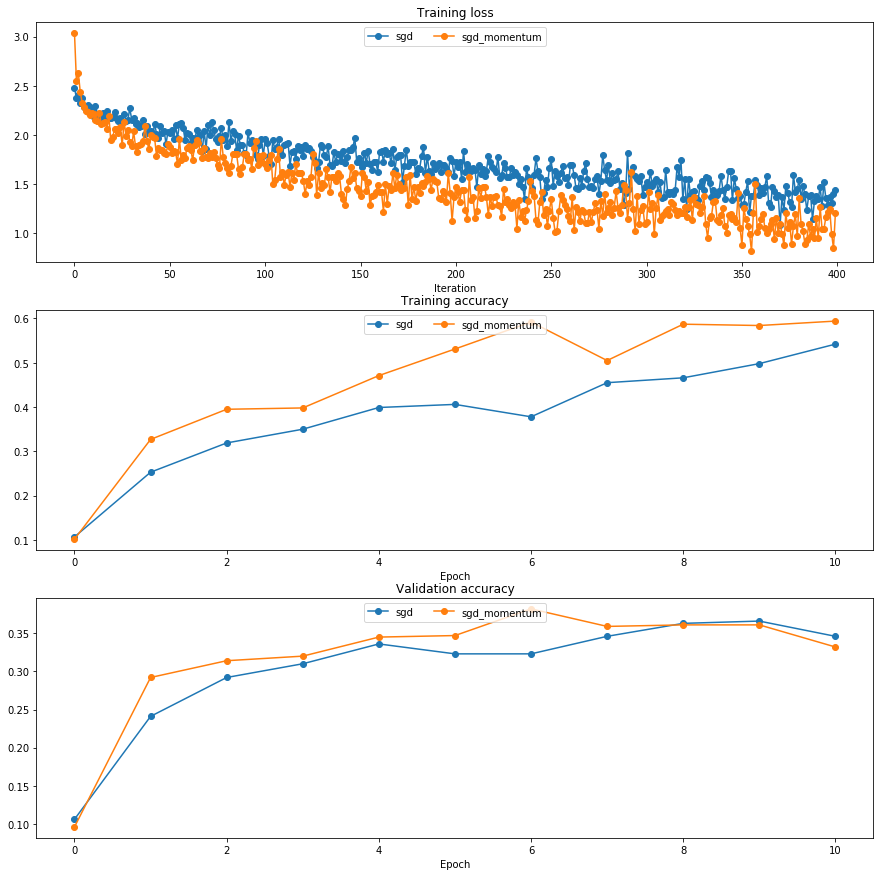

In [23]:
num_train = 4000
small_data = {
  'X_train': data['X_train'][:num_train],
  'y_train': data['y_train'][:num_train],
  'X_val': data['X_val'],
  'y_val': data['y_val'],
}

solvers = {}

for update_rule in ['sgd', 'sgd_momentum']:
  print('running with ', update_rule)
  model = FullyConnectedNeuralNet([100, 100, 100, 100, 100], weight_scale=5e-2)

  solver = Solver(model, small_data,
                  num_epochs=10, batch_size=100,
                  update_rule=update_rule,
                  optim_config={
                    'learning_rate': 1e-2,
                  },
                  verbose=True)
  solvers[update_rule] = solver
  solver.train()
  print()

plt.subplot(3, 1, 1)
plt.title('Training loss')
plt.xlabel('Iteration')

plt.subplot(3, 1, 2)
plt.title('Training accuracy')
plt.xlabel('Epoch')

plt.subplot(3, 1, 3)
plt.title('Validation accuracy')
plt.xlabel('Epoch')

for update_rule, solver in solvers.items():
  plt.subplot(3, 1, 1)
  plt.plot(solver.loss_history, '-o', label=update_rule)
  
  plt.subplot(3, 1, 2)
  plt.plot(solver.train_acc_history, '-o', label=update_rule)

  plt.subplot(3, 1, 3)
  plt.plot(solver.val_acc_history, '-o', label=update_rule)
  
for i in [1, 2, 3]:
  plt.subplot(3, 1, i)
  plt.legend(loc='upper center', ncol=4)
plt.gcf().set_size_inches(15, 15)
plt.show()

# RMSProp et Adam
RMSProp [1] et Adam [2] sont d'autres algorithmes de descente de gradient dont le code est dans le fichier `ift725/optim.py`.   Alors que le code de Adam vous est fournit, vous devez rédigé celui de RMSProp.

[1] Tijmen Tieleman and Geoffrey Hinton. "Lecture 6.5-rmsprop: Divide the gradient by a running average of its recent magnitude." COURSERA: Neural Networks for Machine Learning 4 (2012).

[2] Diederik Kingma and Jimmy Ba, "Adam: A Method for Stochastic Optimization", ICLR 2015.

In [24]:
# Test RMSProp implementation; you should see errors less than 1e-7
import numpy as np
from ift725.optim import rmsprop

N, D = 4, 5
w = np.linspace(-0.4, 0.6, num=N*D).reshape(N, D)
dw = np.linspace(-0.6, 0.4, num=N*D).reshape(N, D)
cache = np.linspace(0.6, 0.9, num=N*D).reshape(N, D)

config = {'learning_rate': 1e-2, 'cache': cache}
next_w, _ = rmsprop(w, dw, config=config)

expected_next_w = np.asarray([
    [-0.39,       -0.33846964, -0.2868865,  -0.23525427, -0.18357633],
    [-0.13185574, -0.0800953,  -0.02829757,  0.02353511,  0.07540058],
    [ 0.12729687,  0.17922215,  0.23117507,  0.28315533,  0.33516143],
    [ 0.38719188,  0.43924528,  0.49132033,  0.54341585,  0.59553073]])
expected_cache = np.asarray([
    [0.6,        0.61510526, 0.63021053, 0.64531579, 0.66042105],
 [0.67552632, 0.69063158, 0.70573684, 0.72084211, 0.73594737],
 [0.75105263, 0.76615789, 0.78189474, 0.79805263, 0.81421053],
 [0.83036842, 0.84652632, 0.86268421, 0.87884211, 0.895     ]])  


print('next_w error: ', rel_error(expected_next_w, next_w))
print('cache error: ', rel_error(expected_cache, config['cache']))

next_w error:  3.8665153708273904e-08
cache error:  3.2856307779330615e-09


In [25]:
# Test Adam implementation; you should see errors around 1e-7 or less
from ift725.optim import adam

N, D = 4, 5
w = np.linspace(-0.4, 0.6, num=N*D).reshape(N, D)
dw = np.linspace(-0.6, 0.4, num=N*D).reshape(N, D)
m = np.linspace(0.6, 0.9, num=N*D).reshape(N, D)
v = np.linspace(0.7, 0.5, num=N*D).reshape(N, D)

config = {'learning_rate': 1e-2, 'm': m, 'v': v, 't': 5}
next_w, config = adam(w, dw, config=config)

expected_next_w = np.asarray([
  [-0.40094747, -0.34836187, -0.29577703, -0.24319299, -0.19060977],
  [-0.1380274,  -0.08544591, -0.03286534,  0.01971428,  0.0722929],
  [ 0.1248705,   0.17744702,  0.23002243,  0.28259667,  0.33516969],
  [ 0.38774145,  0.44031188,  0.49288093,  0.54544852,  0.59801459]])
expected_v = np.asarray([
  [ 0.69966,     0.68908382,  0.67851319,  0.66794809,  0.65738853,],
  [ 0.64683452,  0.63628604,  0.6257431,   0.61520571,  0.60467385,],
  [ 0.59414753,  0.58362676,  0.57311152,  0.56260183,  0.55209767,],
  [ 0.54159906,  0.53110598,  0.52061845,  0.51013645,  0.49966,   ]])
expected_m = np.asarray([
  [ 0.48,        0.49947368,  0.51894737,  0.53842105,  0.55789474],
  [ 0.57736842,  0.59684211,  0.61631579,  0.63578947,  0.65526316],
  [ 0.67473684,  0.69421053,  0.71368421,  0.73315789,  0.75263158],
  [ 0.77210526,  0.79157895,  0.81105263,  0.83052632,  0.85      ]])

print('next_w error: ', rel_error(expected_next_w, next_w))
print('v error: ', rel_error(expected_v, config['v']))
print('m error: ', rel_error(expected_m, config['m']))

next_w error:  0.0015218451757856217
v error:  4.208314038113071e-09
m error:  4.214963193114416e-09


Exécuter le code que voici afin de comparer ces différent algorithmes.  En pricipe Adam devrait être le meilleur algorithme.

running with  adam
(Iteration 1 / 400) loss: 2.623949
(Epoch 0 / 10) train acc: 0.139000; val_acc: 0.128000
(Iteration 11 / 400) loss: 2.210690
(Iteration 21 / 400) loss: 1.736583
(Iteration 31 / 400) loss: 1.835083
(Epoch 1 / 10) train acc: 0.409000; val_acc: 0.341000
(Iteration 41 / 400) loss: 1.881768
(Iteration 51 / 400) loss: 1.640059
(Iteration 61 / 400) loss: 1.466947
(Iteration 71 / 400) loss: 1.579648
(Epoch 2 / 10) train acc: 0.473000; val_acc: 0.350000
(Iteration 81 / 400) loss: 1.599732
(Iteration 91 / 400) loss: 1.742520
(Iteration 101 / 400) loss: 1.564841
(Iteration 111 / 400) loss: 1.484739
(Epoch 3 / 10) train acc: 0.506000; val_acc: 0.349000
(Iteration 121 / 400) loss: 1.442591
(Iteration 131 / 400) loss: 1.547840
(Iteration 141 / 400) loss: 1.288929
(Iteration 151 / 400) loss: 1.430971
(Epoch 4 / 10) train acc: 0.507000; val_acc: 0.361000
(Iteration 161 / 400) loss: 1.347529
(Iteration 171 / 400) loss: 1.334475
(Iteration 181 / 400) loss: 1.378872
(Iteration 191 / 40

/home/julien/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:30: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
/home/julien/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:33: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
/home/julien/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:36: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the ear

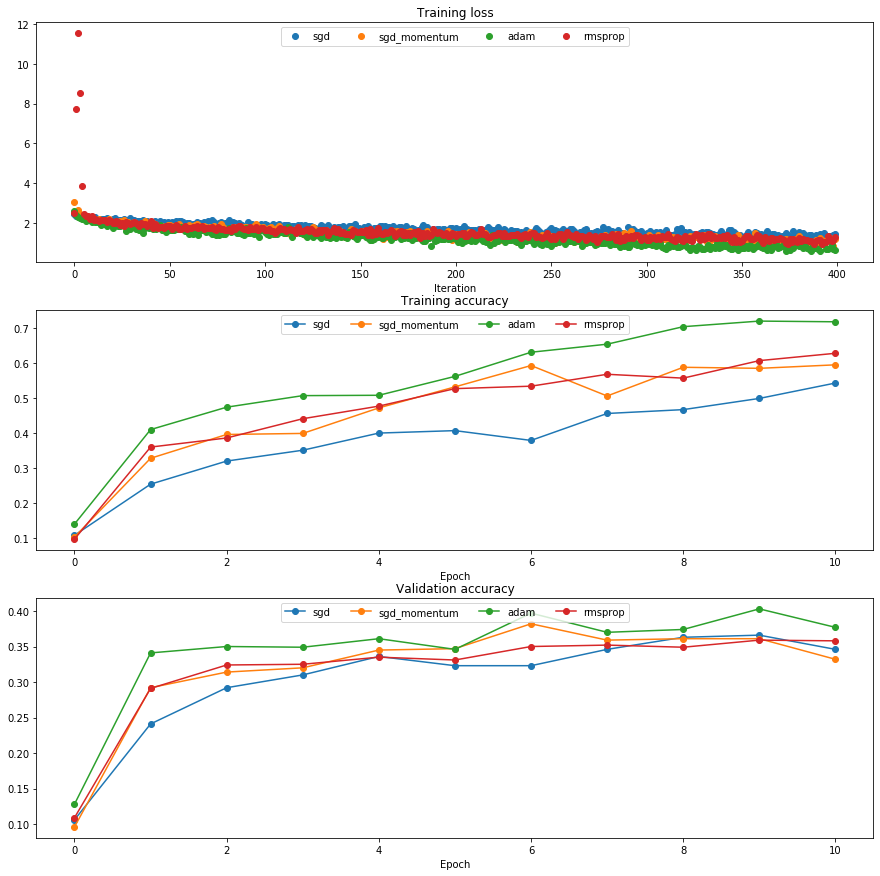

In [26]:
learning_rates = {'rmsprop': 1e-4, 'adam': 1e-3}
for update_rule in ['adam', 'rmsprop']:
  print('running with ', update_rule)
  model = FullyConnectedNeuralNet([100, 100, 100, 100, 100], weight_scale=5e-2)

  solver = Solver(model, small_data,
                  num_epochs=10, batch_size=100,
                  update_rule=update_rule,
                  optim_config={
                    'learning_rate': learning_rates[update_rule]
                  },
                  verbose=True)
  solvers[update_rule] = solver
  solver.train()
  print()

plt.subplot(3, 1, 1)
plt.title('Training loss')
plt.xlabel('Iteration')

plt.subplot(3, 1, 2)
plt.title('Training accuracy')
plt.xlabel('Epoch')

plt.subplot(3, 1, 3)
plt.title('Validation accuracy')
plt.xlabel('Epoch')

for update_rule, solver in solvers.items():
  plt.subplot(3, 1, 1)
  plt.plot(solver.loss_history, 'o', label=update_rule)
  
  plt.subplot(3, 1, 2)
  plt.plot(solver.train_acc_history, '-o', label=update_rule)

  plt.subplot(3, 1, 3)
  plt.plot(solver.val_acc_history, '-o', label=update_rule)
  
for i in [1, 2, 3]:
  plt.subplot(3, 1, i)
  plt.legend(loc='upper center', ncol=4)
plt.gcf().set_size_inches(15, 15)
plt.show()

# Entraînez un bon model!
Entraînez le meilleur réseau de neurones possible sur CIFAR-10 et mettez le meilleur modèle dans la variable `best_model`. Vous devriez avoir au moins une justesse 50% (voire même 55%) en validation et en test.

Plus tard dans le devoir, on vous demandera d'entrainer et de tester une réseau convolutionnel sur CIFAR-10.  Vous verrez alors que cette architecture est supérieure aux réseaus de neurones pleinement connectés.

NOTE: il serait judicieux de compléter le notebook `BatchNormalization.ipynb` et `Dropout.ipynb` avant de compléter cette dernière partie.

In [27]:
do_delete = True

In [28]:
if do_delete:
    trys = []
    best_try = -1
    best_val_acc = 0
    print('Deleted trys')
else:
    print('Did not delete trys')
do_delete = False

Deleted trys


In [29]:
best_model = None
################################################################################
# TODO: Entrainez le meilleur FullyConnectedNeuralNet que vous pouvez sur les  #
#  données CIFAR-10. Vous pourriez trouver la normalization par lots et le     #
#  dropout utile. Stockez votre meilleur modèle dans la variable best_model.   #
################################################################################

def uniform(minv, maxv):
    return np.random.rand() * (maxv - minv) + minv

if 'trys' not in locals():
    trys = []
    best_try = -1
    best_val_acc = 0
for i in range(1):
    # reg 0.00779190546432  lr 0.000423844376859
    # reg 0.000204588367827 lr 0.000529341067109
    weight_scale = 3e-2  # 10 ** uniform(-3, -1)
    lr = 10 ** -2.5  # 10 ** uniform(-4, -2)
    reg = 1e-10  # 10 ** uniform(-6, -3)
    
    model = FullyConnectedNeuralNet([100] * 5, weight_scale=weight_scale, reg=reg, use_batchnorm=True)

    solver = Solver(model, data,
                  num_epochs=30, batch_size=100,
                  update_rule='adam',
                  optim_config={
                    'learning_rate': lr
                  },
                  print_every=200,
                  verbose=True)
    solver.train()
    
    max_val_acc = np.max(solver.val_acc_history)
    cur_index = len(trys)
    print('Try', cur_index, 'Max accu. val.', max_val_acc, 'p:', weight_scale, reg, lr, ('Record!' if max_val_acc > best_val_acc else ''))
    trys.append({
            'ws': weight_scale, 'reg': reg, 'lr': lr,
            'maxvacc': max_val_acc,
            'lossh': solver.loss_history,
            'tacch': solver.train_acc_history,
            'vacch': solver.val_acc_history,
            'model': model
        })
    
    if max_val_acc > best_val_acc:
        best_val_acc = max_val_acc
        best_try = cur_index
        
print('Best try:', best_try)
print('Total tries', len(trys))
################################################################################
#                              FIN DE VOTRE CODE                               #
################################################################################

(Iteration 1 / 14700) loss: 2.302189
(Epoch 0 / 30) train acc: 0.105000; val_acc: 0.083000
(Iteration 201 / 14700) loss: 1.817011
(Iteration 401 / 14700) loss: 1.919148
(Epoch 1 / 30) train acc: 0.399000; val_acc: 0.411000
(Iteration 601 / 14700) loss: 1.803012
(Iteration 801 / 14700) loss: 1.679818
(Epoch 2 / 30) train acc: 0.480000; val_acc: 0.440000
(Iteration 1001 / 14700) loss: 1.525445
(Iteration 1201 / 14700) loss: 1.945060
(Iteration 1401 / 14700) loss: 1.405651
(Epoch 3 / 30) train acc: 0.427000; val_acc: 0.411000
(Iteration 1601 / 14700) loss: 1.561037
(Iteration 1801 / 14700) loss: 1.433437
(Epoch 4 / 30) train acc: 0.470000; val_acc: 0.454000
(Iteration 2001 / 14700) loss: 1.334832
(Iteration 2201 / 14700) loss: 1.405627
(Iteration 2401 / 14700) loss: 1.494527
(Epoch 5 / 30) train acc: 0.512000; val_acc: 0.452000
(Iteration 2601 / 14700) loss: 1.634896
(Iteration 2801 / 14700) loss: 1.518007
(Epoch 6 / 30) train acc: 0.504000; val_acc: 0.485000
(Iteration 3001 / 14700) loss

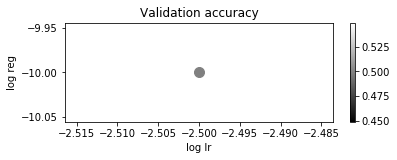

In [30]:
# Visualize the cross-validation results
forget = 0
new_tries = trys[forget:]
marker_size = 100
#x_scatter, x_label = [np.log10(x['ws']) for x in new_tries], 'log weight scale'
x_scatter, x_label = [np.log10(x['lr']) for x in new_tries], 'log lr'
y_scatter, y_label = [np.log10(x['reg']) for x in new_tries], 'log reg'

# plot validation accuracy
colors = [x['maxvacc'] for x in new_tries] # default size of markers is 20
isorted = np.argsort(colors)
x_scatter = np.asarray(x_scatter)[isorted]
y_scatter = np.asarray(y_scatter)[isorted]
colors = np.asarray(colors)[isorted]
plt.subplot(2, 1, 2)
plt.scatter(x_scatter, y_scatter, marker_size, c=colors)
plt.colorbar()
plt.xlabel(x_label)
plt.ylabel(y_label)
plt.title('Validation accuracy')
plt.show()

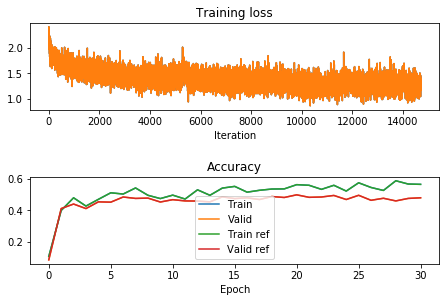

In [31]:
ref = trys[best_try]
best_try = -1
plt.subplot(2, 1, 1)
plt.title('Training loss')
plt.xlabel('Iteration')
plt.plot(trys[best_try]['lossh'], '-')
plt.plot(ref['lossh'], '-')

plt.subplot(2, 1, 2)
plt.title('Accuracy')
plt.xlabel('Epoch')
plt.plot(trys[best_try]['tacch'], '-', label='Train')
plt.plot(trys[best_try]['vacch'], '-', label='Valid')
plt.plot(ref['tacch'], '-', label='Train ref')
plt.plot(ref['vacch'], '-', label='Valid ref')
plt.legend(loc='lower center')

plt.tight_layout(pad=0, w_pad=0, h_pad=2)
plt.show()

# Test your model
Run your best model on the validation and test sets. You should achieve above 53% accuracy on the validation set.

In [32]:
best_model = trys[best_try]['model']
X_test = data['X_test']
y_test = data['y_test']
X_val  = data['X_val']
y_val  = data['y_val']
y_test_pred = np.argmax(best_model.loss(X_test), axis=1)
y_val_pred = np.argmax(best_model.loss(X_val), axis=1)
print('Validation set accuracy: ', (y_val_pred == y_val).mean())
print('Test set accuracy: ', (y_test_pred == y_test).mean())

Validation set accuracy:  0.499
Test set accuracy:  0.496
